# .head() and .columns

In [3]:
import pandas as pd


file_path = 'C:\\Users\\tommy\\Downloads\\Individual_ERPs\\EEG_Measurements\\book_english-english_translation_1.csv'
sample_data = pd.read_csv(file_path)


sample_data.head(), sample_data.columns

(         Fp1       Fpz        Fp2        F7         F3         Fz        F4  \
 0   0.105563 -10.12323 -13.193379  6.893438  -7.629562  28.292086  2.719152   
 1  -3.794437  -9.43123 -12.219379  1.226438 -13.299563  13.985086 -1.569848   
 2  -7.023438  -9.68523 -12.414379 -2.416562 -17.288563   6.112086 -3.922848   
 3  -9.825437 -11.14723 -13.928379 -4.398562 -20.232563   3.905086 -4.680848   
 4 -12.493438 -13.67223 -16.416379 -5.623563 -23.102563   4.827086 -4.590848   
 
           F8       FC5        FC1  ...       CP6        P7        P3  \
 0  -2.486754 -6.934687  -7.466992  ... -4.767598 -1.546625 -12.67241   
 1  -7.682754 -4.498687  -8.062992  ... -3.226598 -2.437625 -12.57541   
 2 -10.316754 -3.801687  -8.833992  ... -2.291598 -4.136625 -13.25241   
 3 -10.806754 -4.979687 -10.249992  ... -2.124598 -6.539625 -14.65141   
 4 -10.200754 -7.615687 -12.606992  ... -2.626598 -9.277625 -16.38041   
 
           Pz        P4        P8        POz       O1        Oz        O2  
 0

# Loading and Exploring

In [1]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm 

In [2]:
directory_path = 'EEG_Measurements'  

def load_and_preprocess_files(directory_path):
    all_data = []
    
    
    file_paths = glob.glob(os.path.join(directory_path, '*_*-*_translation_*.csv'))
    
    
    for file_path in tqdm(file_paths, desc="Loading and processing files"):
        
        filename = os.path.basename(file_path)
        
        try:
            
            word, language1, language2, sample = filename.split('_')
            
            
            erp_data = pd.read_csv(file_path)

            
            erp_data['word'] = word
            erp_data['language1'] = language1
            erp_data['language2'] = language2

            
            all_data.append(erp_data)
            
        except ValueError:
            
            print(f"Skipping file due to unexpected format: {filename}")
            continue

    
    combined_data = pd.concat(all_data, ignore_index=True)
    return combined_data



combined_data = load_and_preprocess_files(directory_path)


print(combined_data.describe())
print(combined_data.head())

Loading and processing files: 100%|██████████| 10904/10904 [00:33<00:00, 330.38it/s]


                Fp1           Fpz           Fp2            F7            F3  \
count  2.791424e+06  2.791424e+06  2.791424e+06  2.791424e+06  2.791424e+06   
mean   2.848119e-18 -6.949473e-18  9.731570e-19 -5.700056e-18  9.218184e-18   
std    1.279296e+01  1.090816e+01  1.189507e+01  1.178211e+01  1.180895e+01   
min   -2.124729e+02 -2.068067e+02 -2.074427e+02 -2.050153e+02 -2.036073e+02   
25%   -6.188509e+00 -5.591882e+00 -5.999578e+00 -5.741503e+00 -6.248594e+00   
50%   -1.413672e-02 -8.914062e-03 -2.477148e-02  6.769336e-02  2.675195e-02   
75%    6.133179e+00  5.572466e+00  5.942820e+00  5.799697e+00  6.269894e+00   
max    1.960322e+02  1.721910e+02  1.730699e+02  1.694928e+02  1.571908e+02   

                 Fz            F4            F8           FC5           FC1  \
count  2.791424e+06  2.791424e+06  2.791424e+06  2.791424e+06  2.791424e+06   
mean  -3.961991e-18  5.348744e-18 -1.446610e-18  7.331211e-18  5.929623e-18   
std    1.142708e+01  1.148133e+01  1.121195e+01  1.

# Plotting overall per column

                Fp1           Fpz           Fp2            F7            F3  \
count  2.791424e+06  2.791424e+06  2.791424e+06  2.791424e+06  2.791424e+06   
mean   2.848119e-18 -6.949473e-18  9.731570e-19 -5.700056e-18  9.218184e-18   
std    1.279296e+01  1.090816e+01  1.189507e+01  1.178211e+01  1.180895e+01   
min   -2.124729e+02 -2.068067e+02 -2.074427e+02 -2.050153e+02 -2.036073e+02   
25%   -6.188509e+00 -5.591882e+00 -5.999578e+00 -5.741503e+00 -6.248594e+00   
50%   -1.413672e-02 -8.914062e-03 -2.477148e-02  6.769336e-02  2.675195e-02   
75%    6.133179e+00  5.572466e+00  5.942820e+00  5.799697e+00  6.269894e+00   
max    1.960322e+02  1.721910e+02  1.730699e+02  1.694928e+02  1.571908e+02   

                 Fz            F4            F8           FC5           FC1  \
count  2.791424e+06  2.791424e+06  2.791424e+06  2.791424e+06  2.791424e+06   
mean  -3.961991e-18  5.348744e-18 -1.446610e-18  7.331211e-18  5.929623e-18   
std    1.142708e+01  1.148133e+01  1.121195e+01  1.

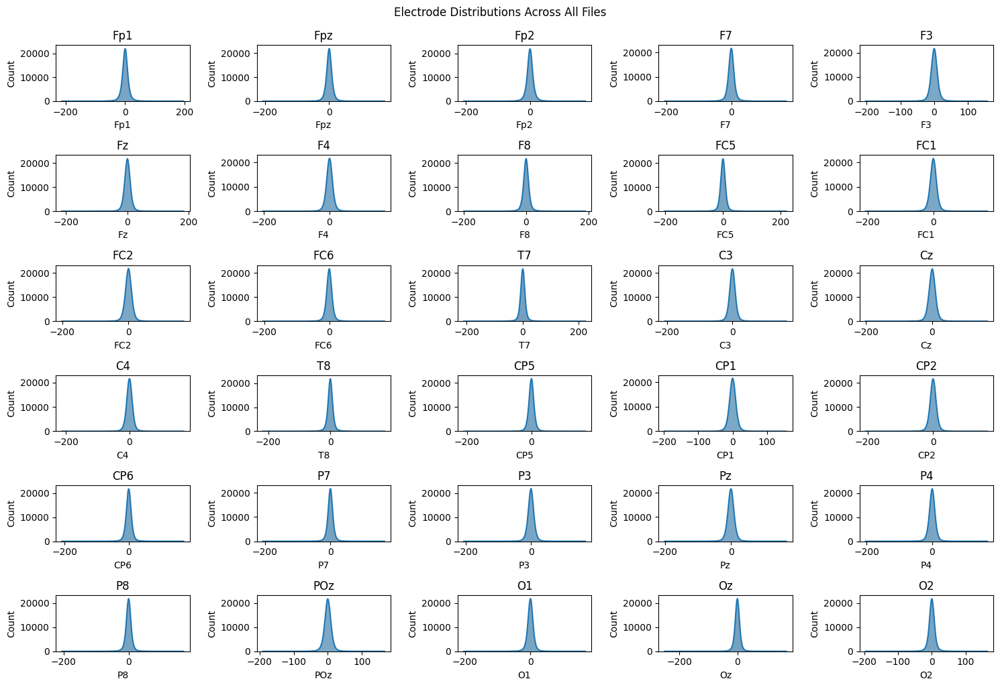

In [6]:
def plot_electrode_distributions(data, electrodes):
    plt.figure(figsize=(15, 10))
    for idx, electrode in enumerate(electrodes, 1):
        plt.subplot(6, 5, idx)  
        sns.histplot(data[electrode], kde=True)
        plt.title(electrode)
        plt.tight_layout()
    plt.suptitle("Electrode Distributions Across All Files", y=1.02)
    plt.show()


electrodes = combined_data.columns[:30].tolist()  


plot_electrode_distributions(combined_data, electrodes)


# Plotting by Language

11


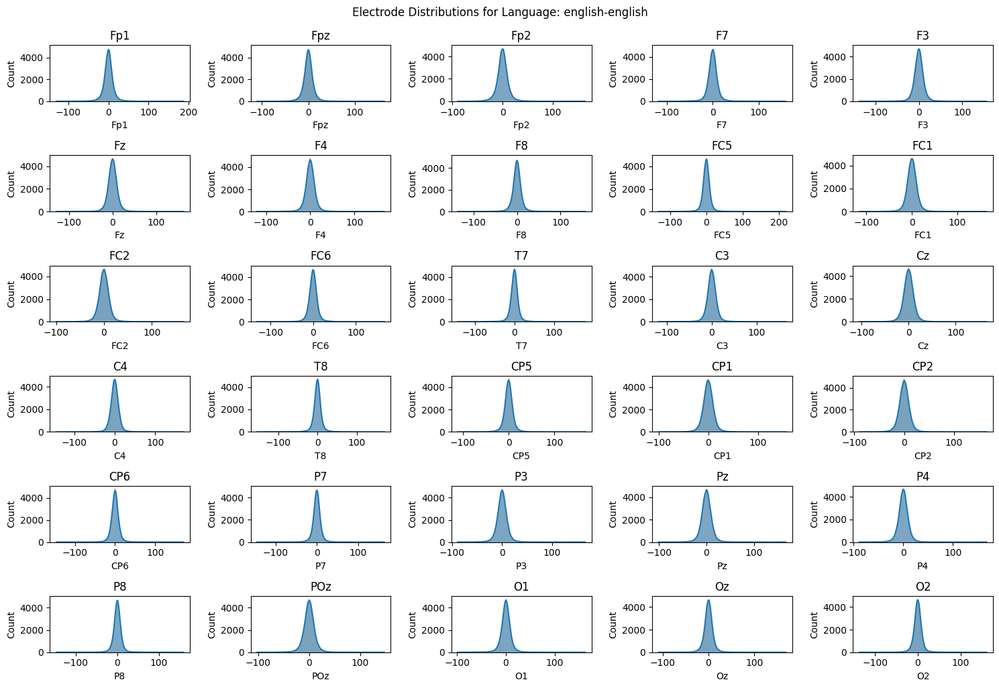

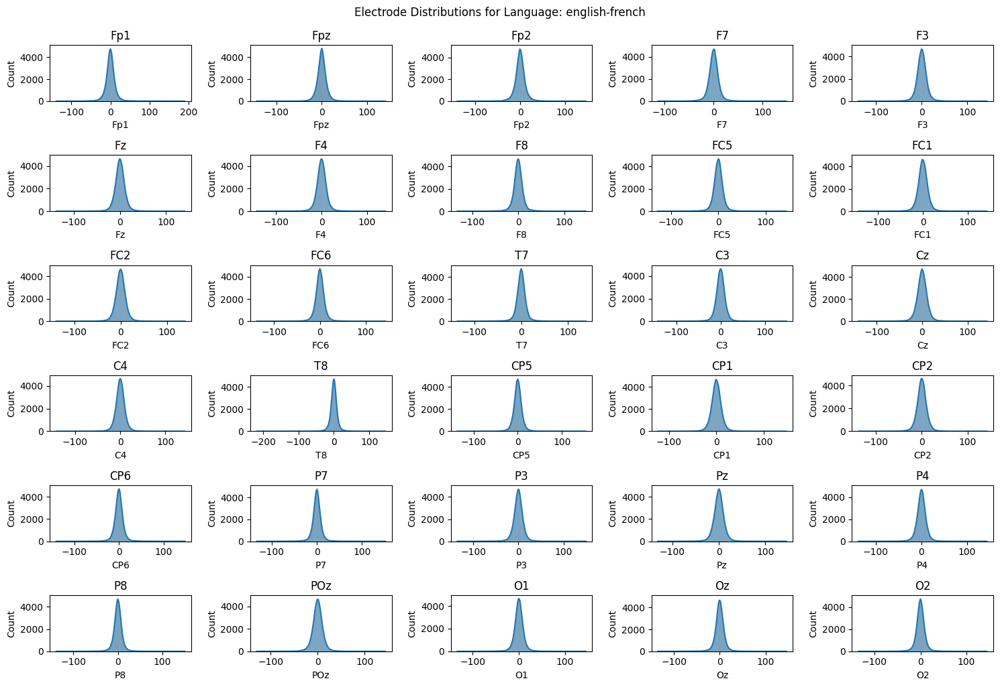

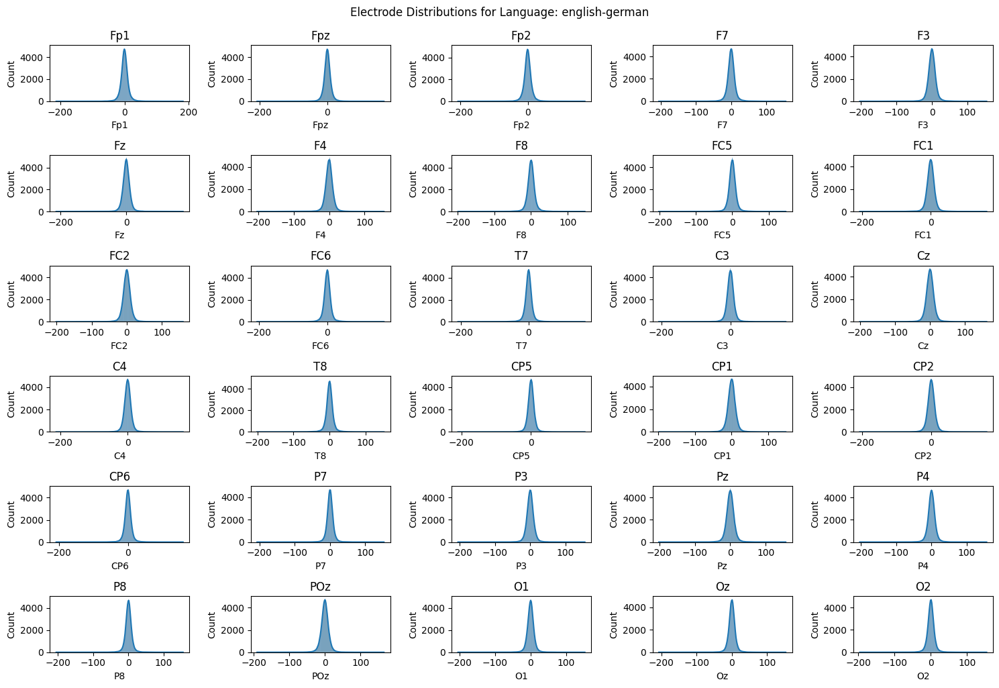

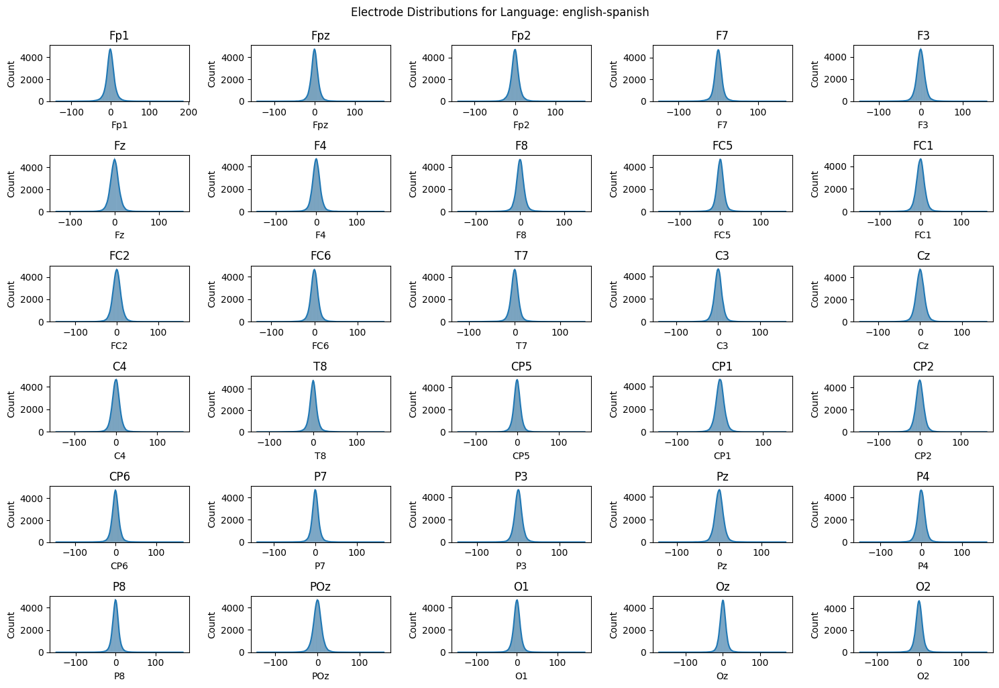

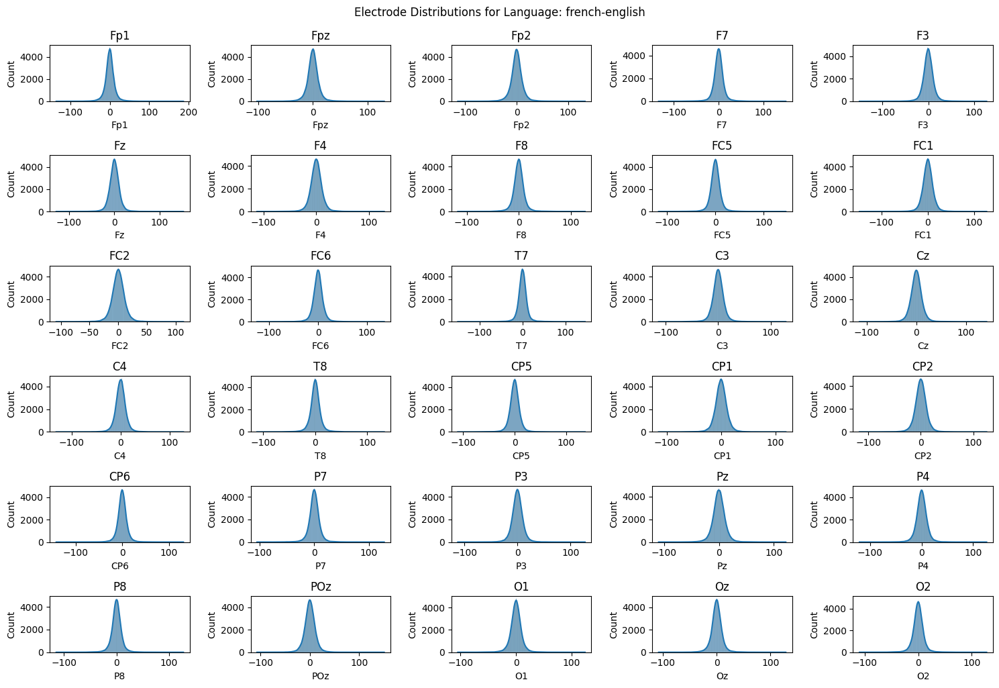

...

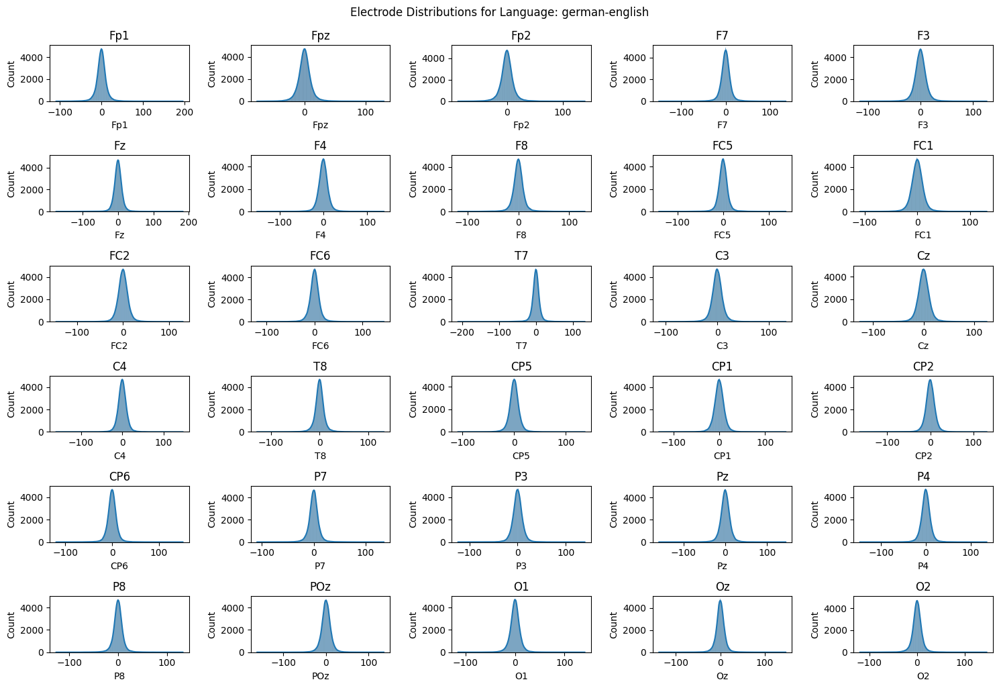

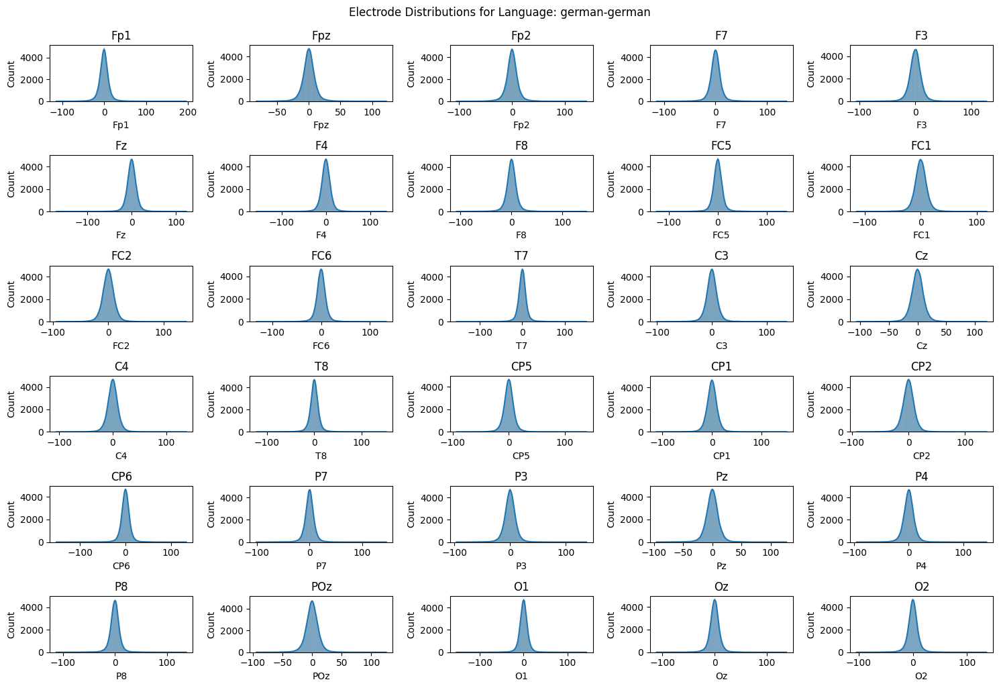

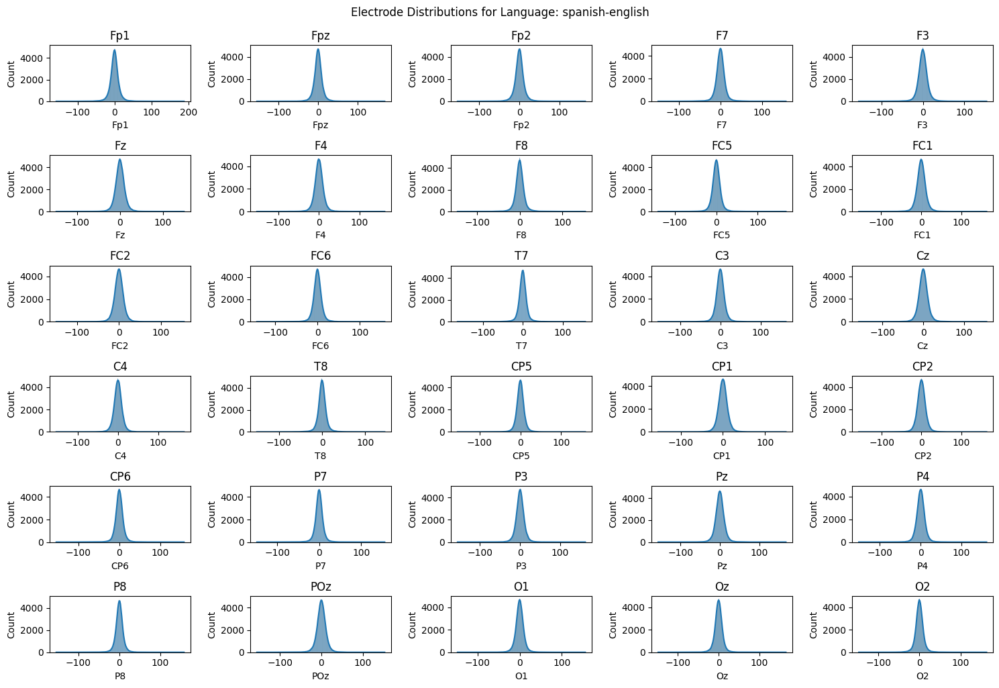

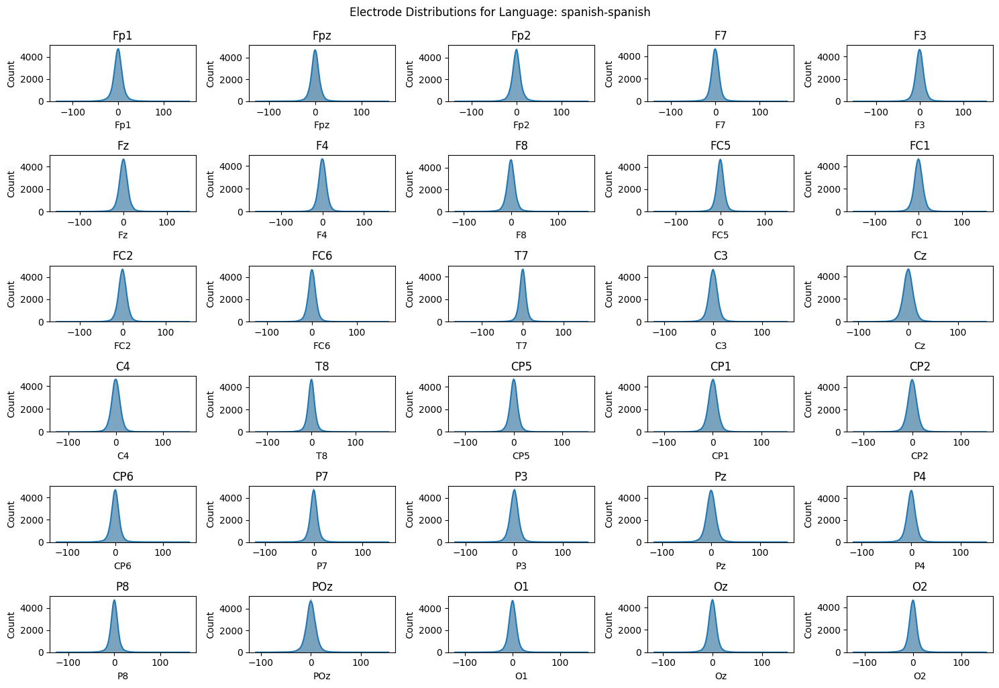

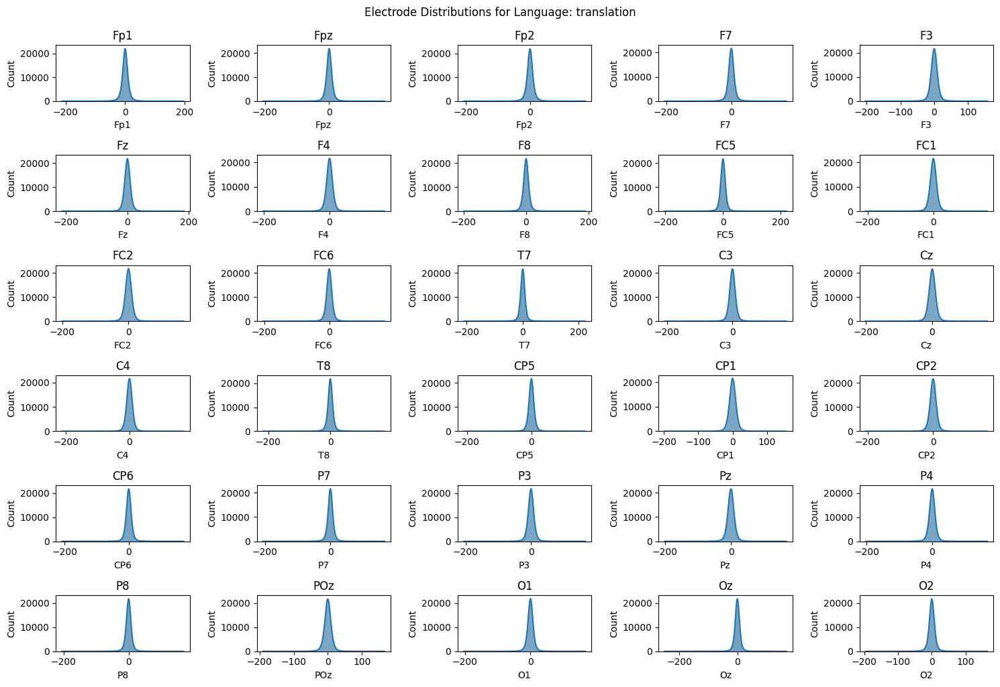

In [4]:
def plot_electrode_distributions_separately_by_language(data, electrodes):
    # Get unique languages from the language columns
    unique_languages = pd.concat([data['language1'], data['language2']]).unique()
    print(len(unique_languages))
    # Loop through each unique language
    for language in unique_languages:
        
        # Filter the data for the current language
        language_data = data[(data['language1'] == language) | (data['language2'] == language)]
        
        # Create a new figure for each language
        plt.figure(figsize=(15, 10))
        
        # Plot the distribution for each electrode in the filtered data
        for idx, electrode in enumerate(electrodes, 1):
            plt.subplot(6, 5, idx)  # Create a 6x5 grid layout for electrodes
            sns.histplot(language_data[electrode], kde=True)
            plt.title(electrode)
            plt.tight_layout()
        
        # Set a main title for each language figure
        plt.suptitle(f"Electrode Distributions for Language: {language}", y=1.02)
        plt.show()
electrodes = combined_data.columns[:30].tolist()  
# Call the function to plot electrode distributions for each language separately
plot_electrode_distributions_separately_by_language(combined_data, electrodes)


# Graphing Divergence by Word - Language Pair

Loading and processing files: 100%|██████████| 20614/20614 [02:32<00:00, 135.35it/s]
C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


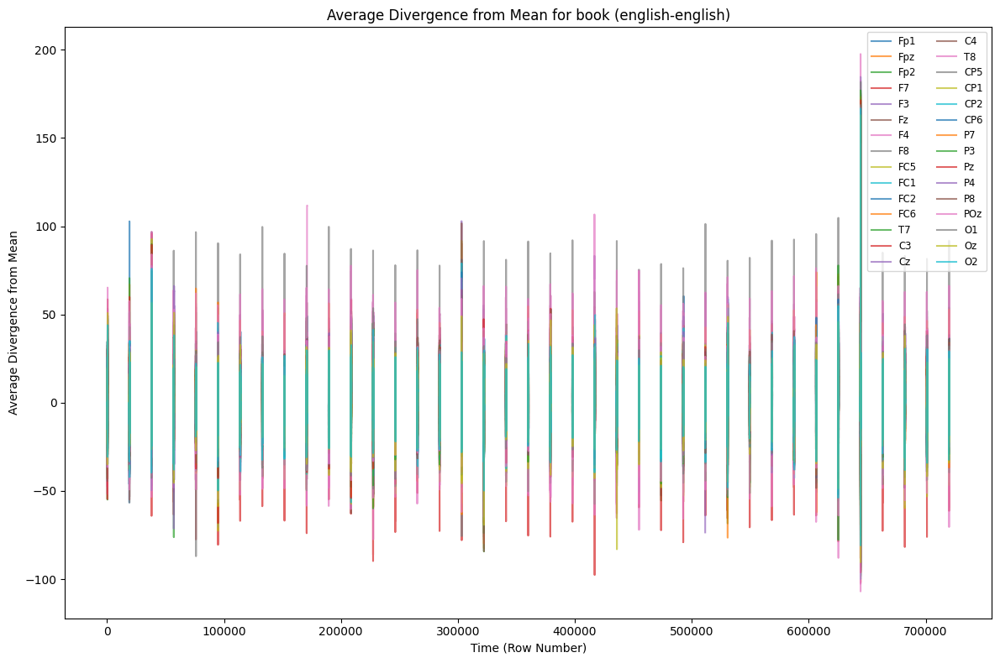

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


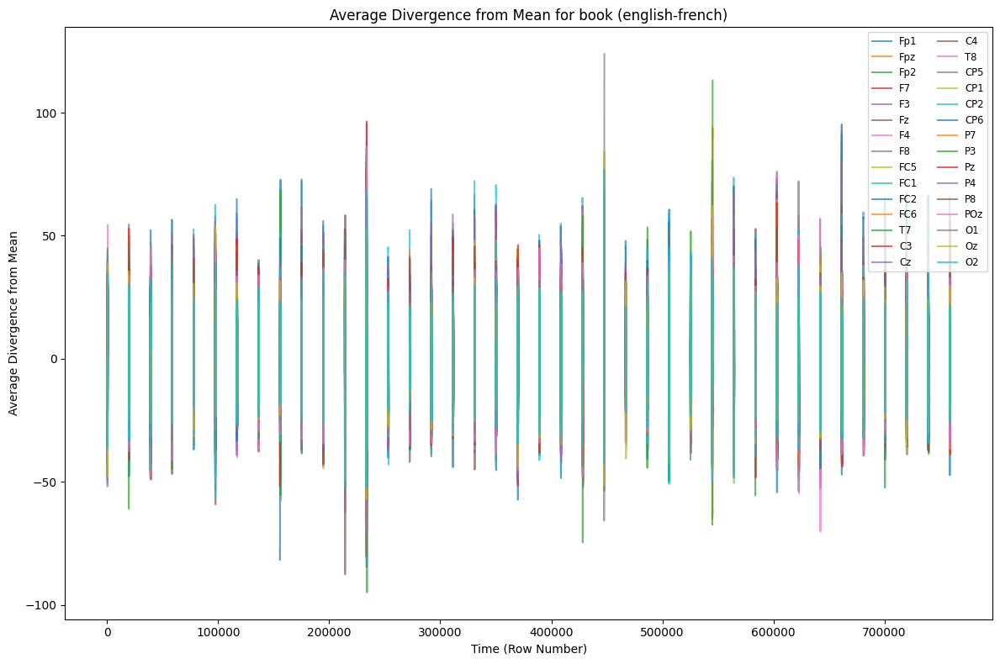

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


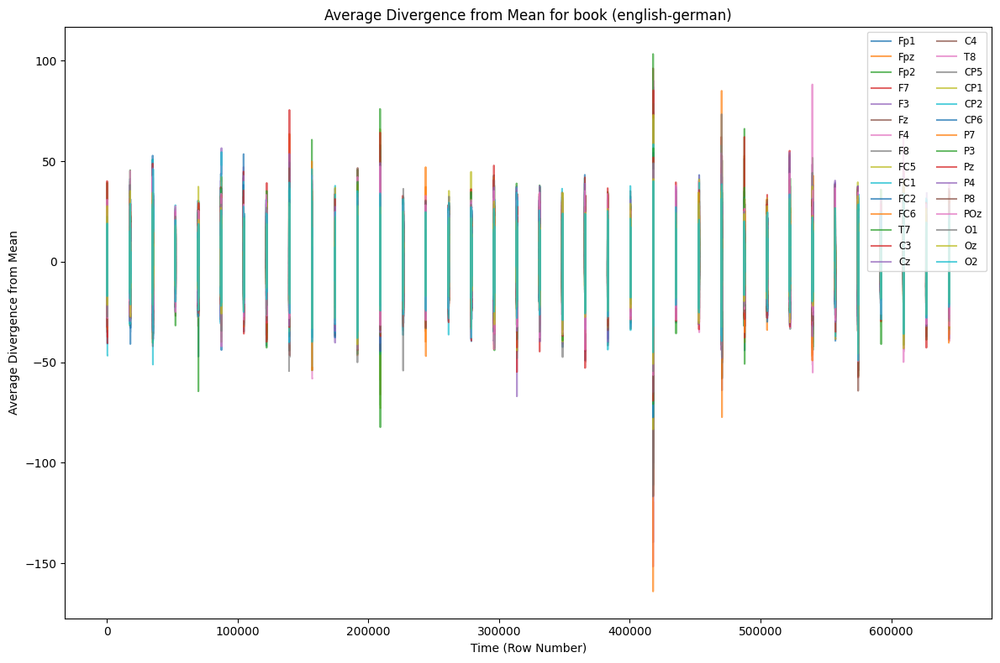

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


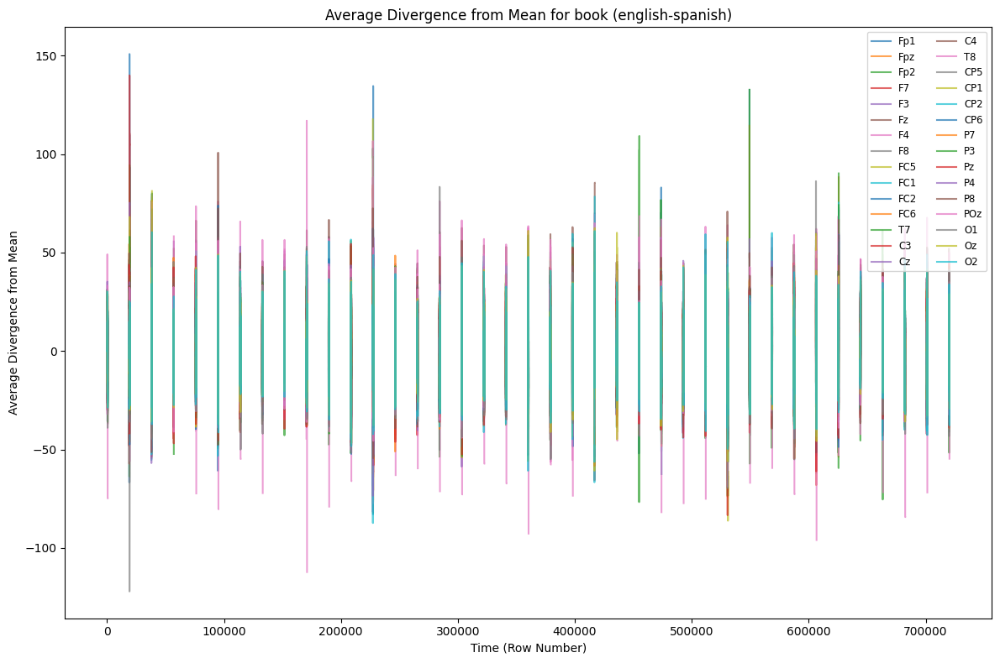

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


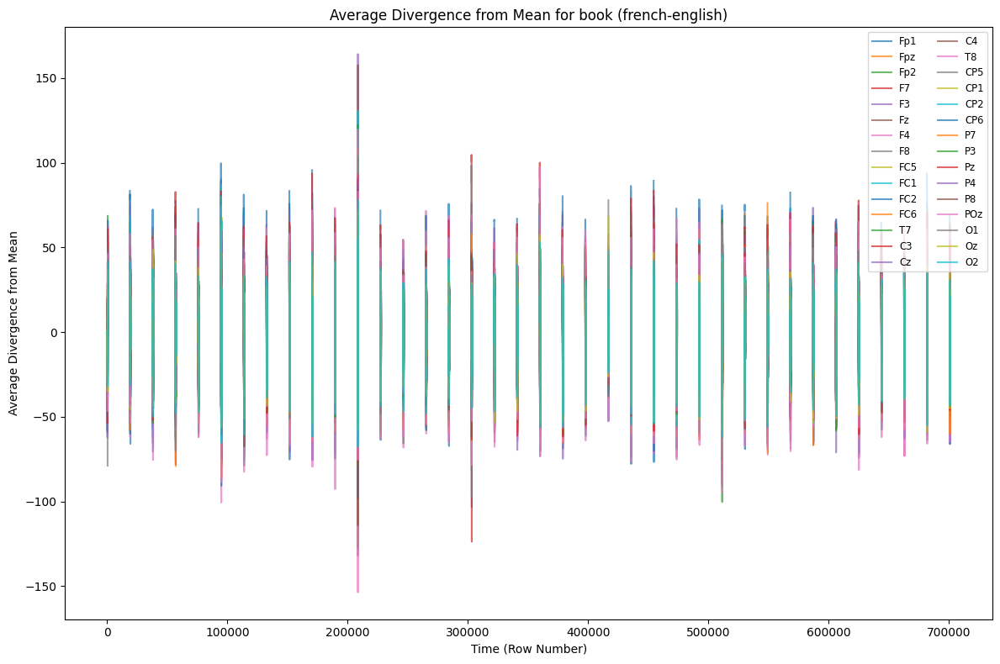

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


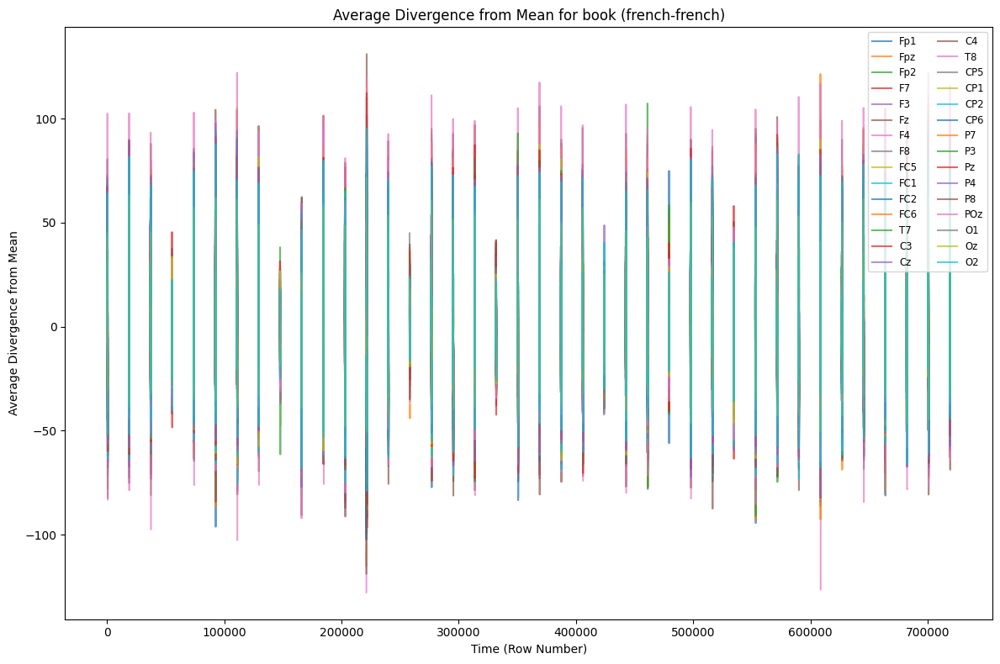

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


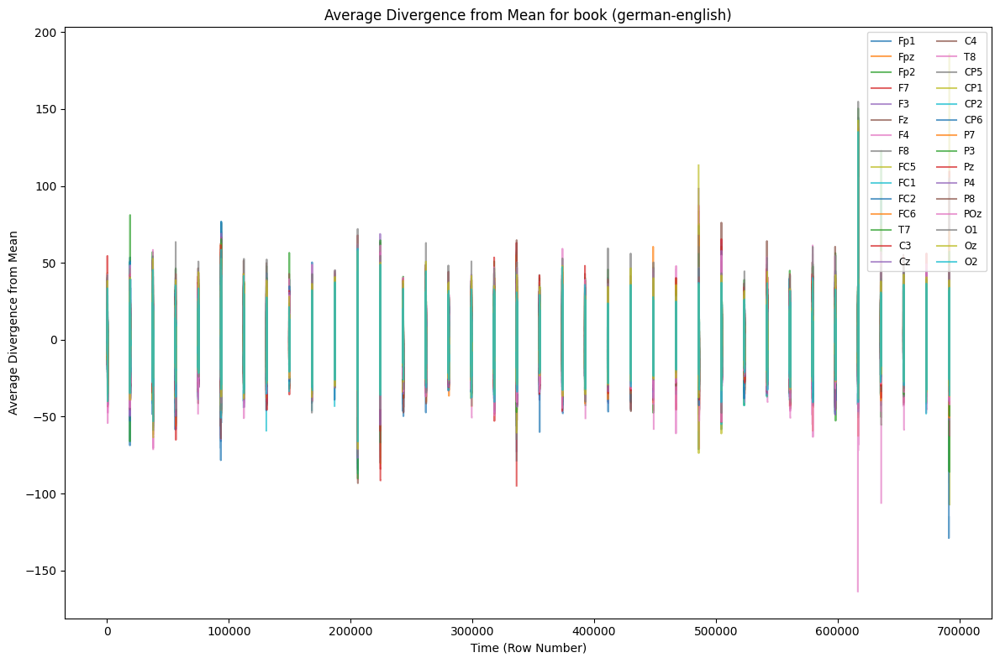

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


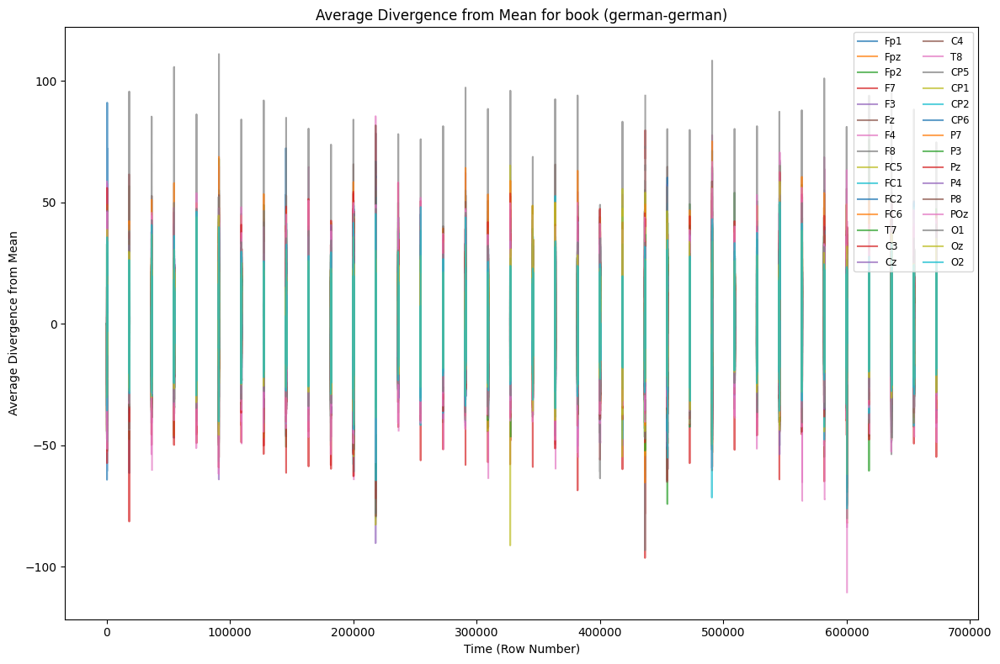

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


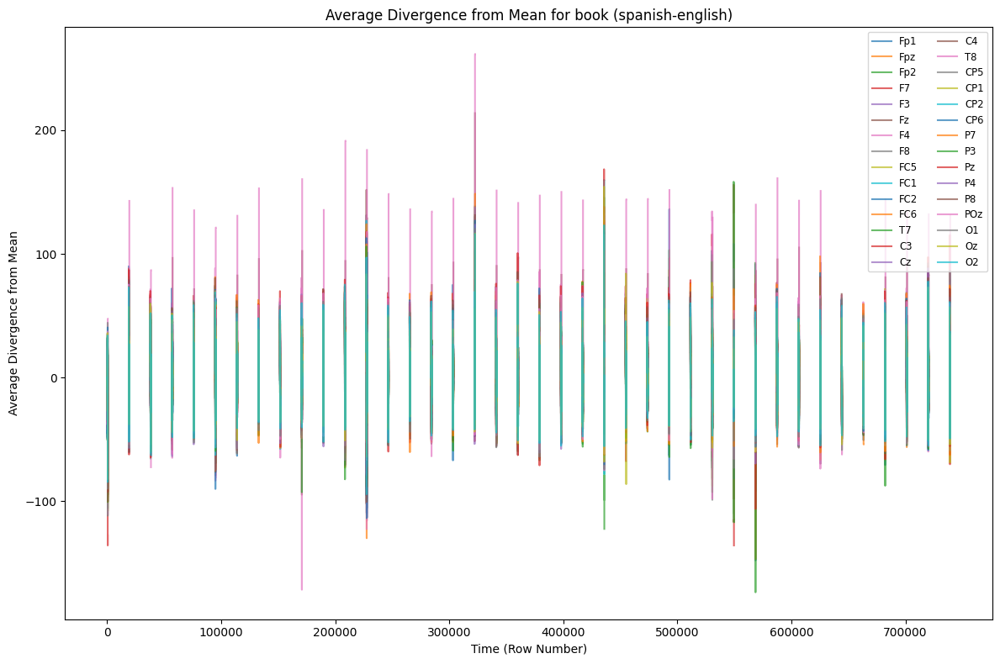

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


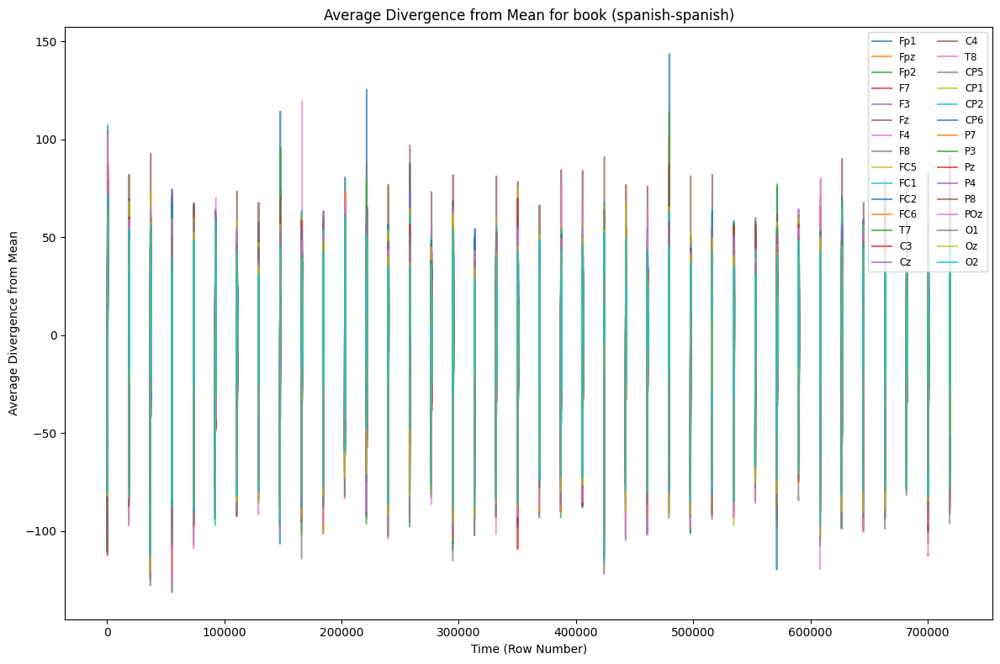

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


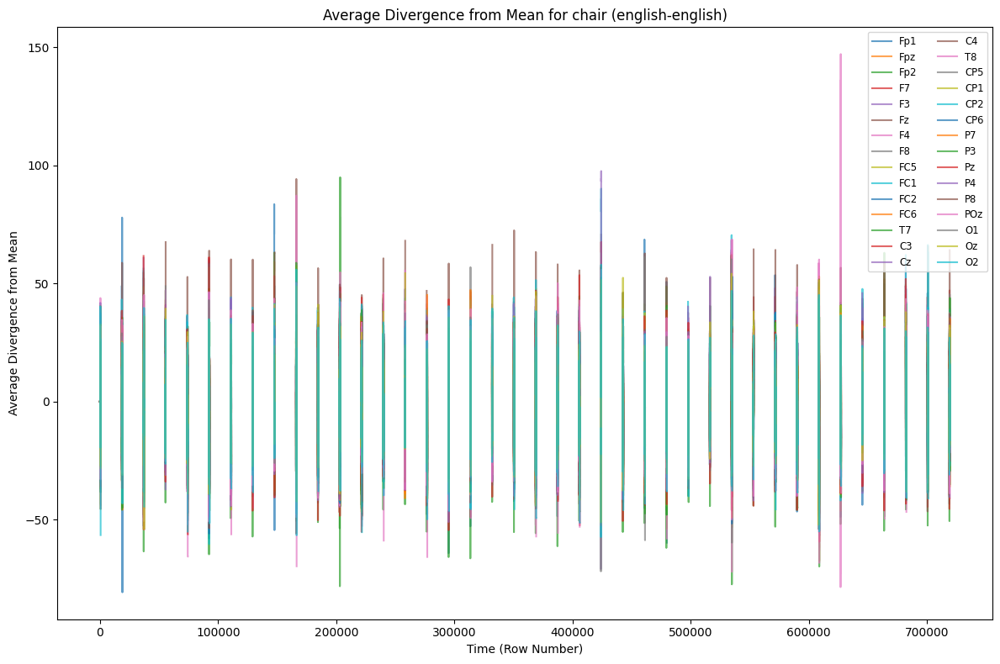

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


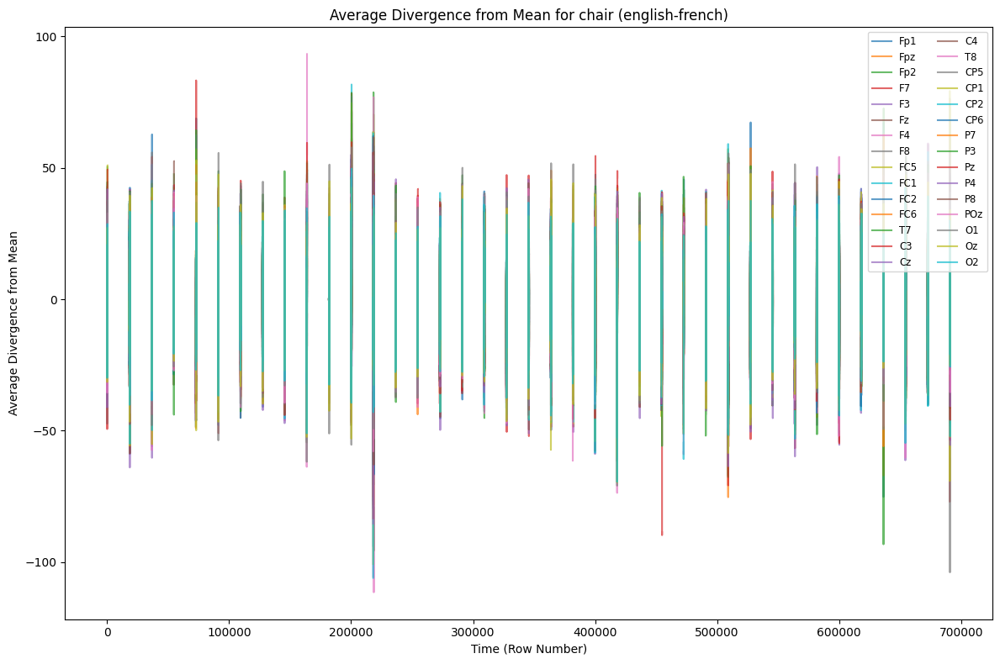

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


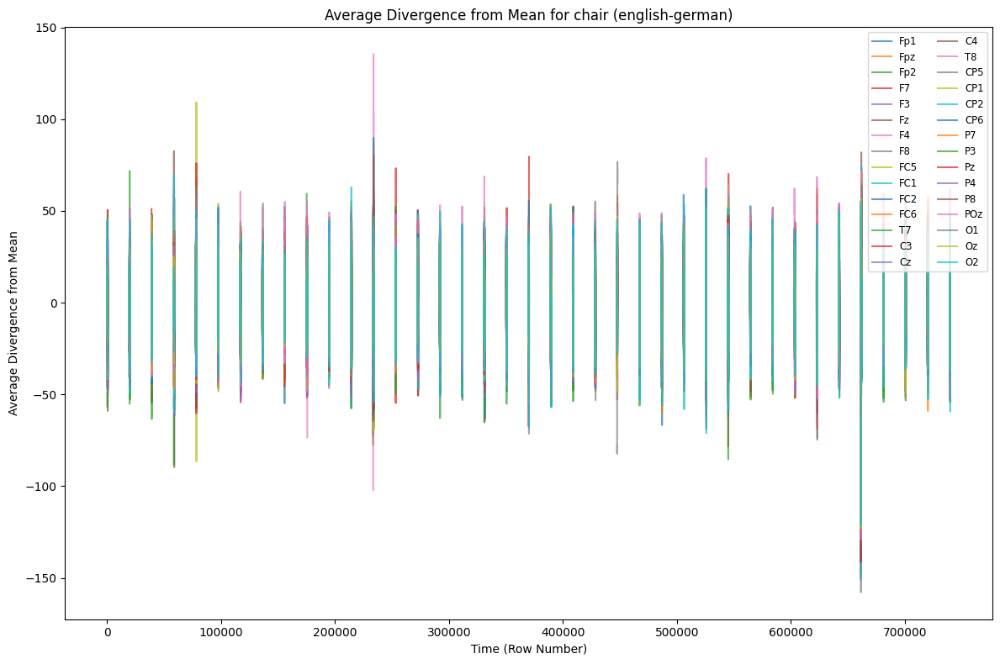

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


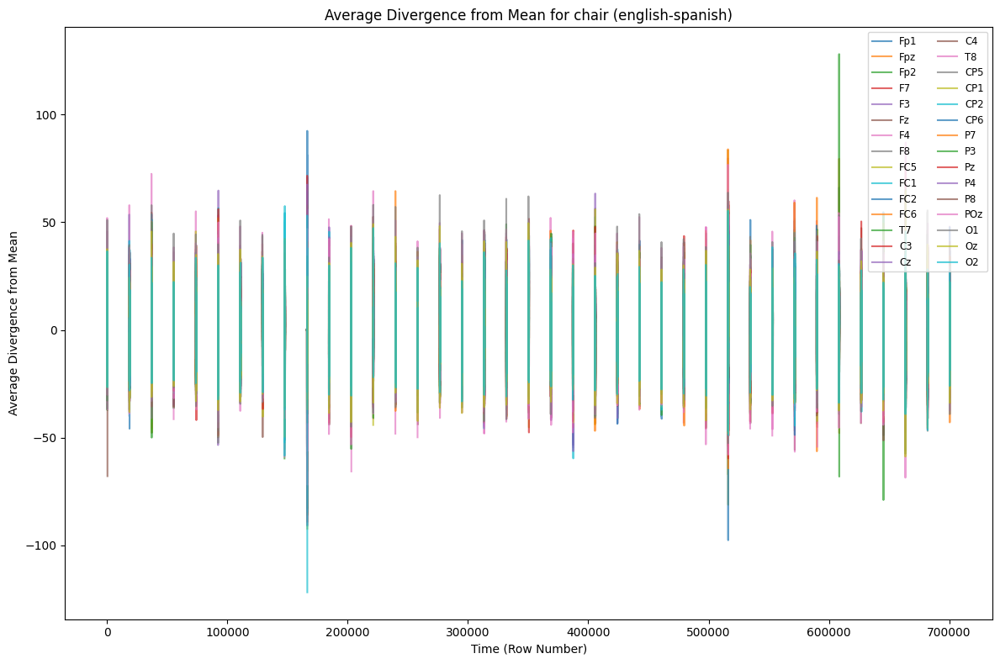

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


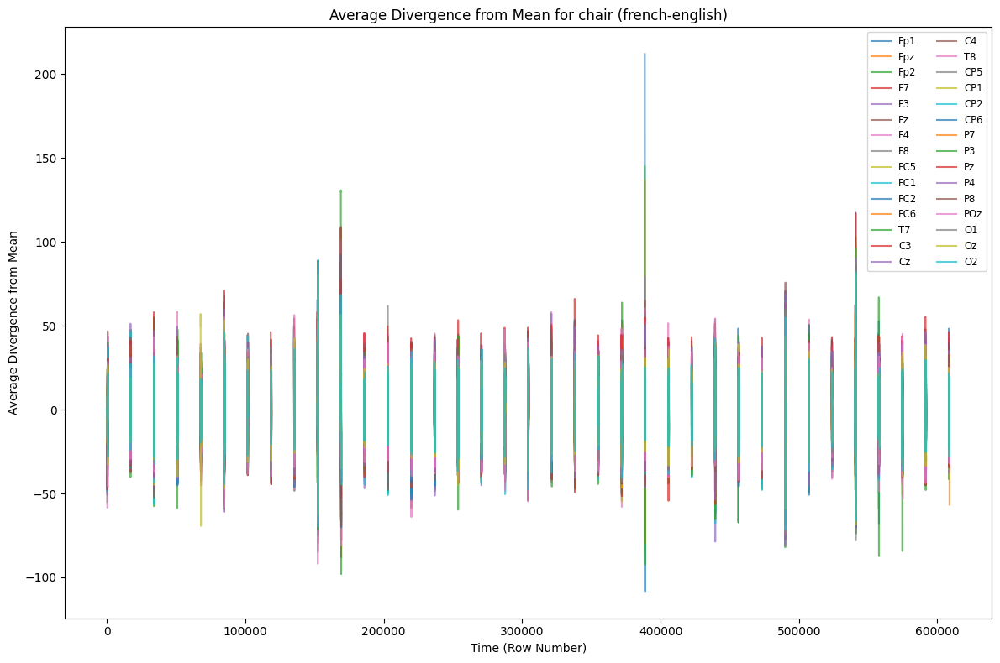

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


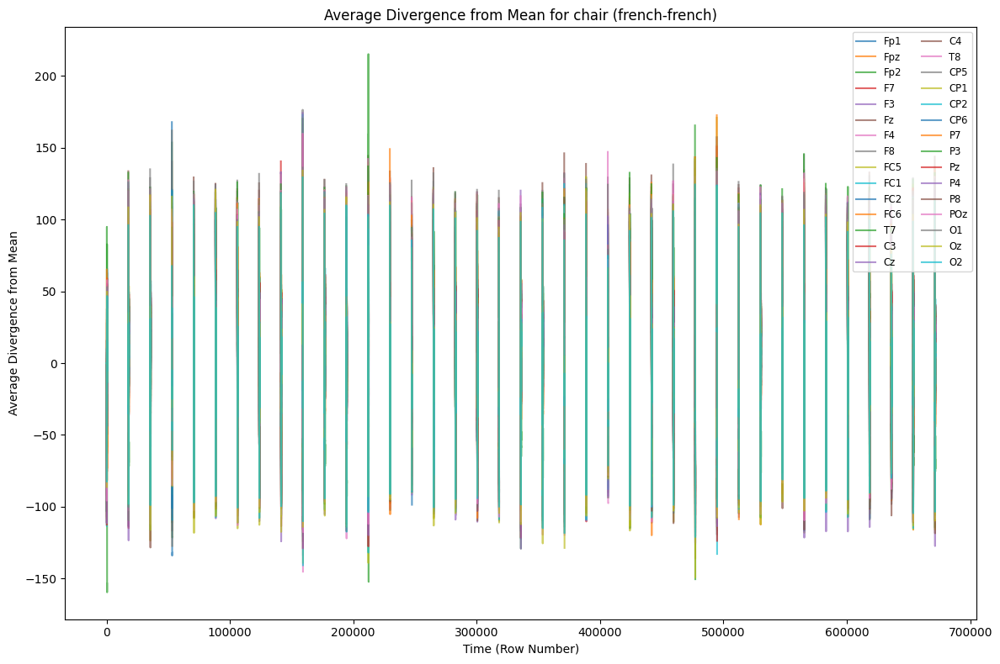

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


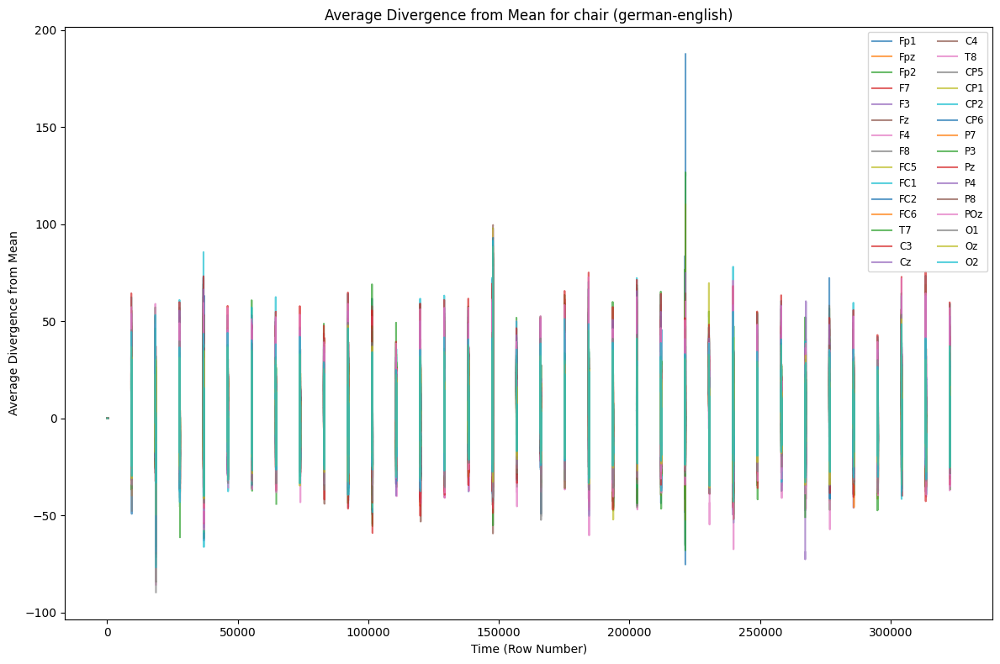

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


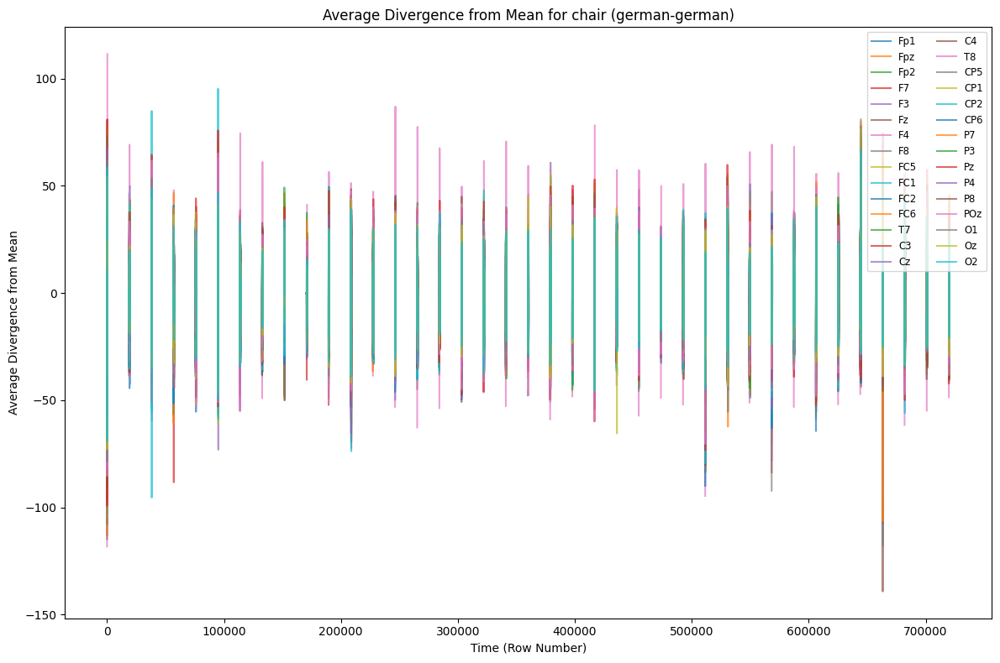

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


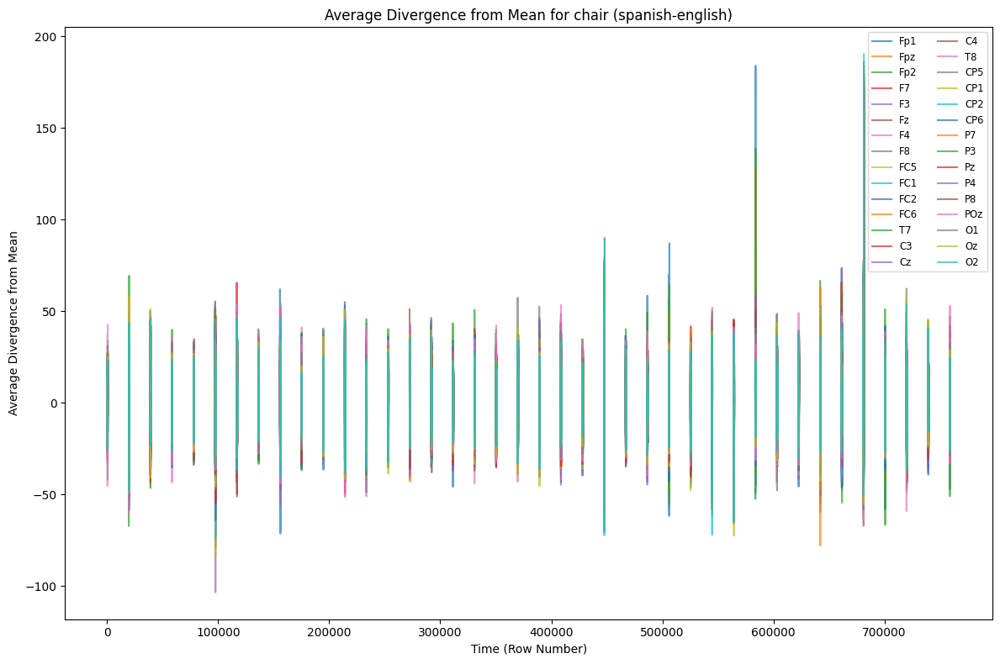

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


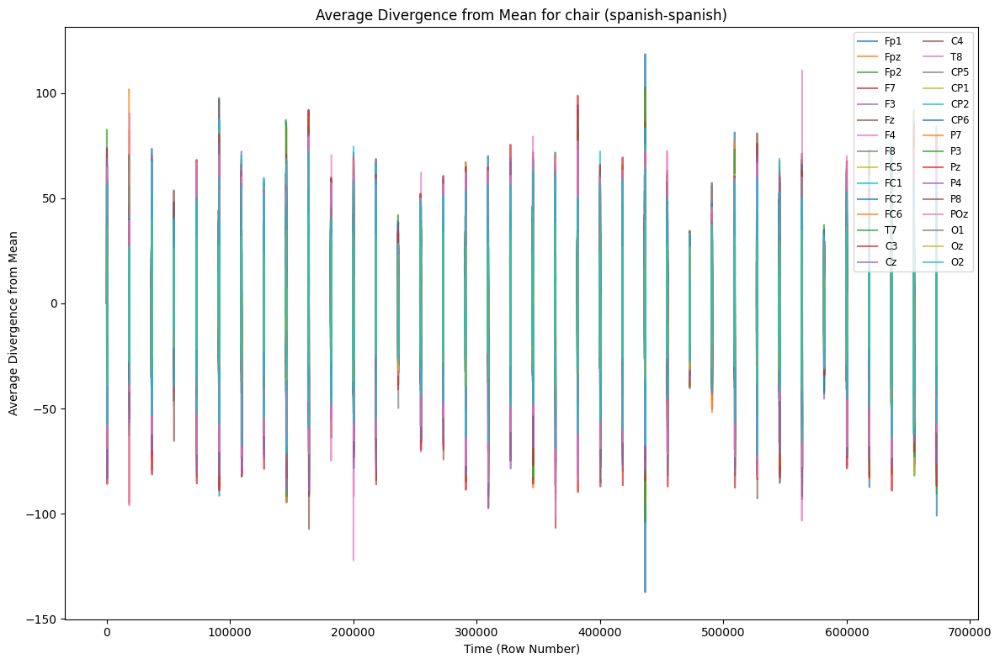

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


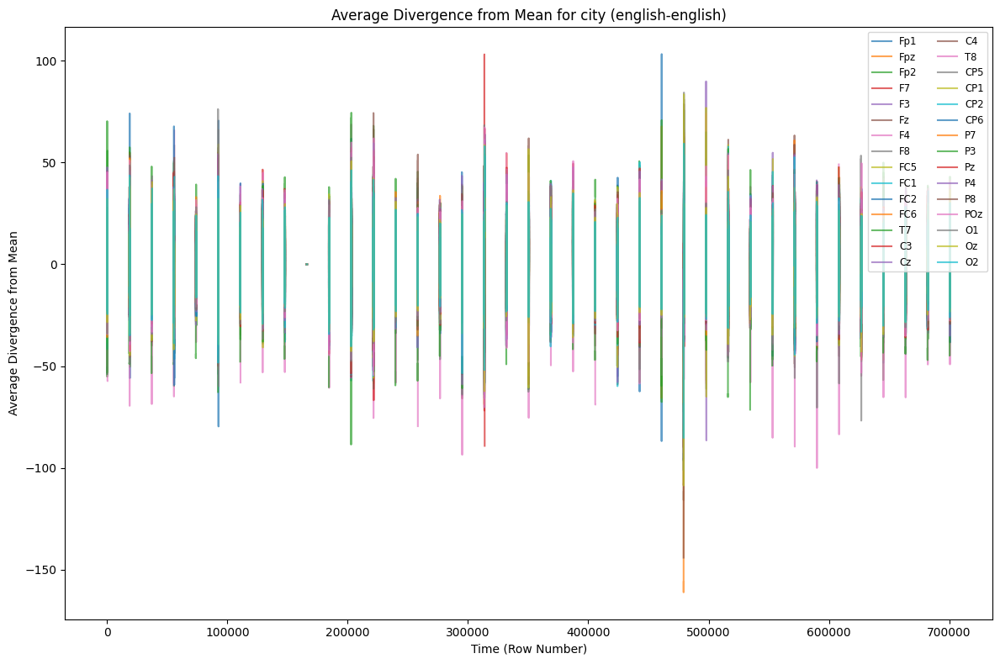

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


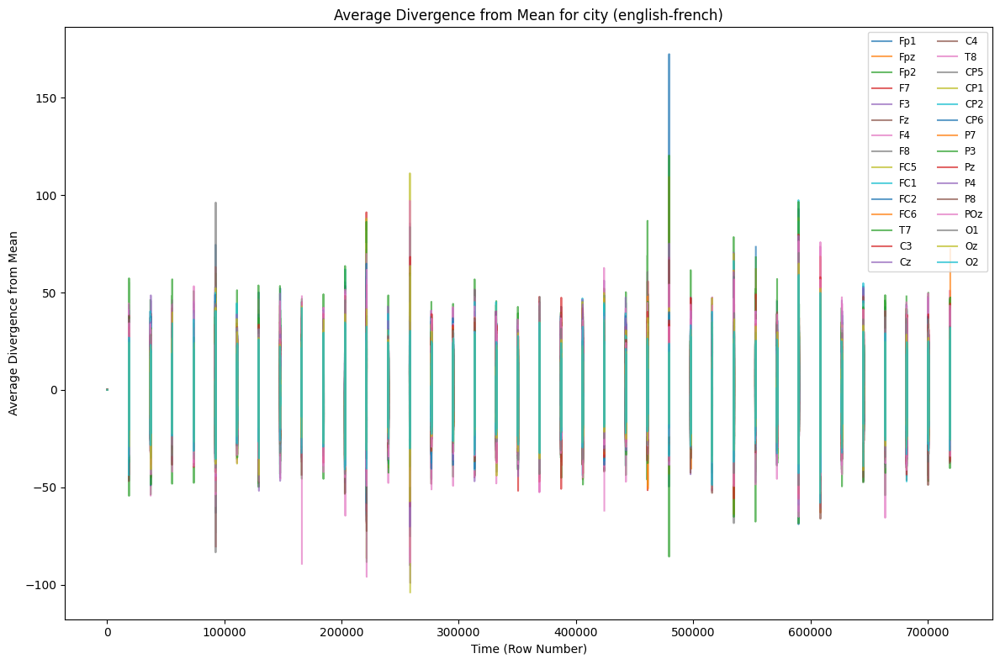

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


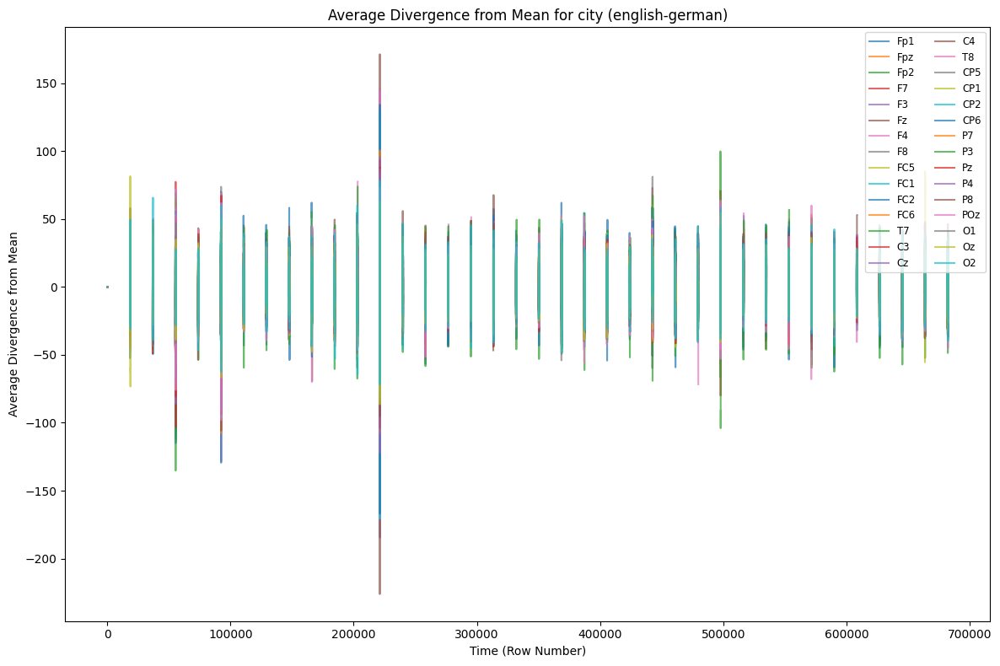

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


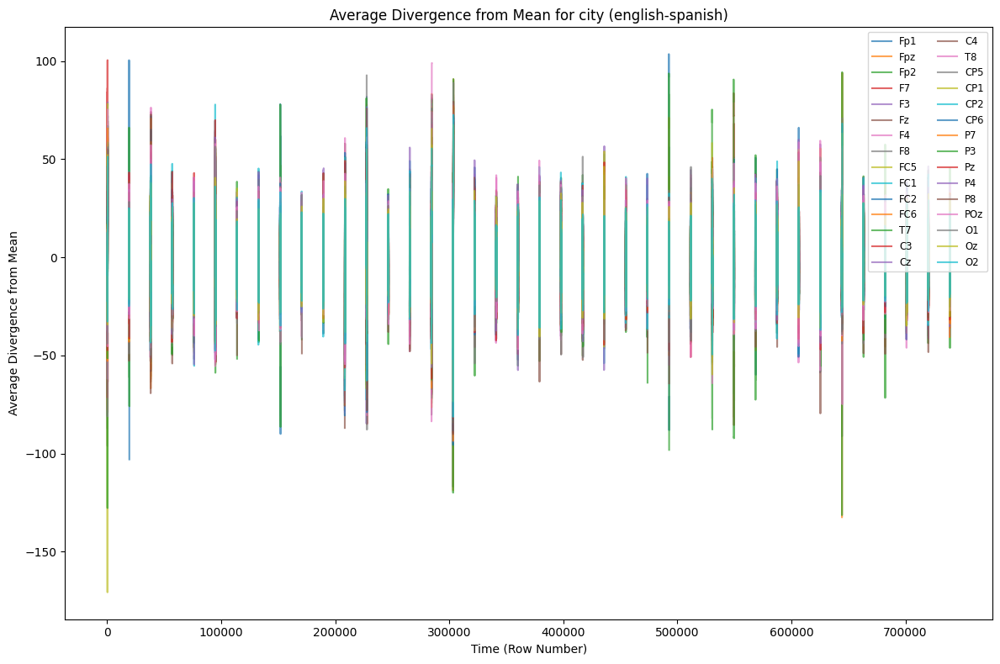

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


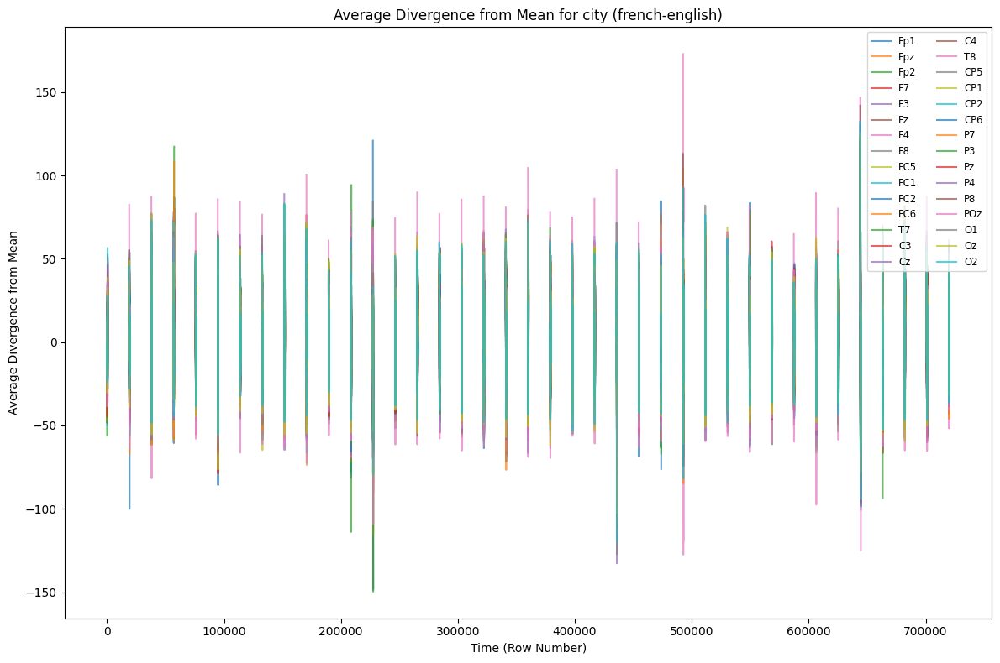

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


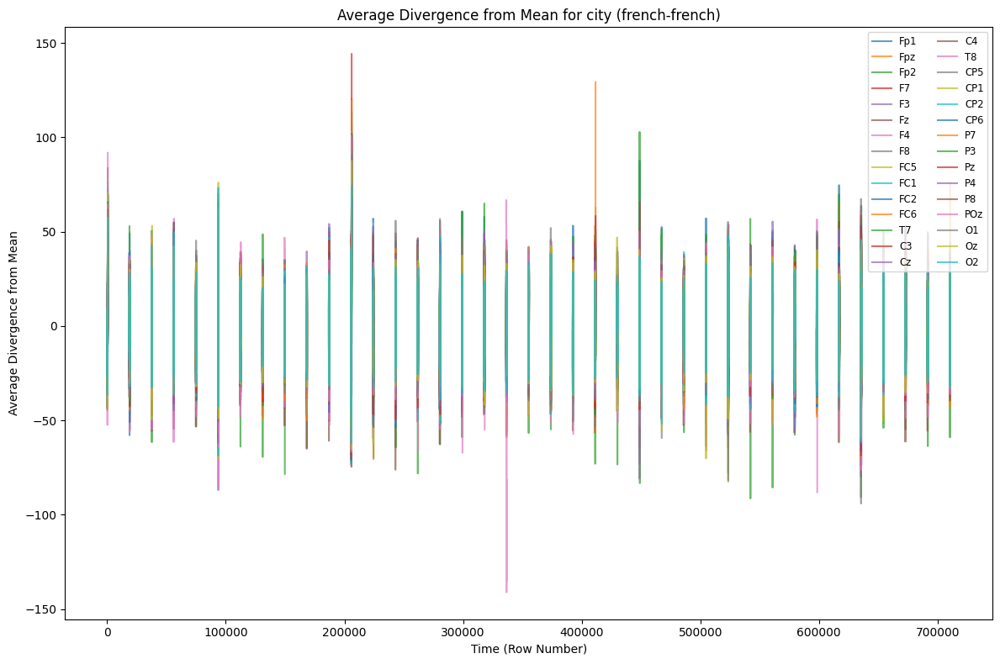

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


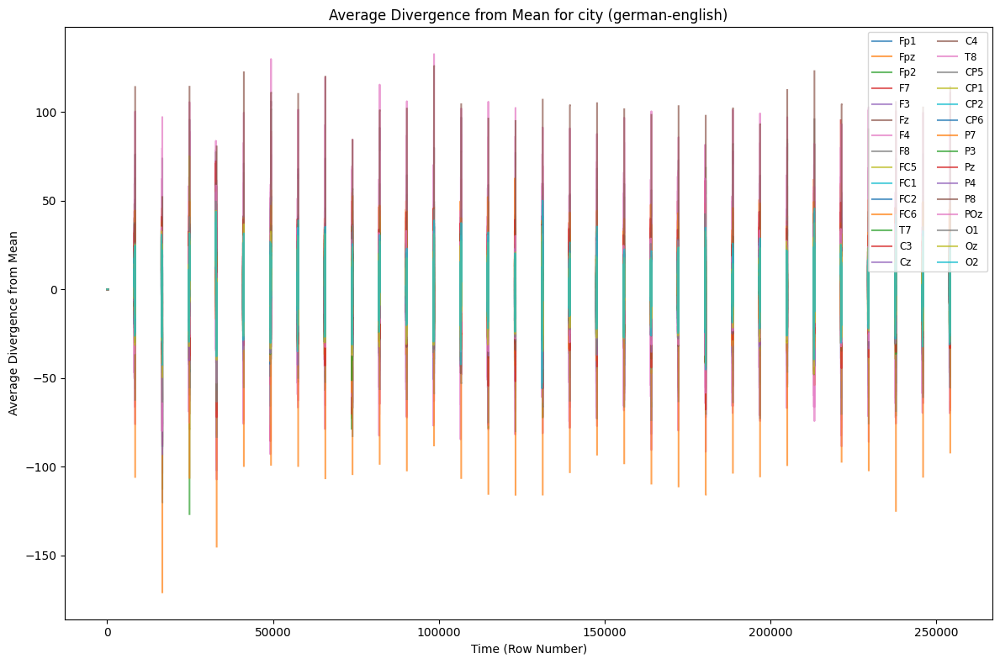

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


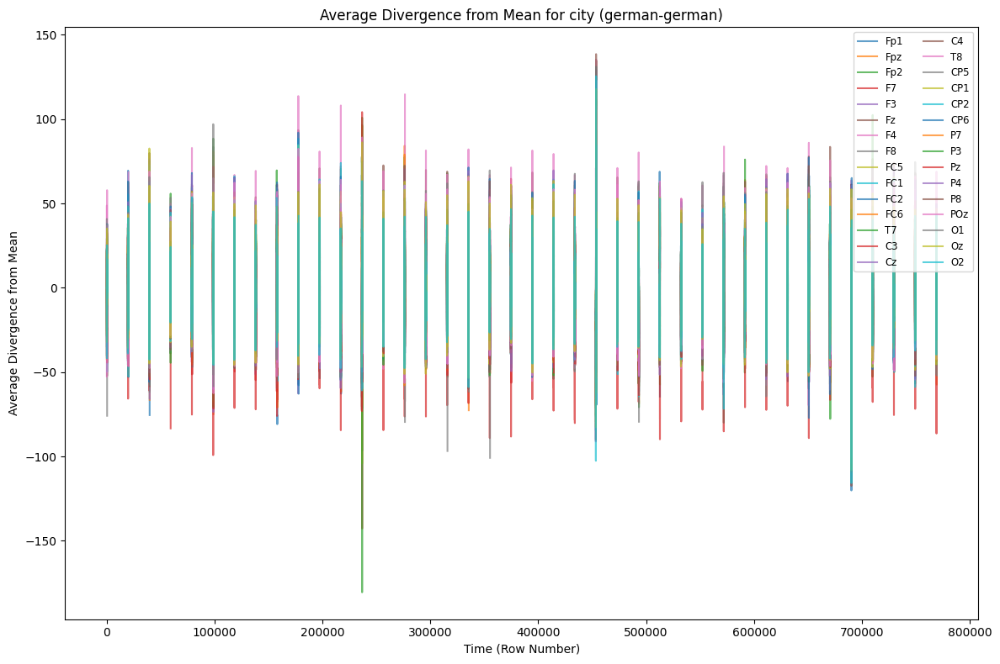

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


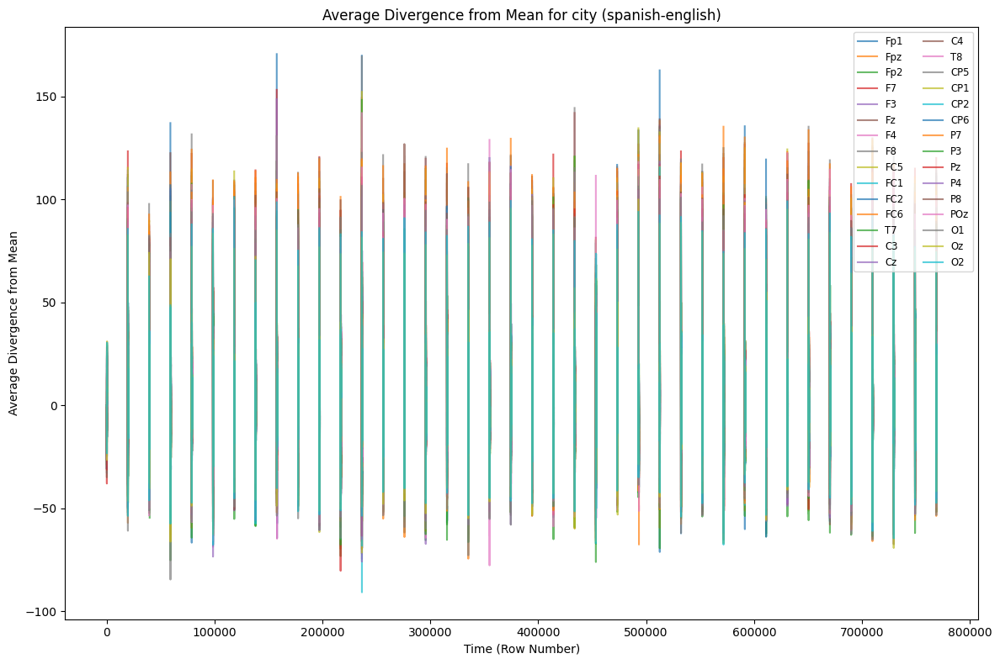

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


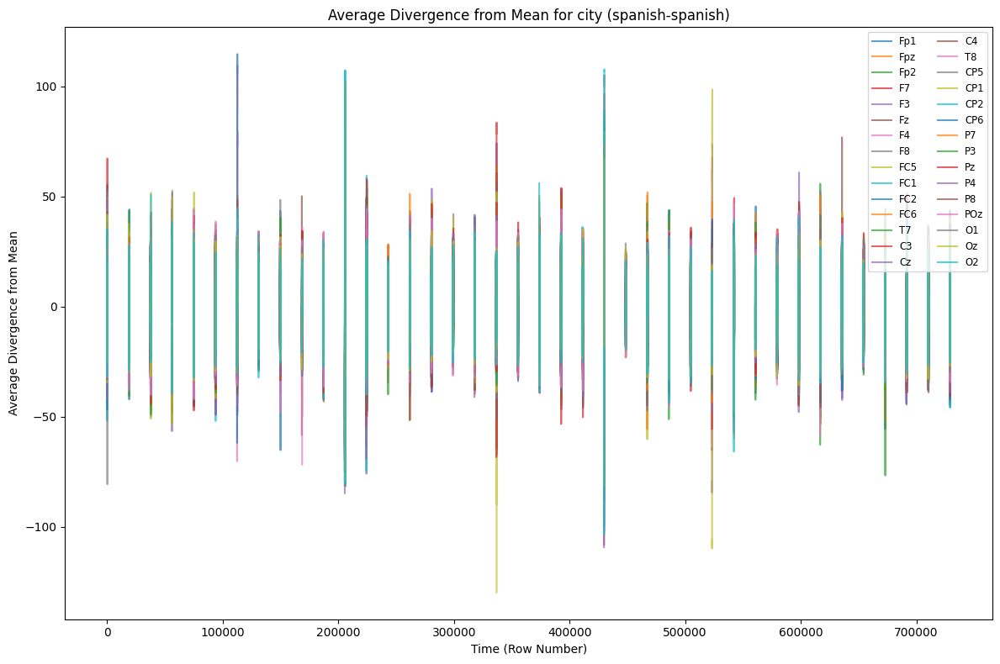

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


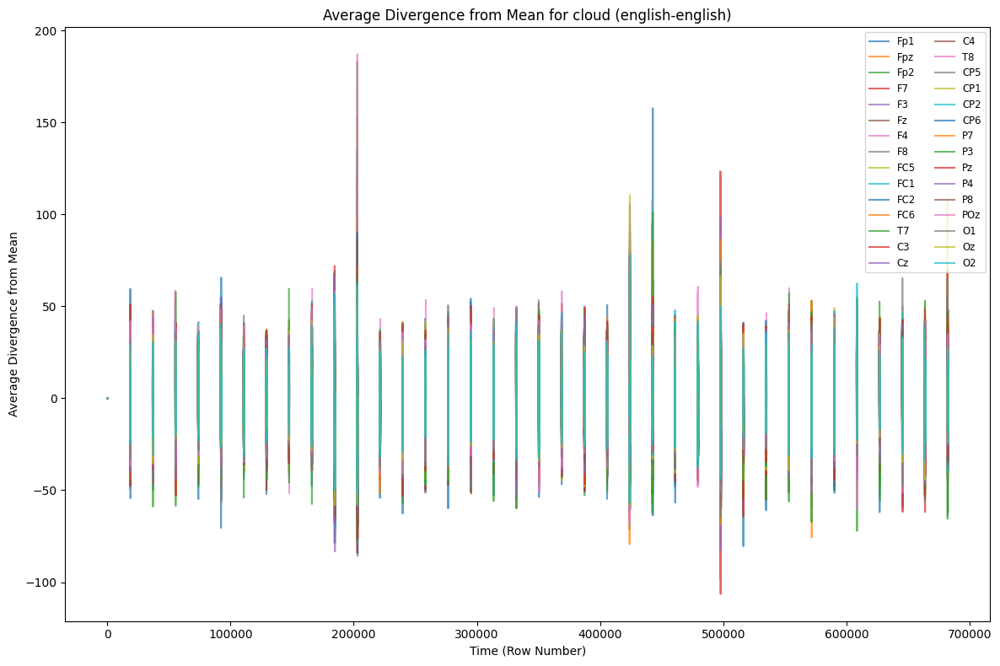

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


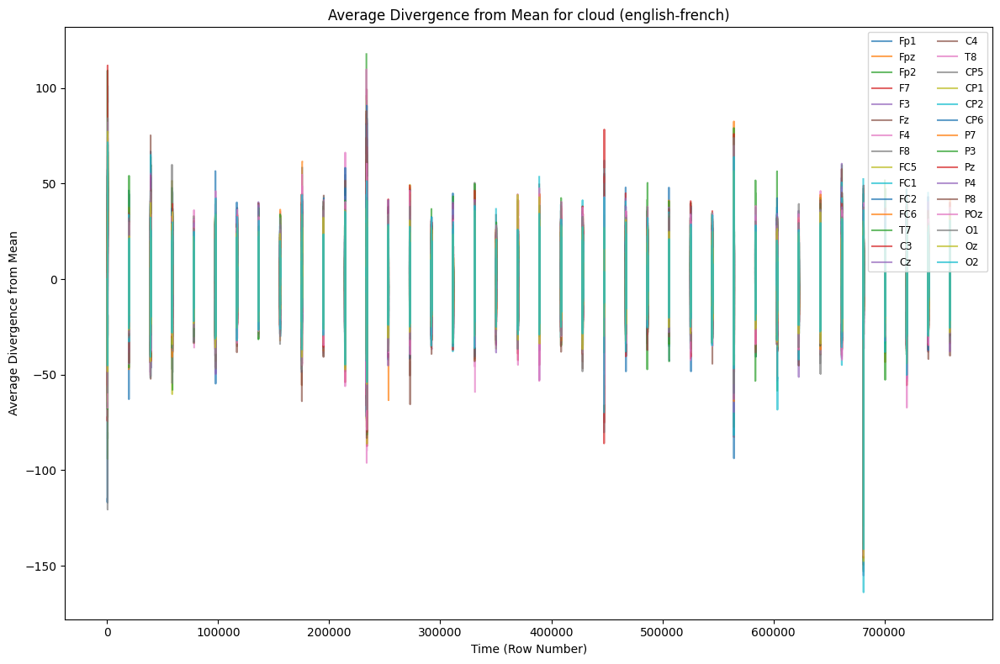

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


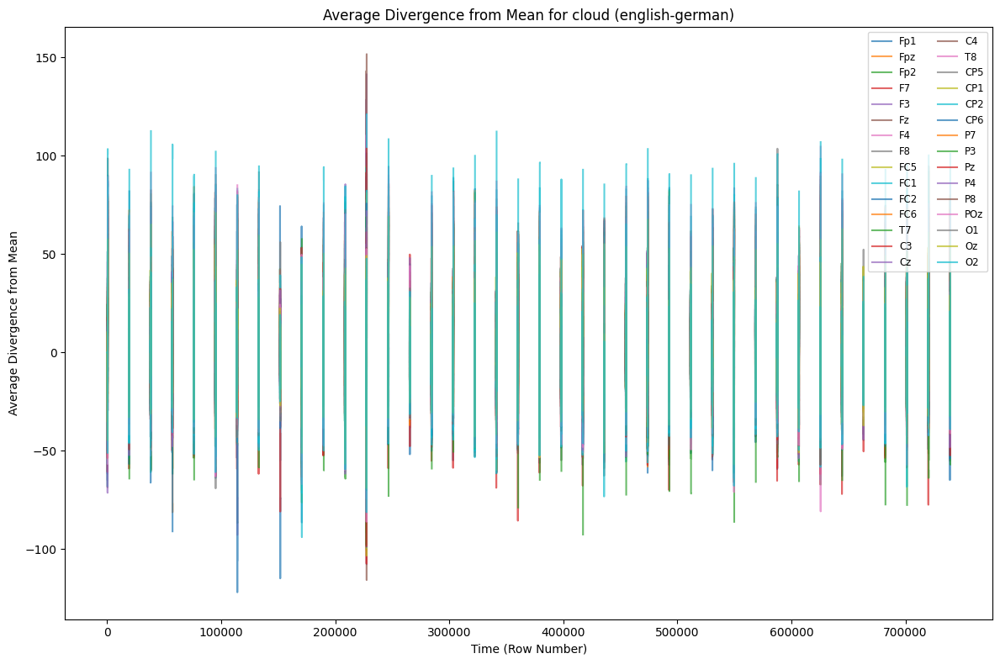

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


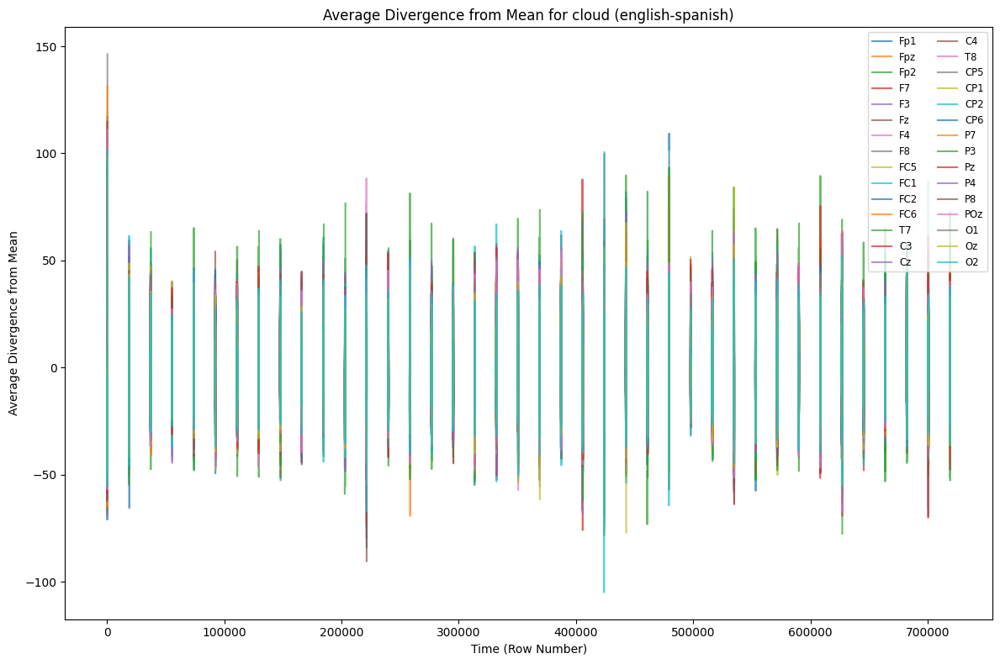

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


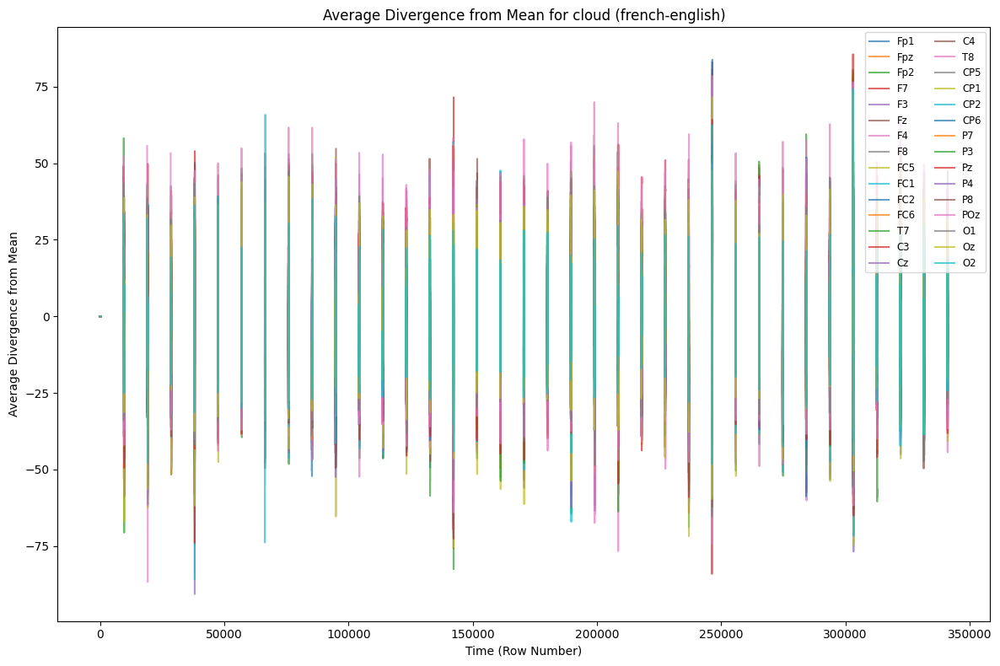

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


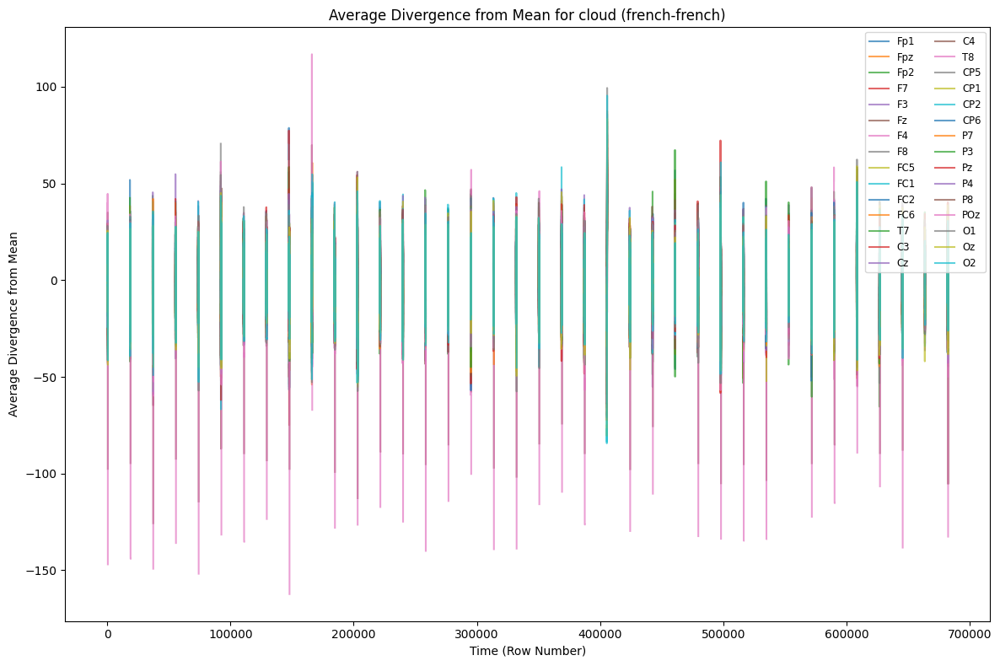

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


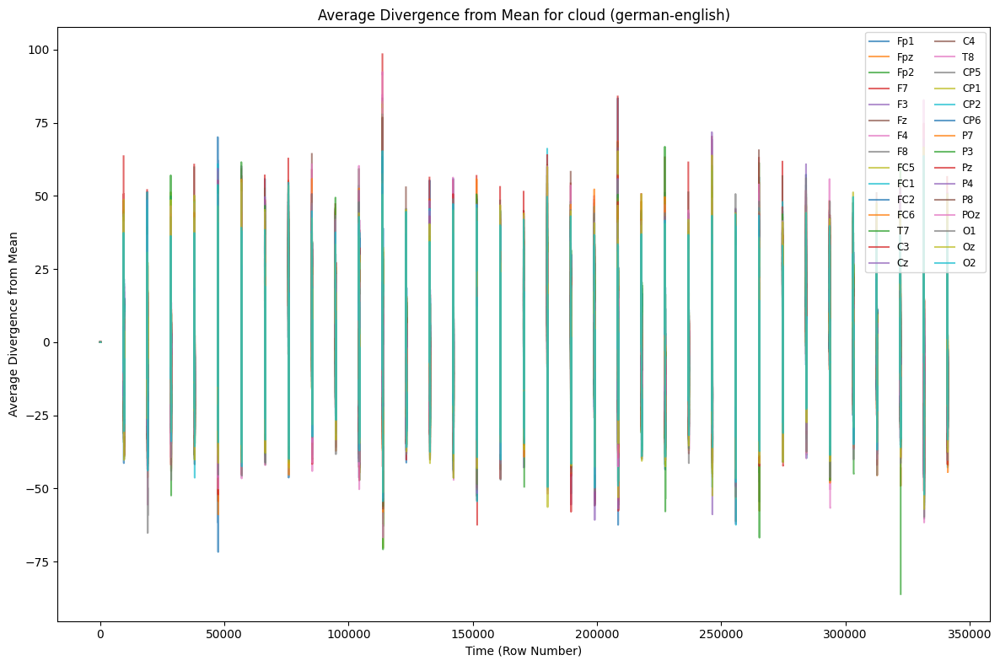

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


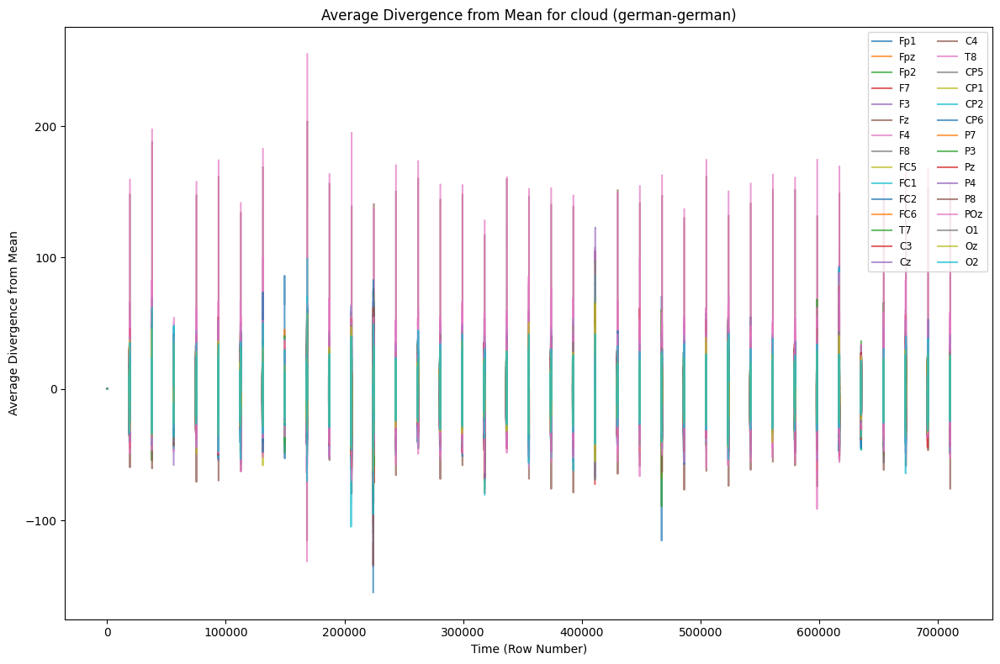

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


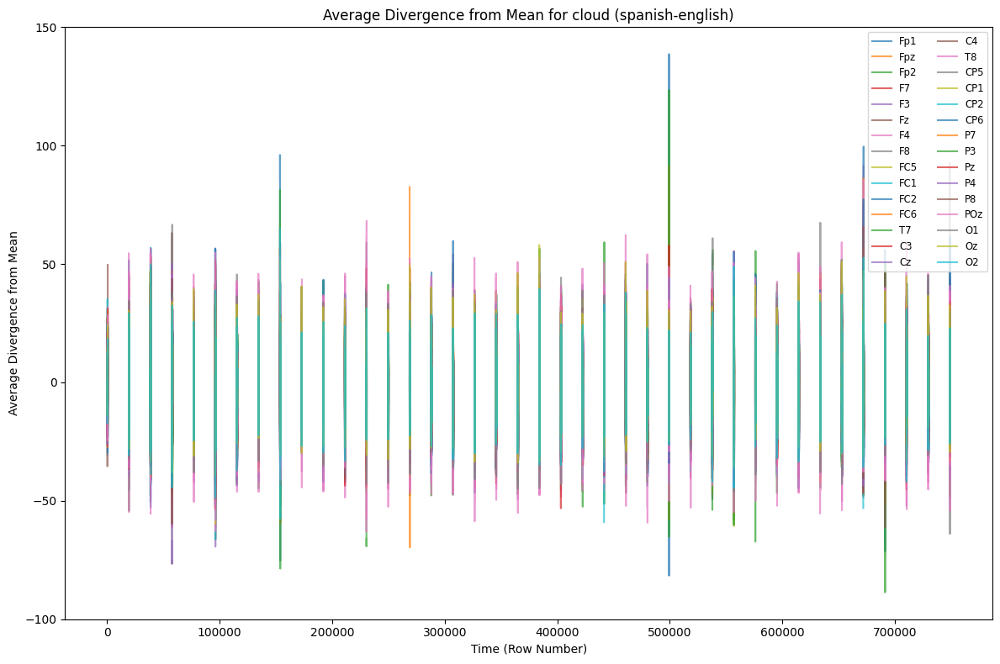

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


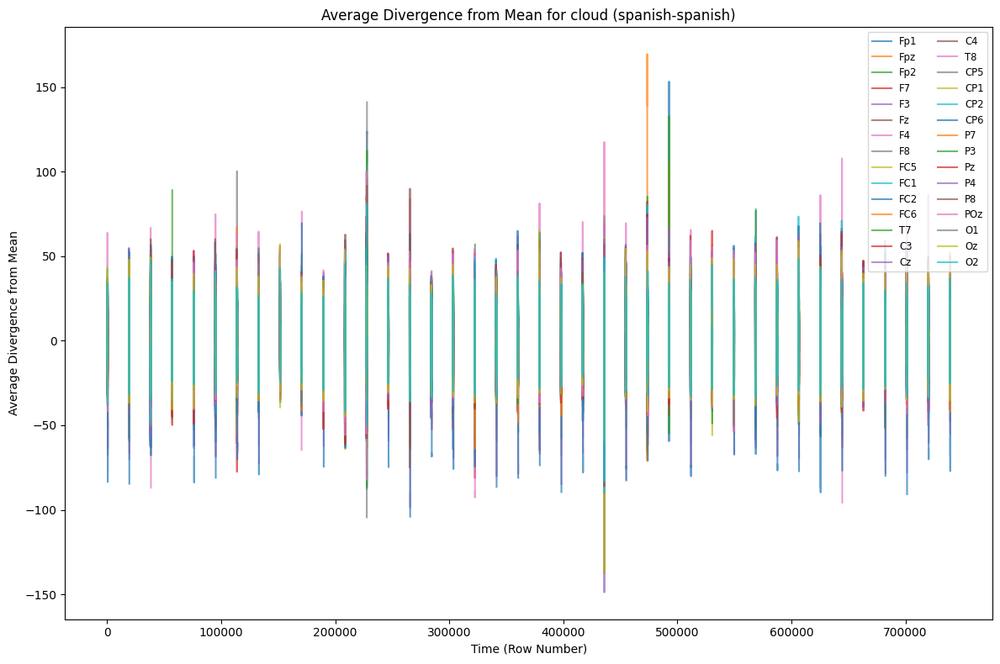

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


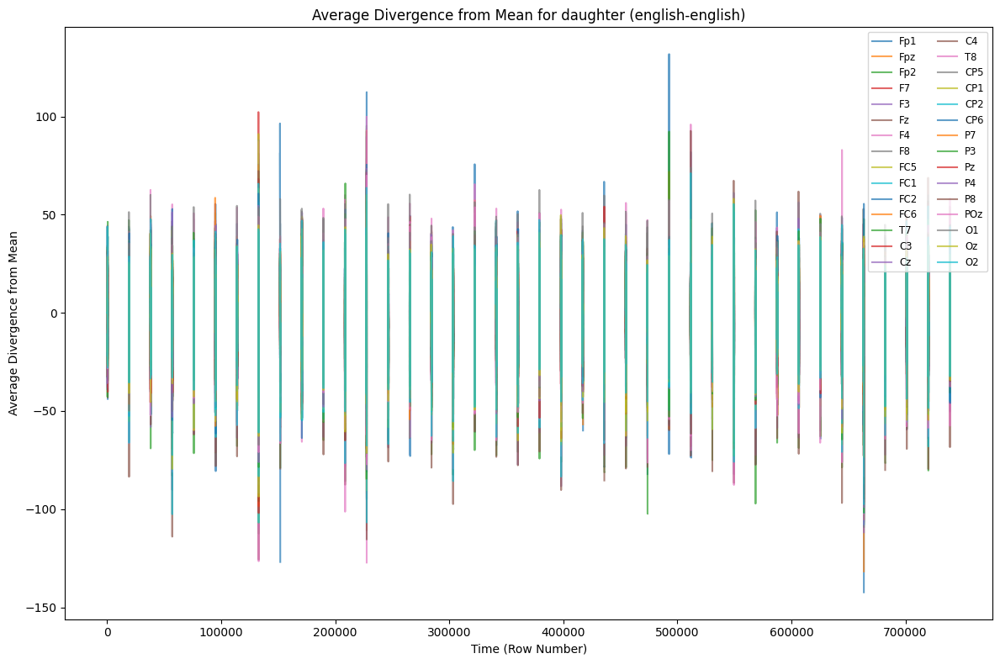

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


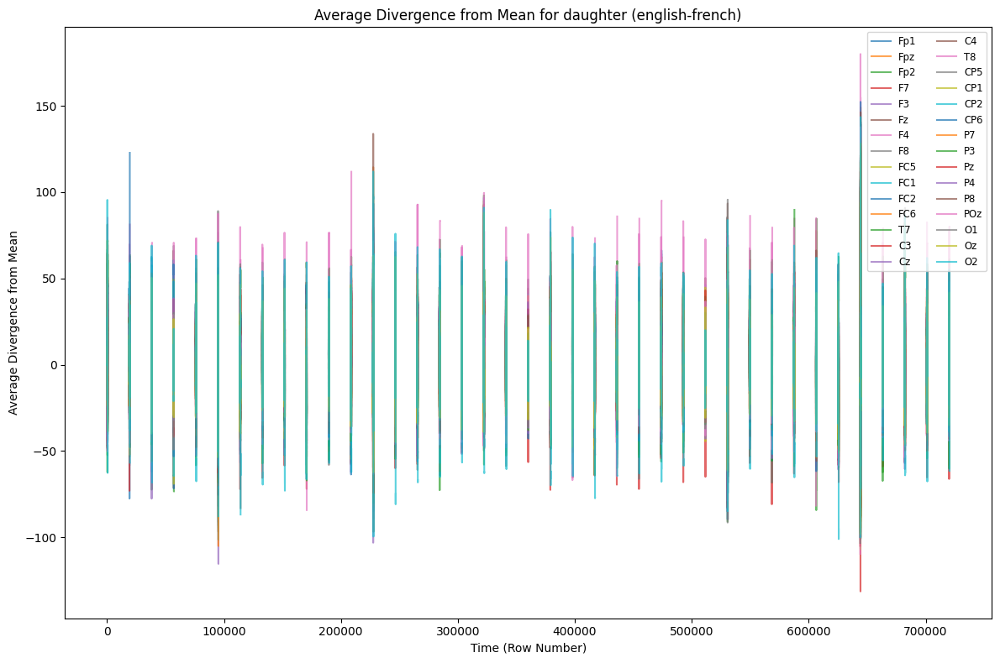

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


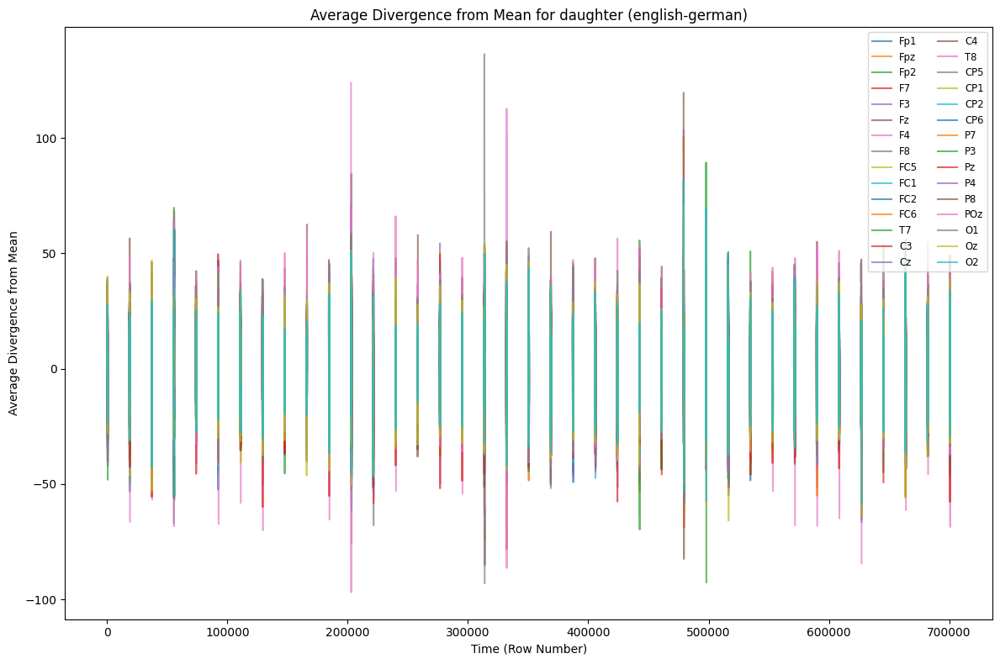

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


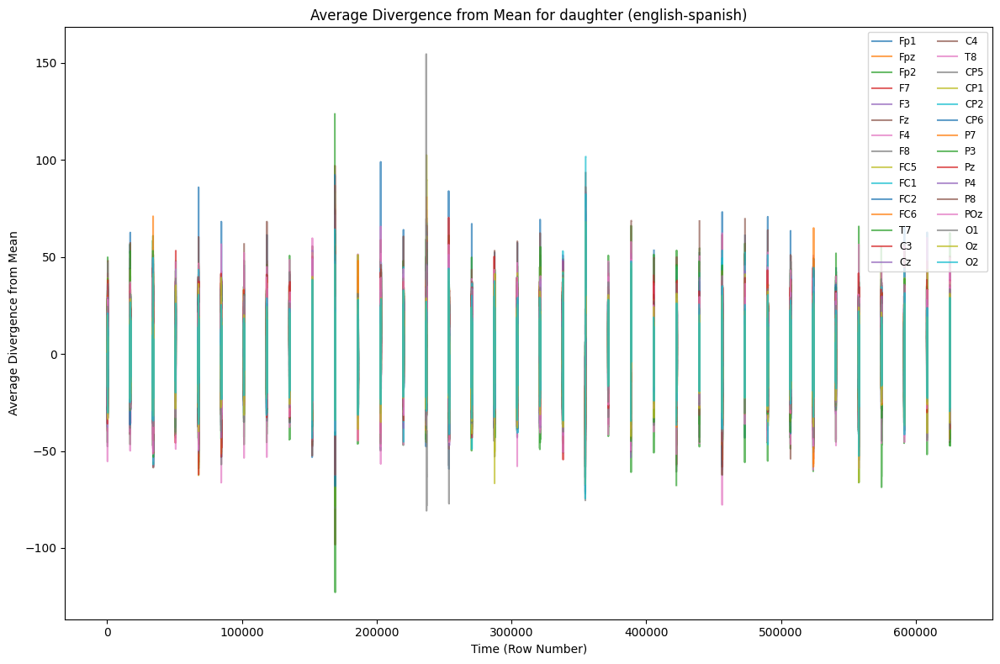

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


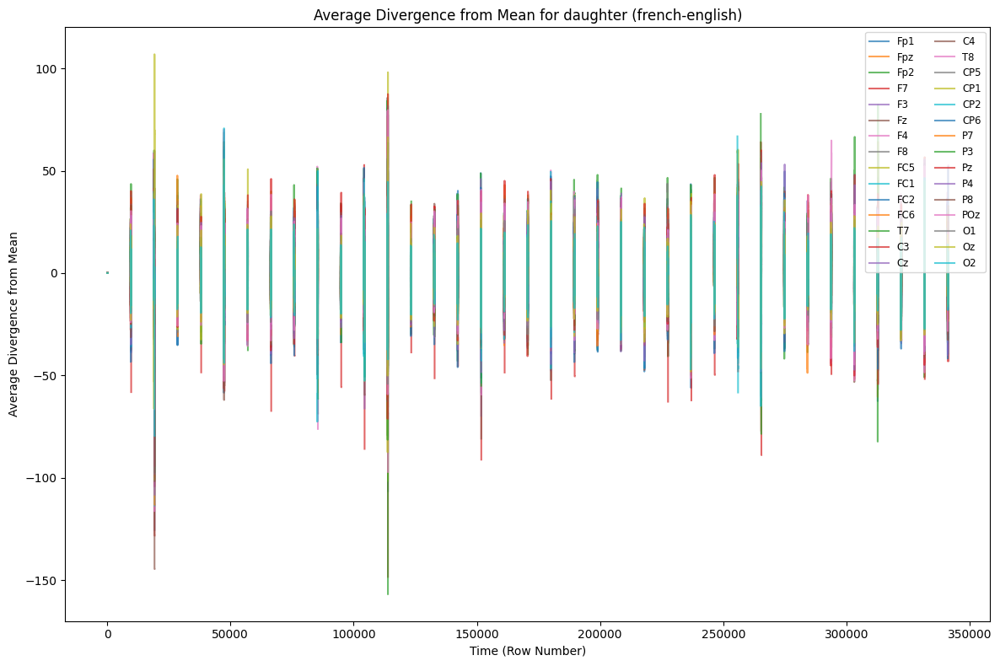

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


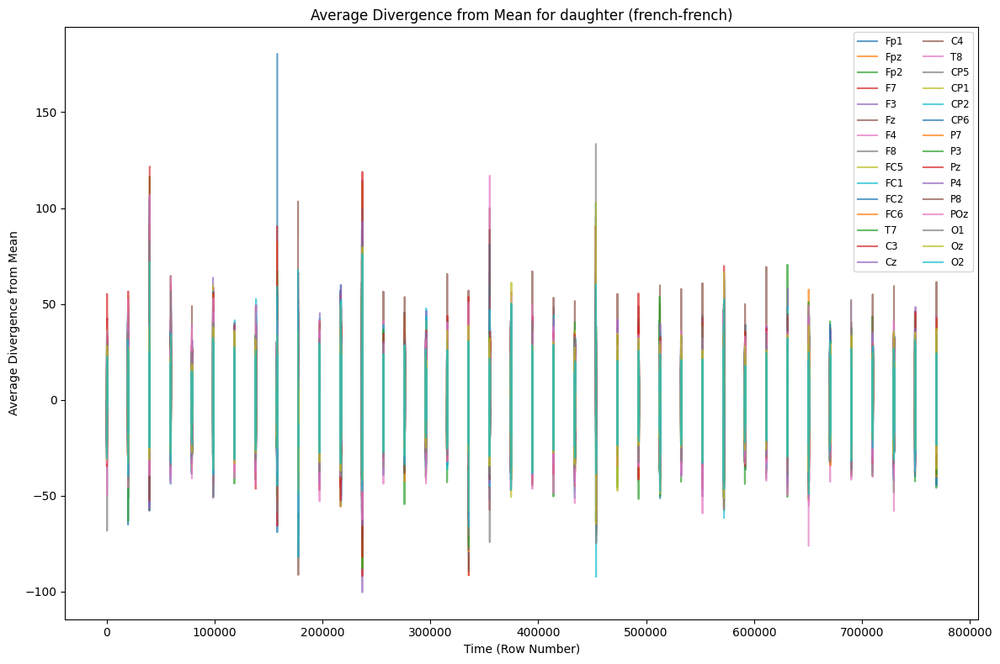

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


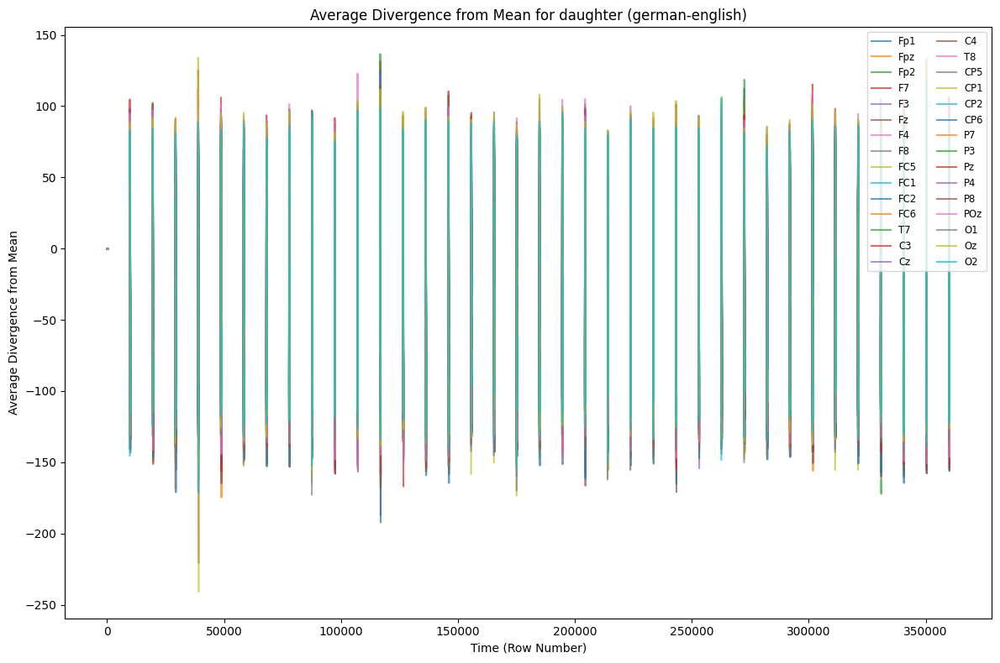

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


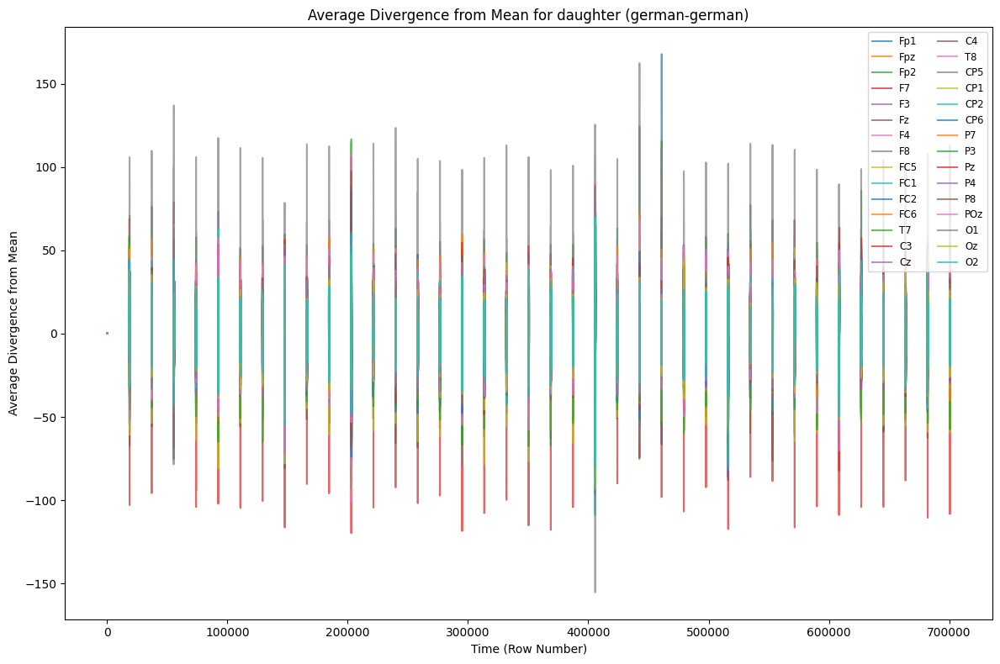

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


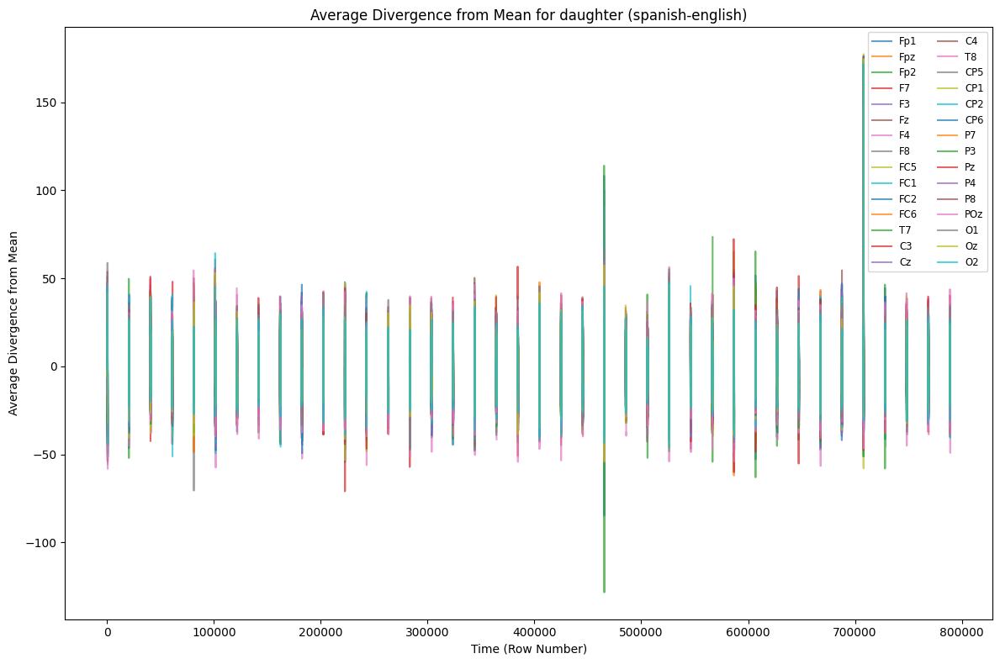

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


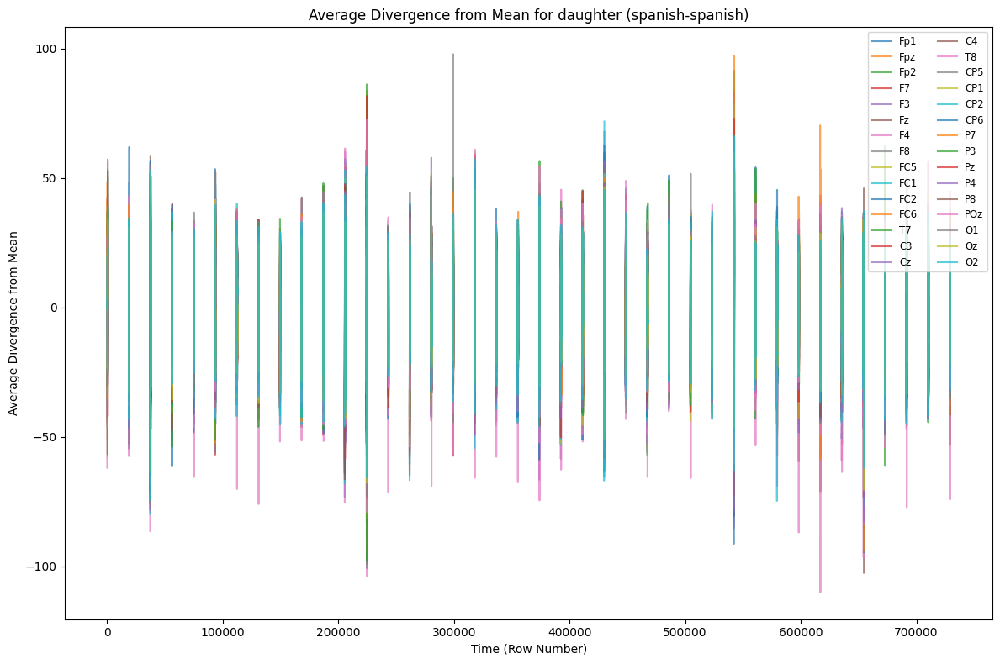

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


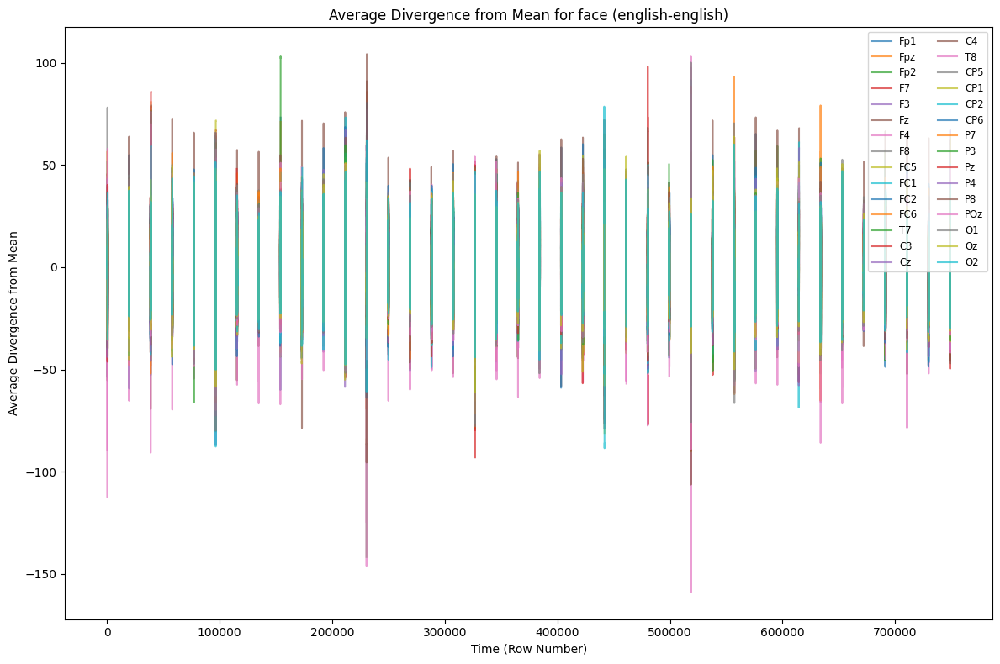

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


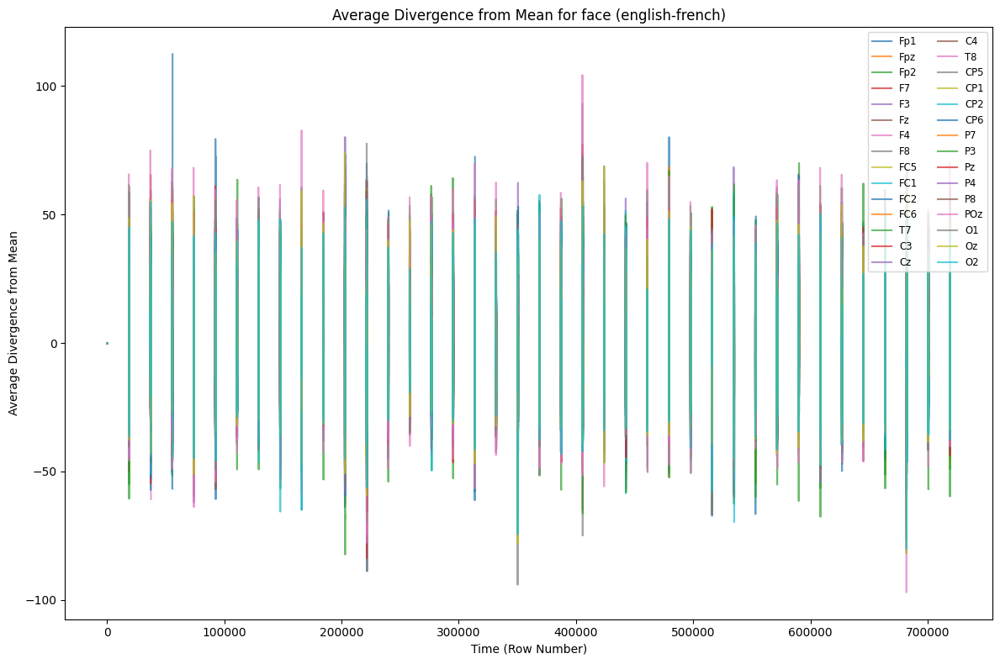

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


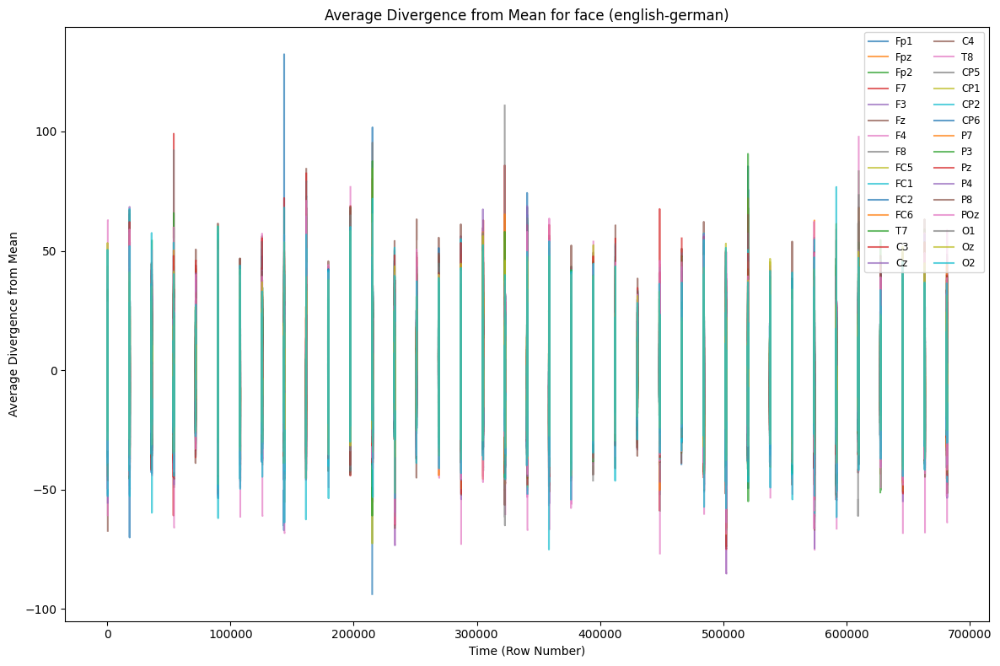

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


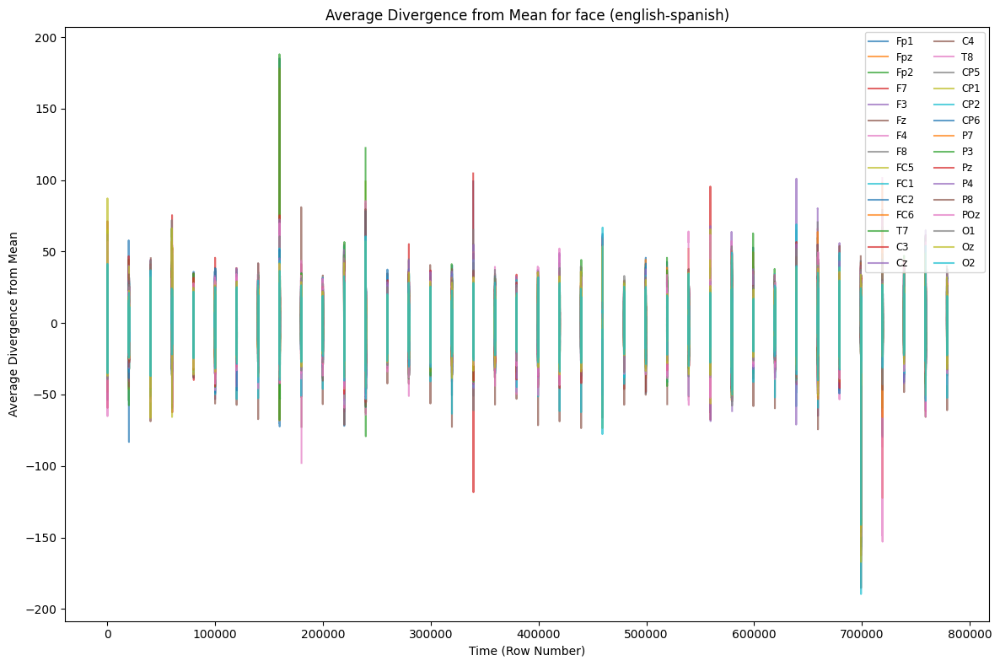

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


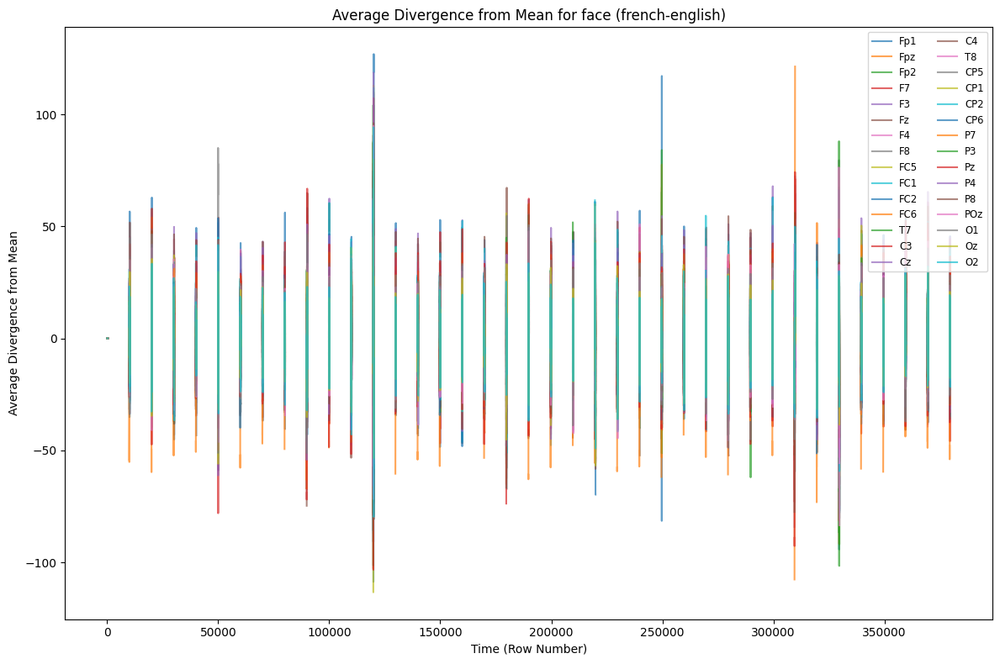

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


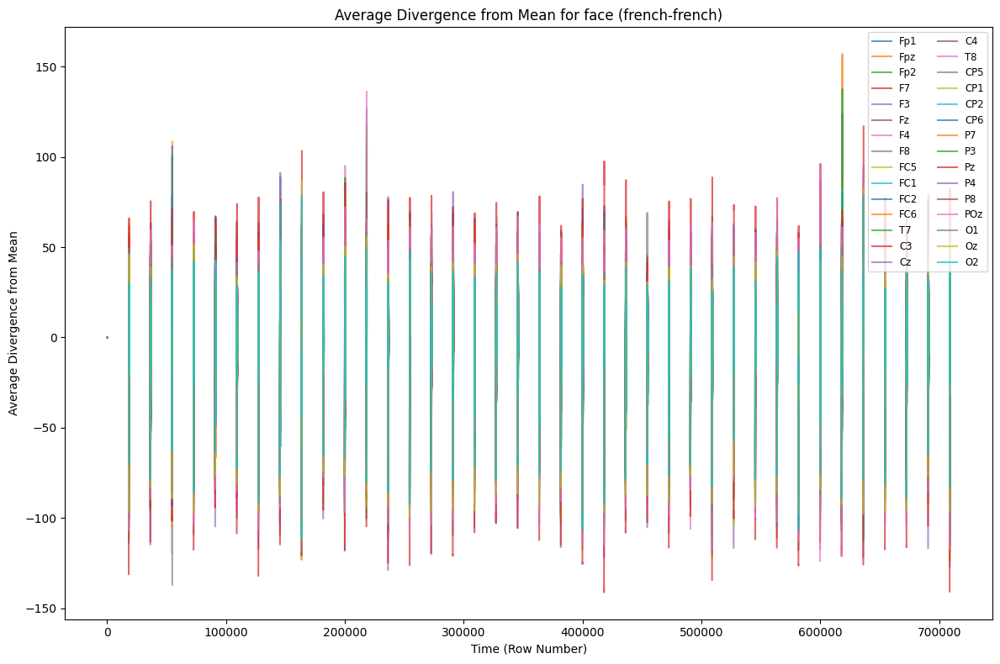

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


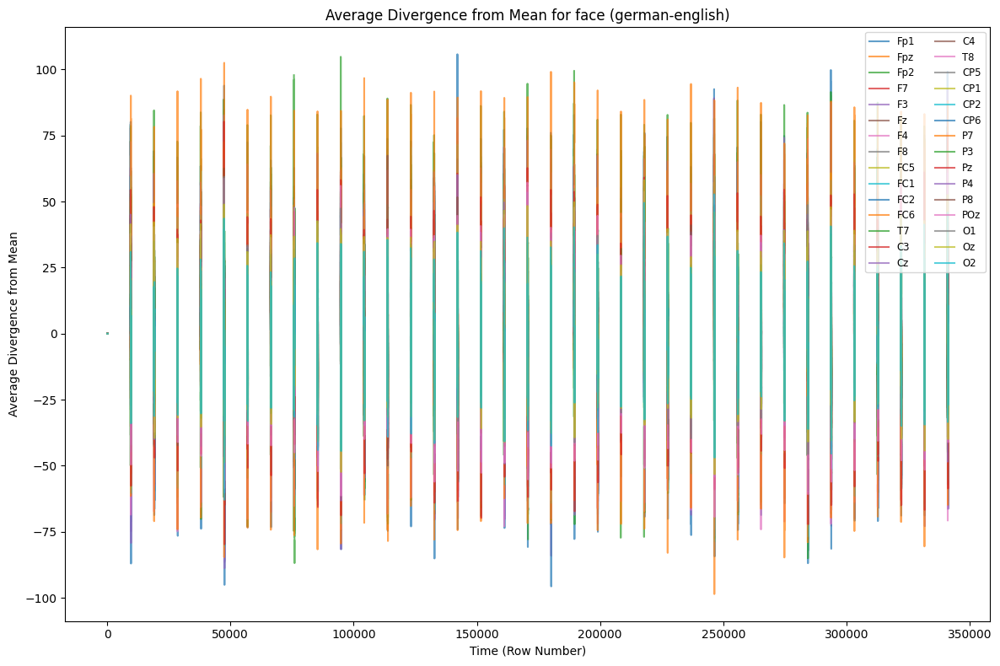

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


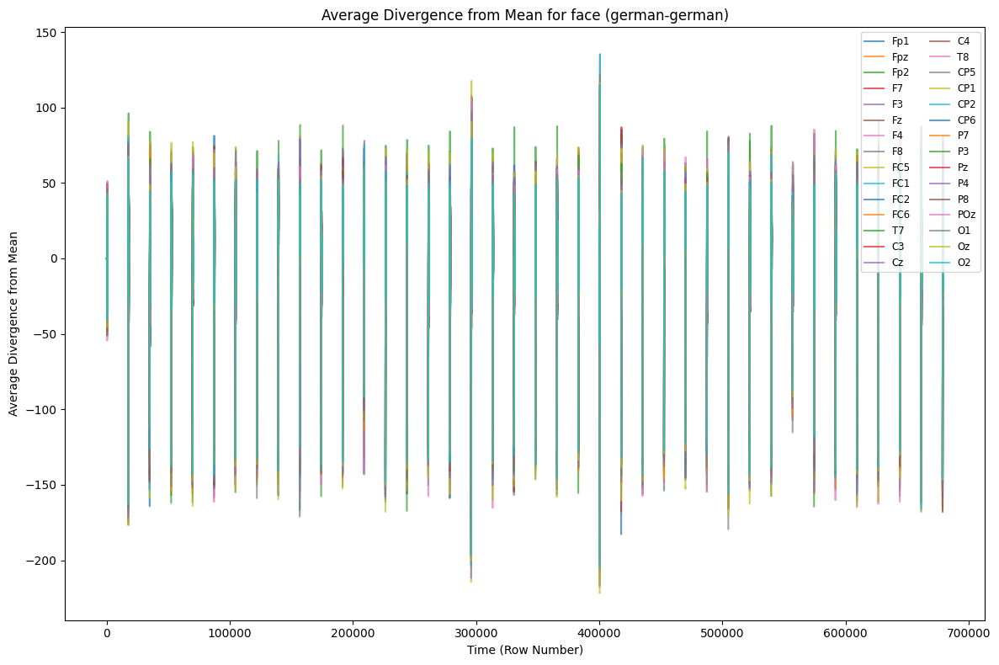

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


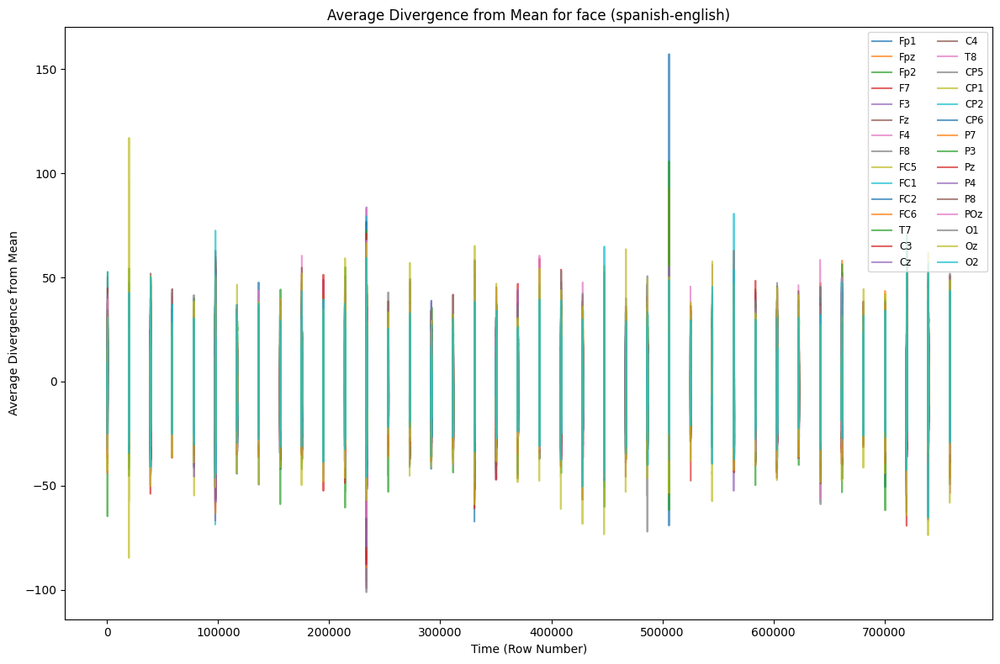

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


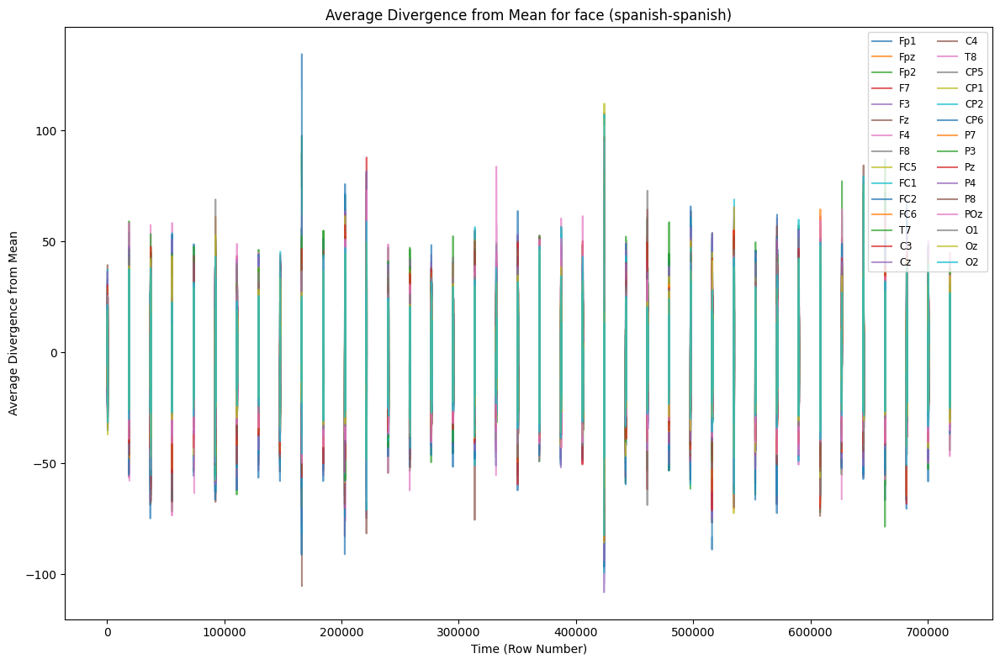

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


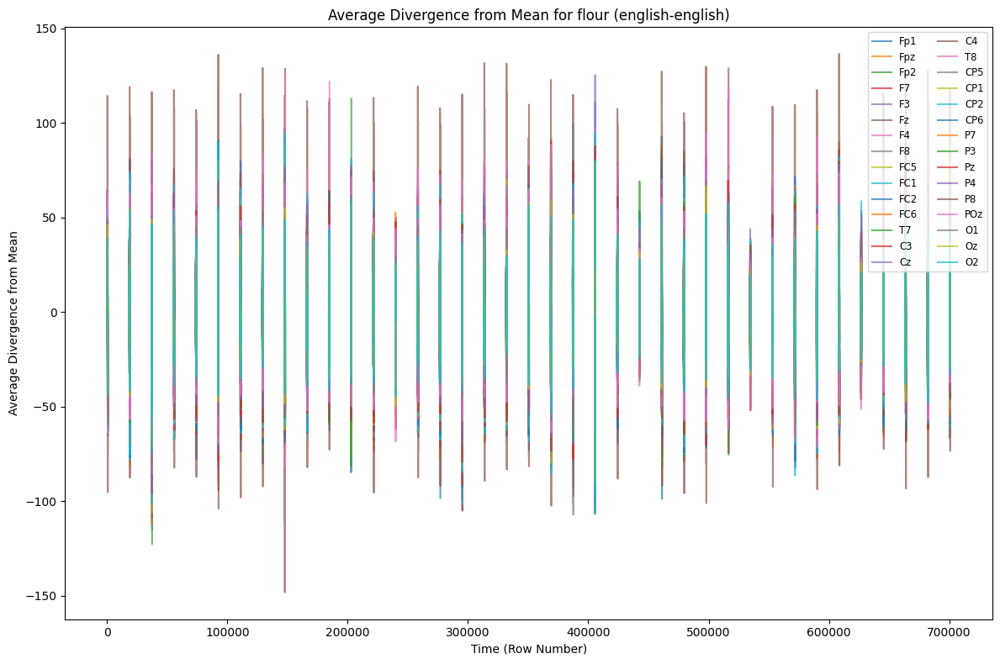

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


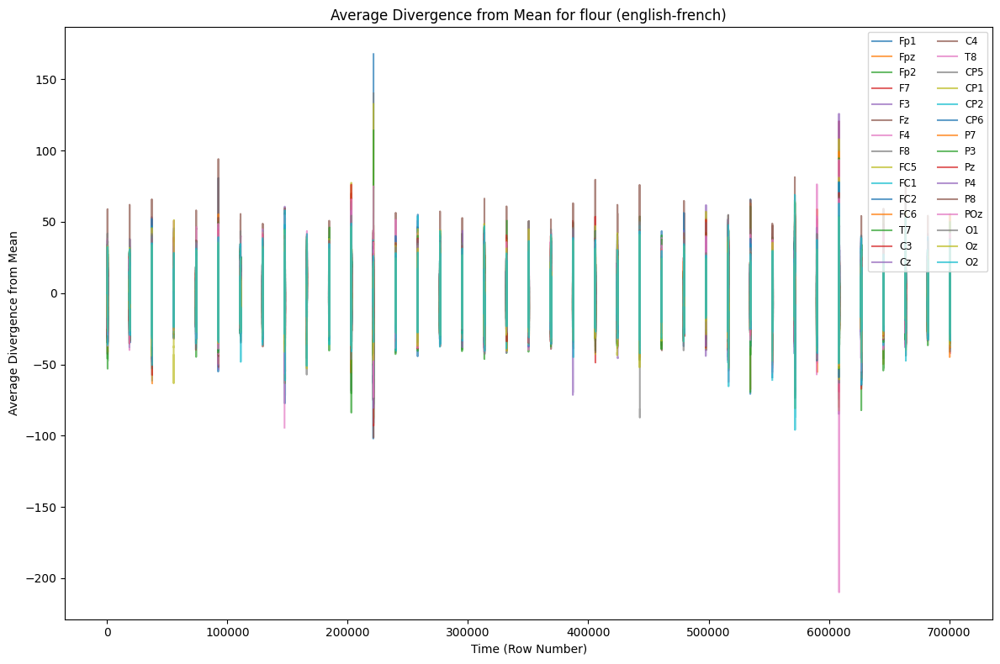

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


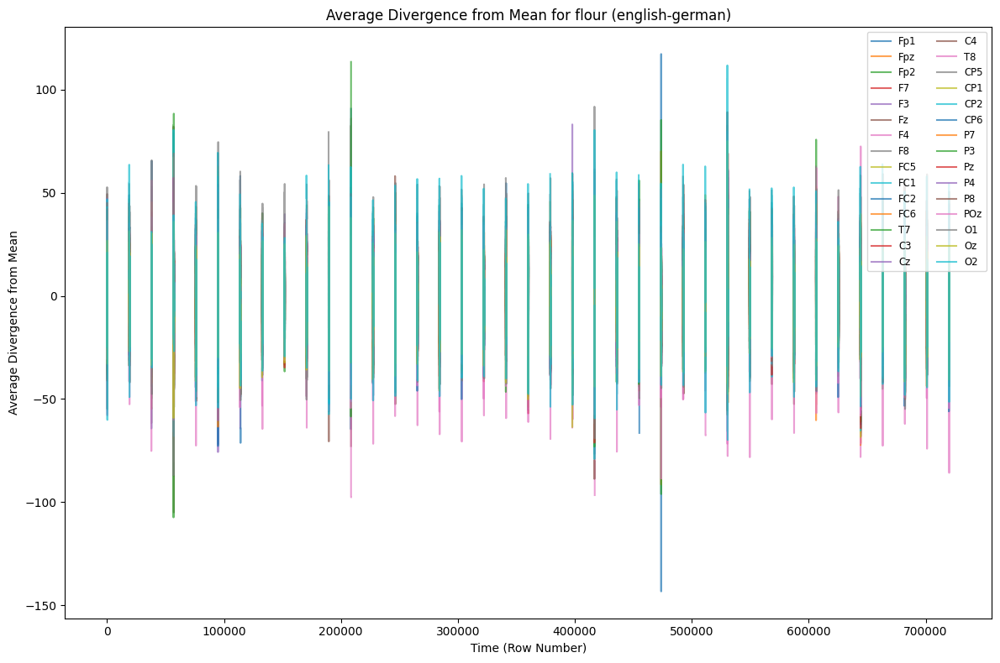

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


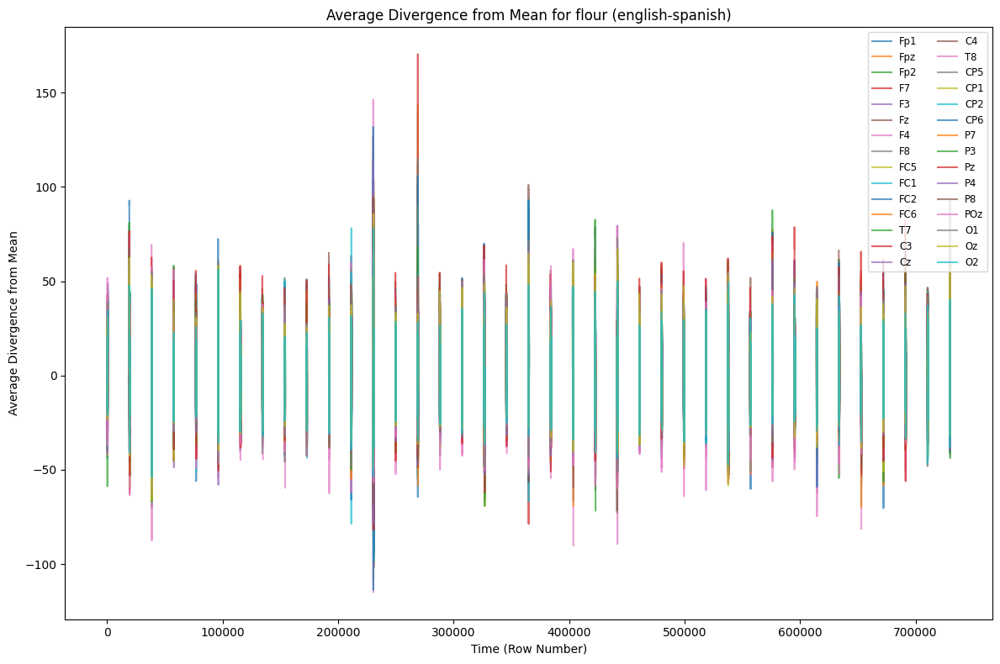

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


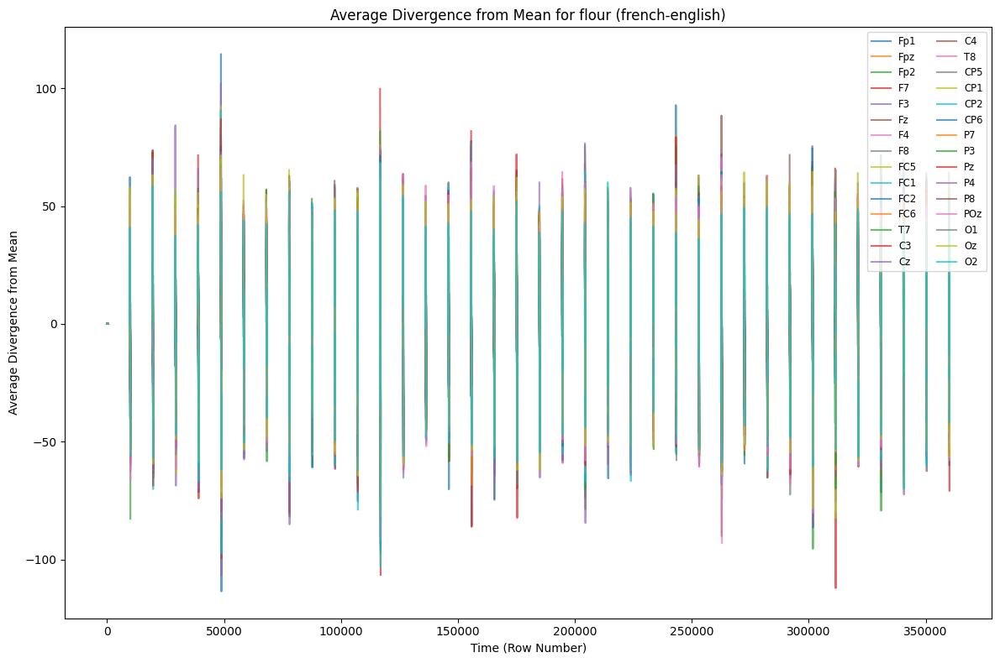

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


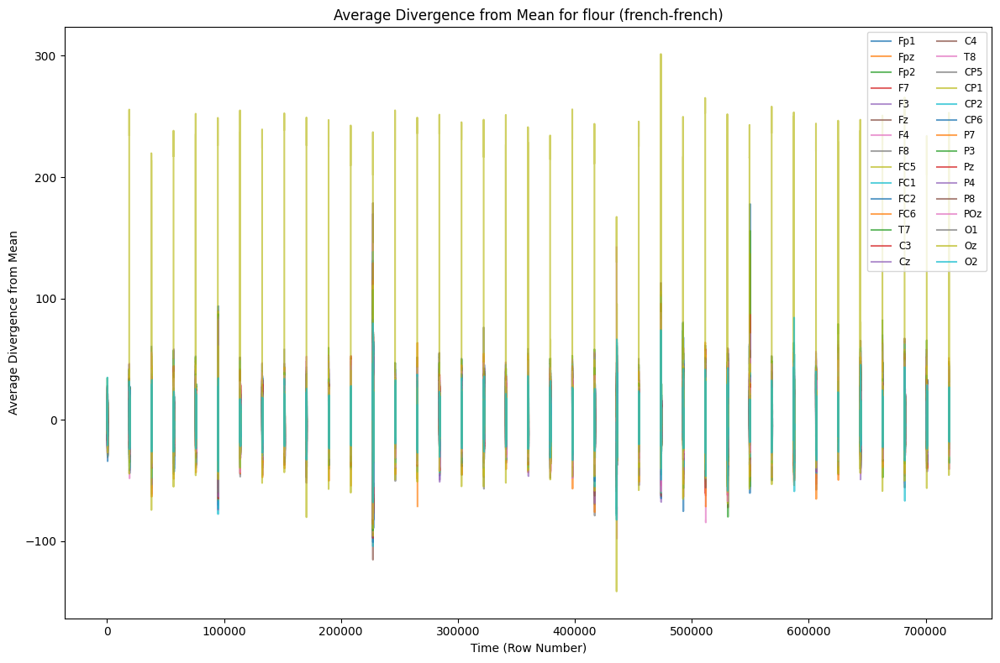

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


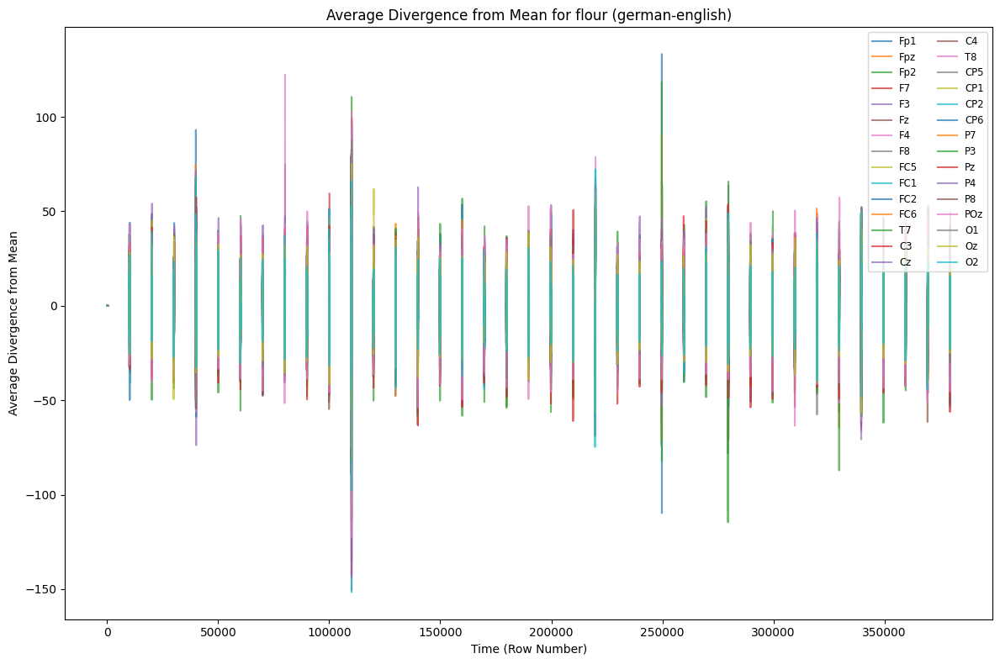

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


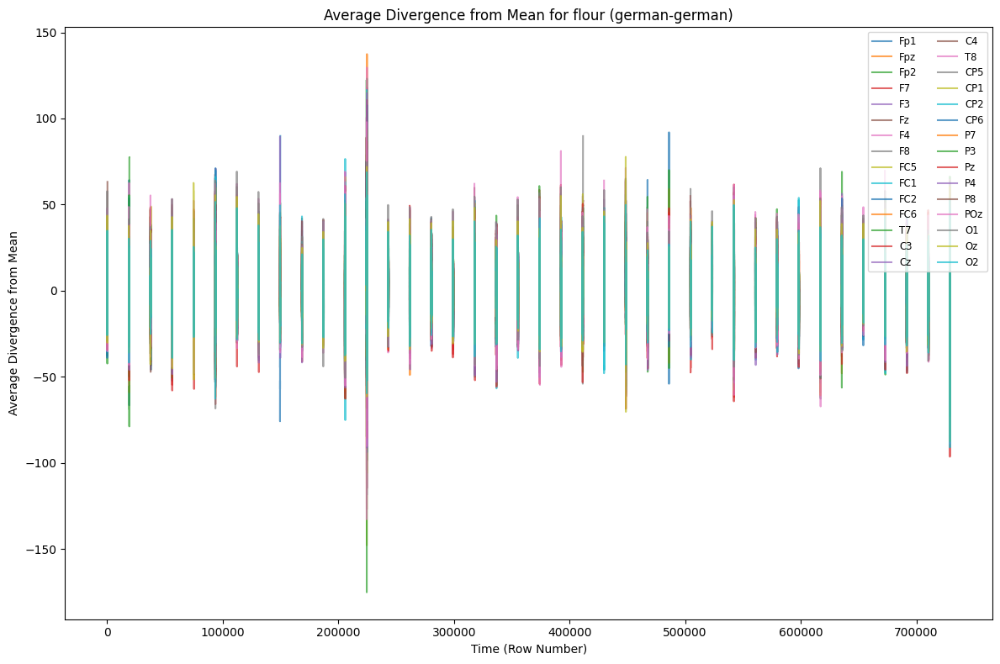

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


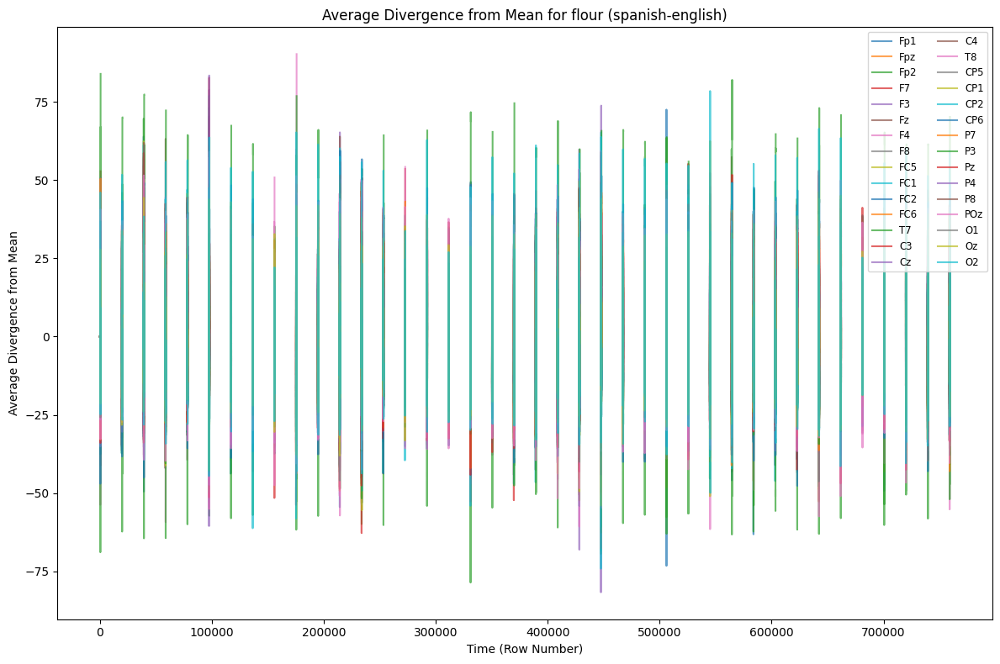

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


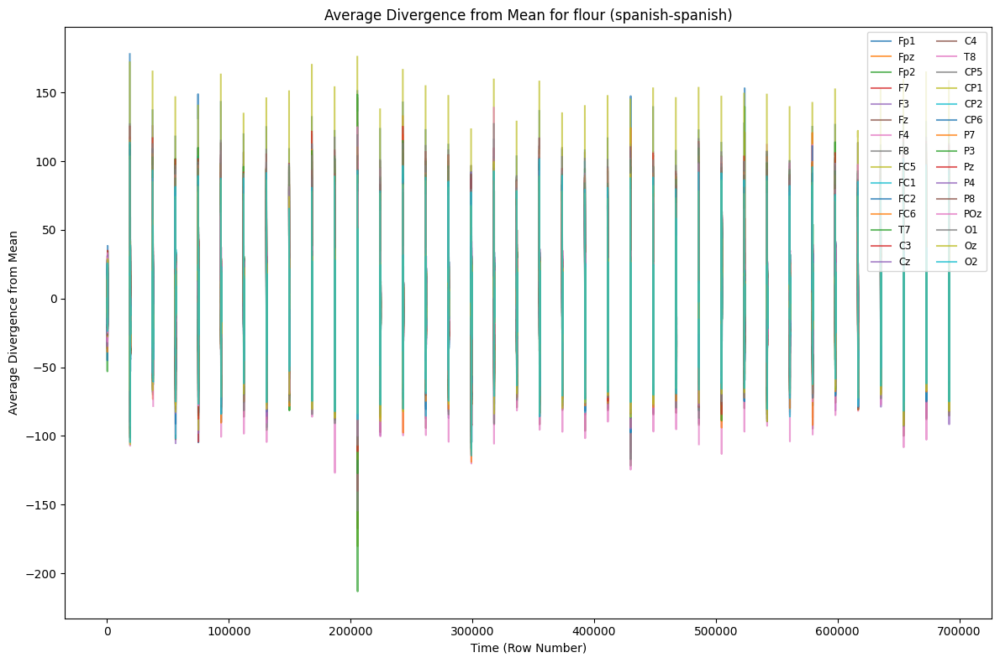

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


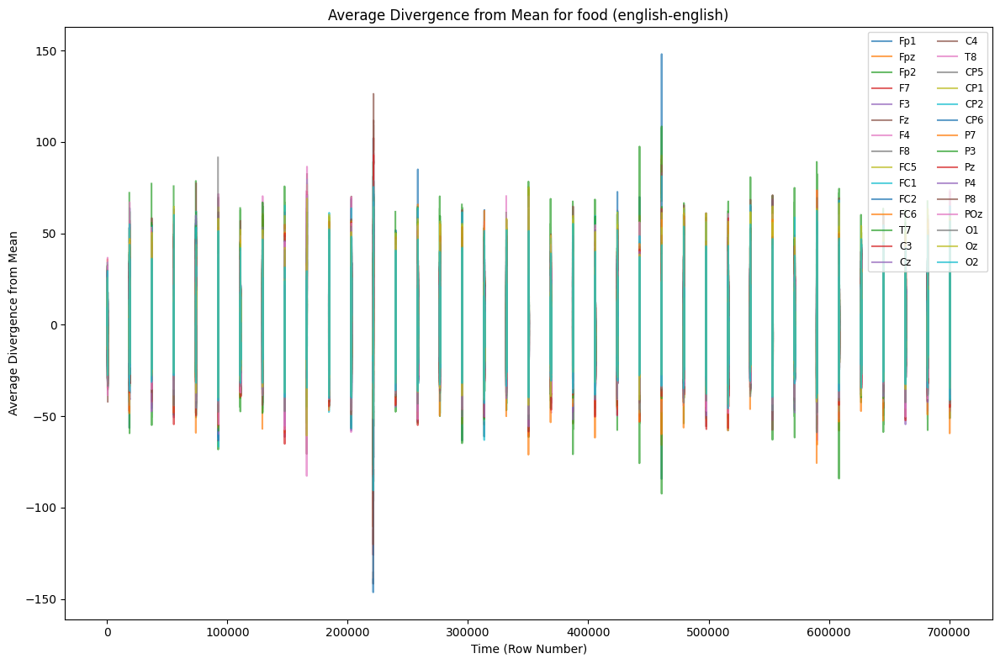

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


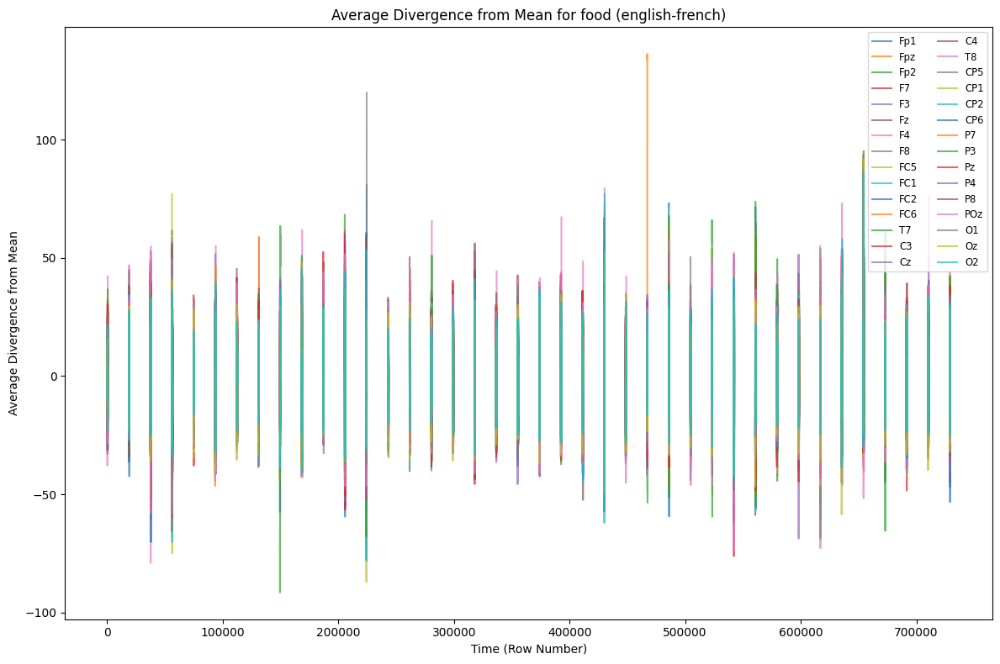

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


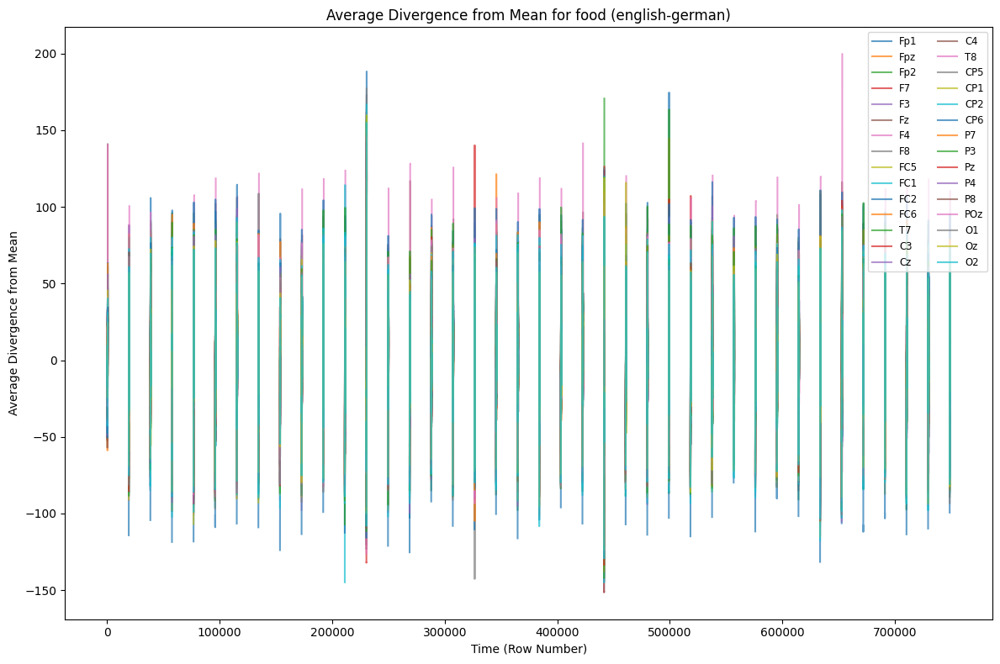

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


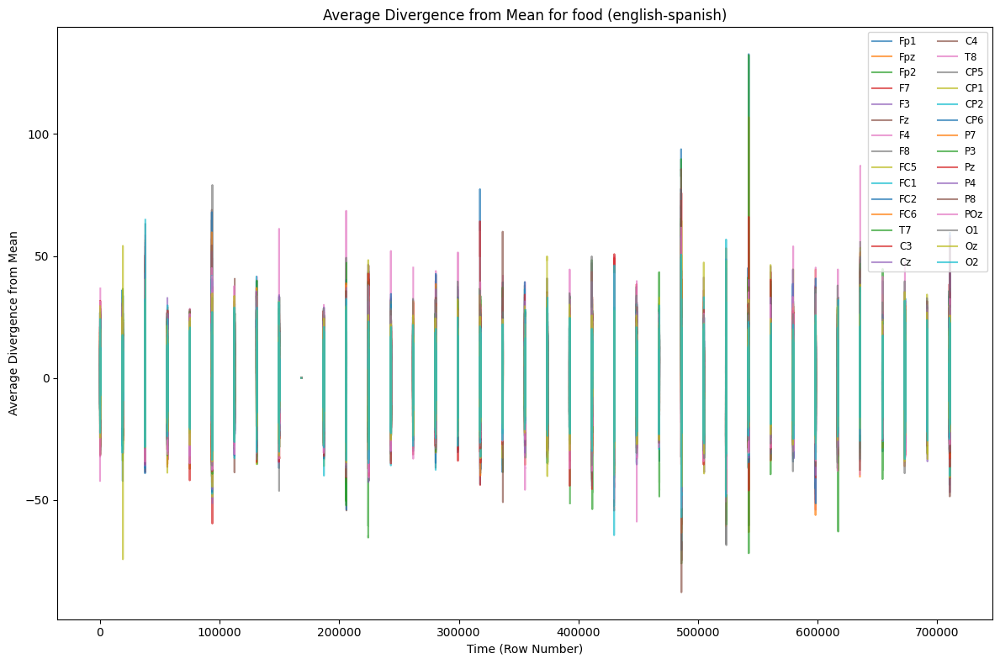

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


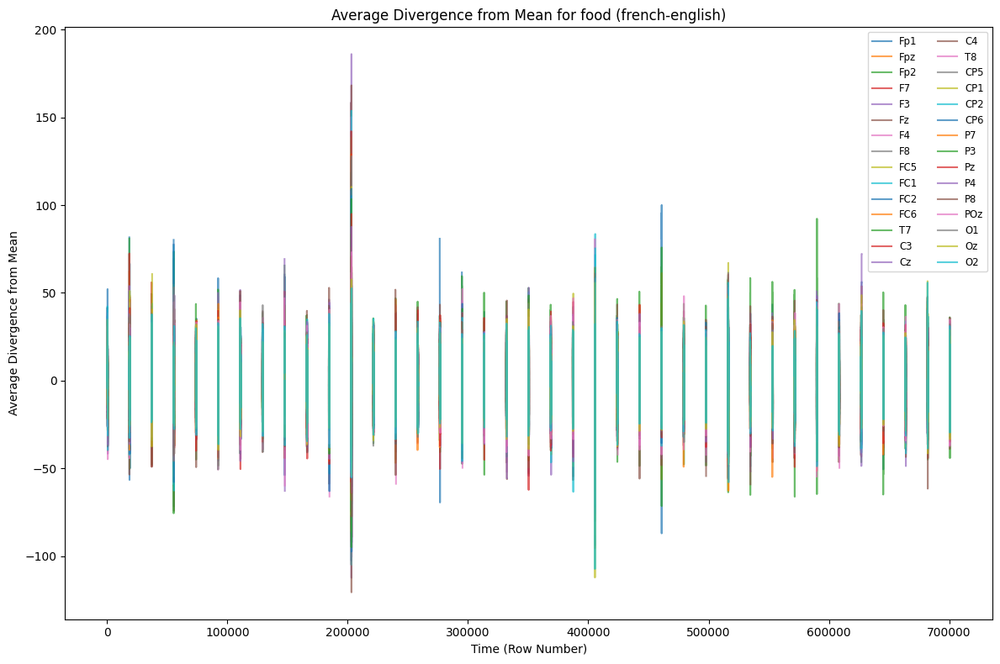

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


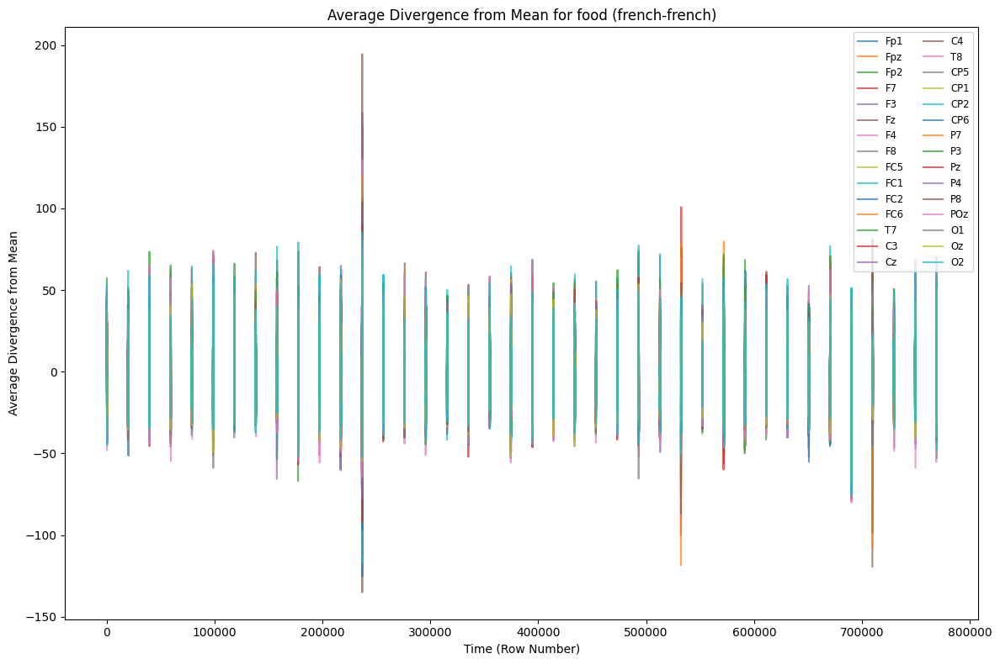

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


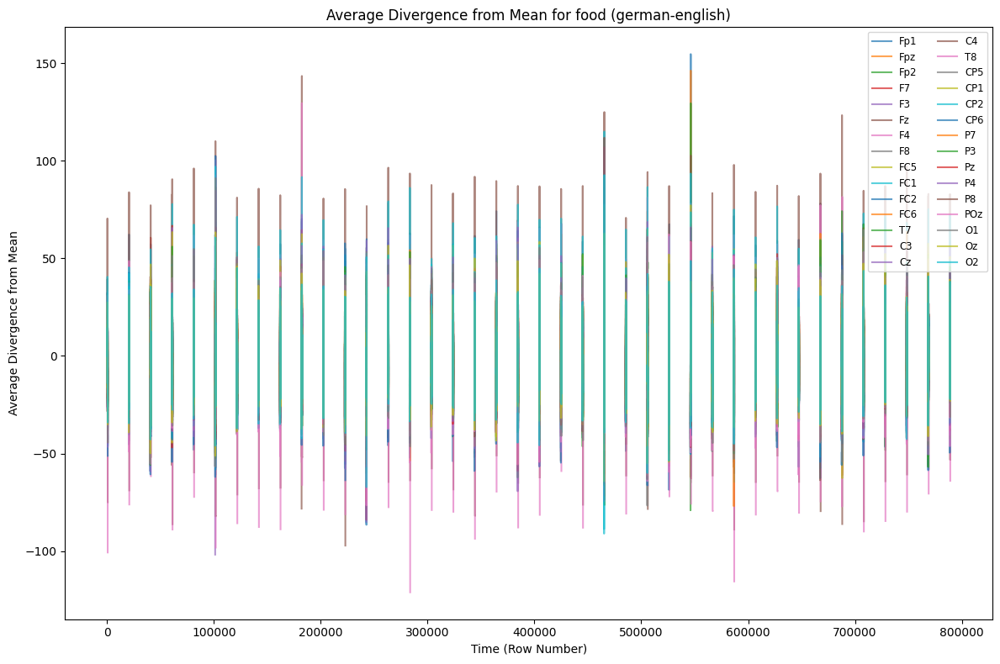

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


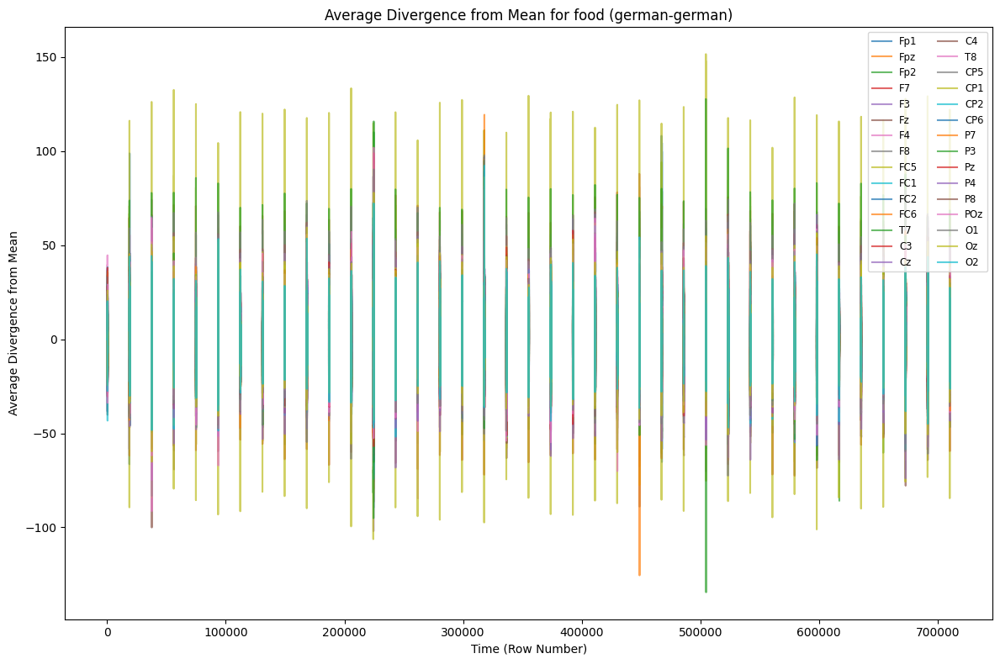

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


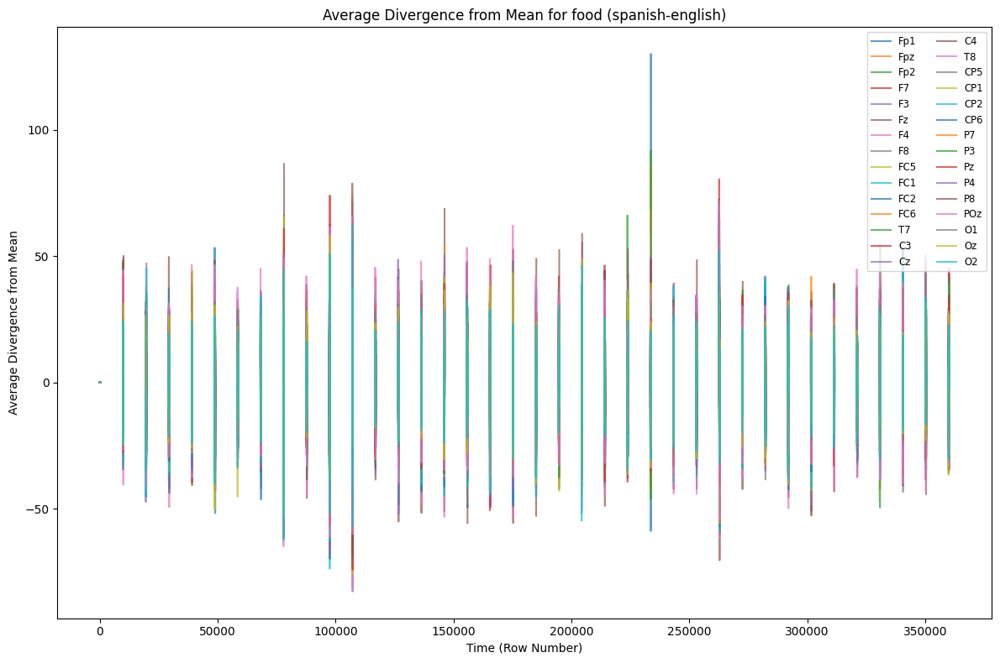

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


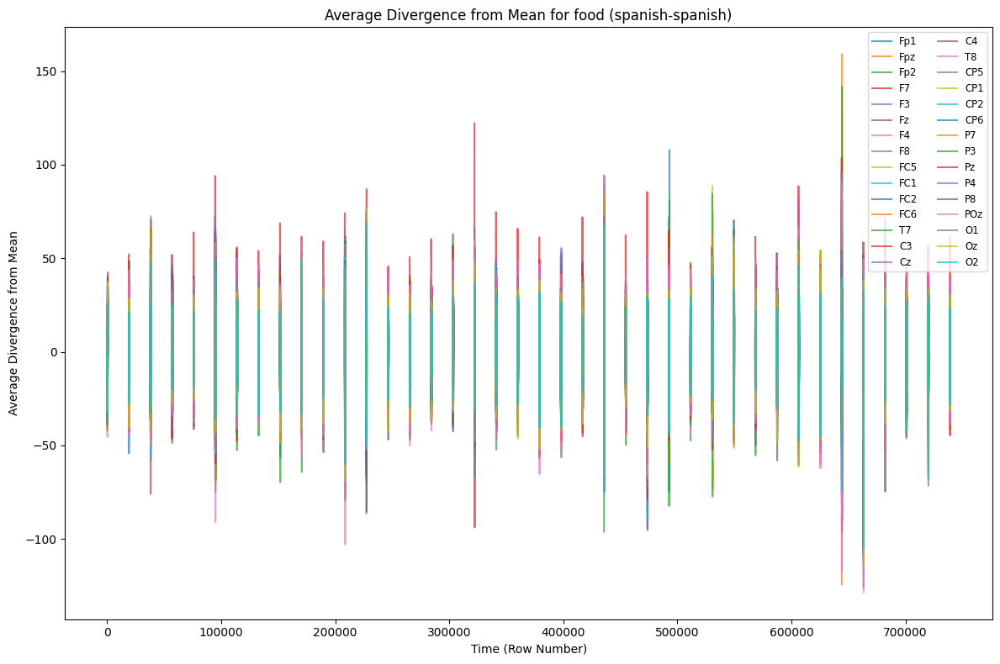

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


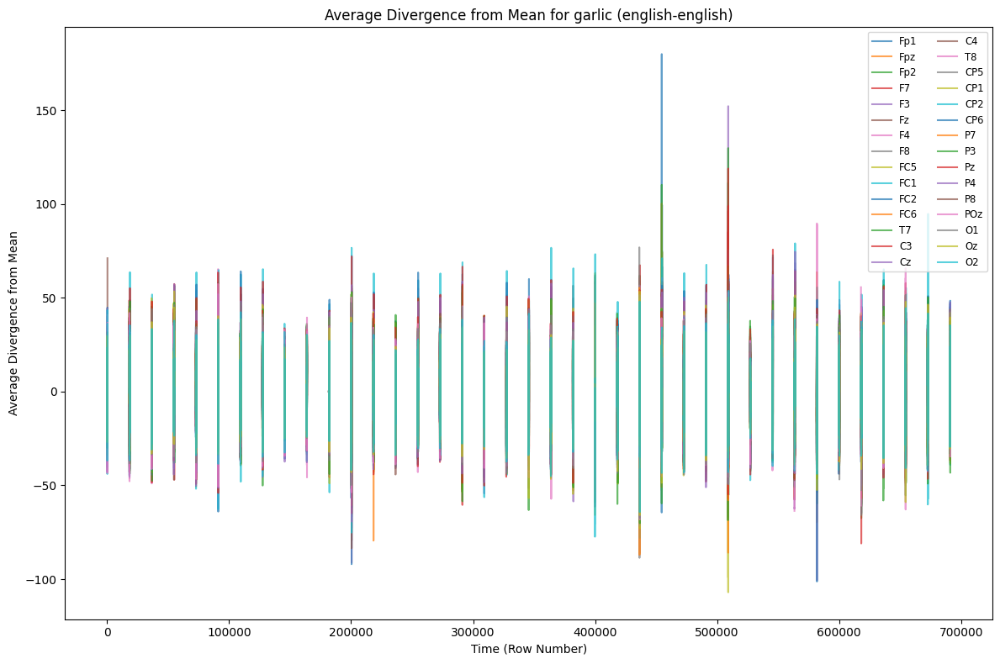

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


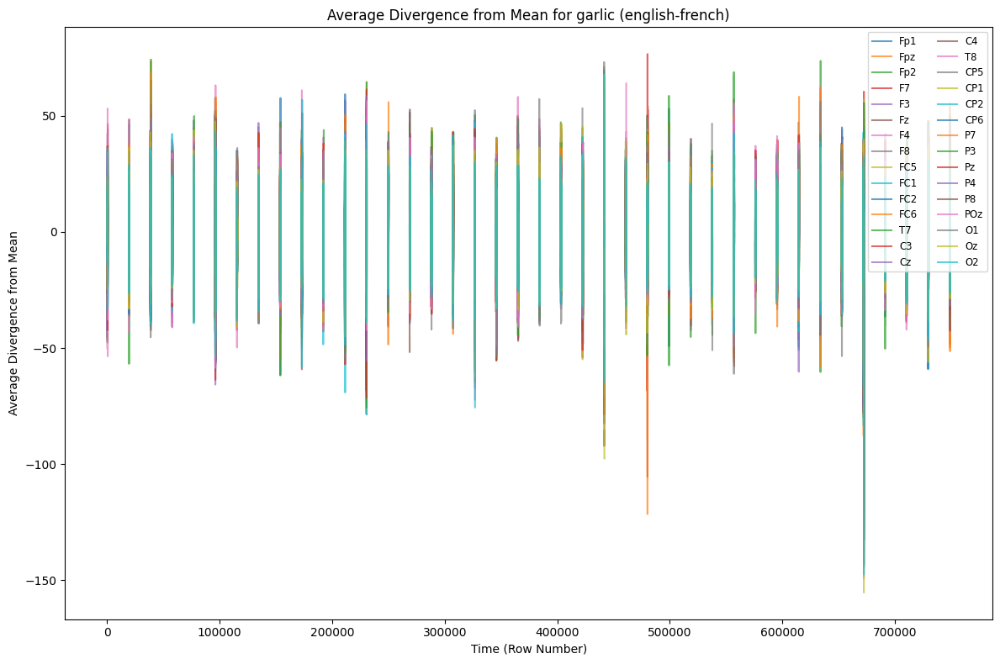

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


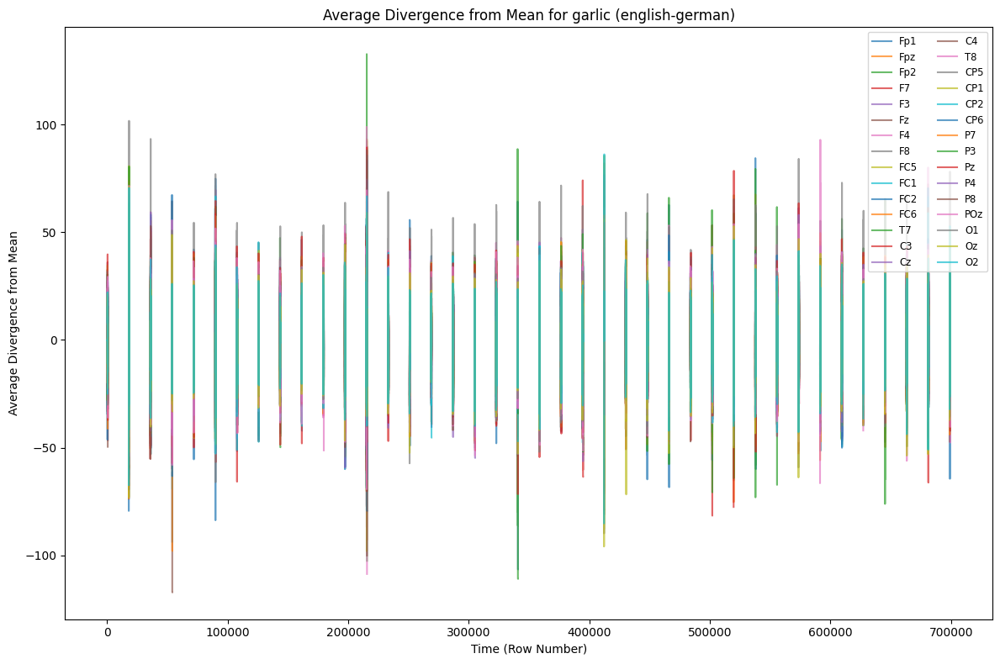

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


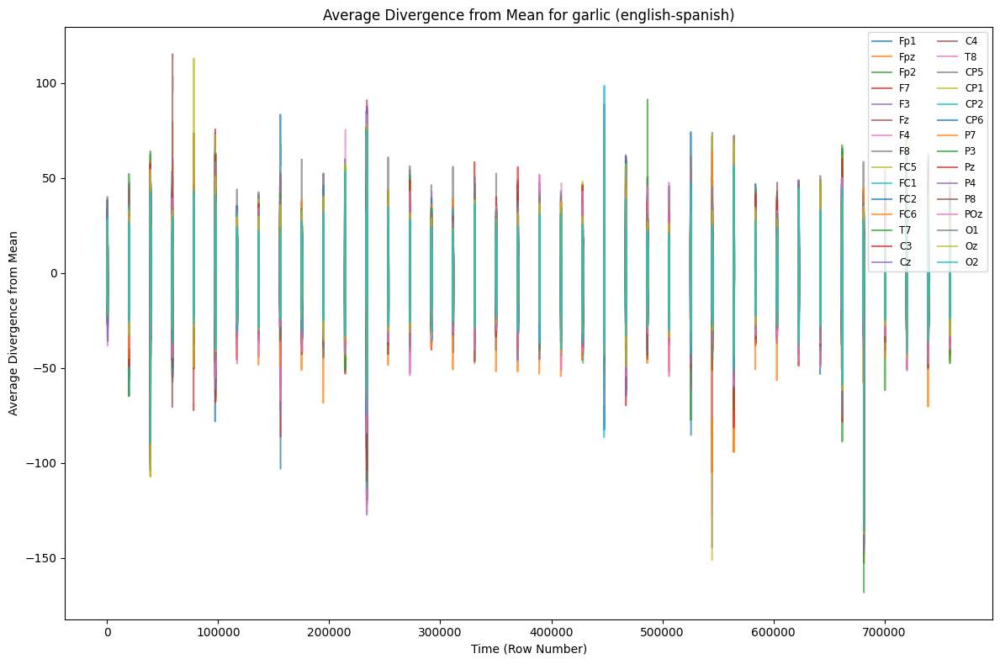

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


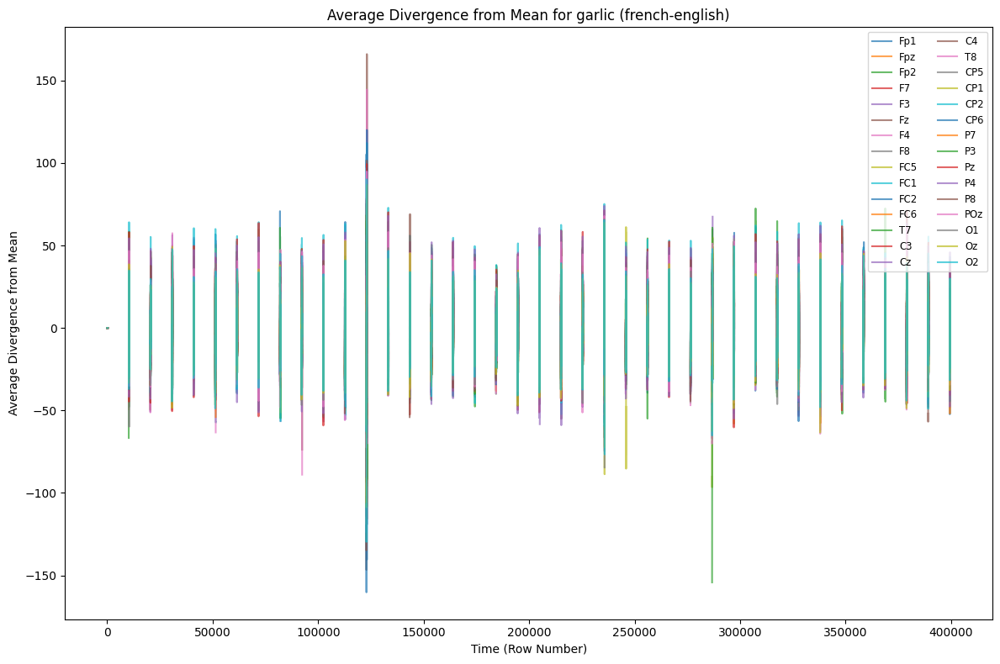

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


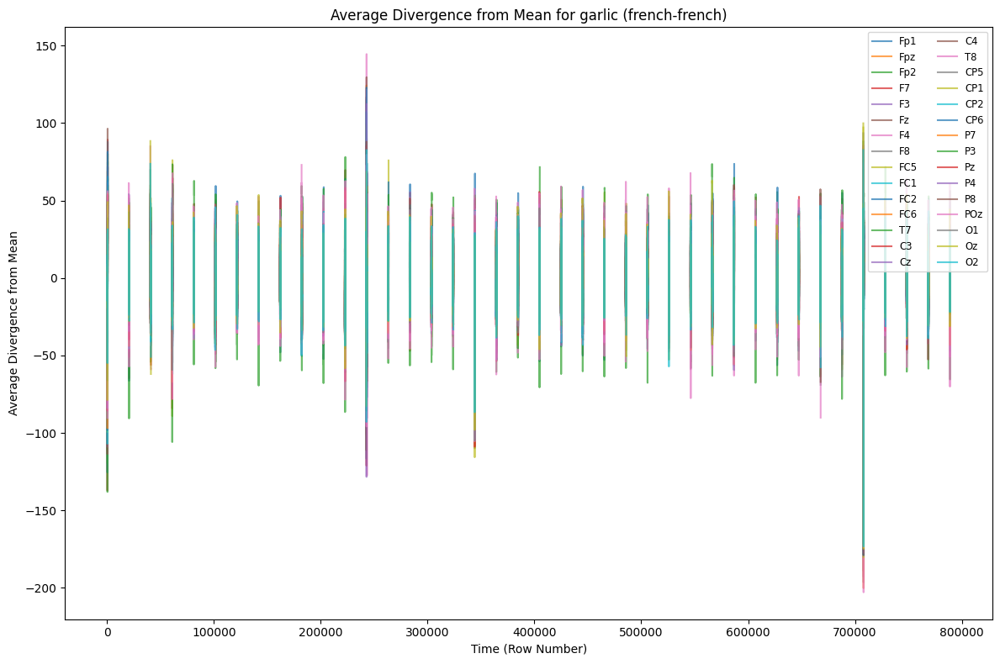

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


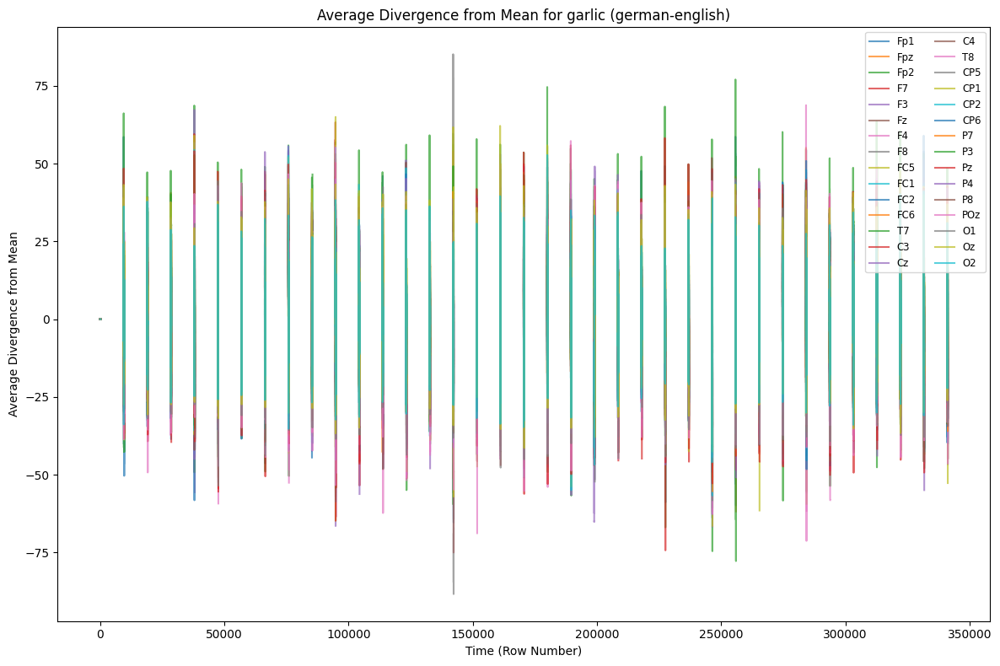

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


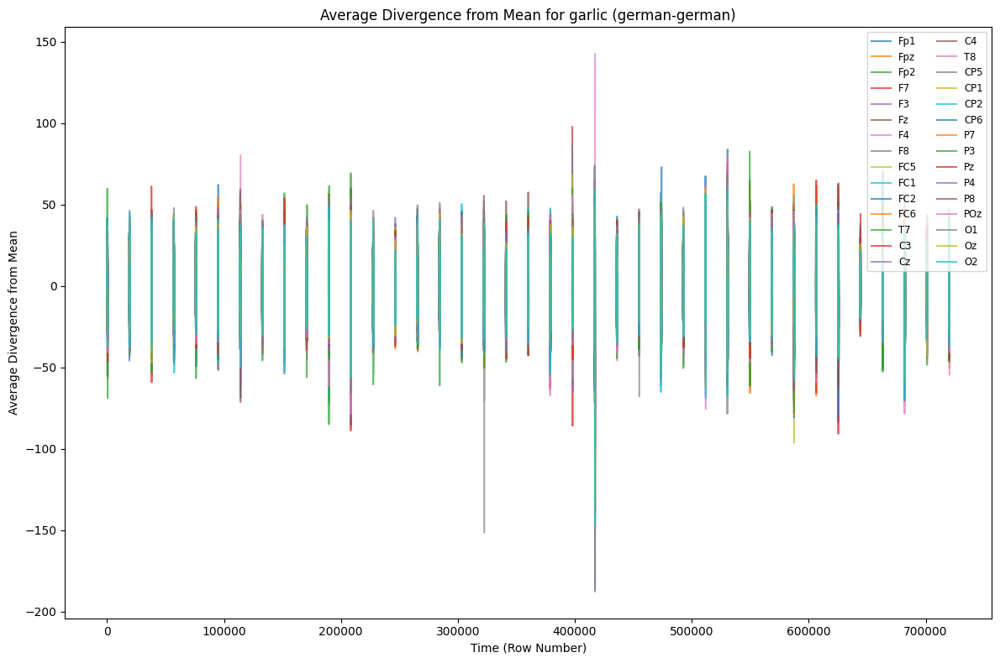

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


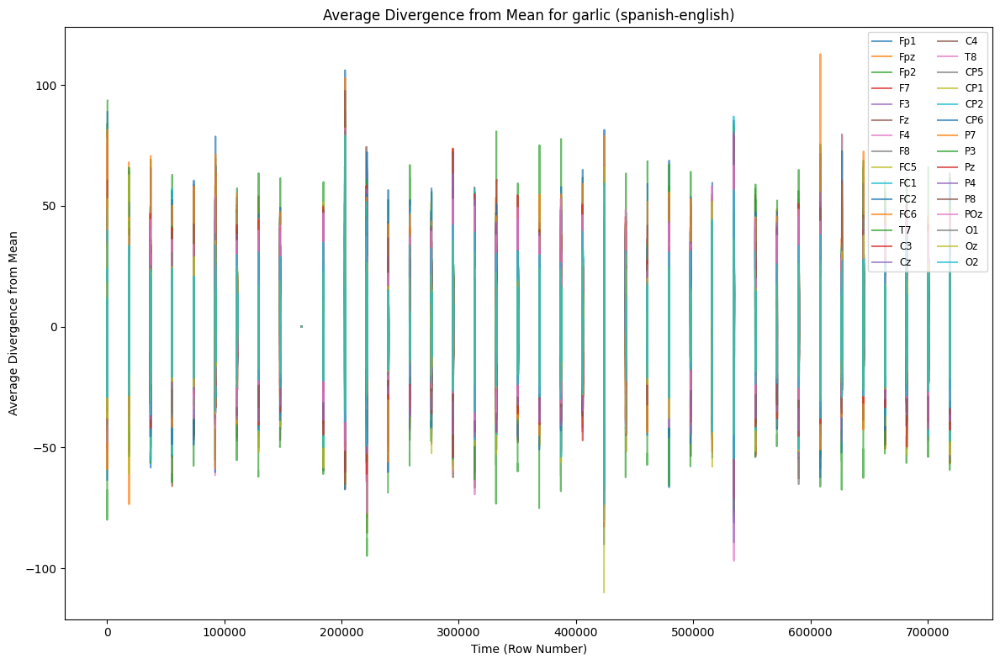

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


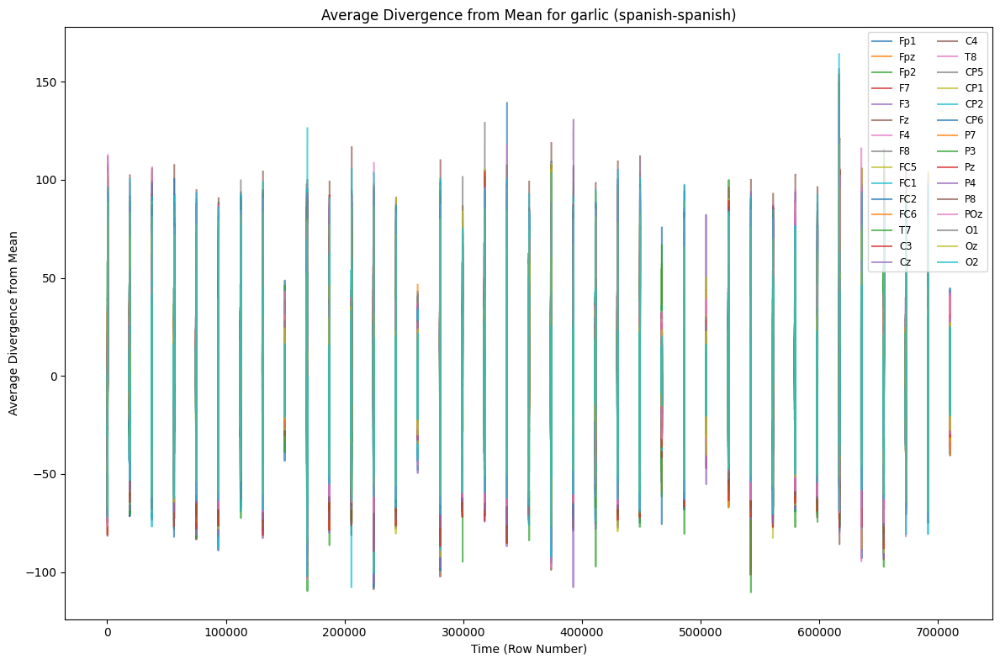

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


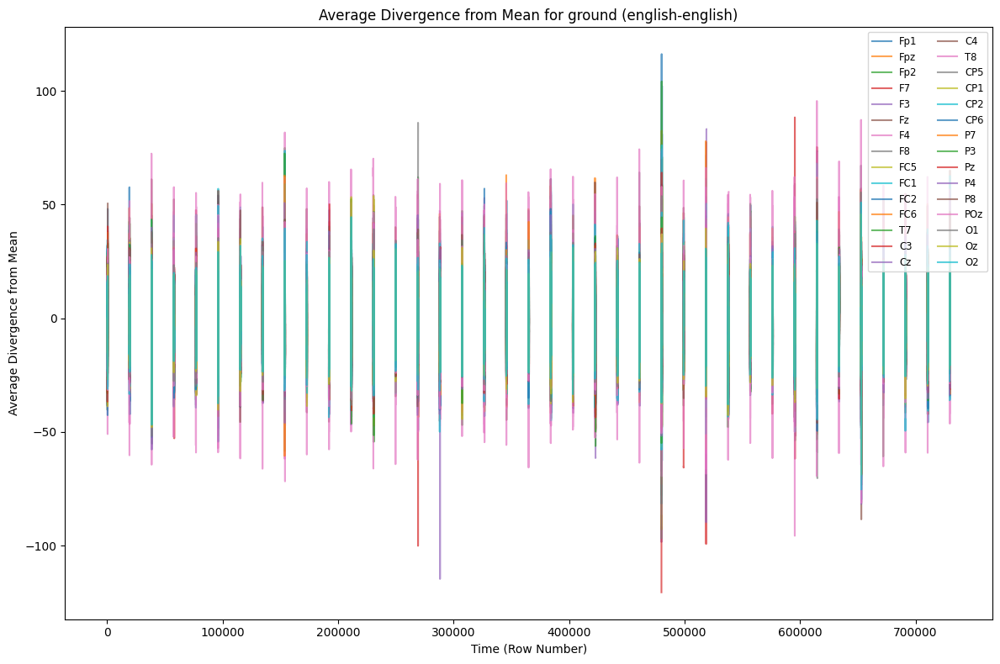

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


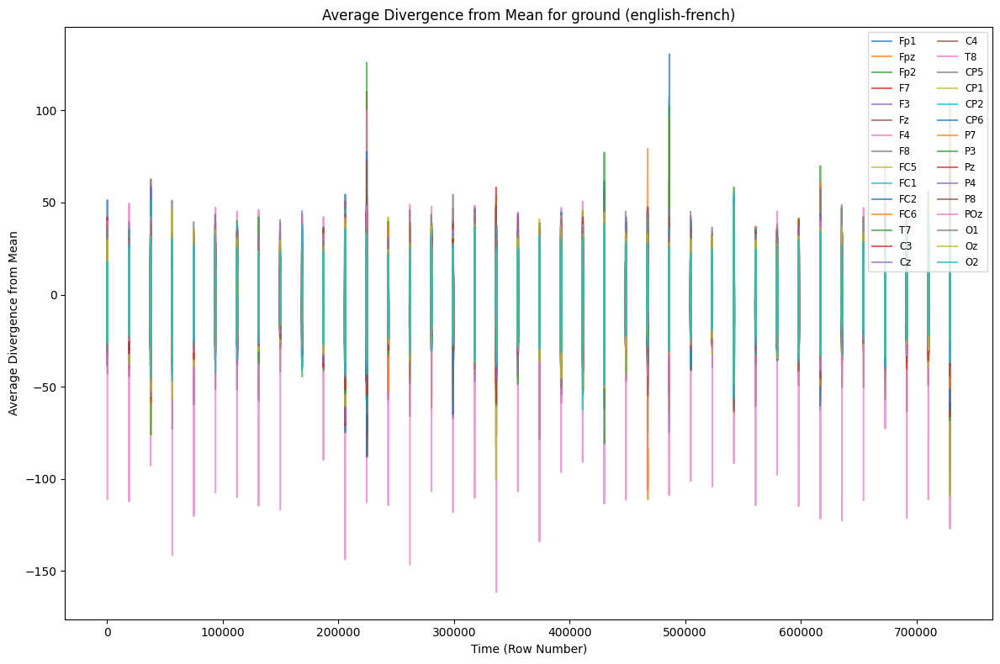

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


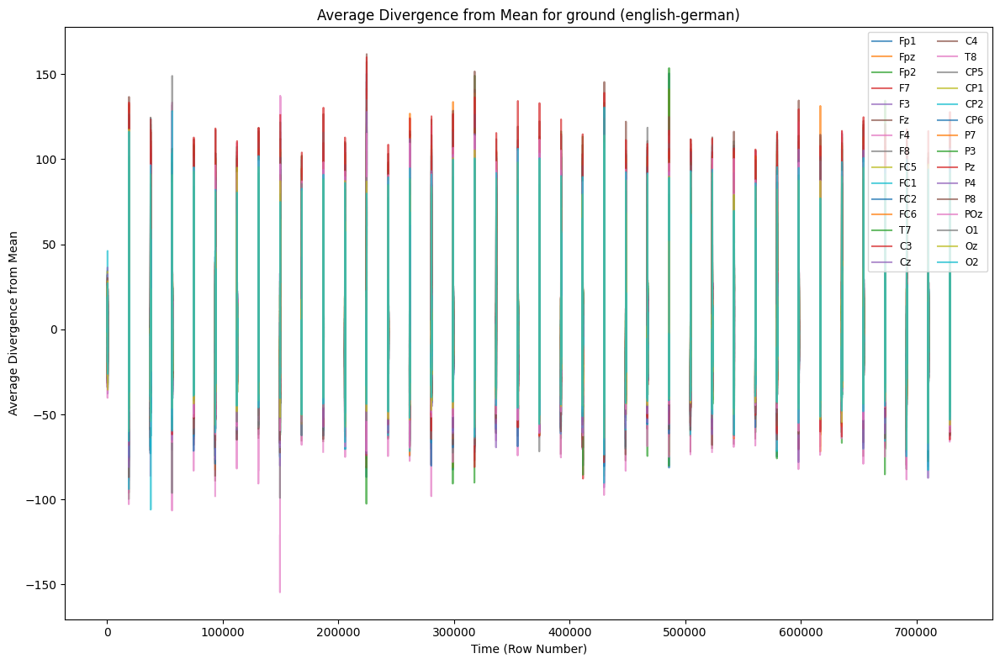

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


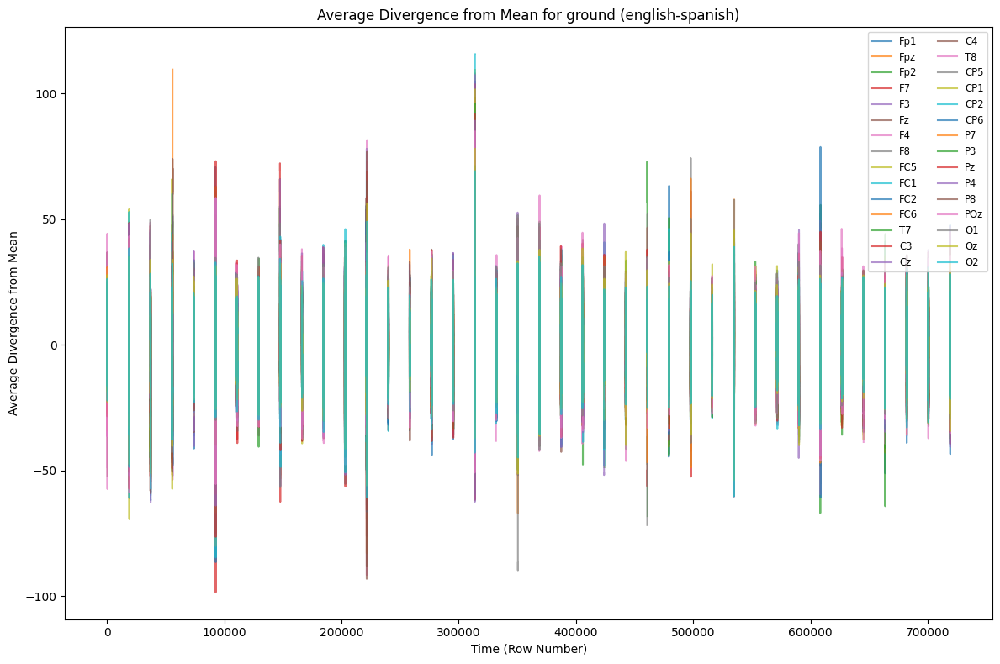

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


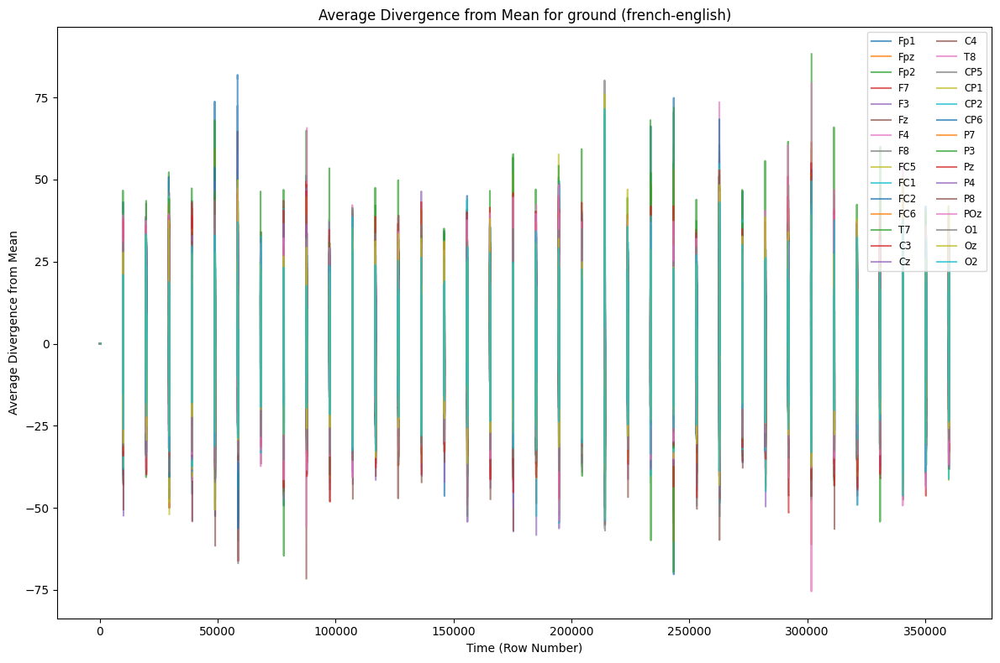

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


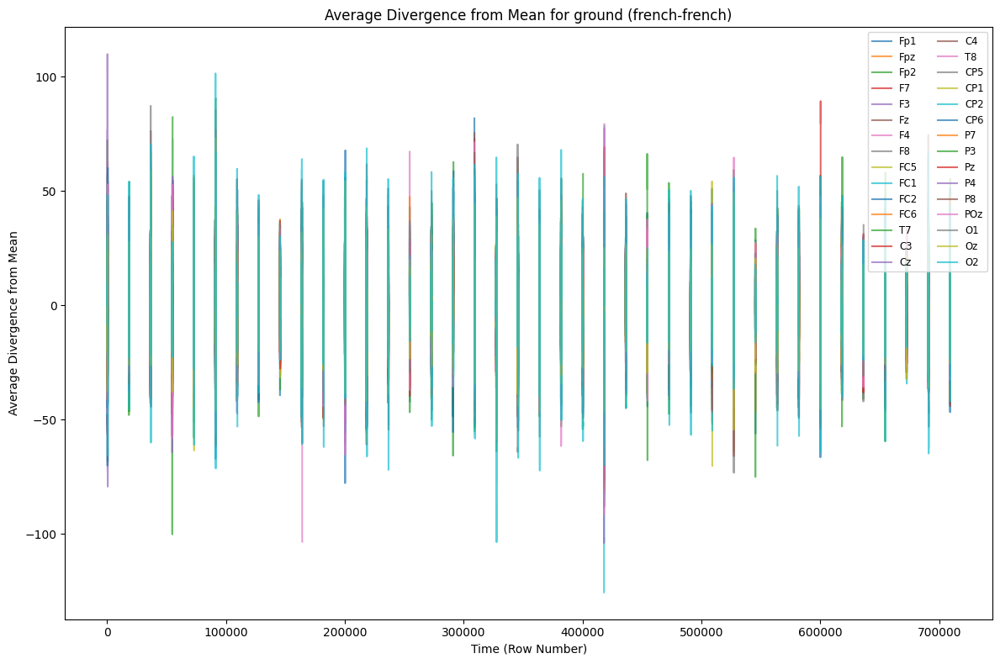

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


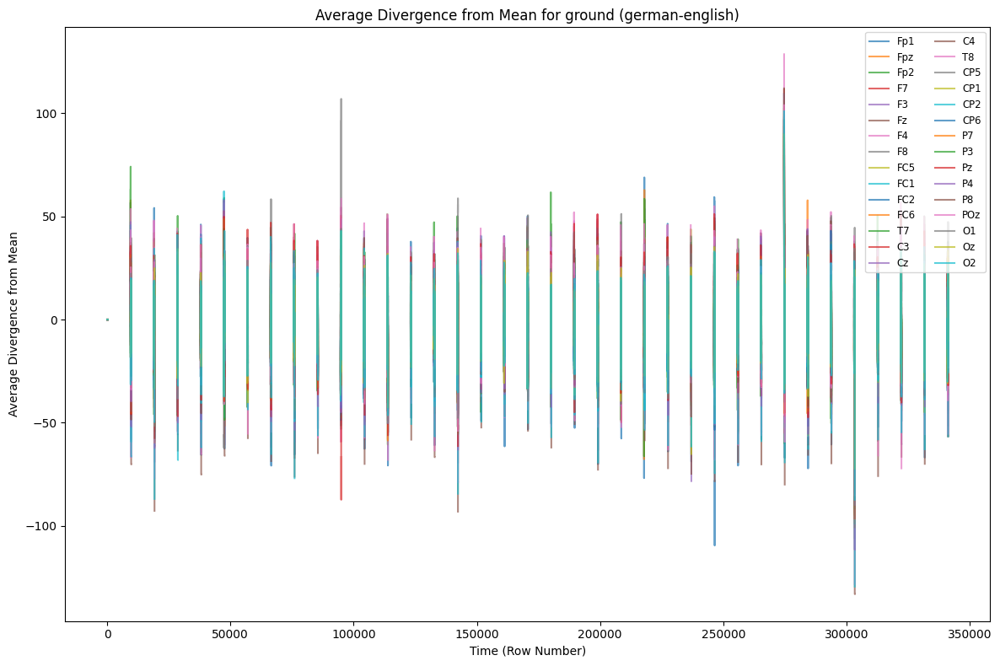

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


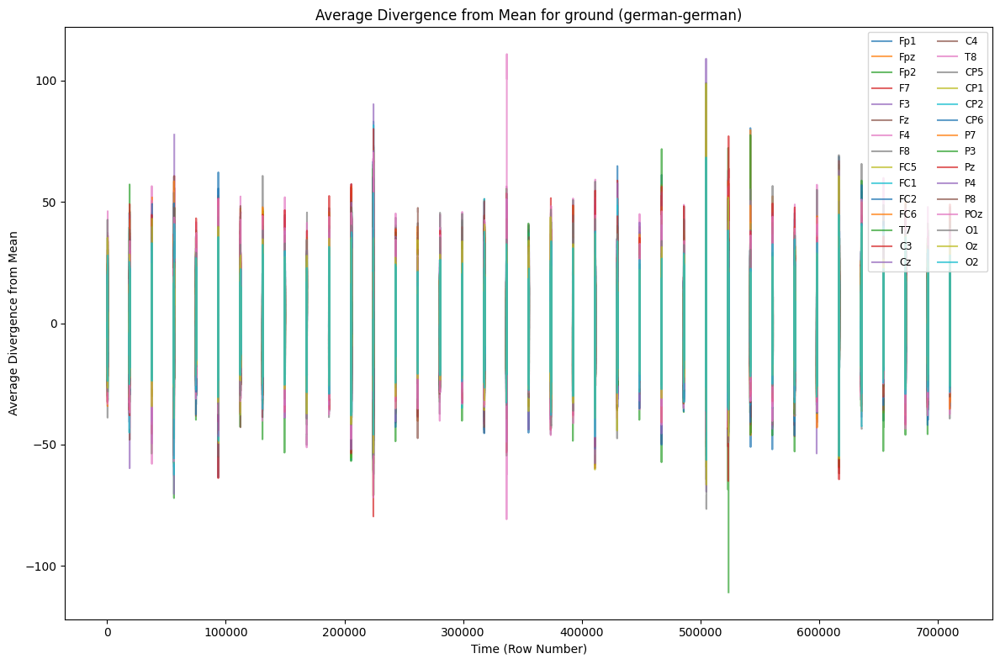

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


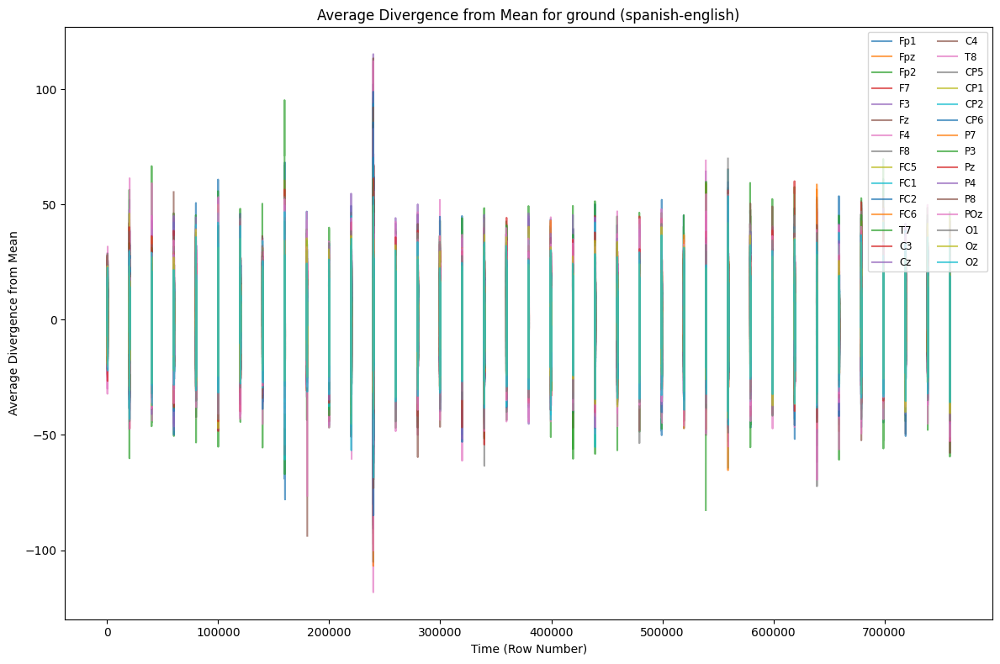

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


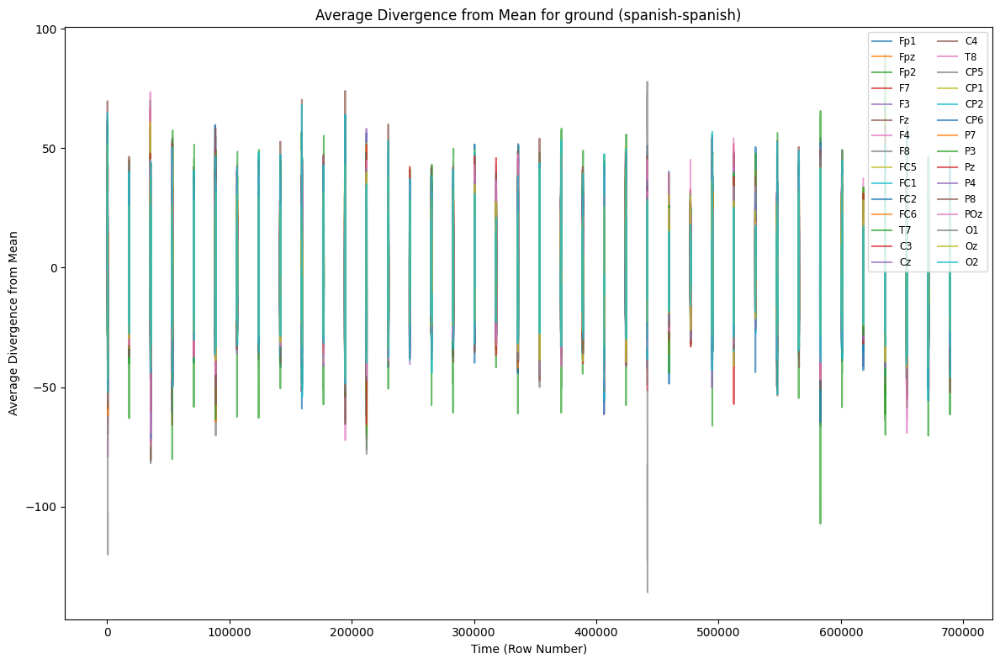

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


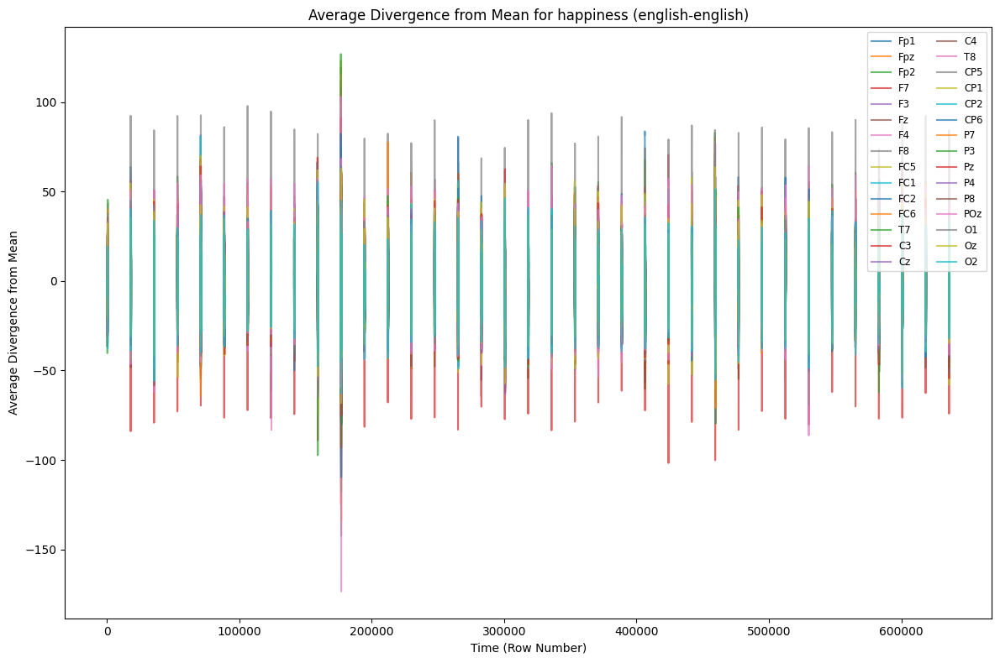

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


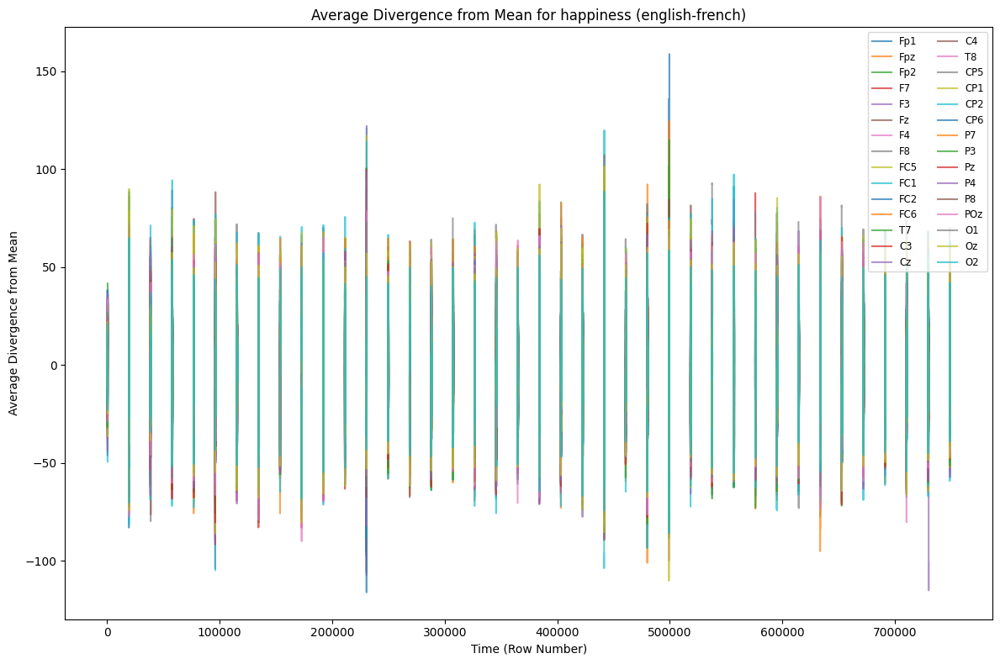

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


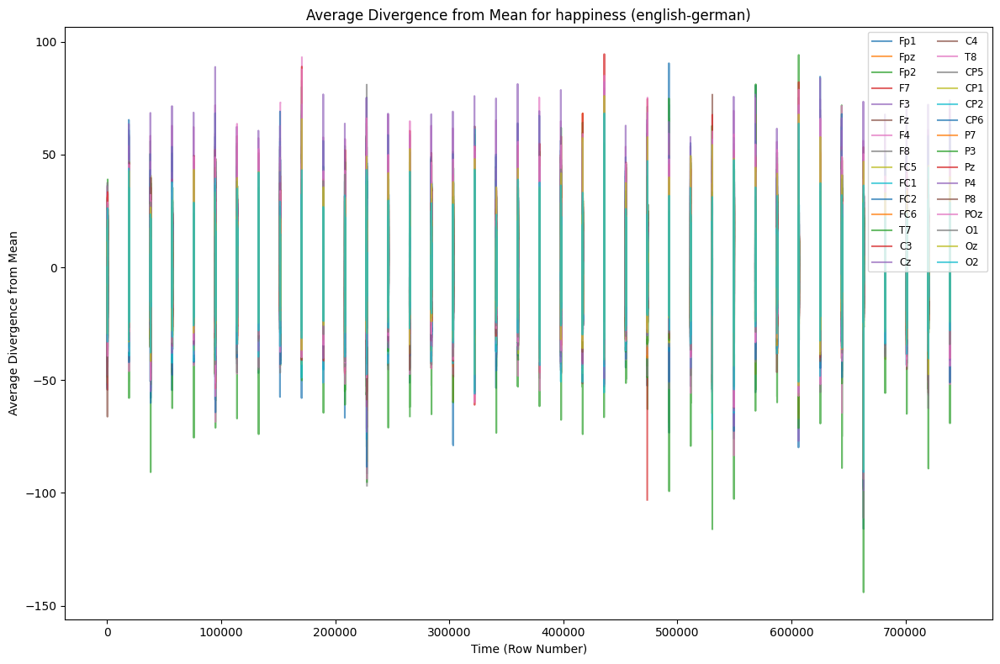

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


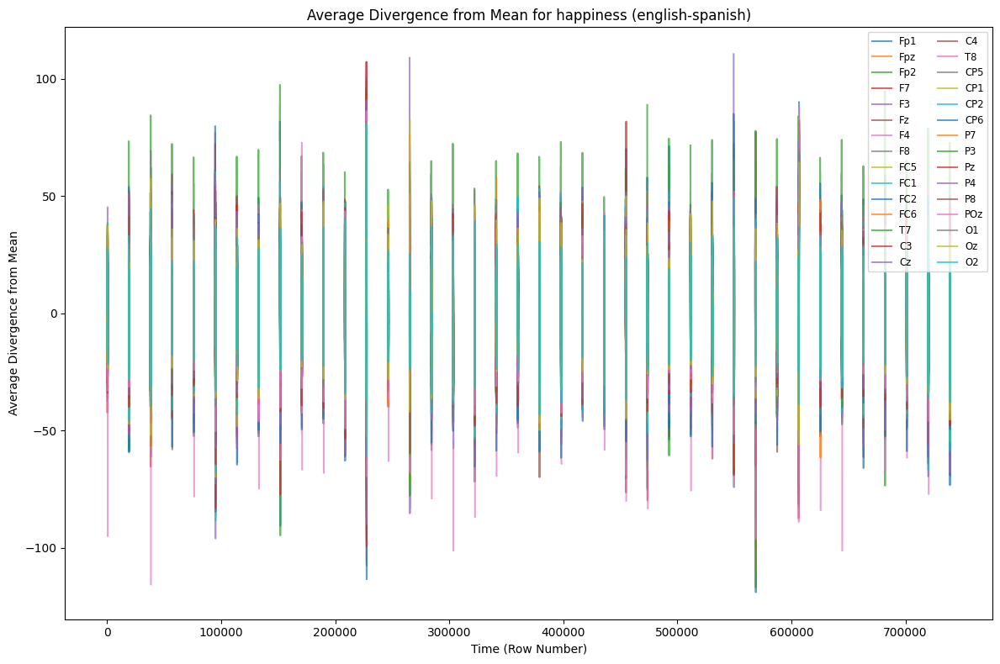

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


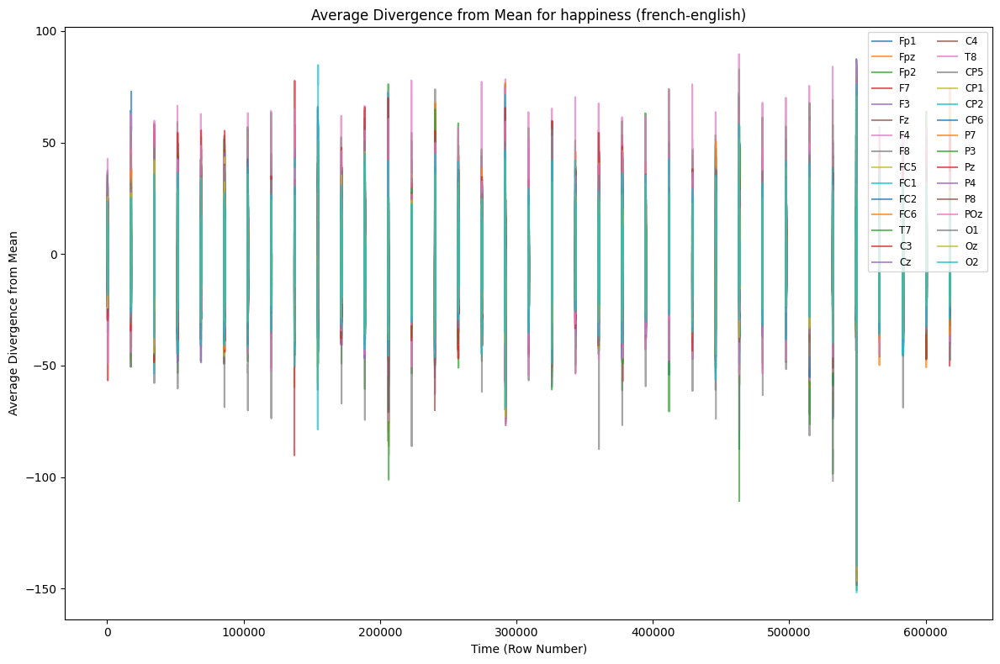

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


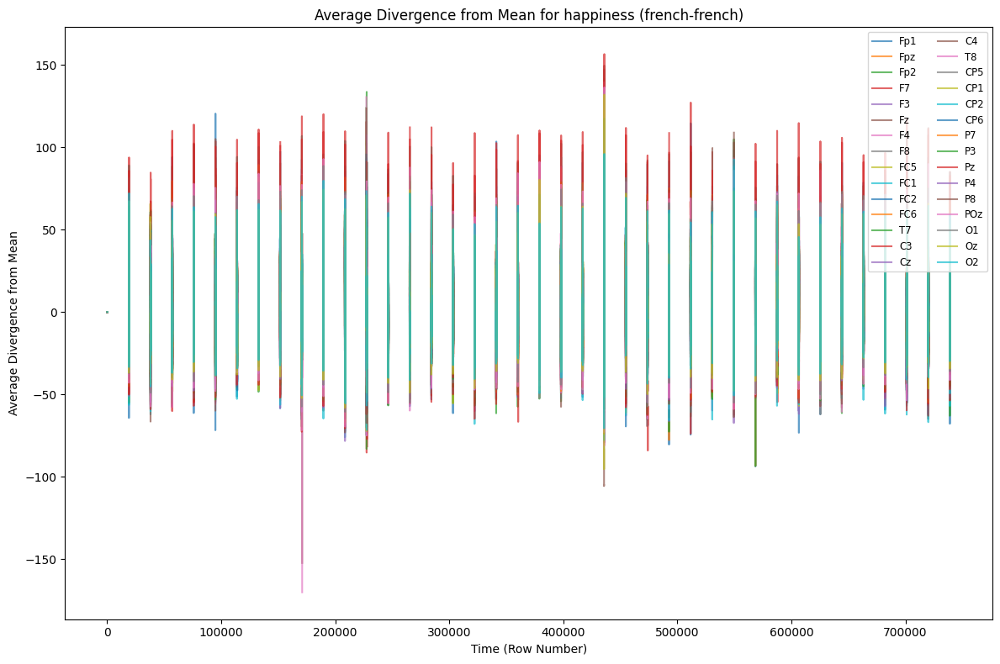

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


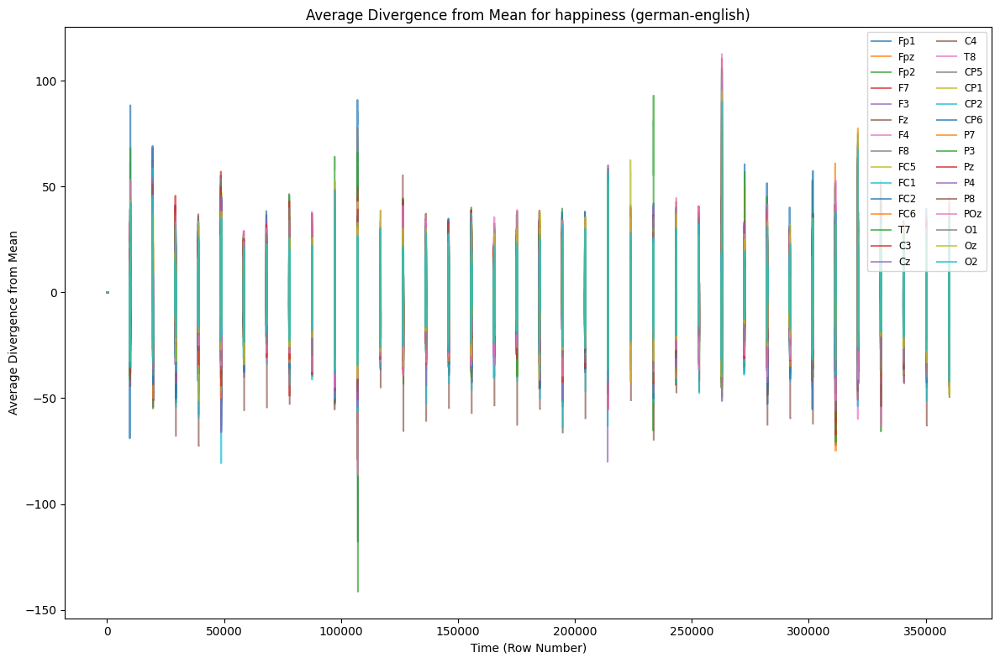

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


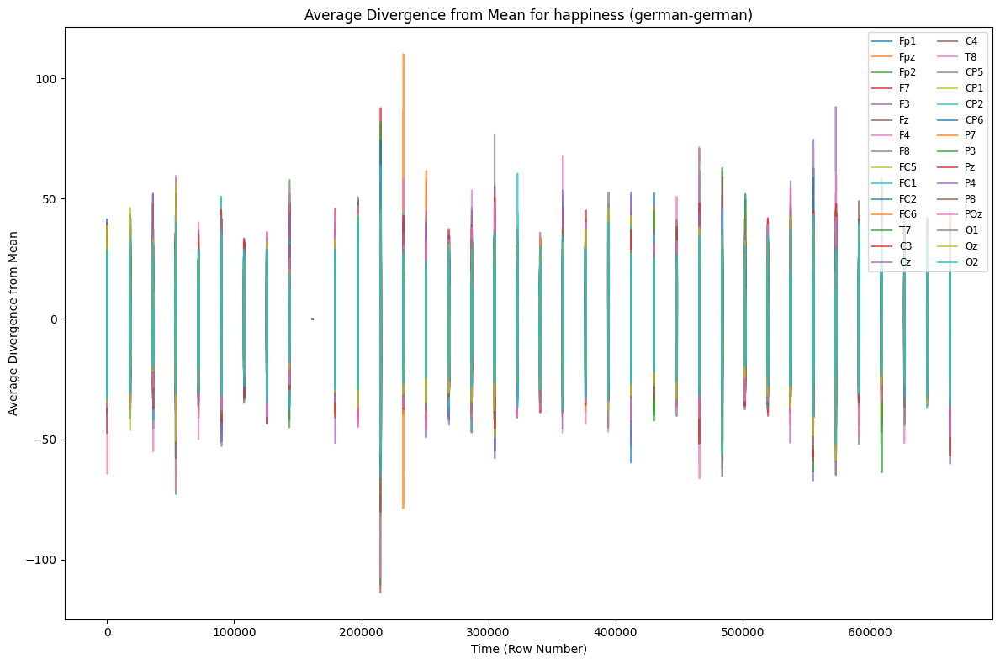

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


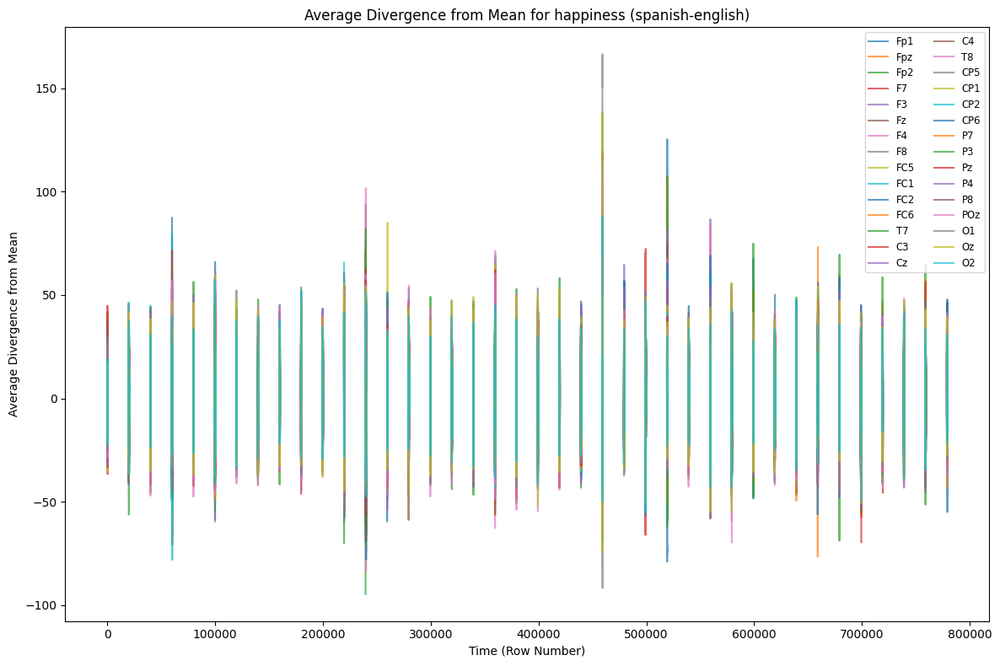

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


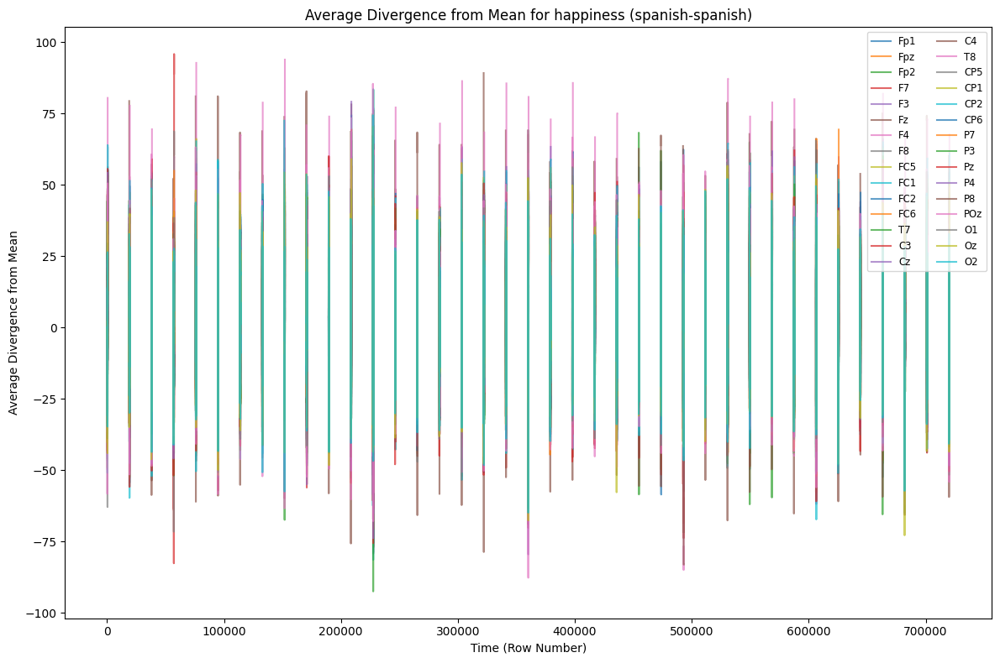

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


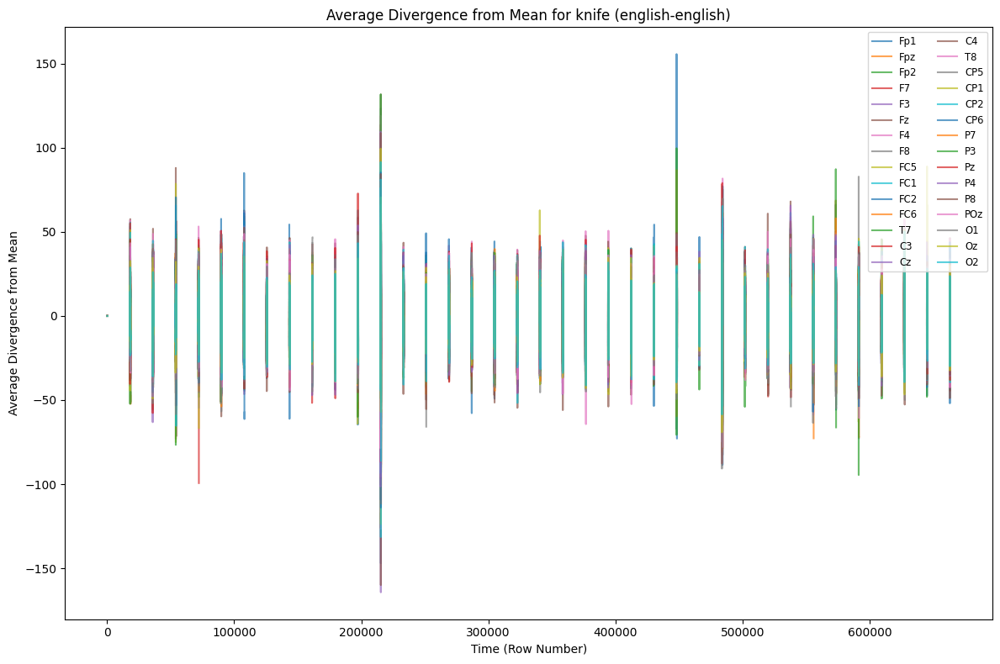

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


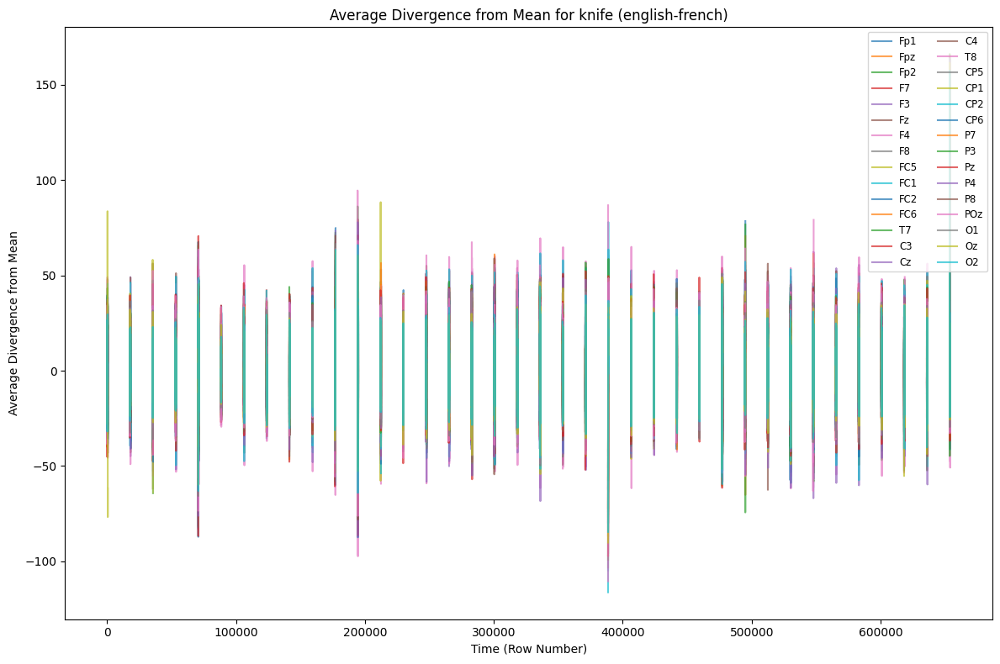

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


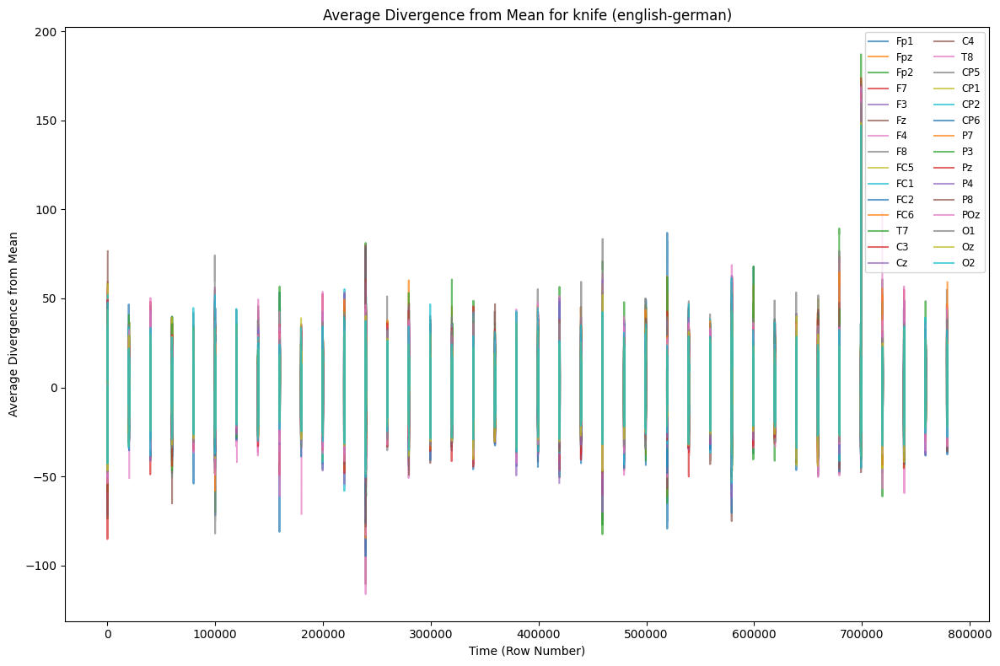

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


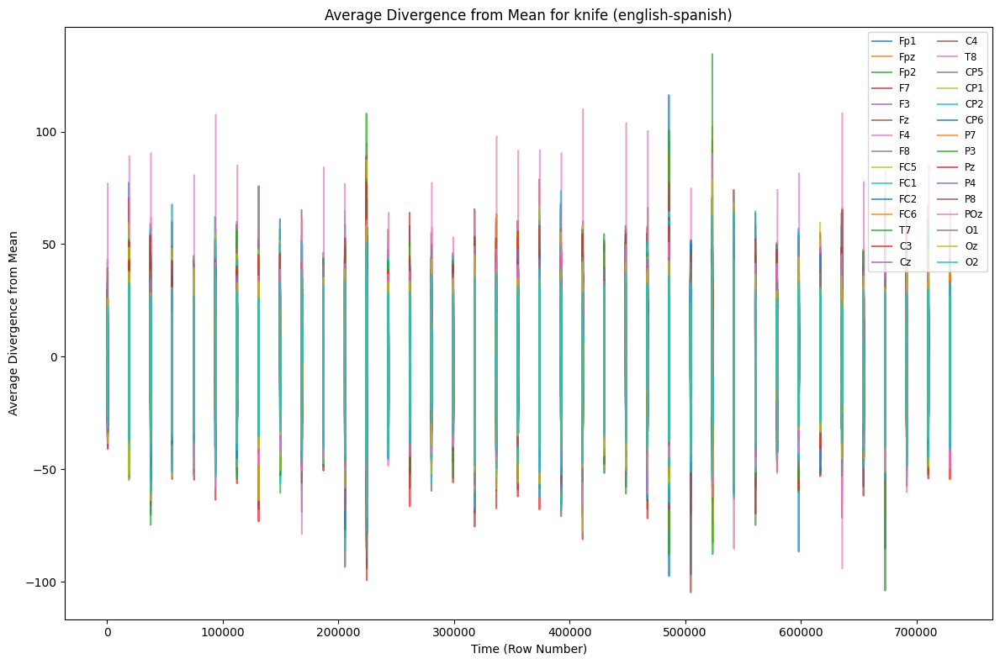

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


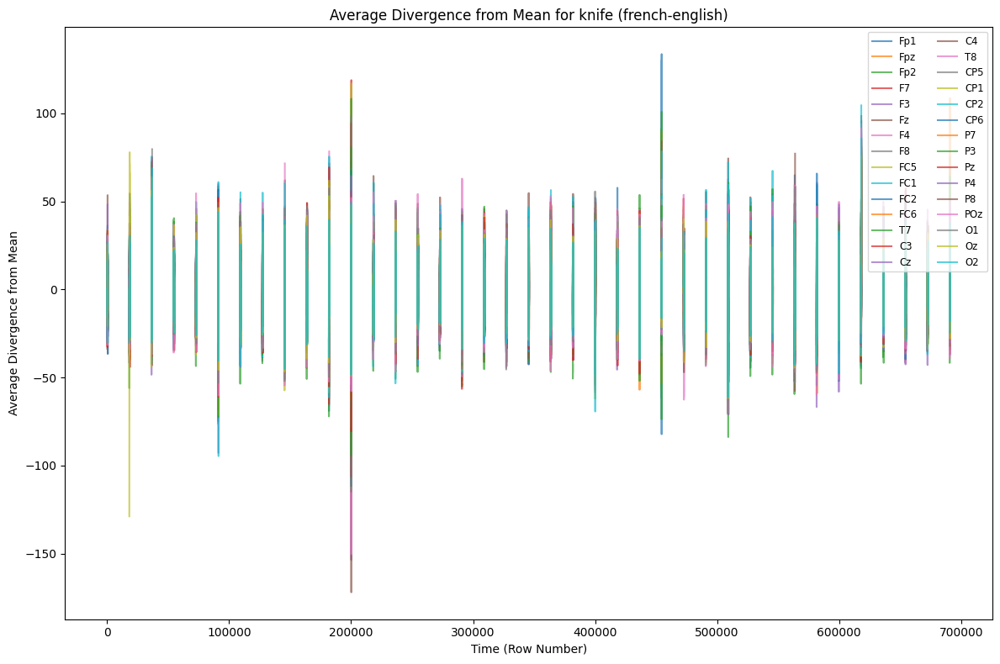

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


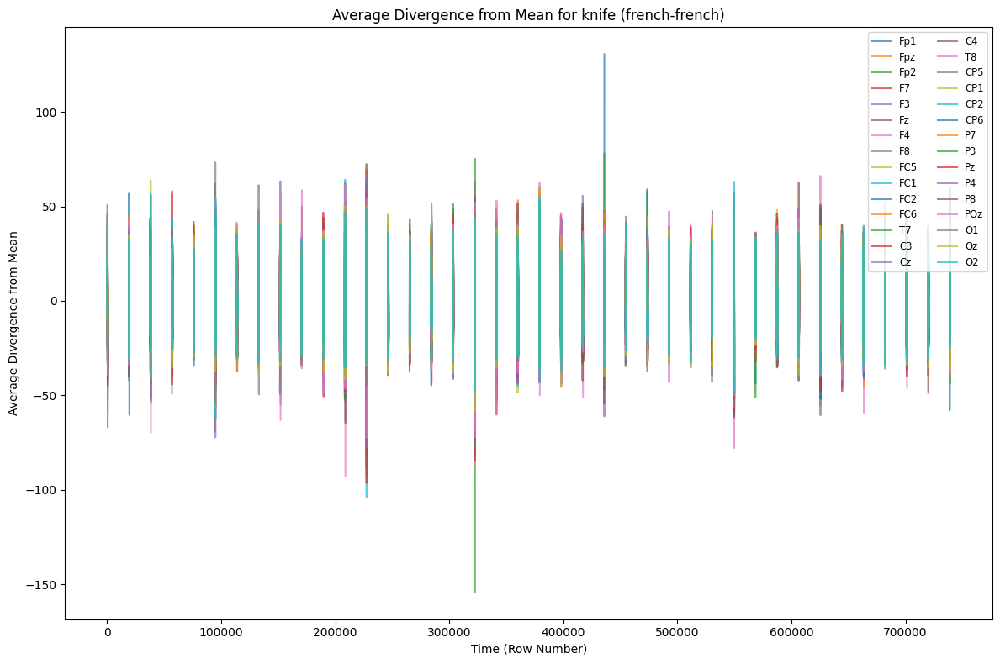

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


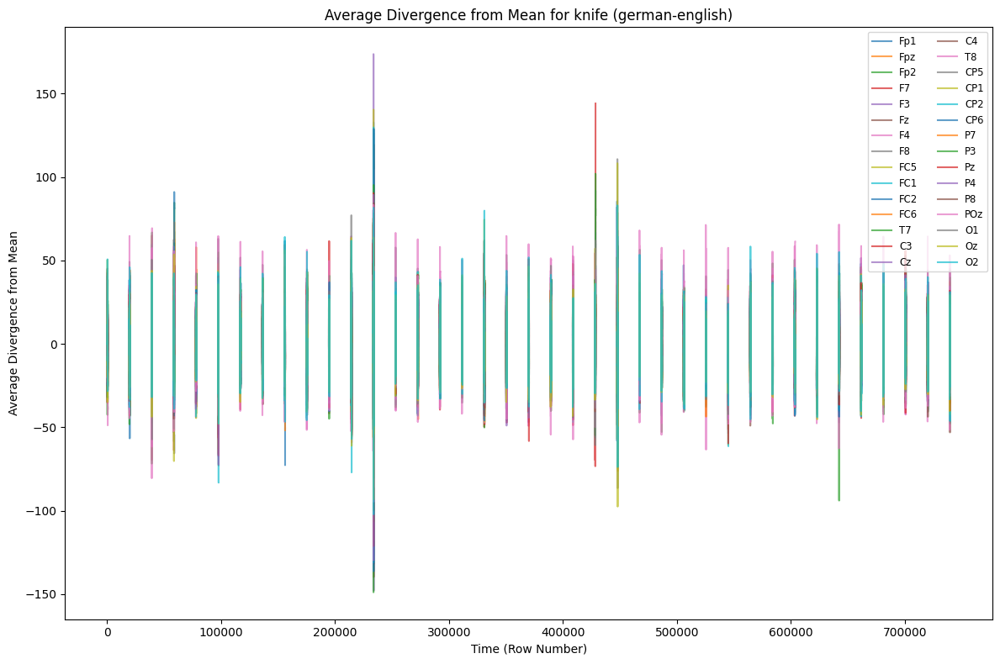

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


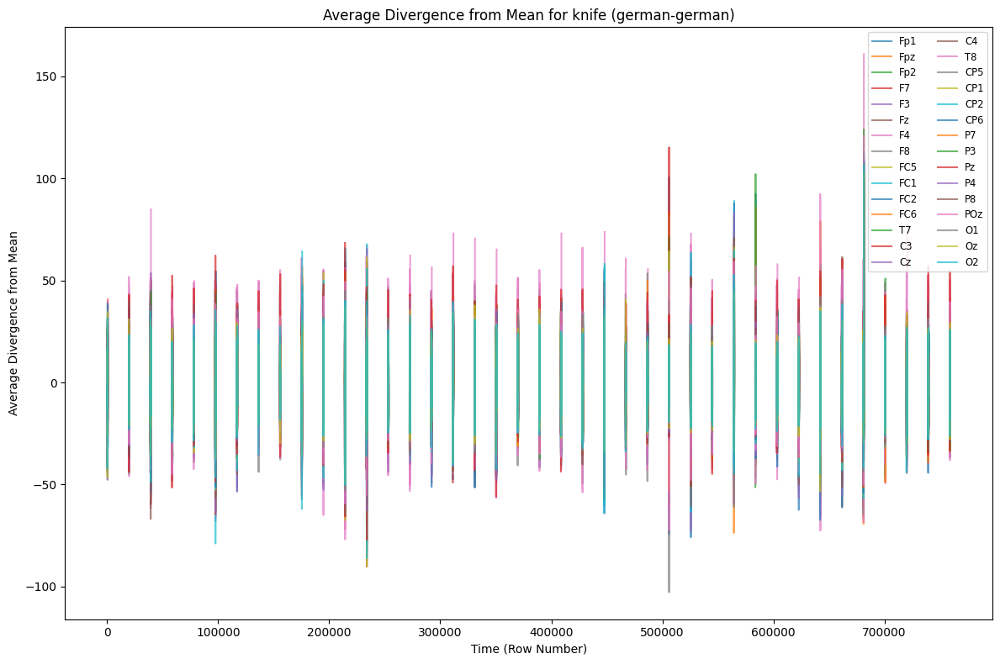

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


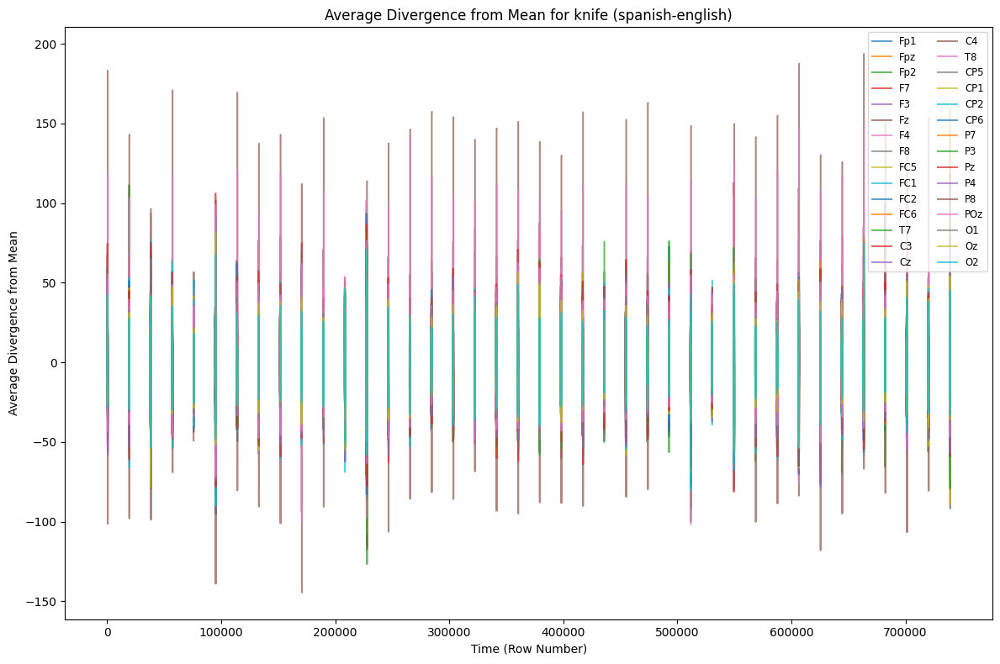

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


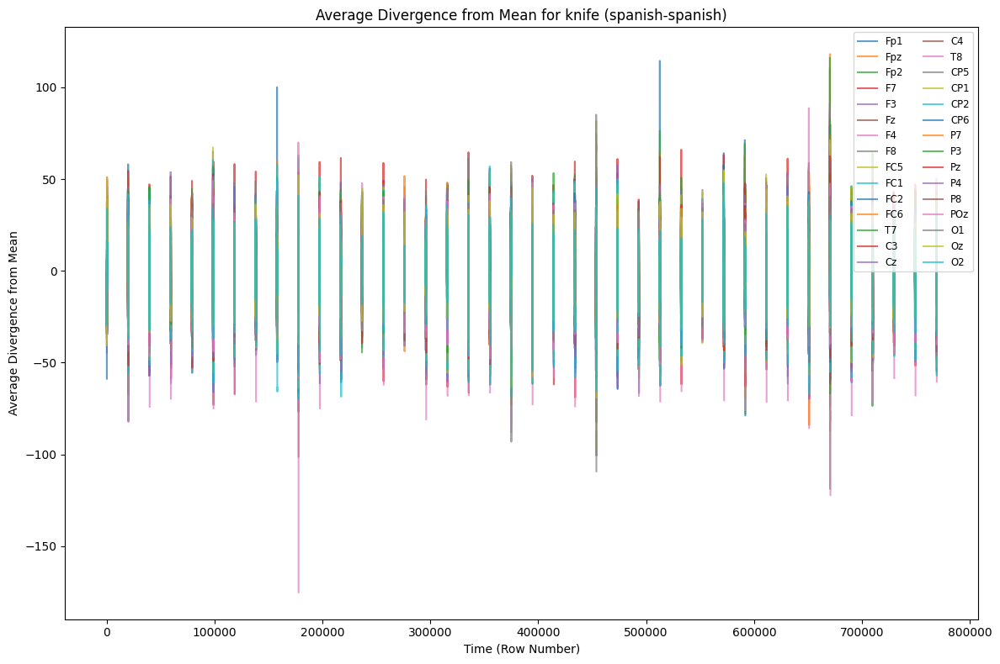

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


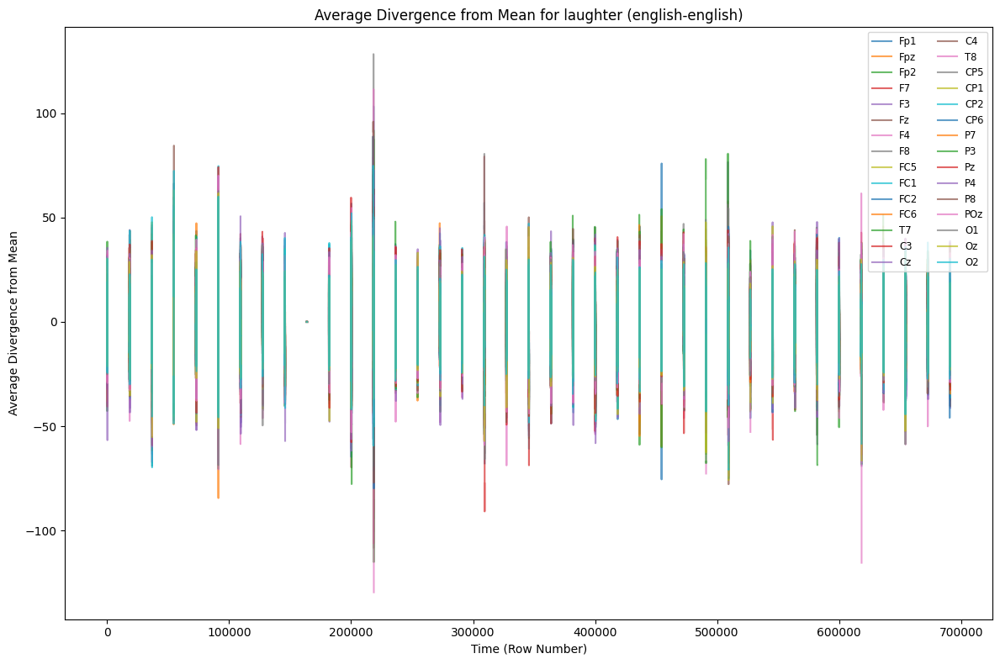

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


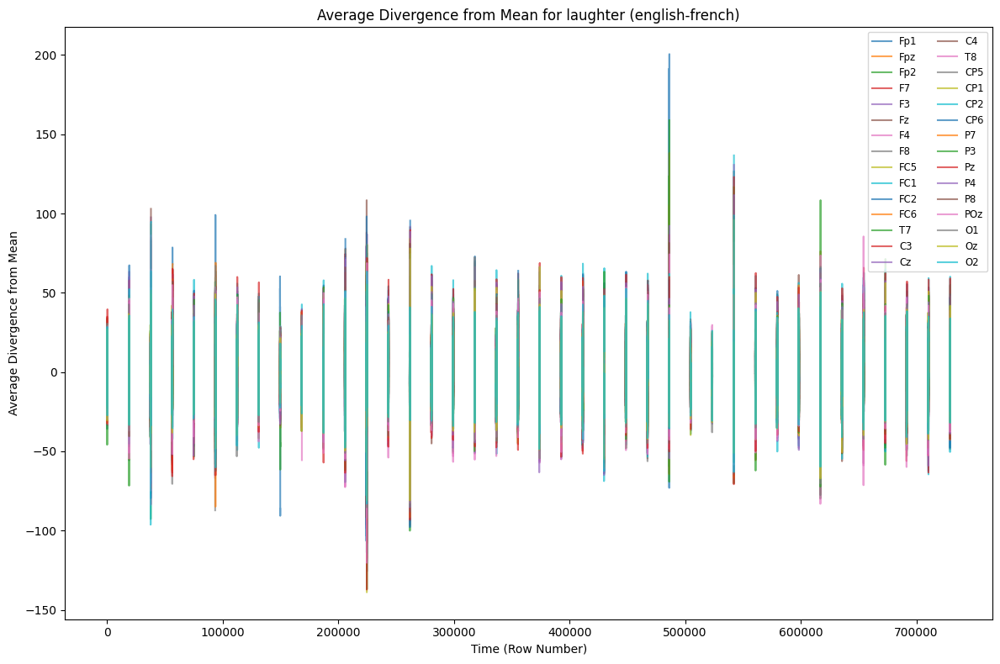

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


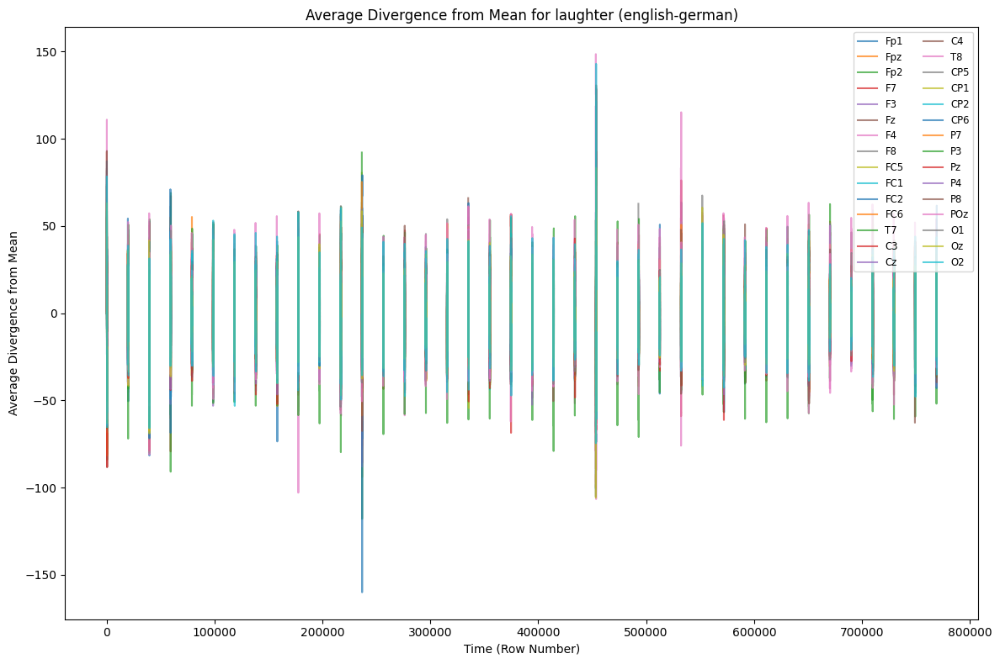

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


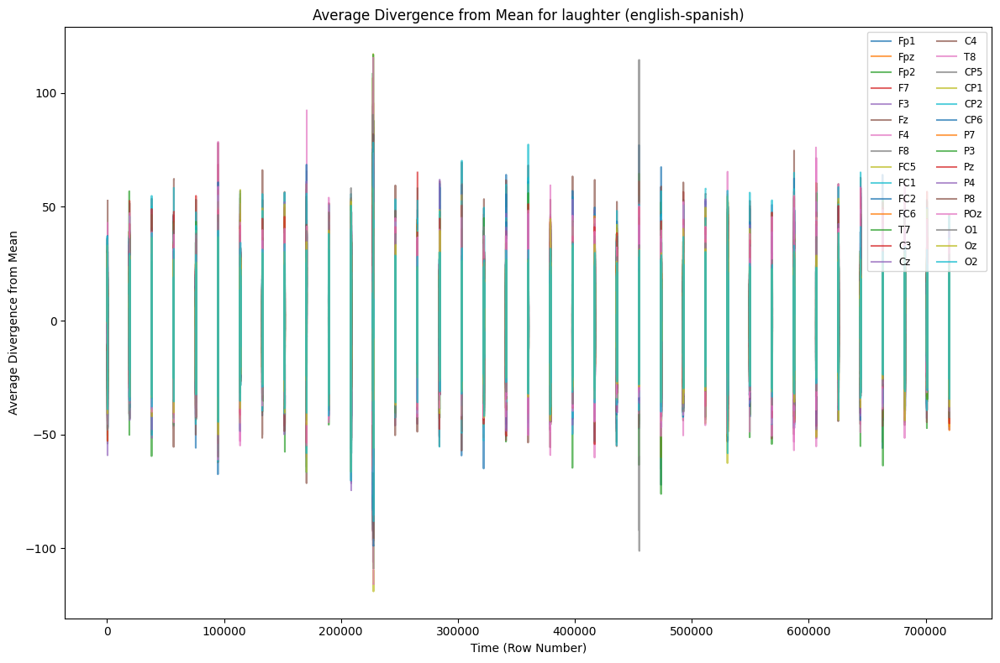

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


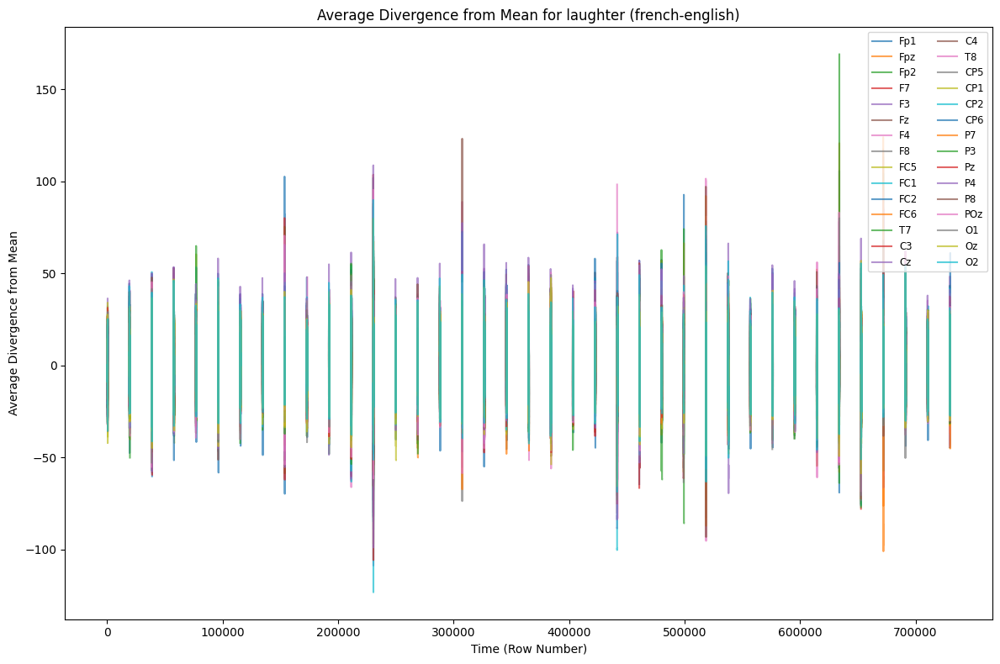

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


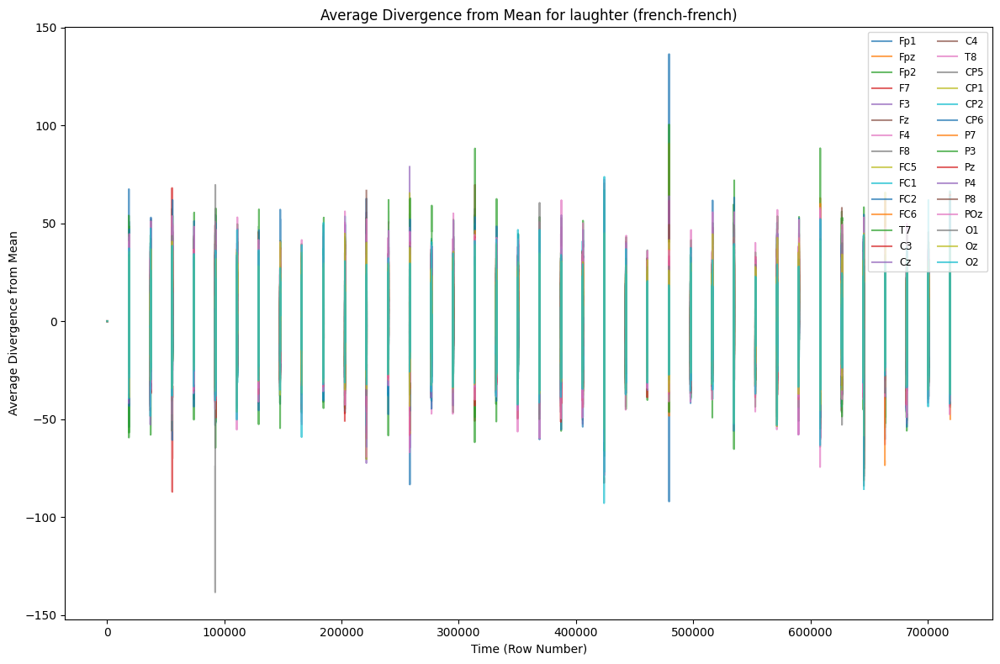

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


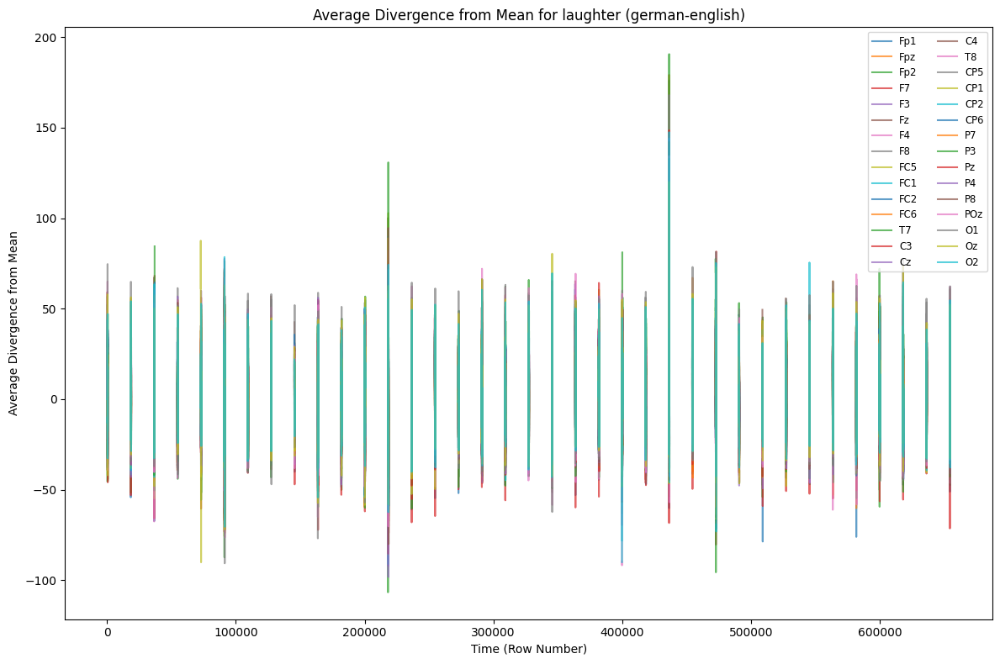

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


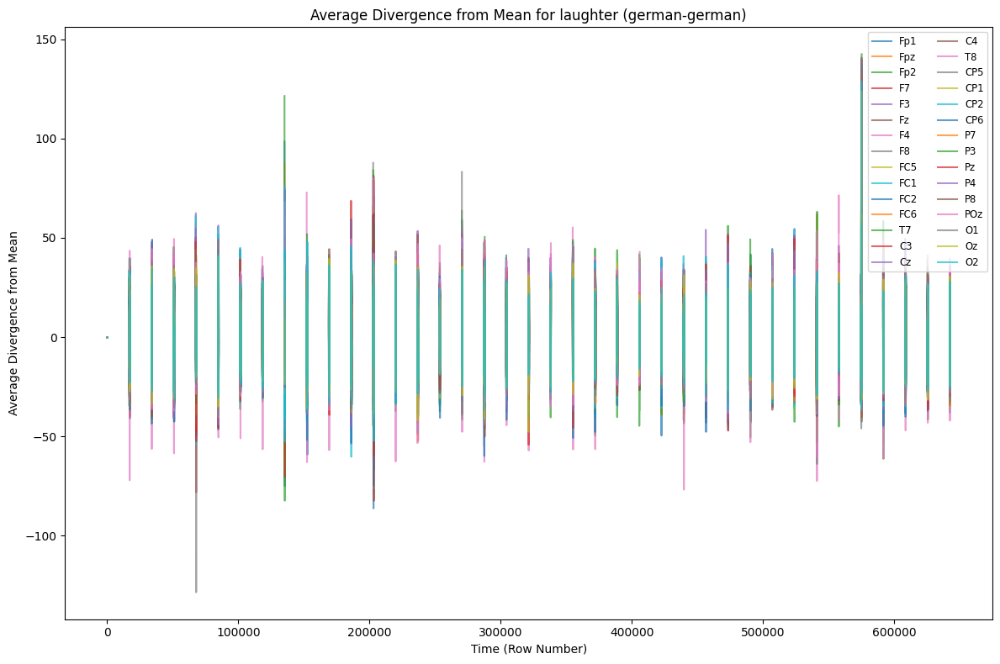

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


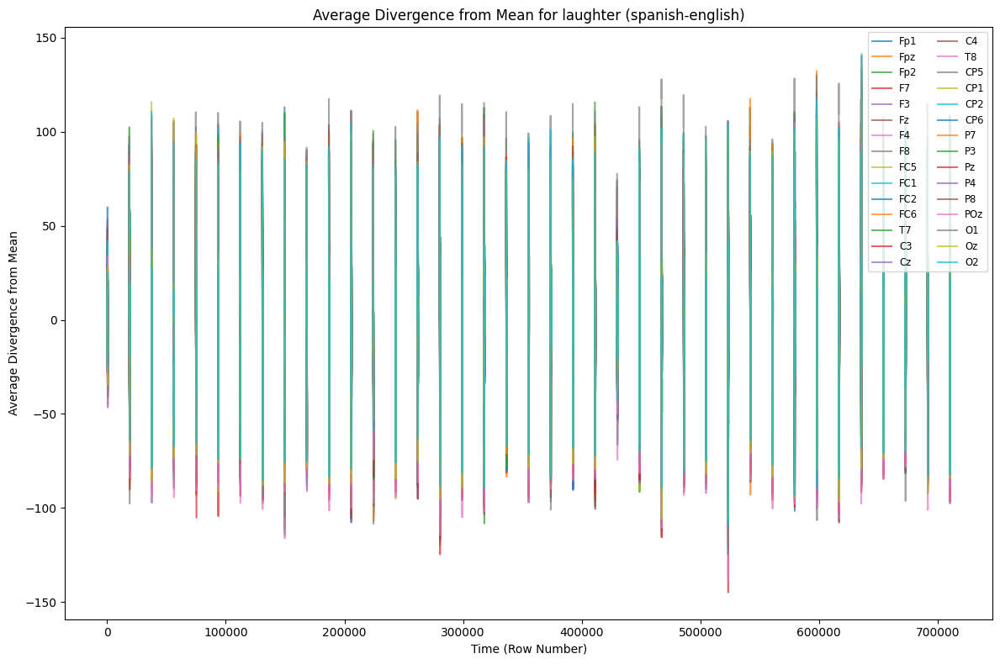

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


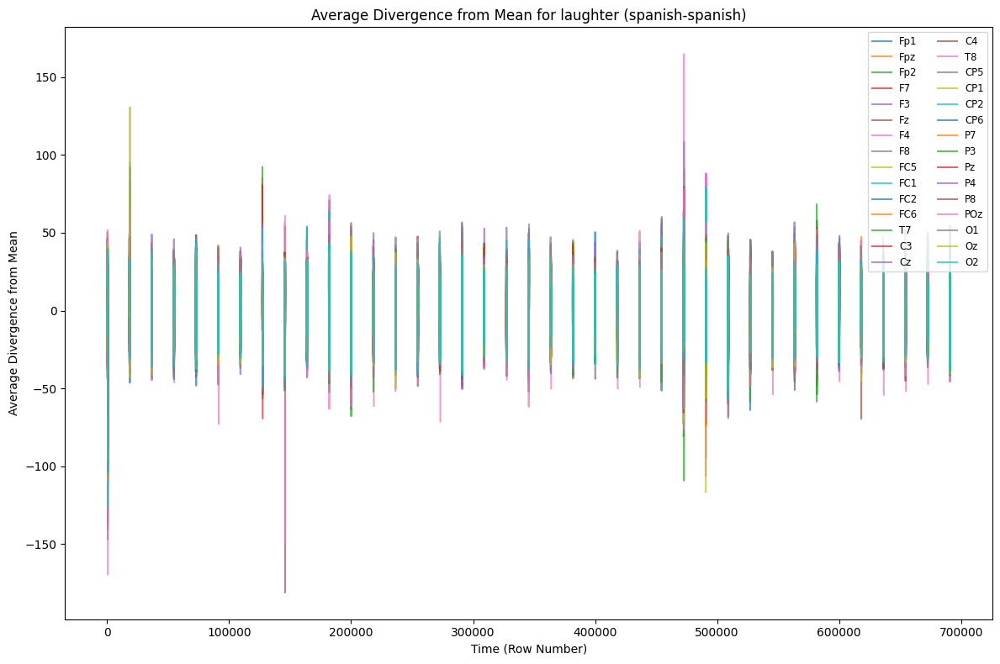

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


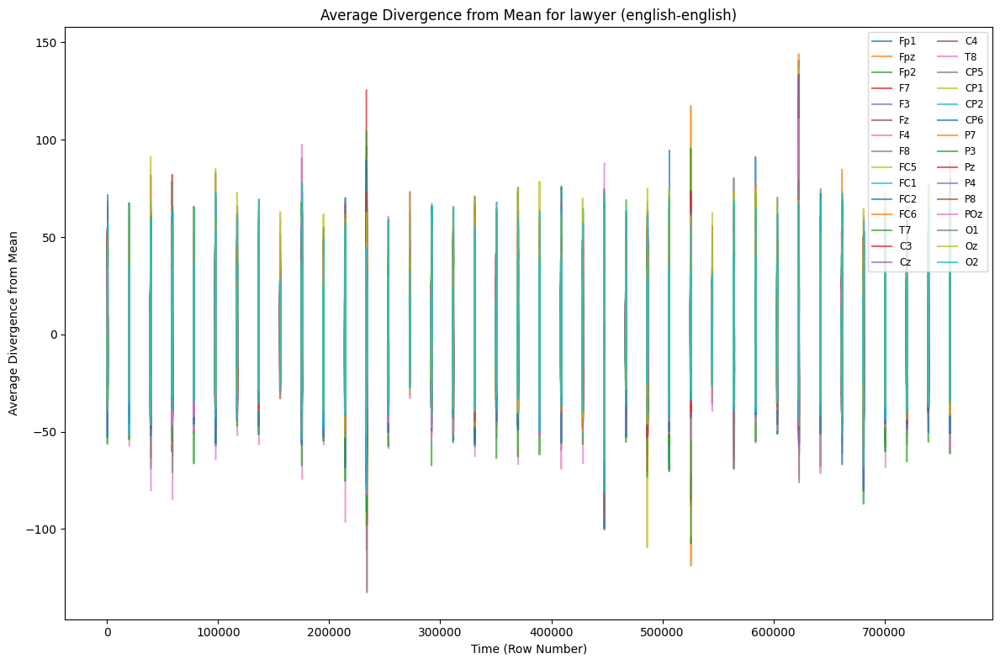

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


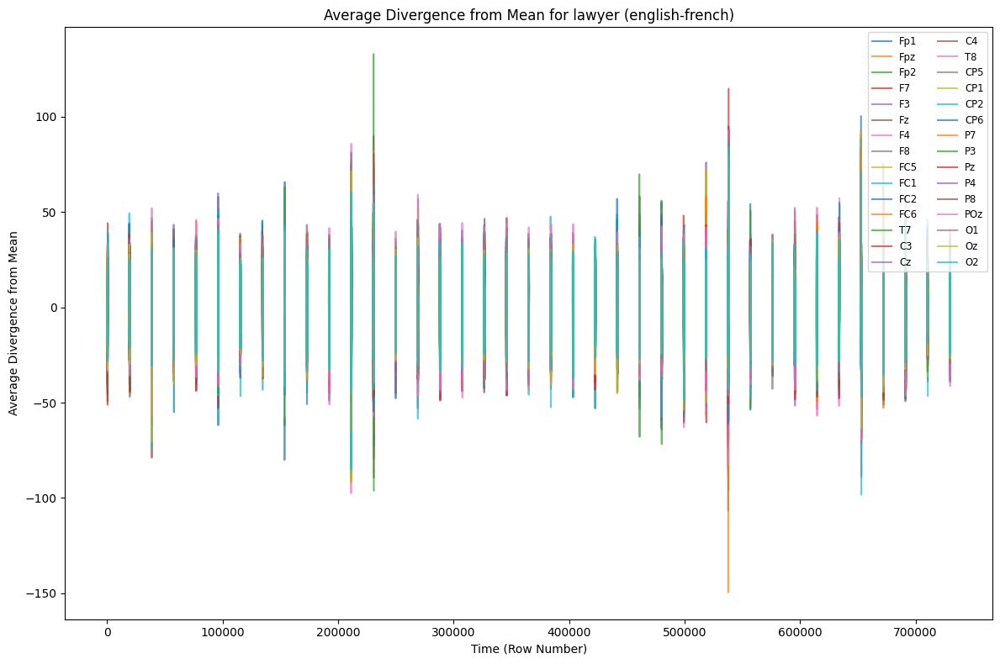

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


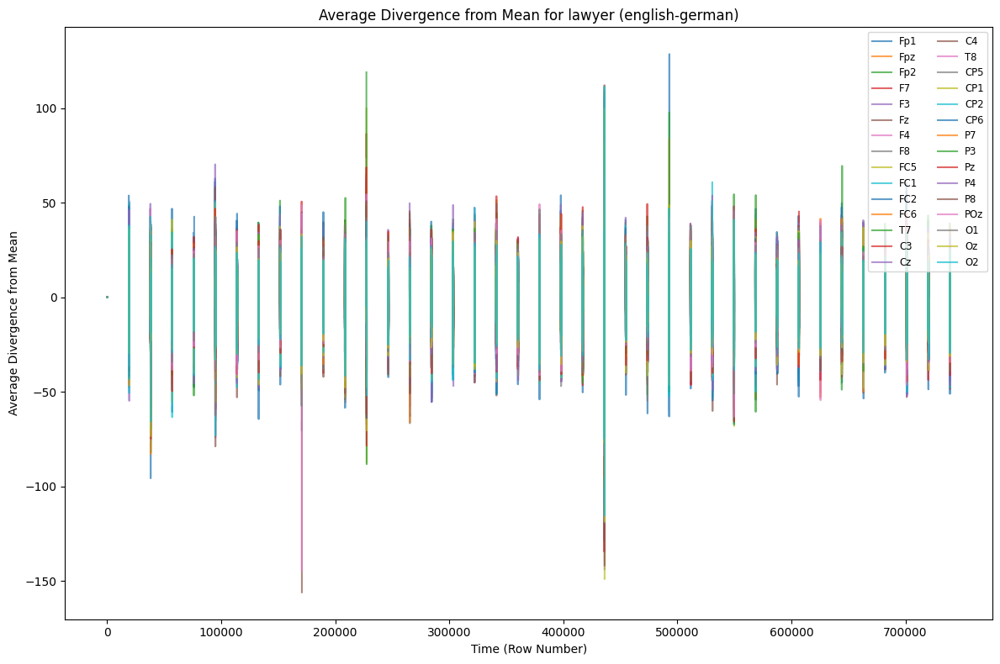

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


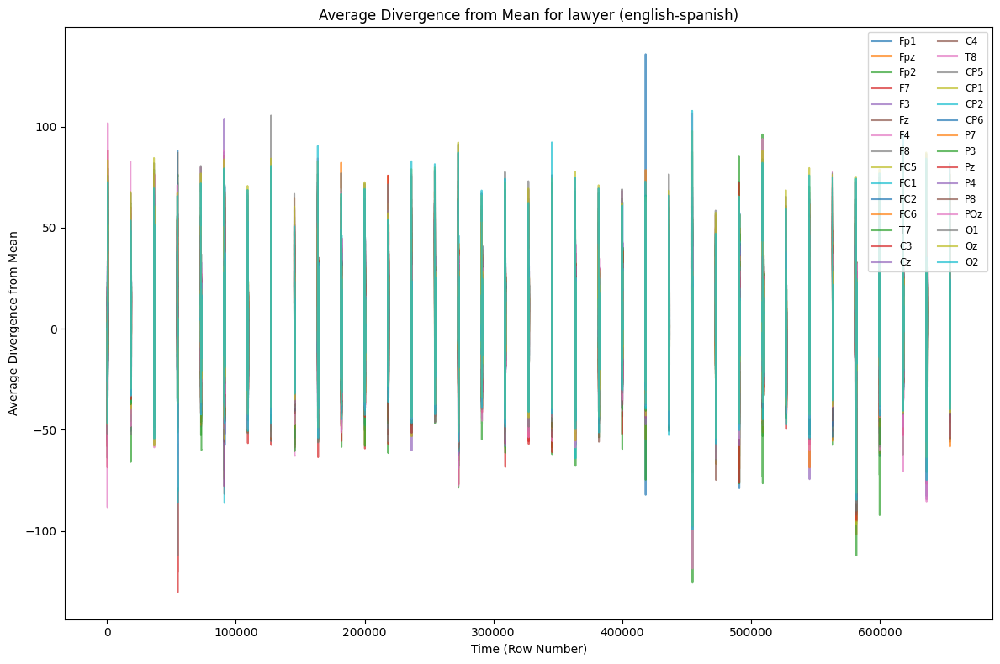

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


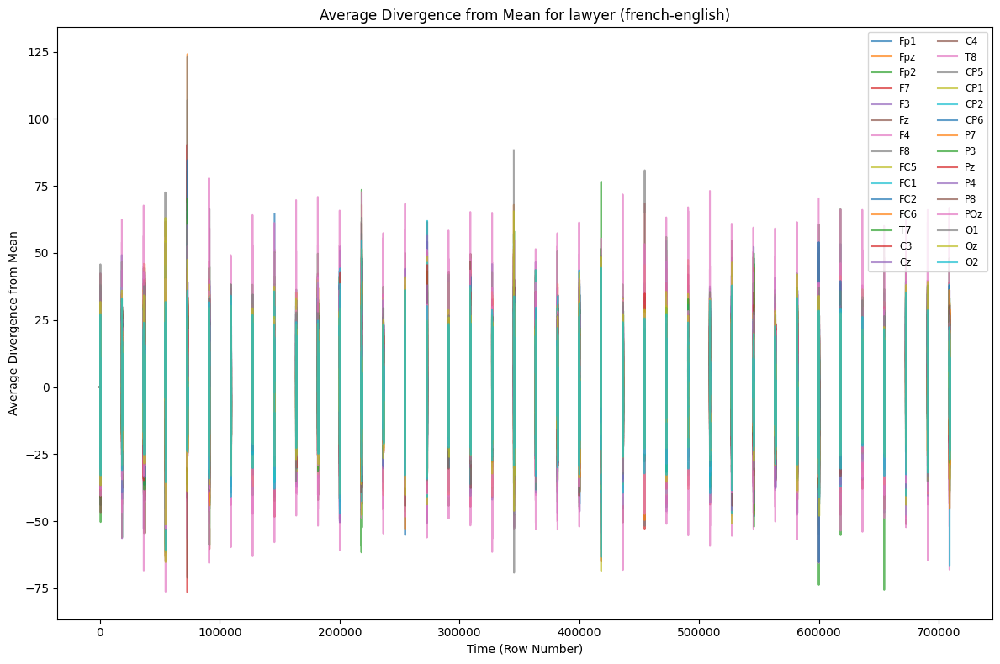

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


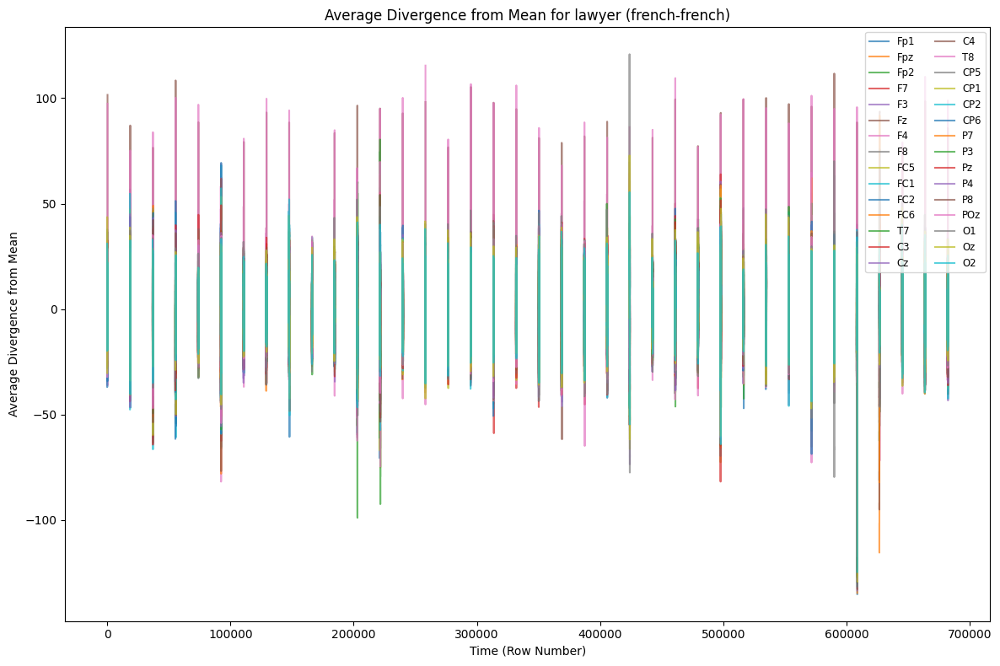

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


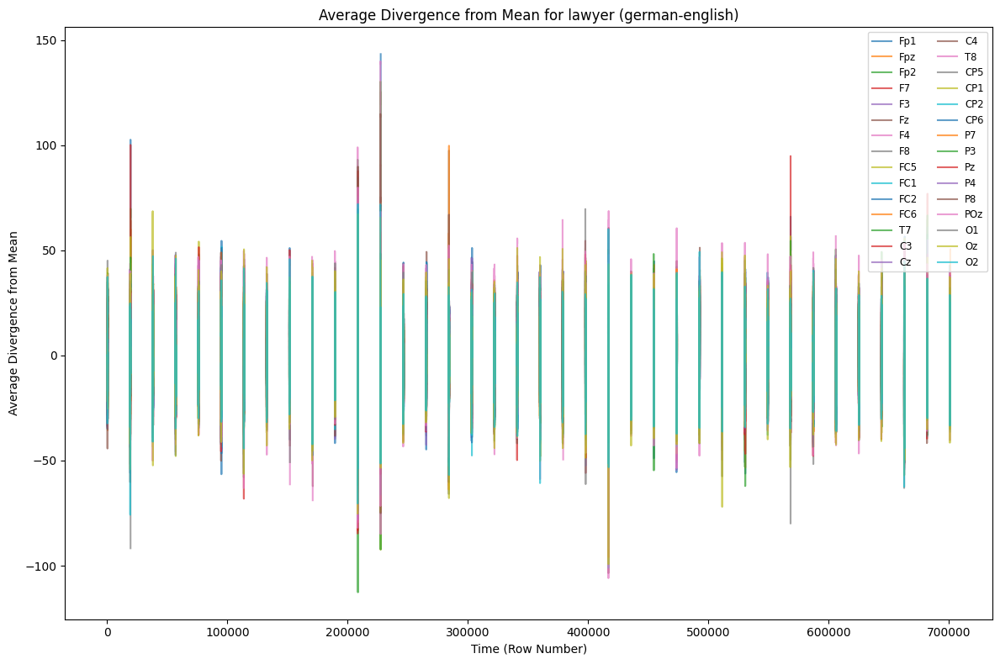

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


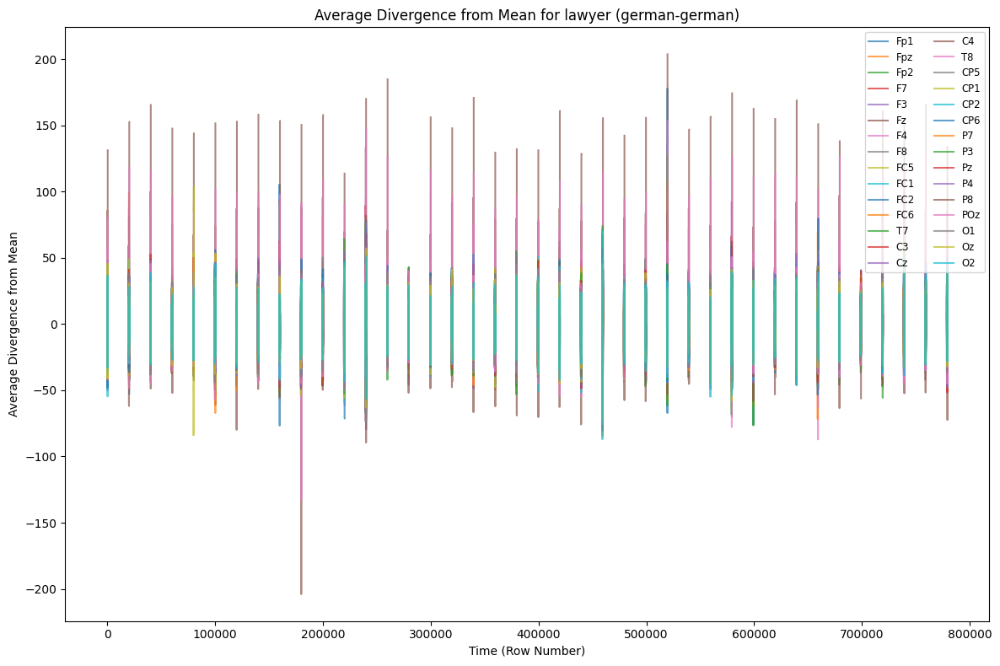

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


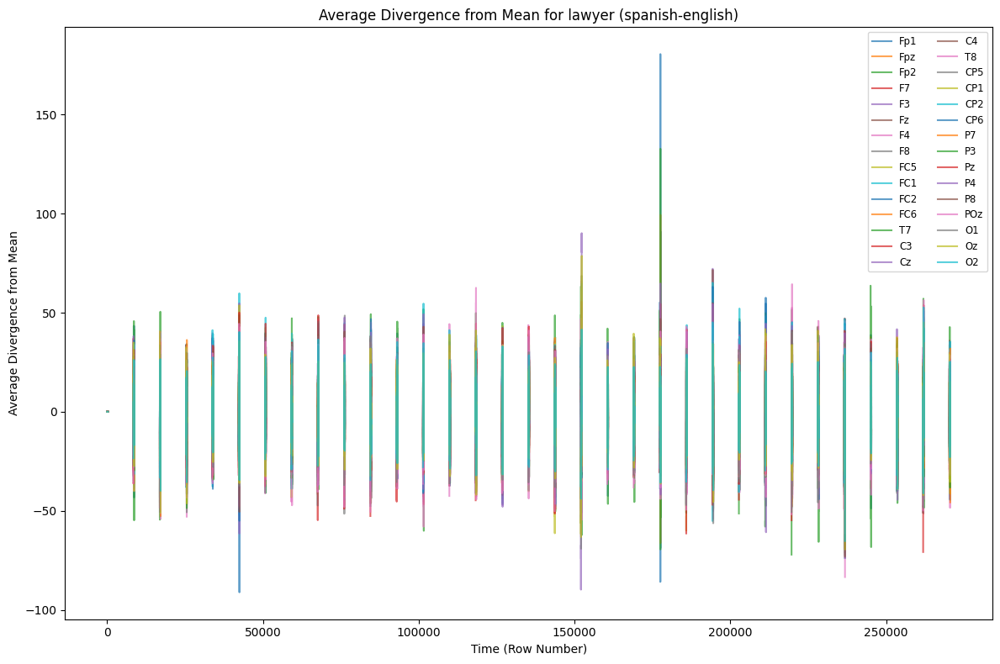

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


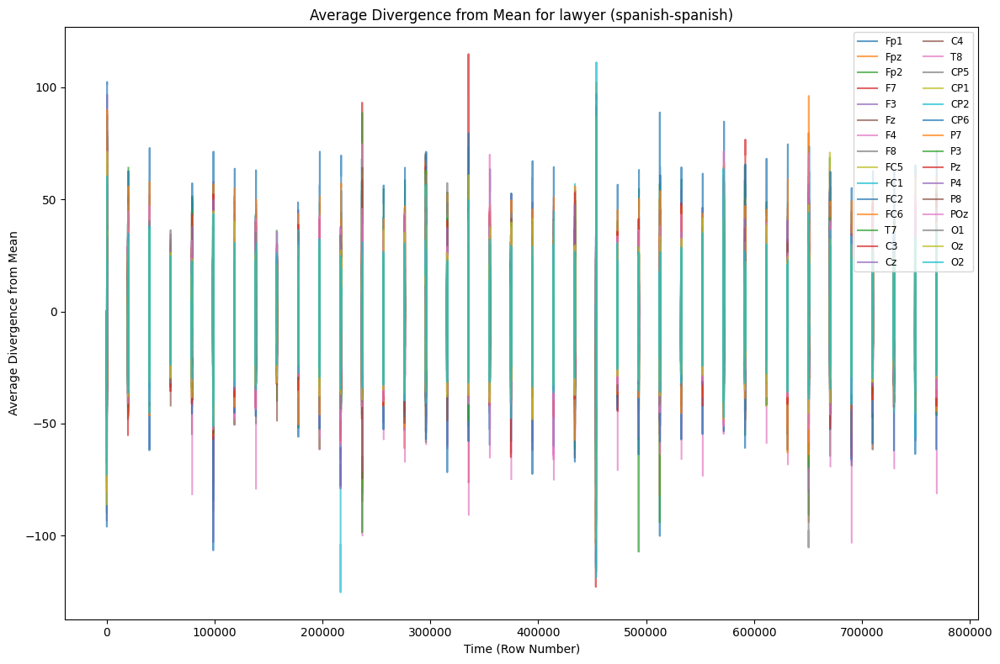

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


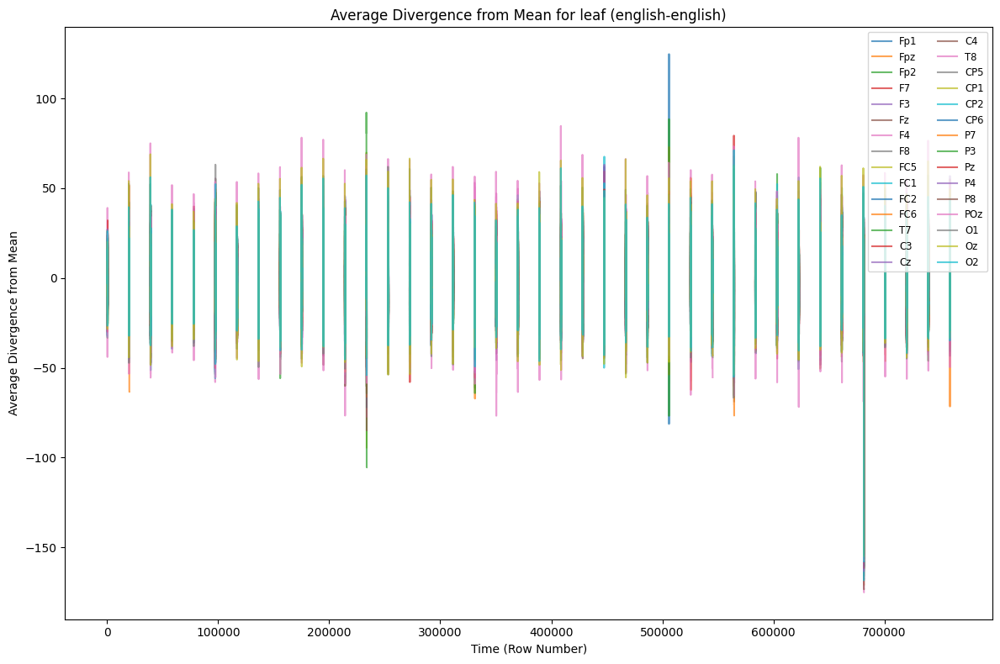

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


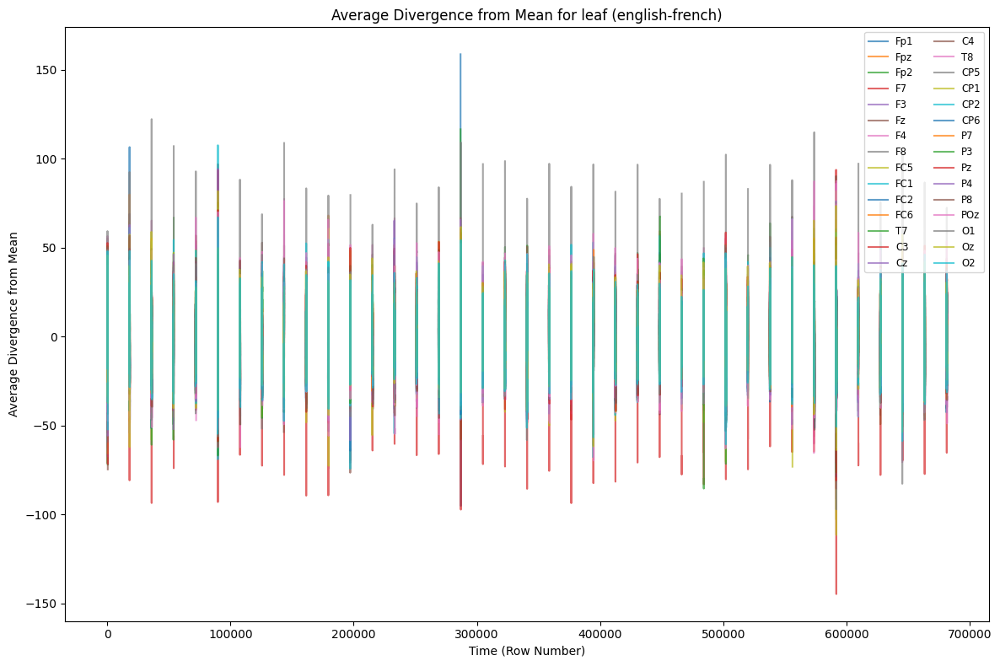

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


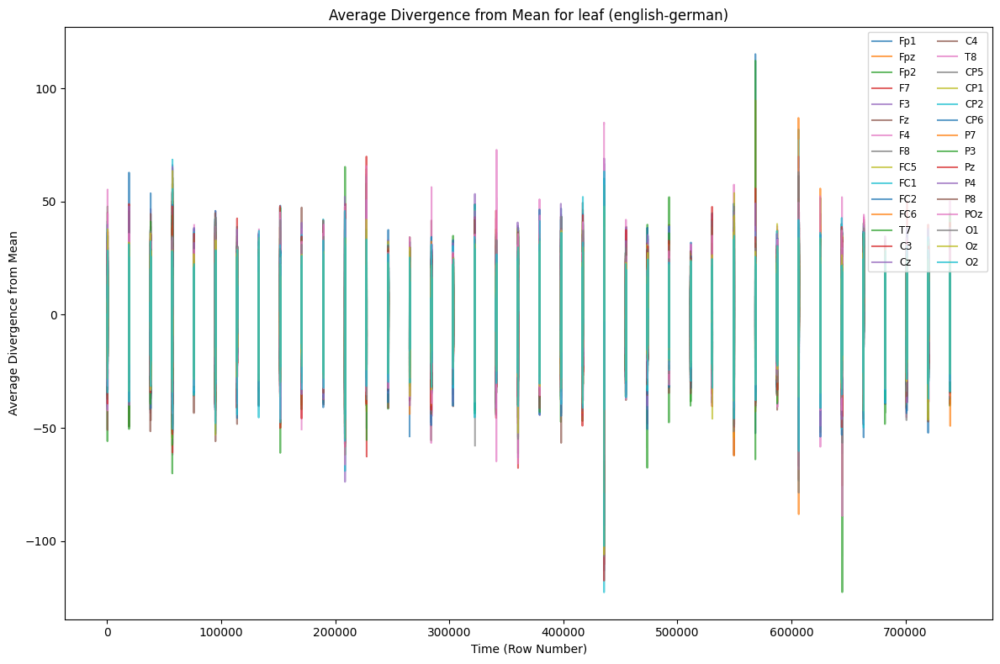

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


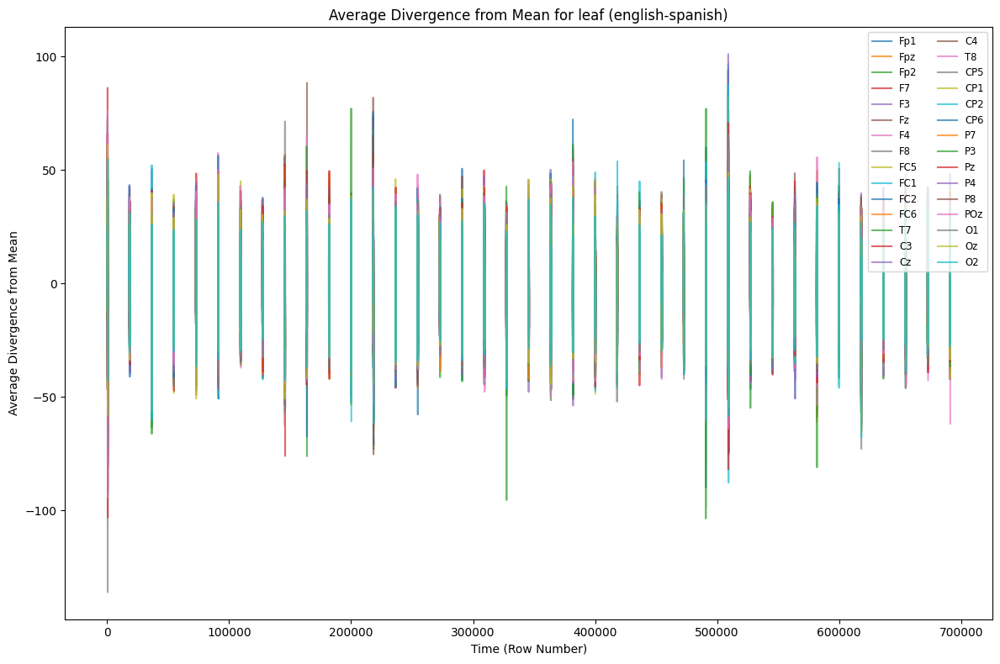

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


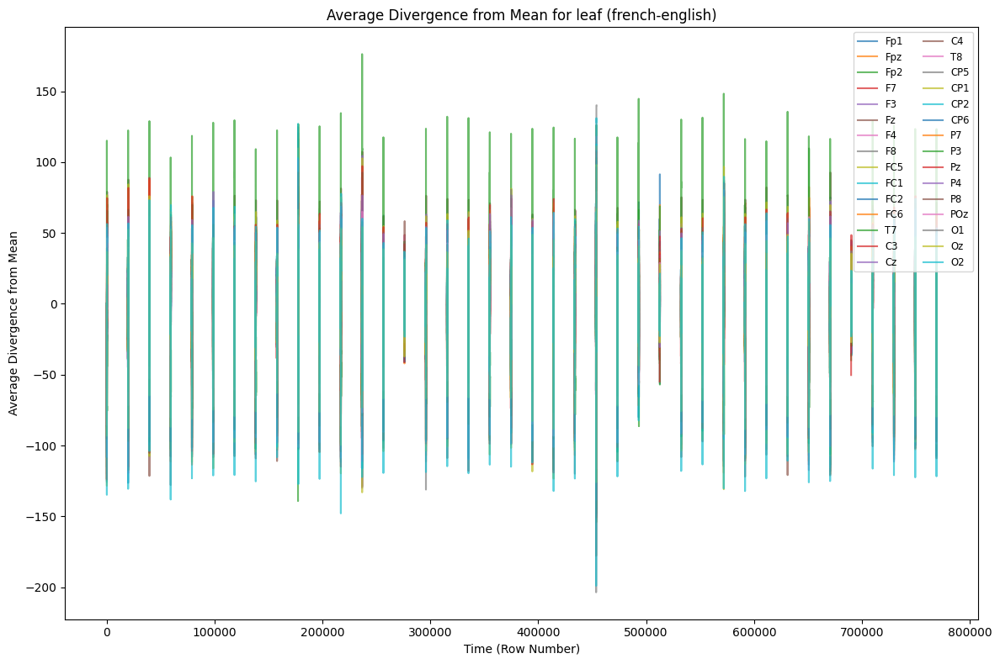

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


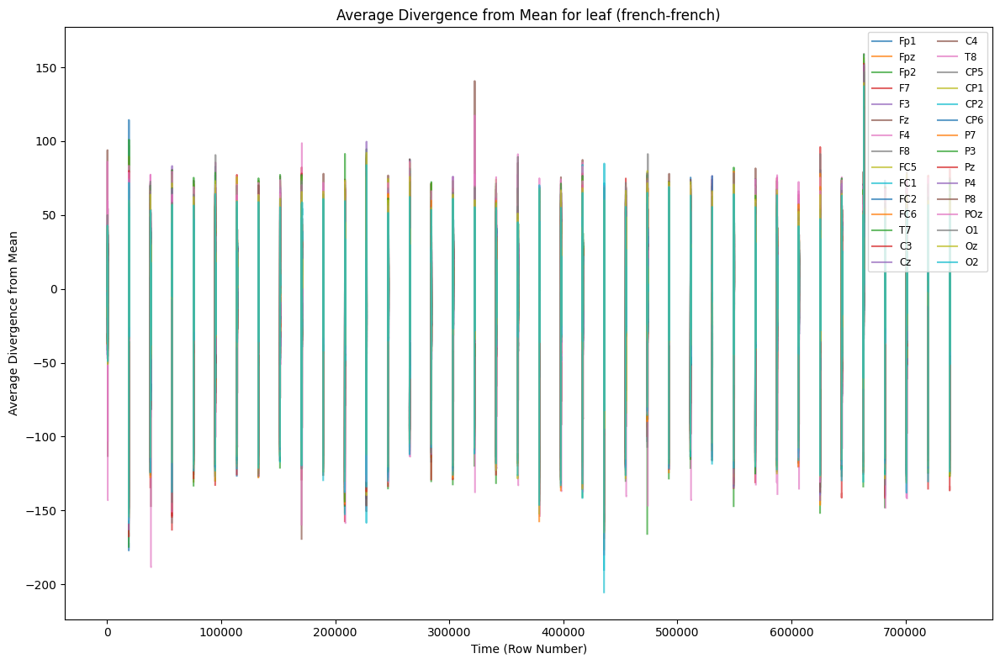

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


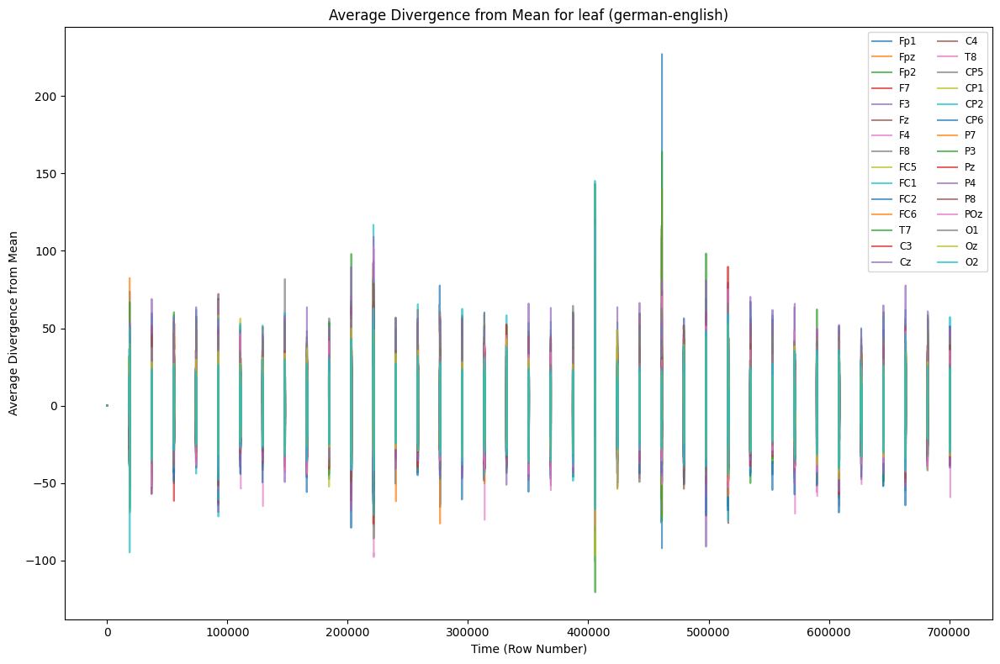

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


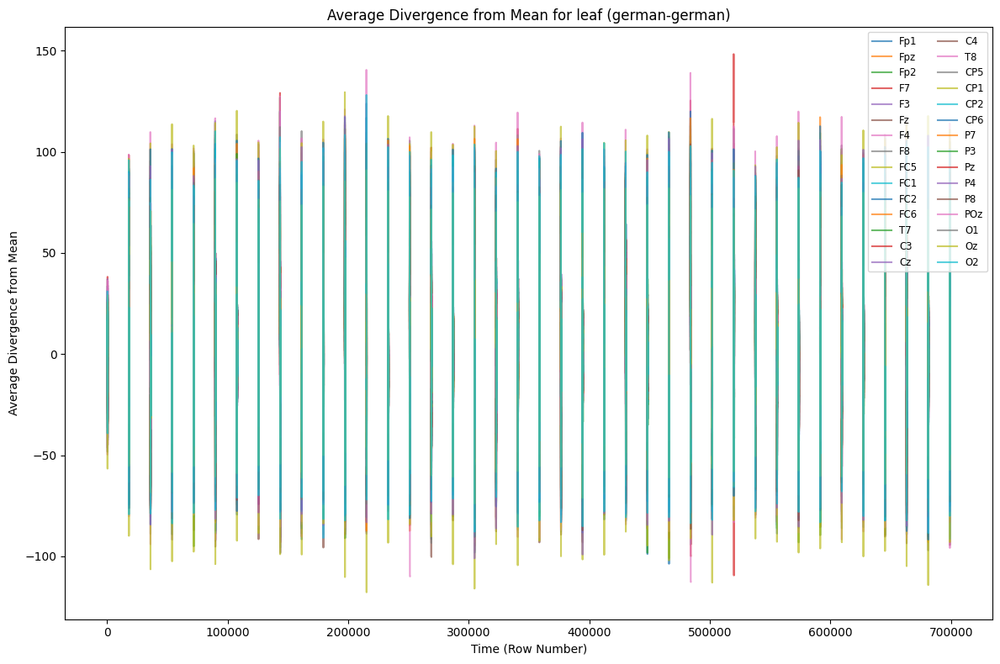

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


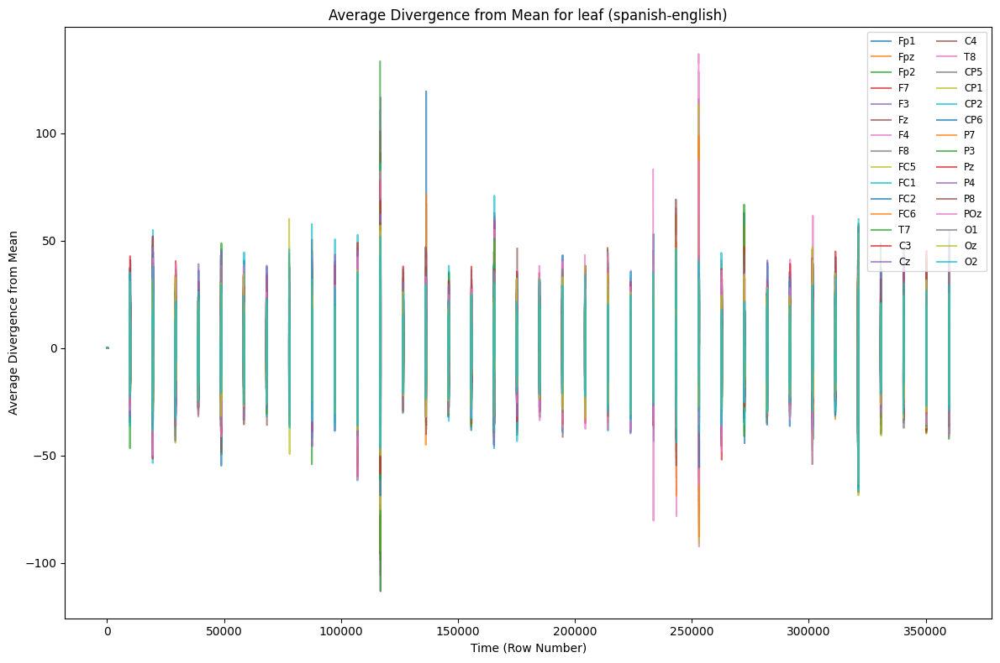

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


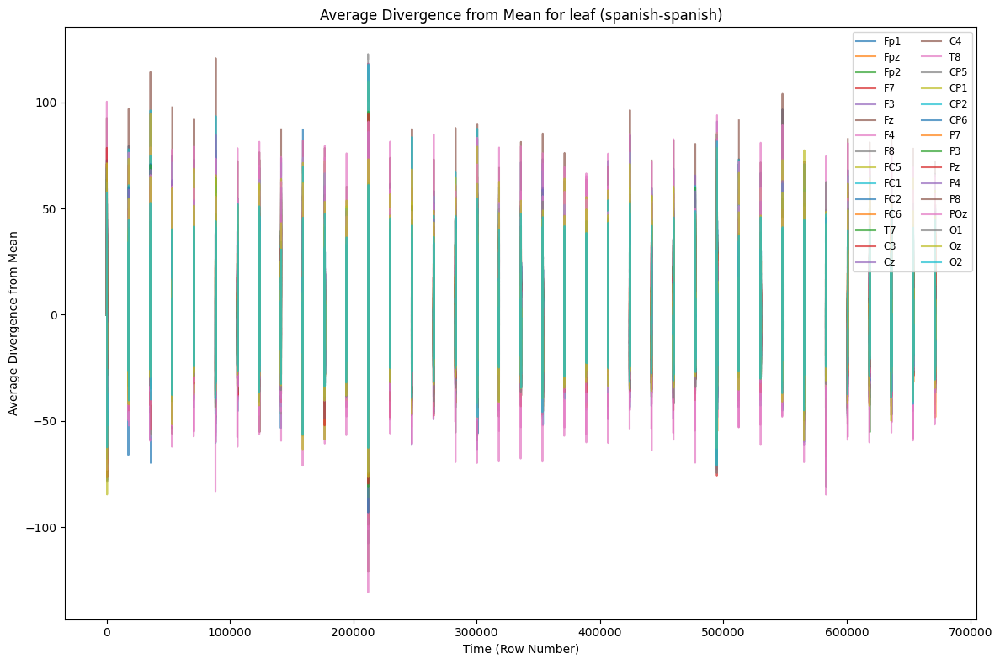

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


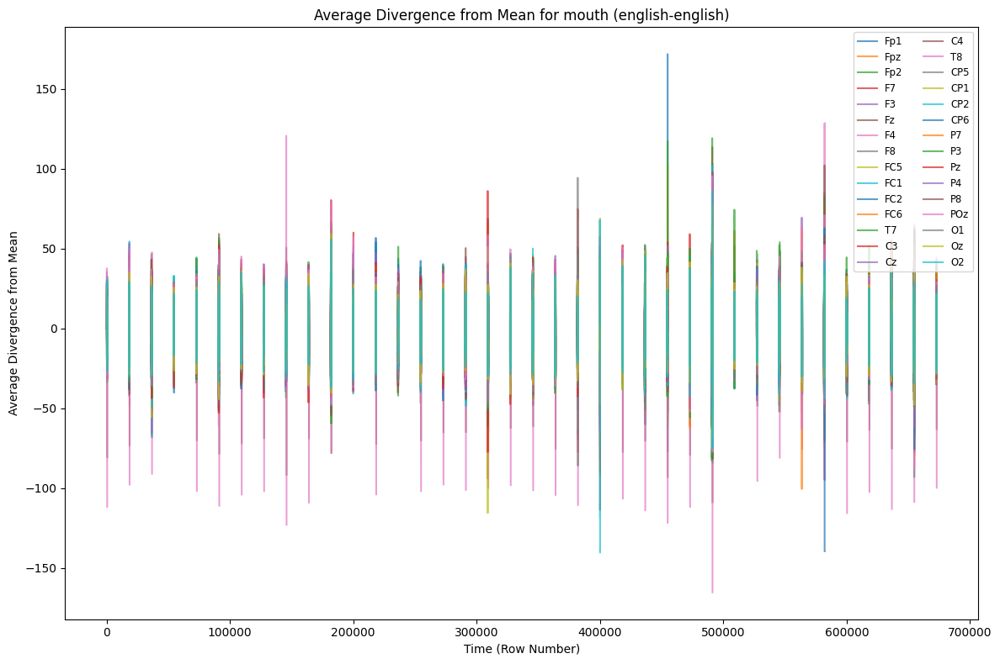

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


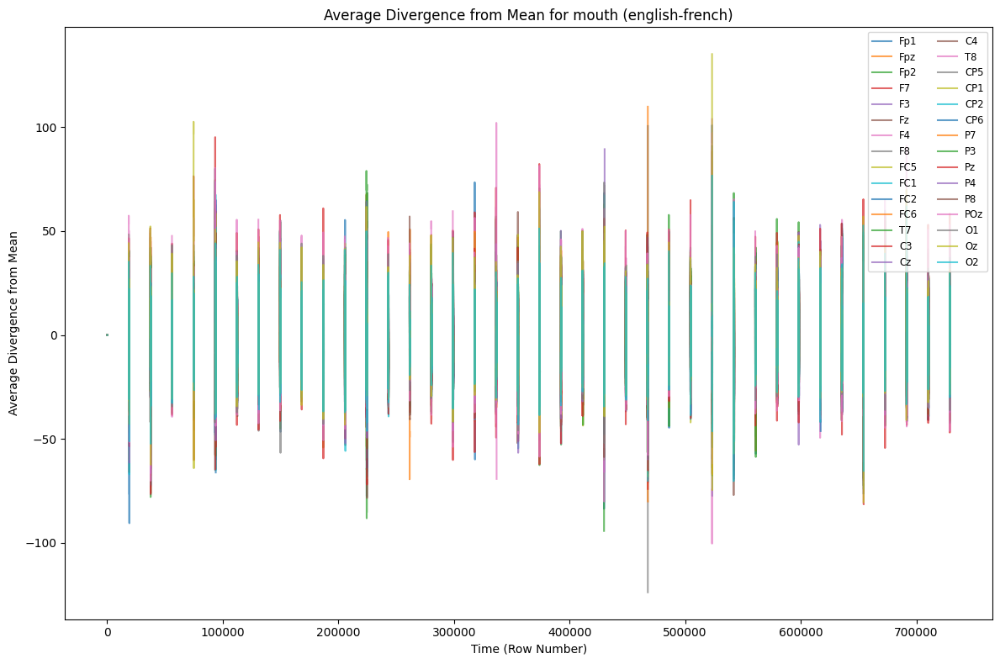

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


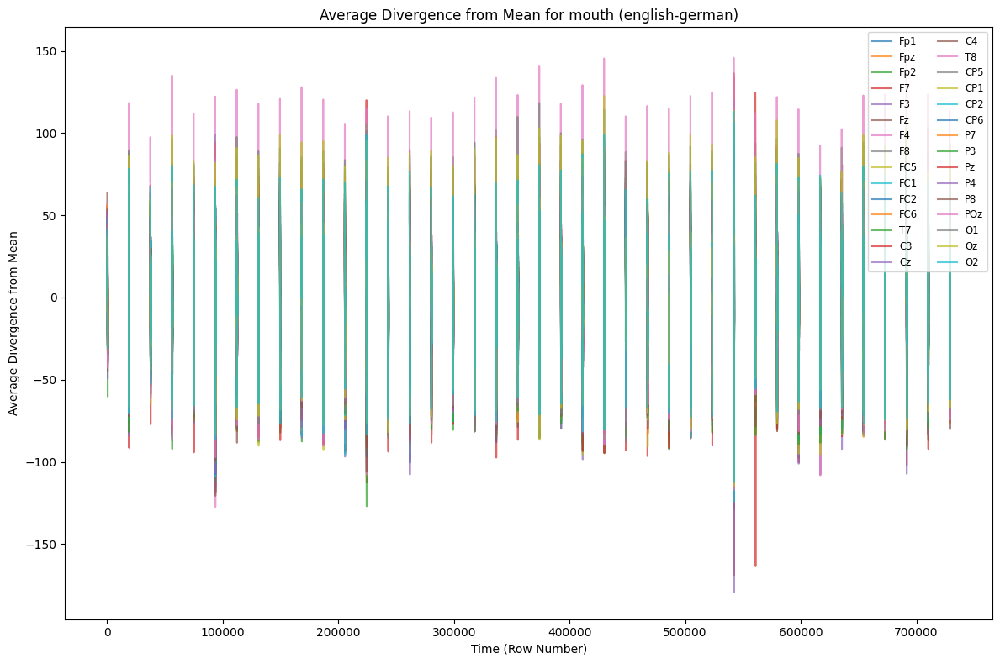

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


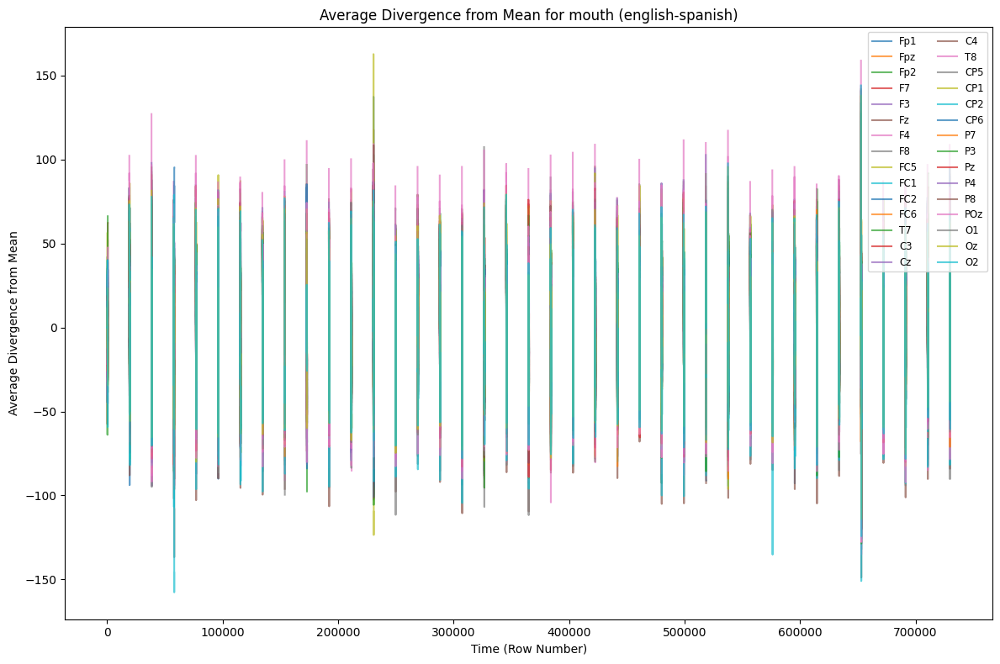

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


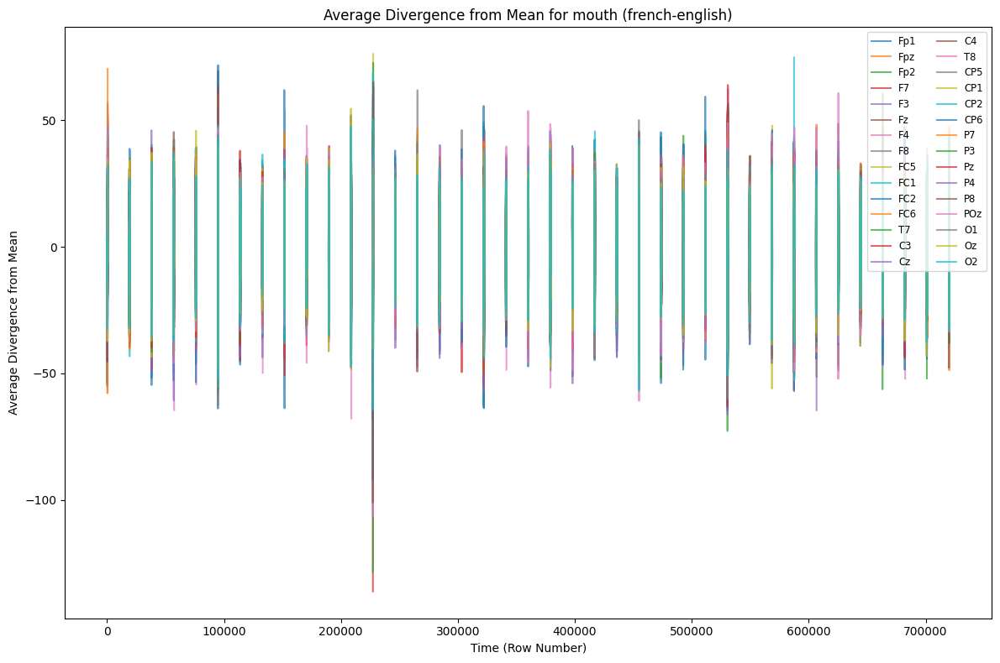

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


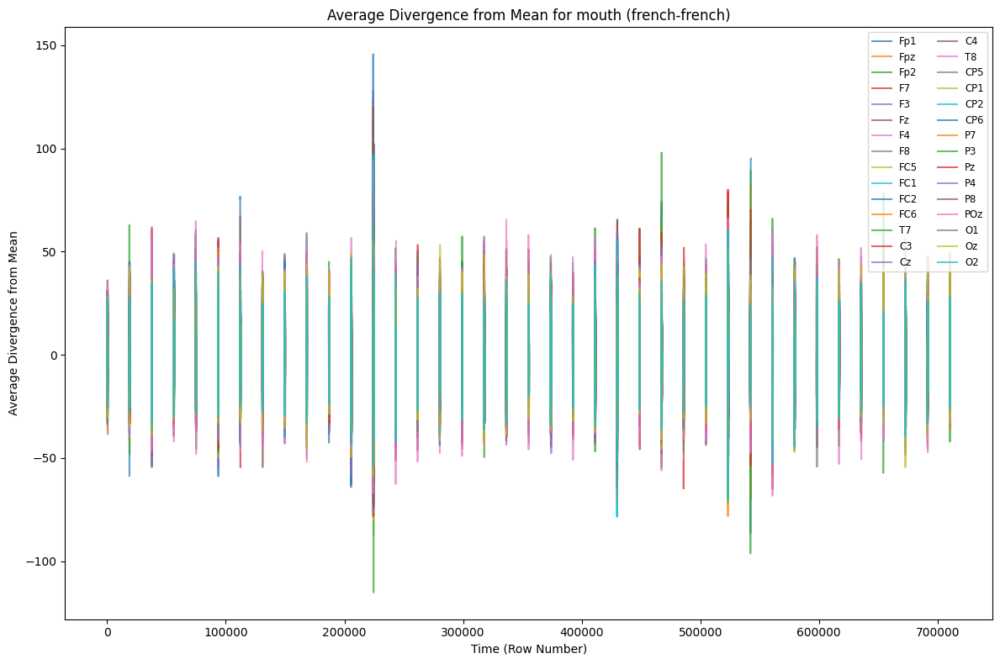

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


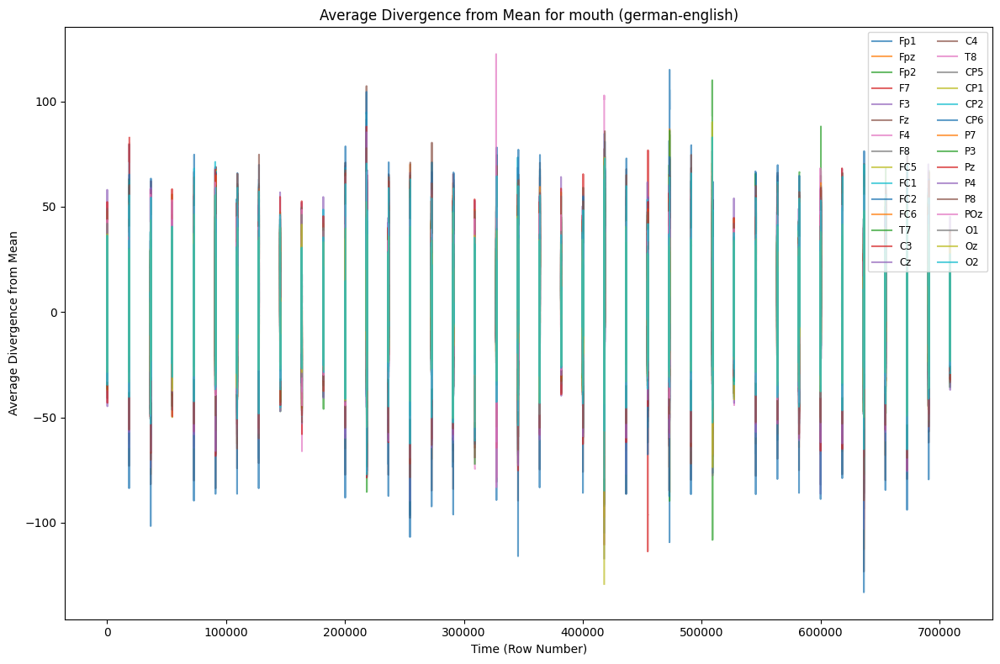

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


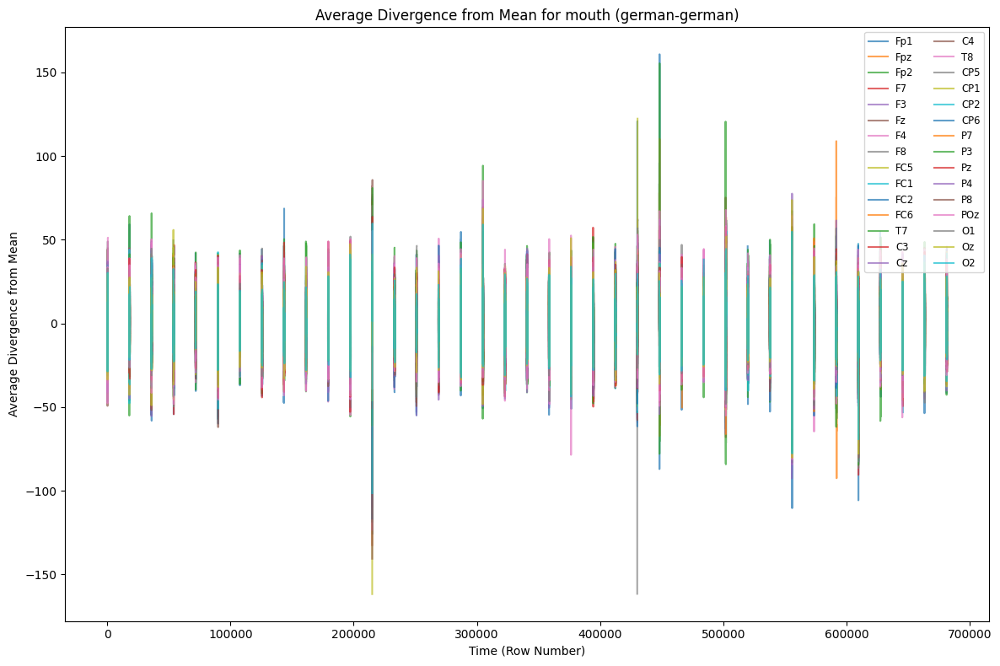

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


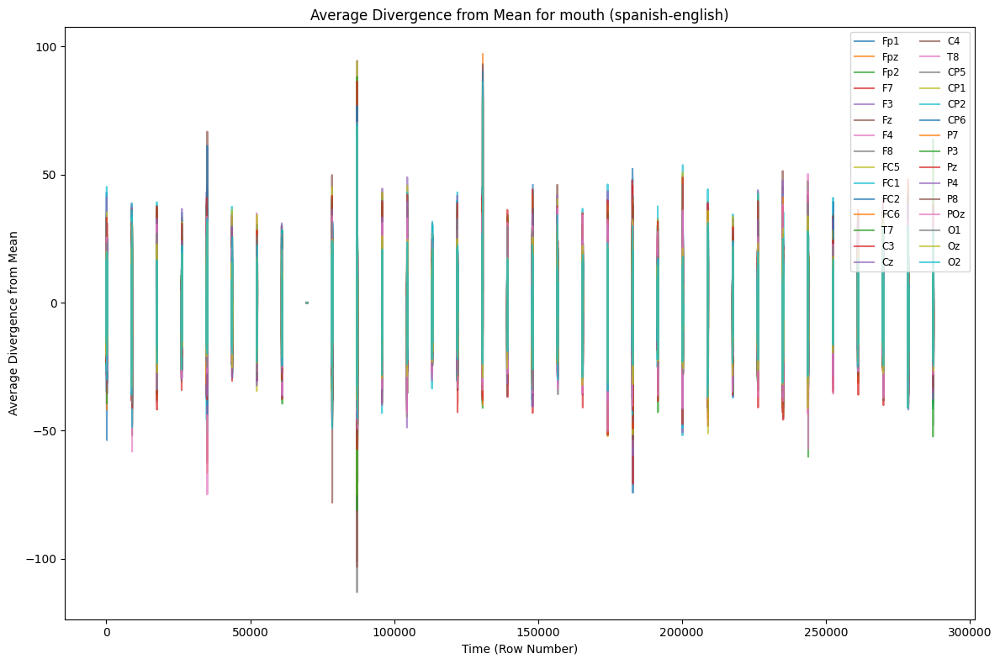

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


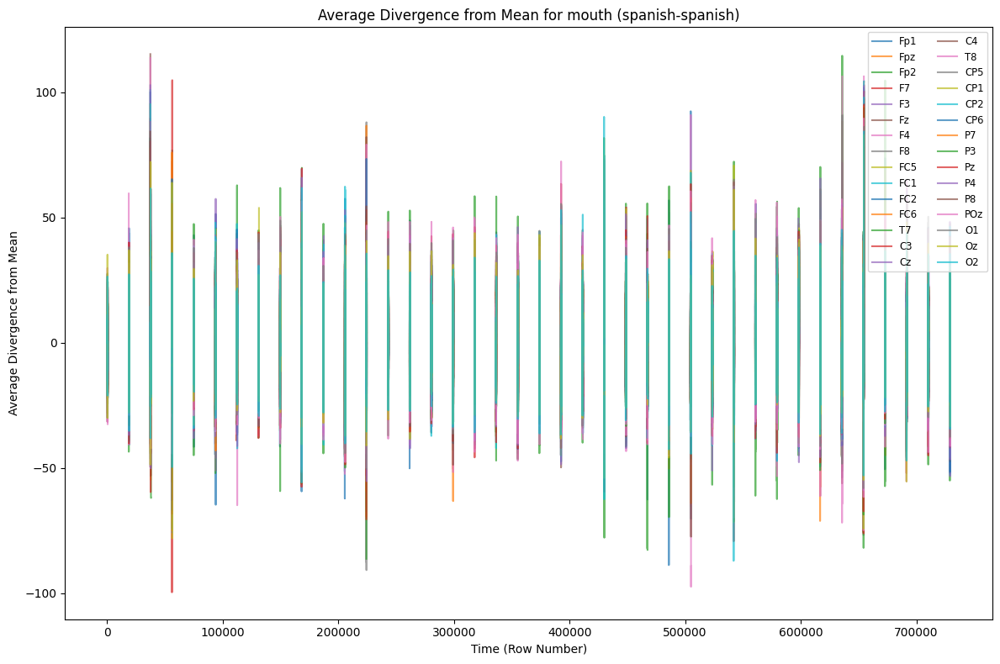

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


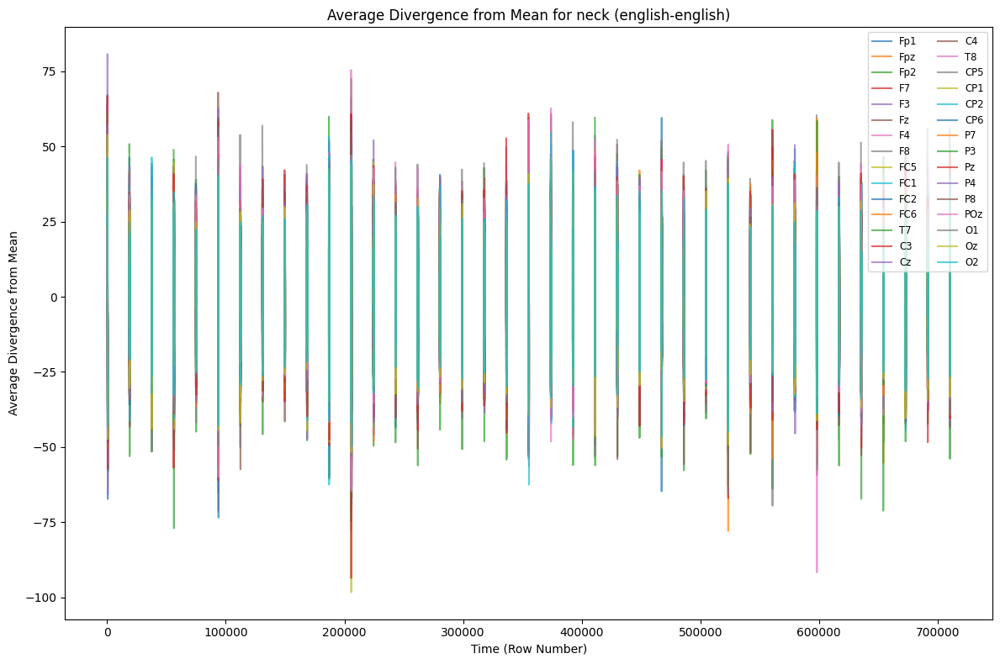

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


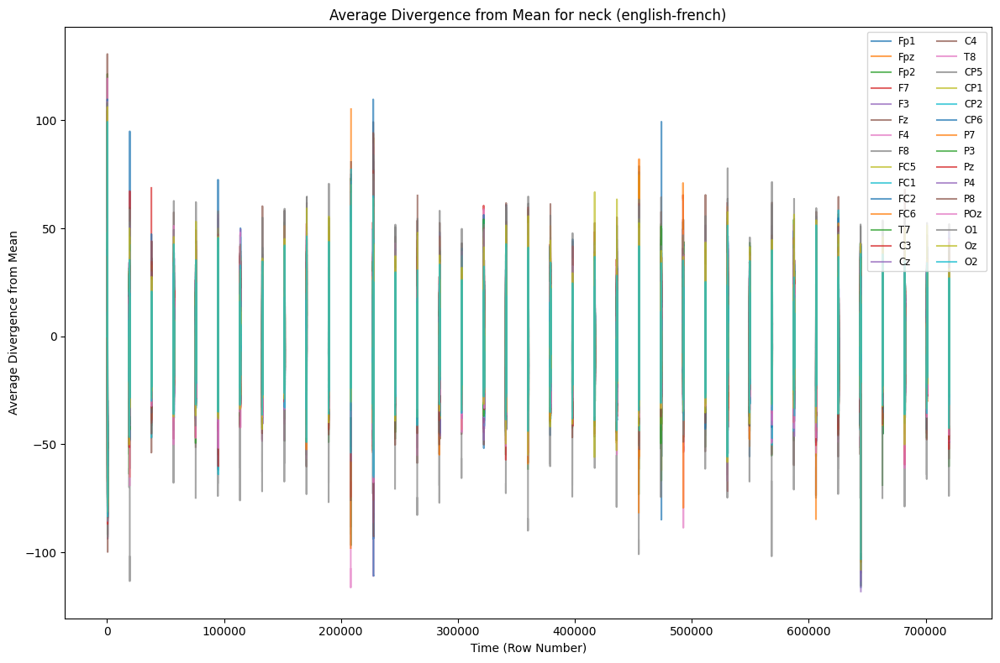

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


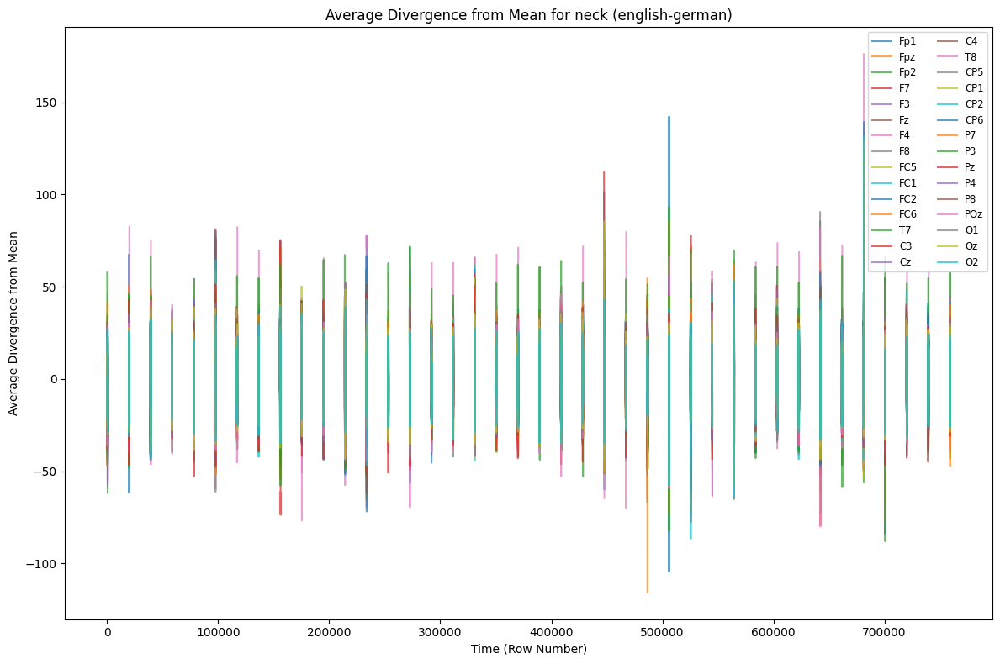

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


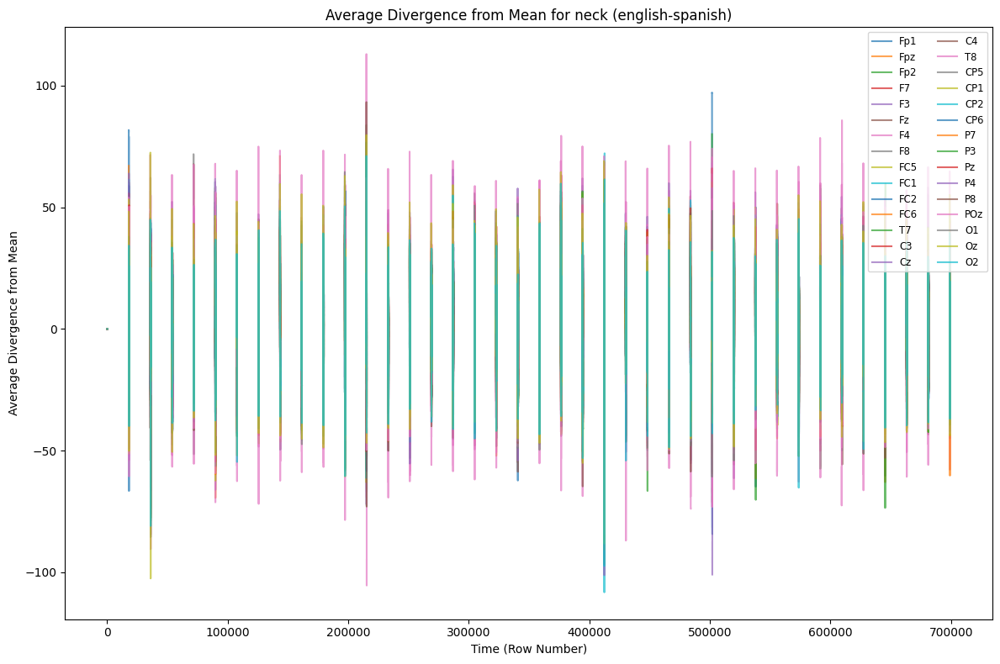

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


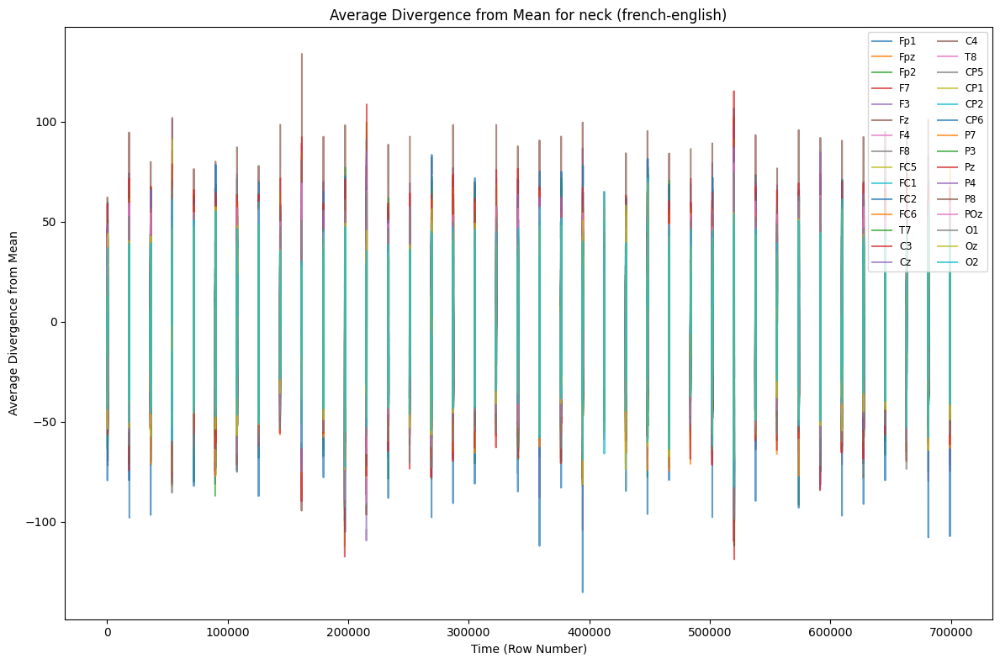

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


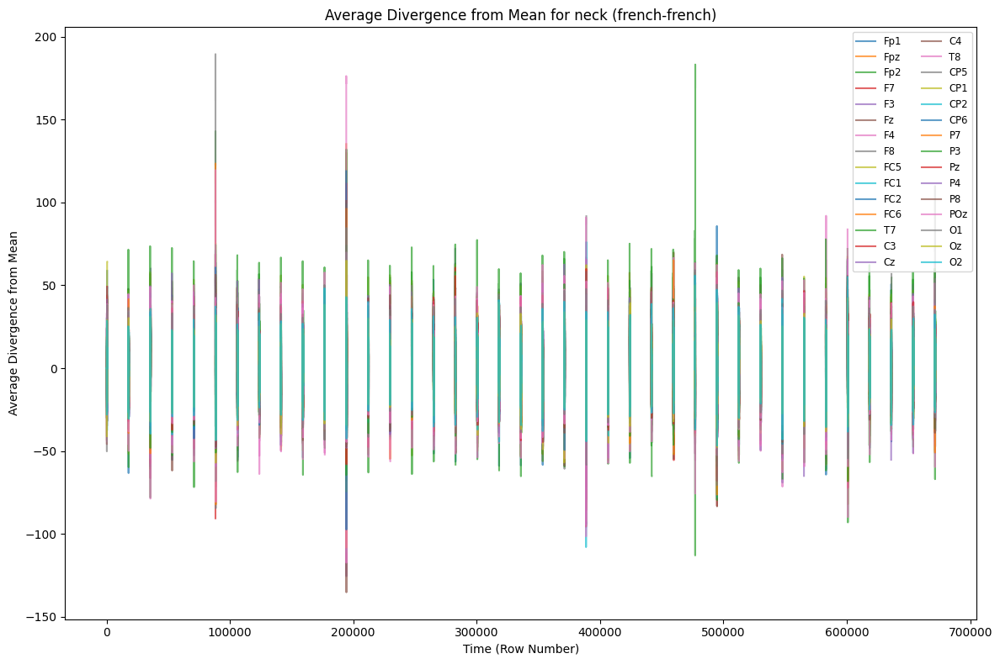

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


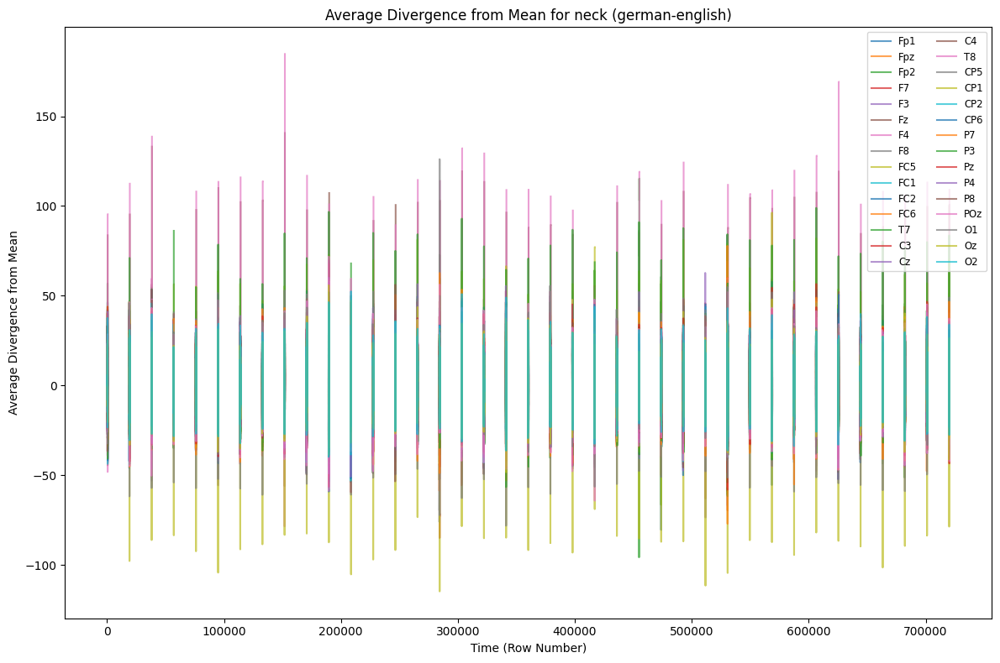

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


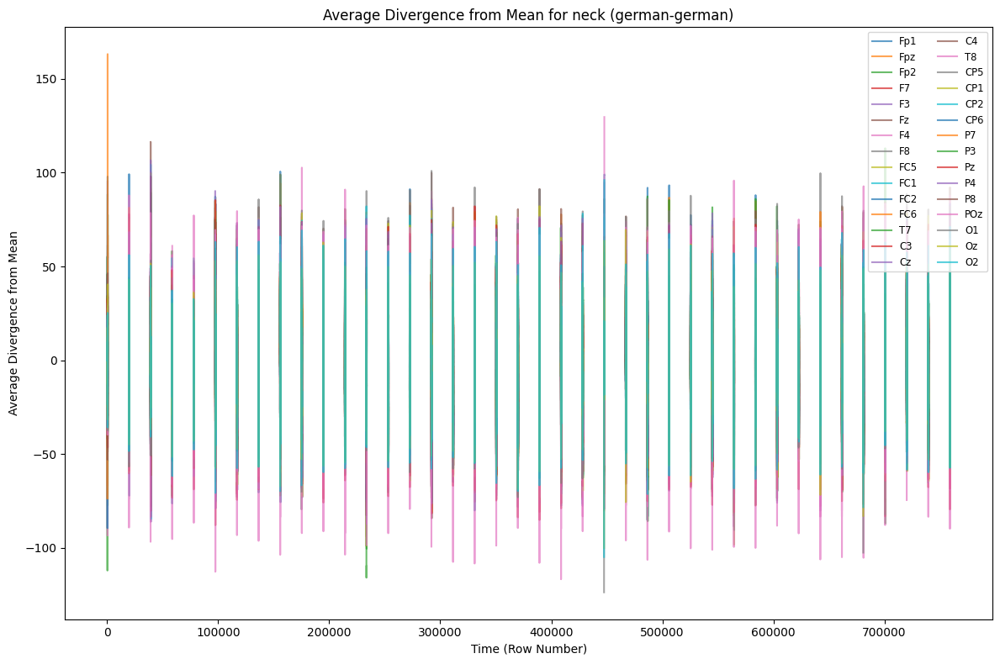

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


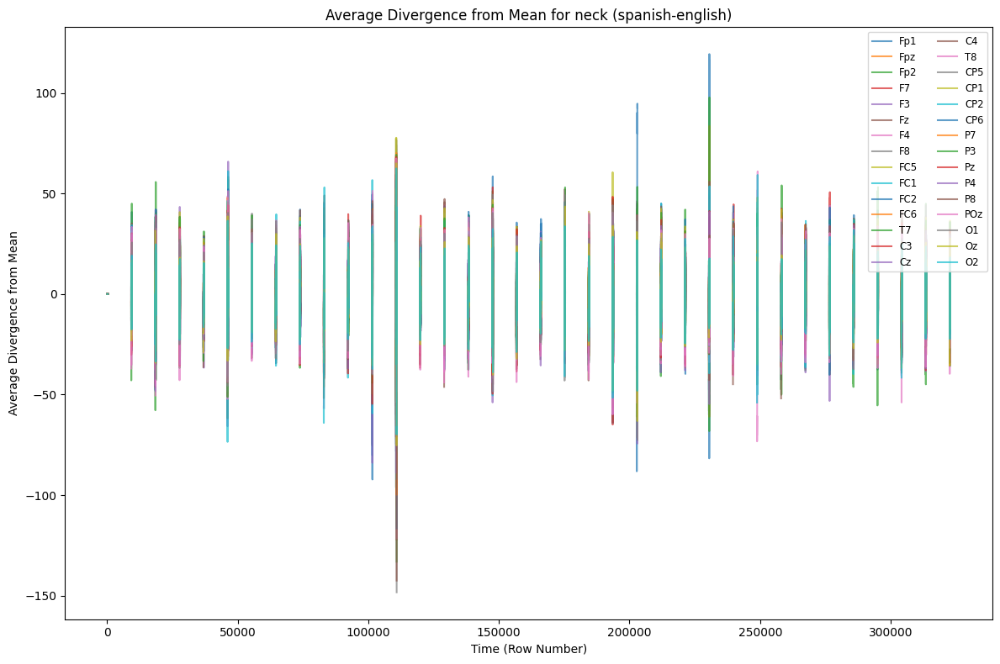

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


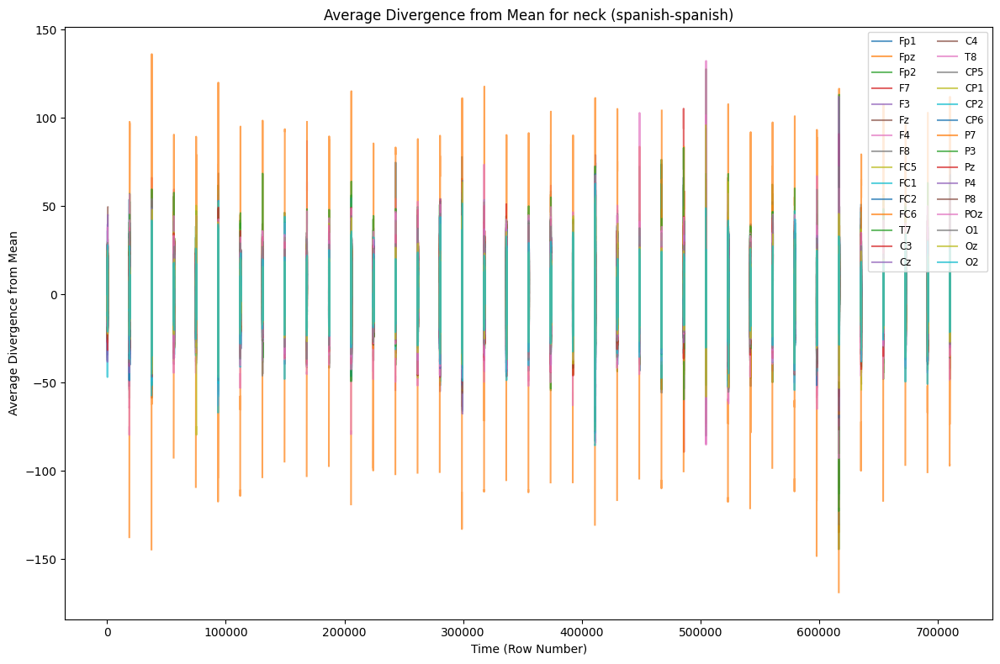

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


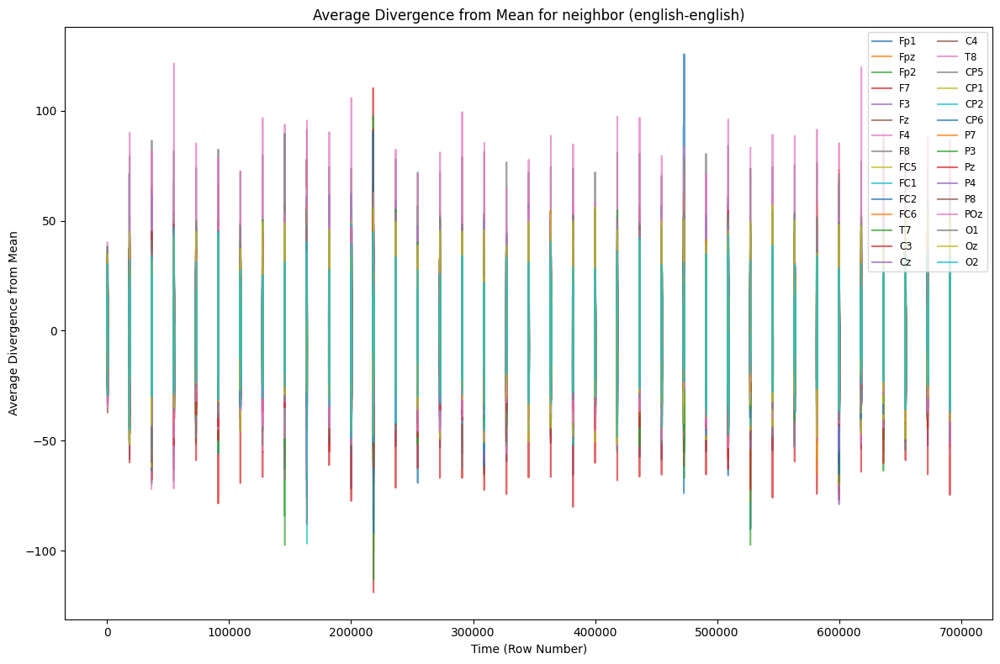

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


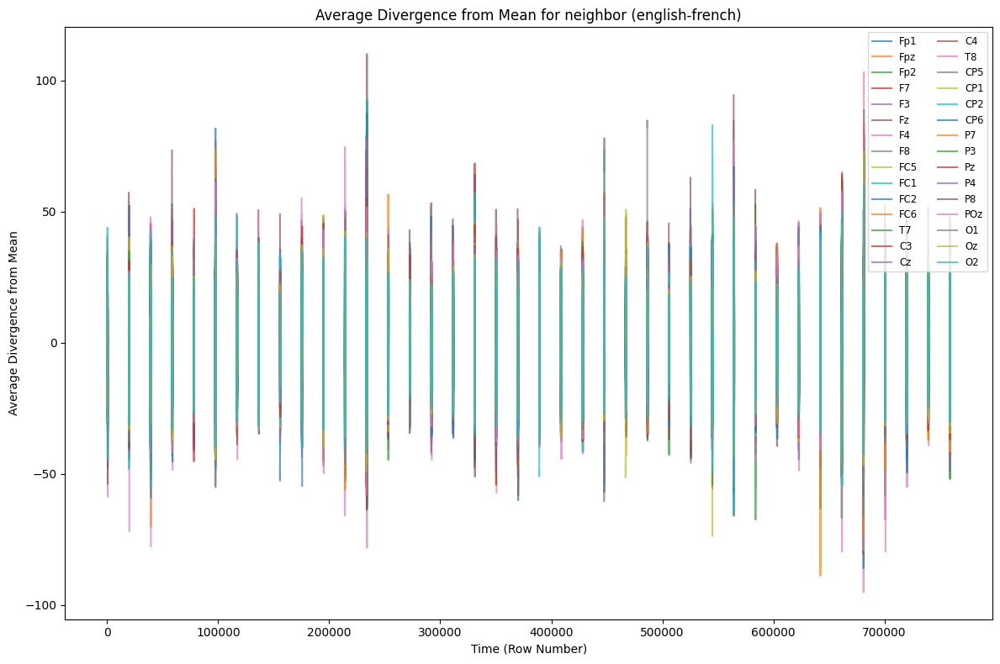

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


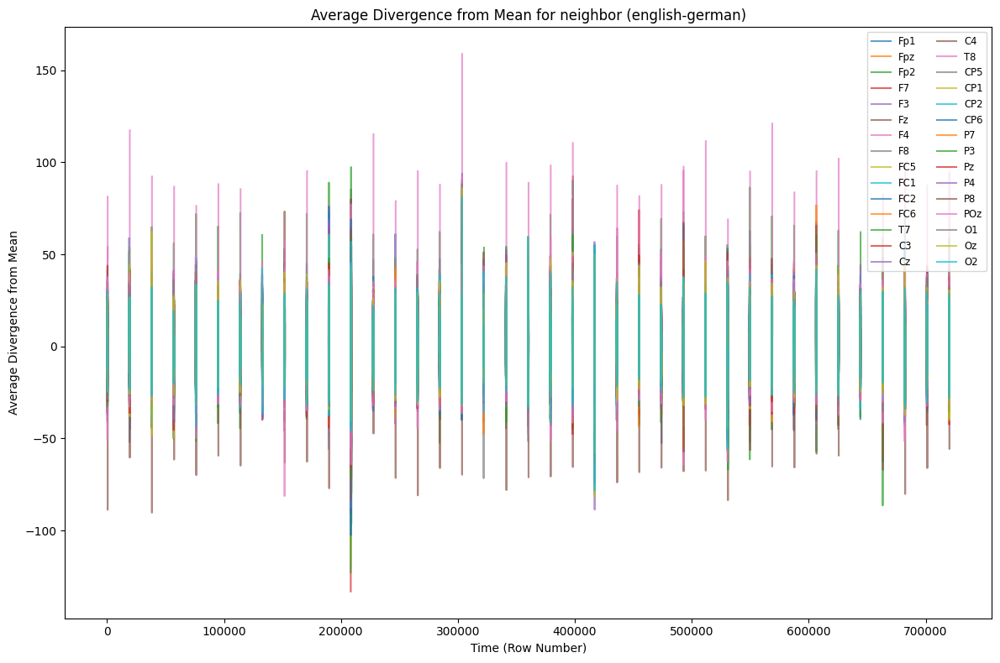

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


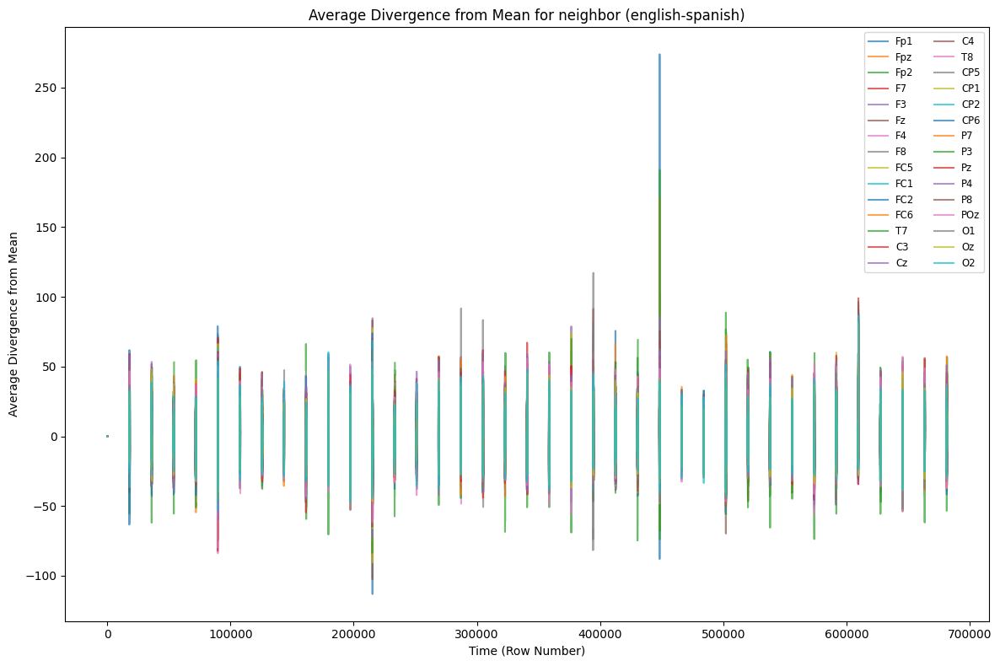

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


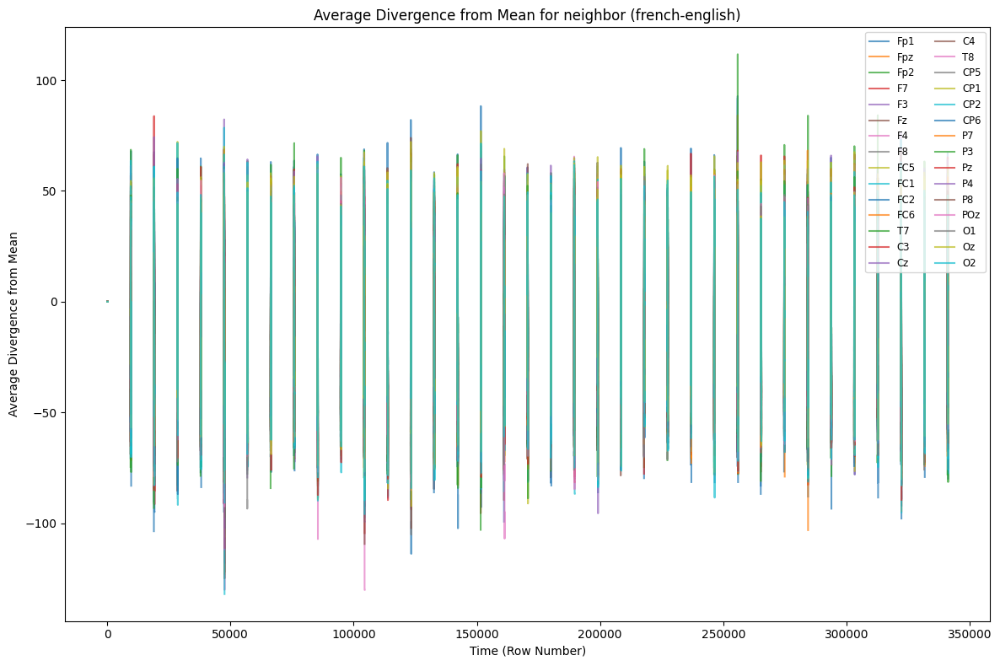

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


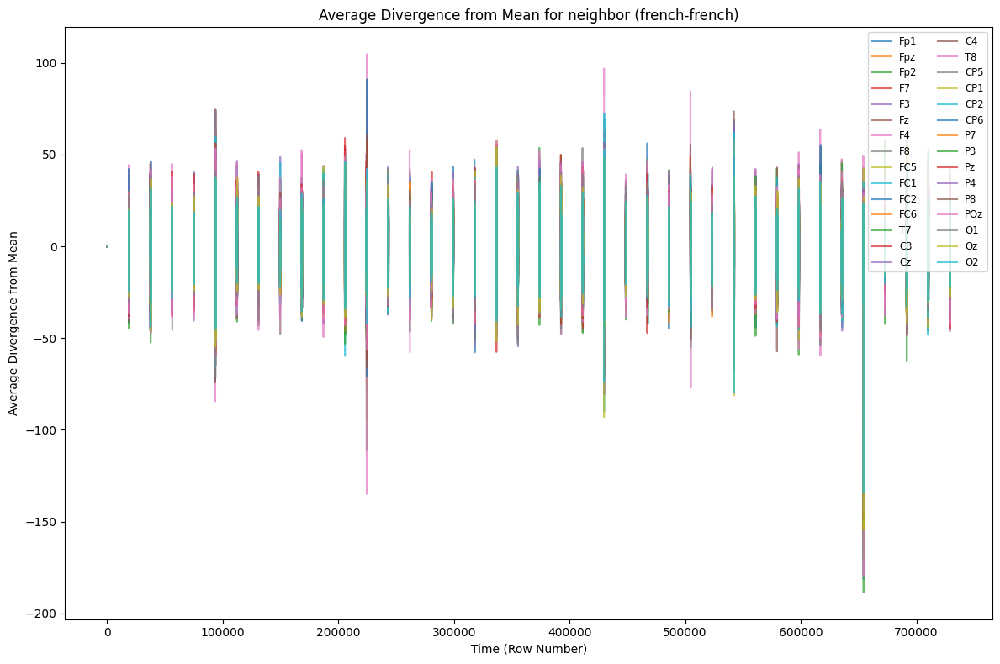

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


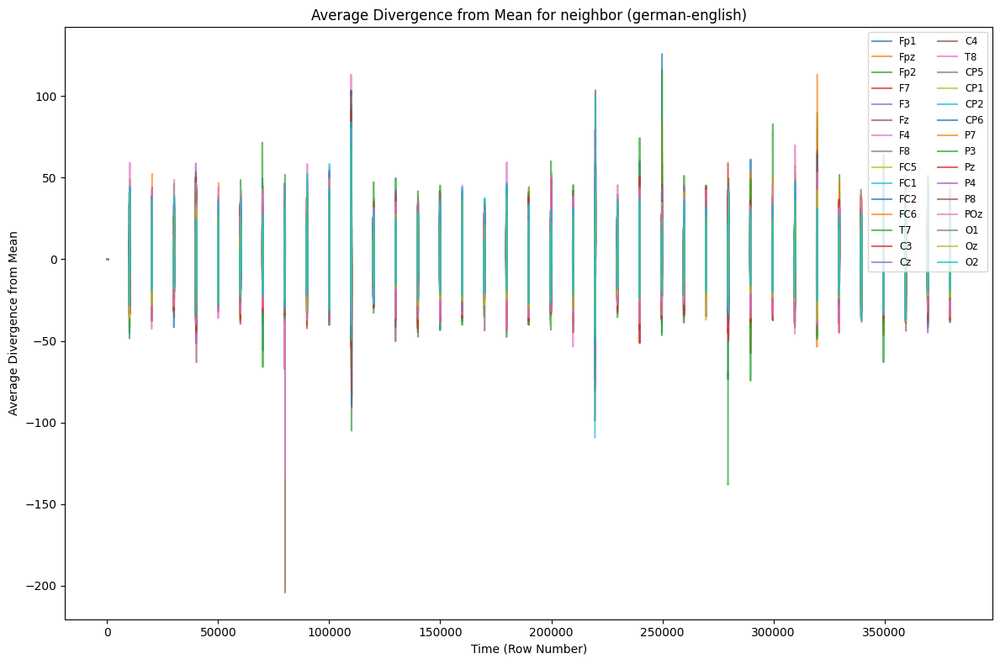

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


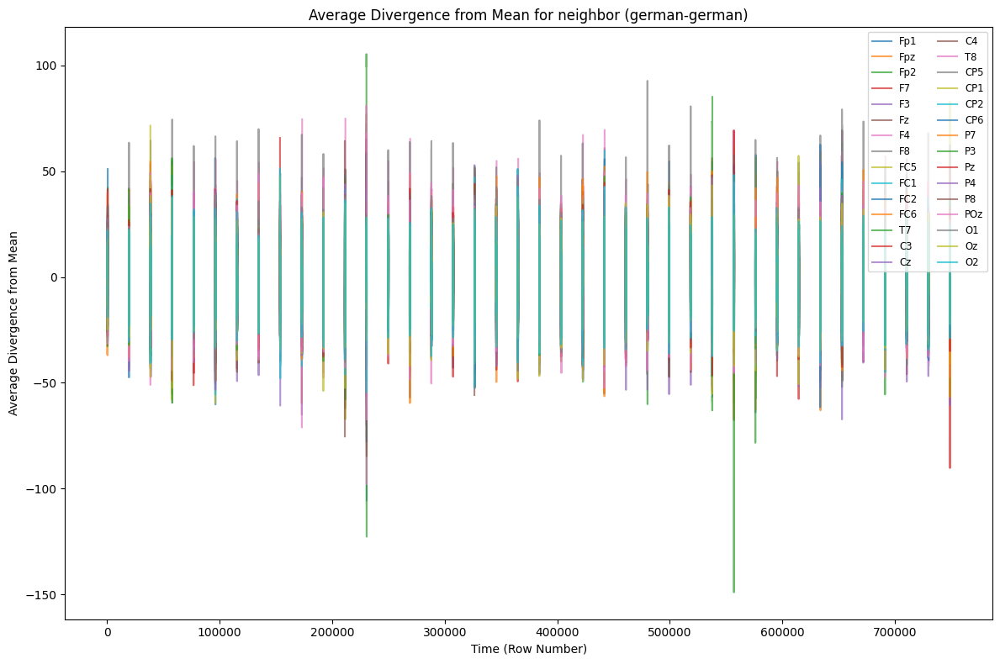

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


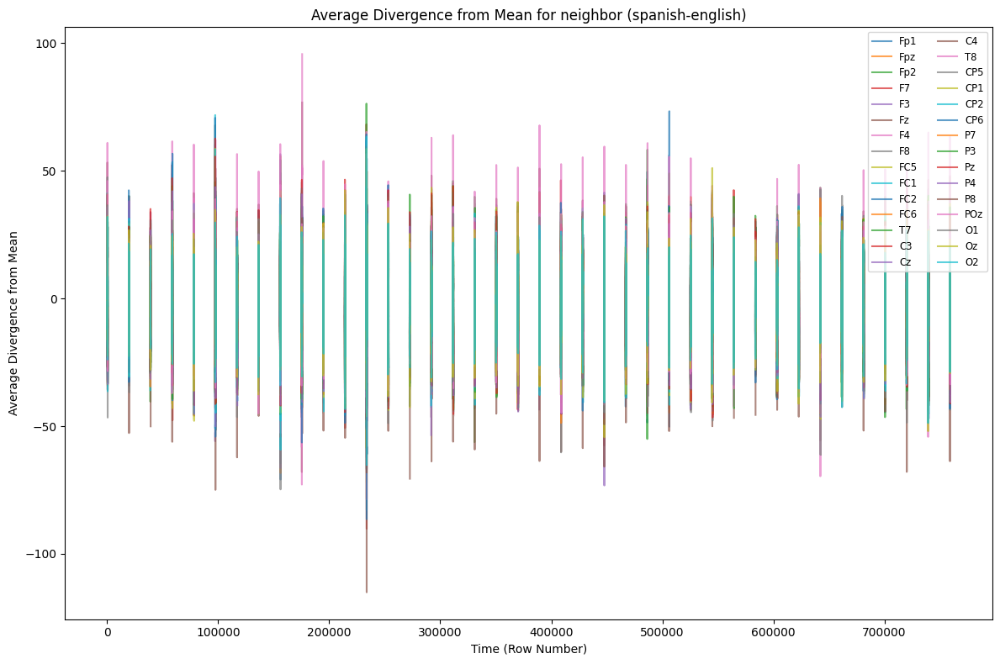

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


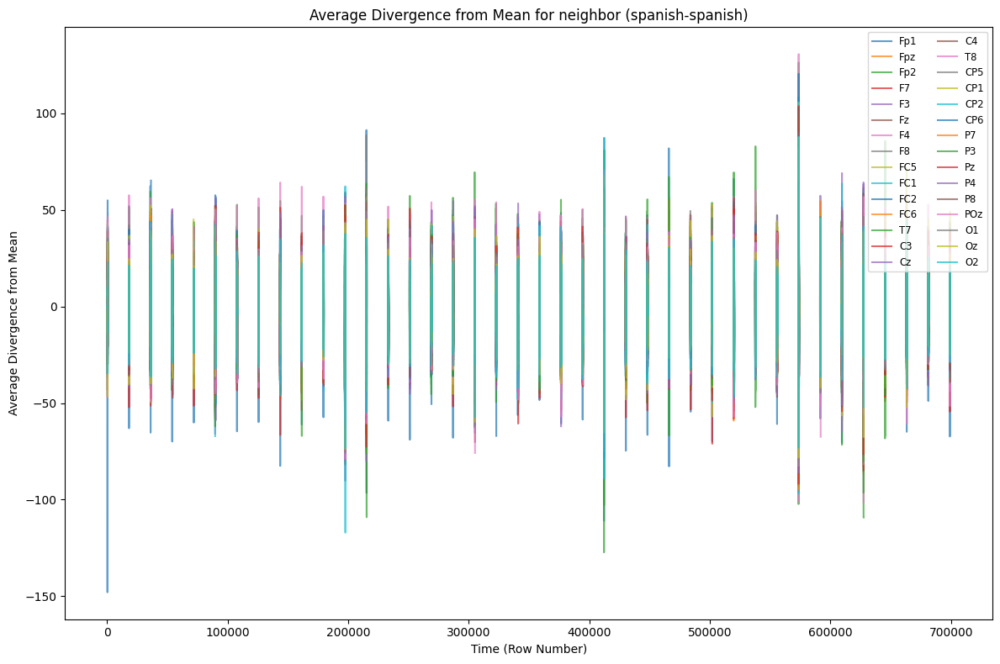

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


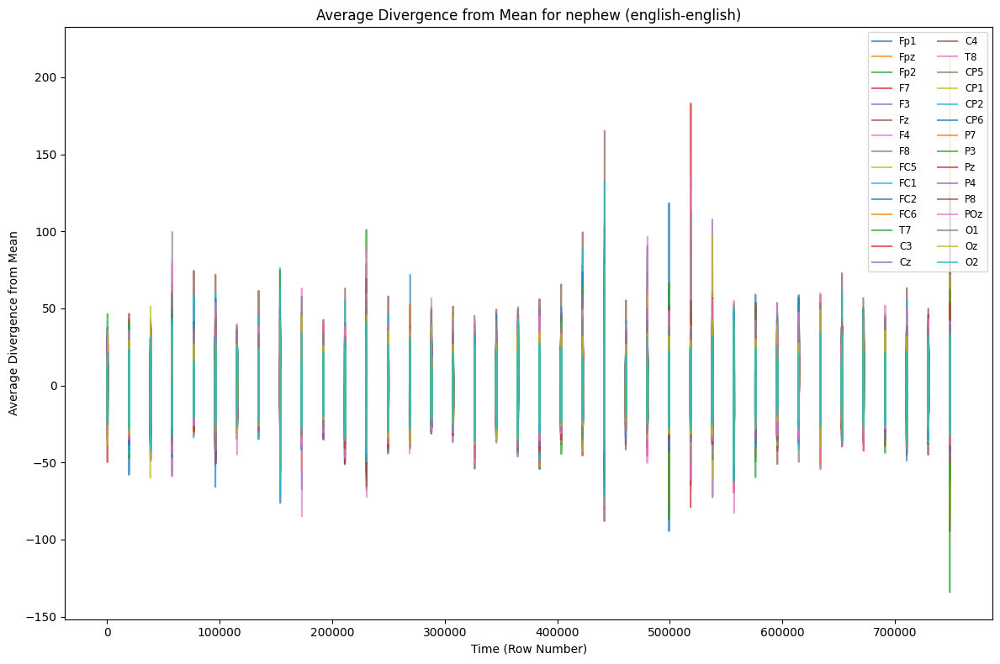

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


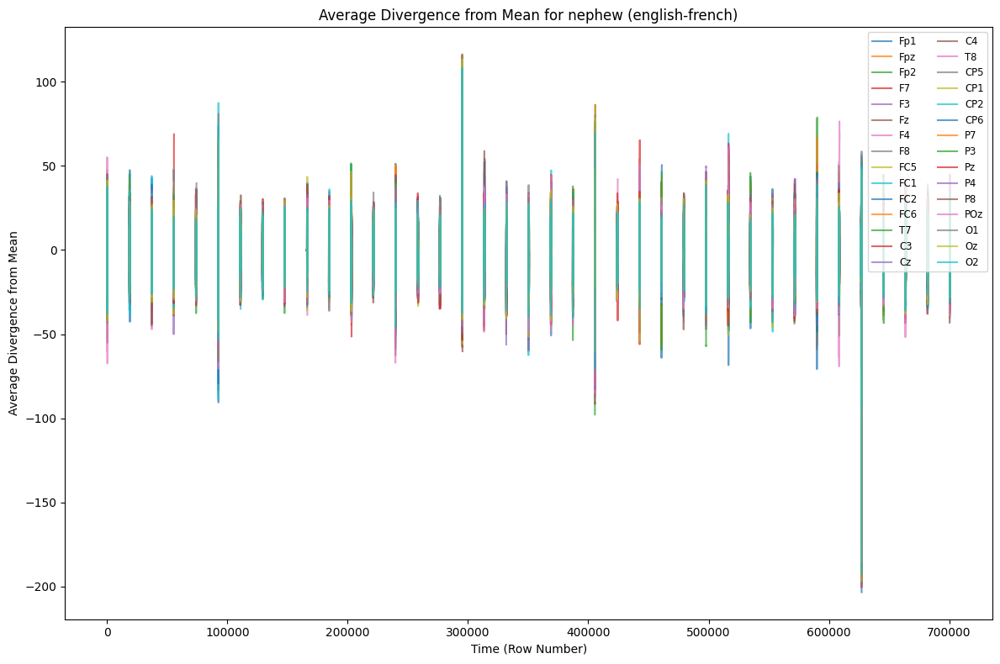

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


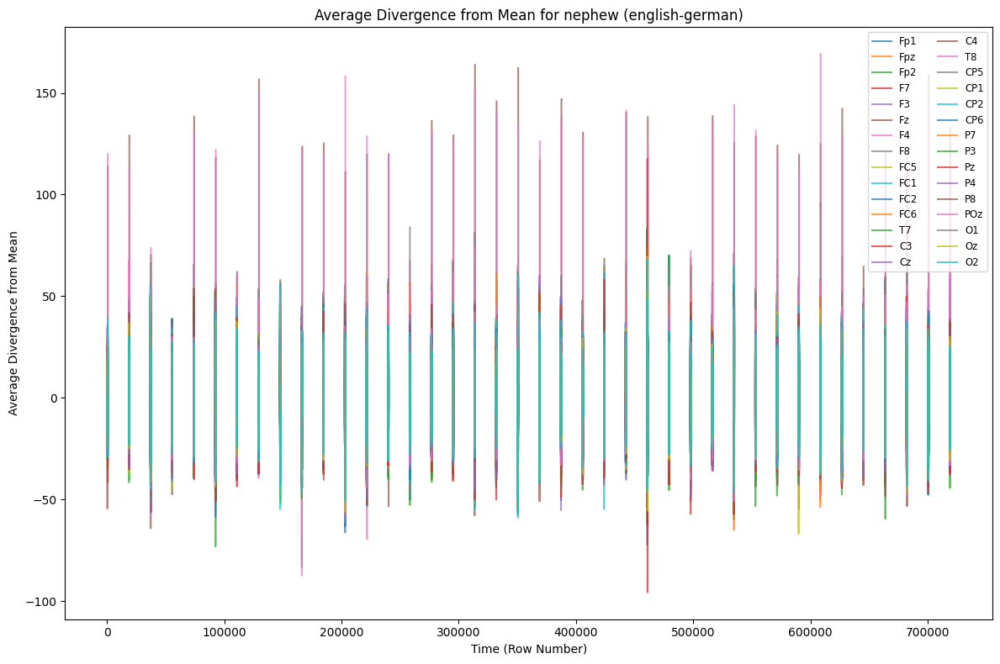

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


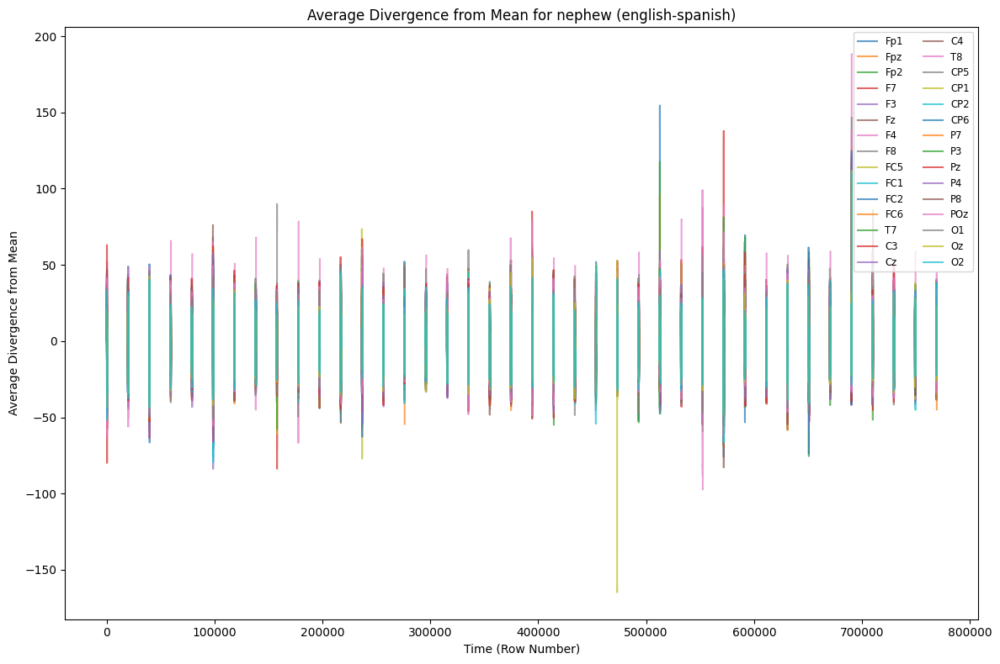

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


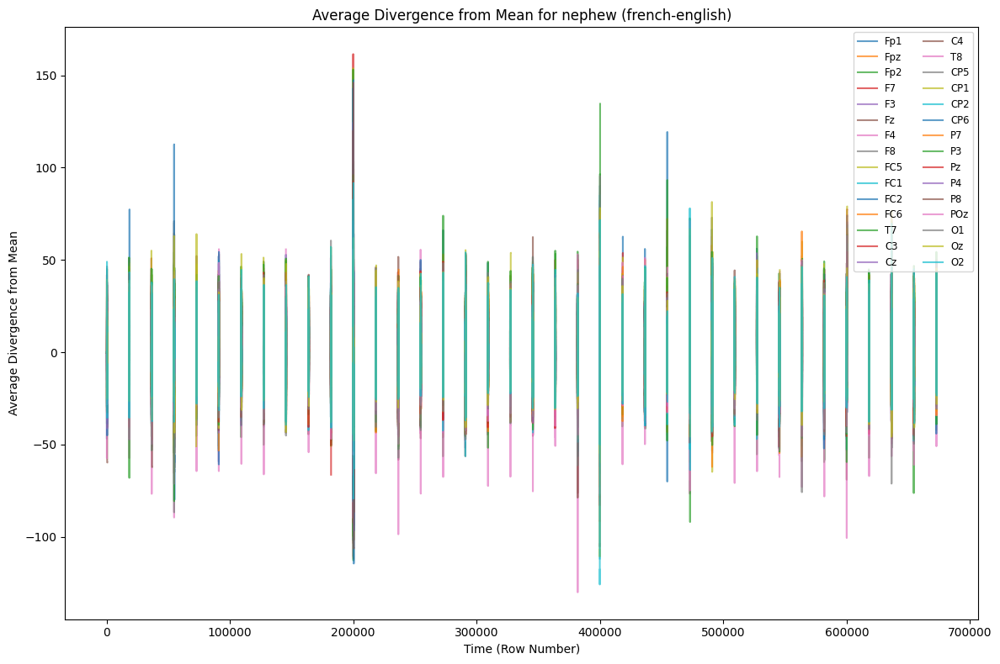

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


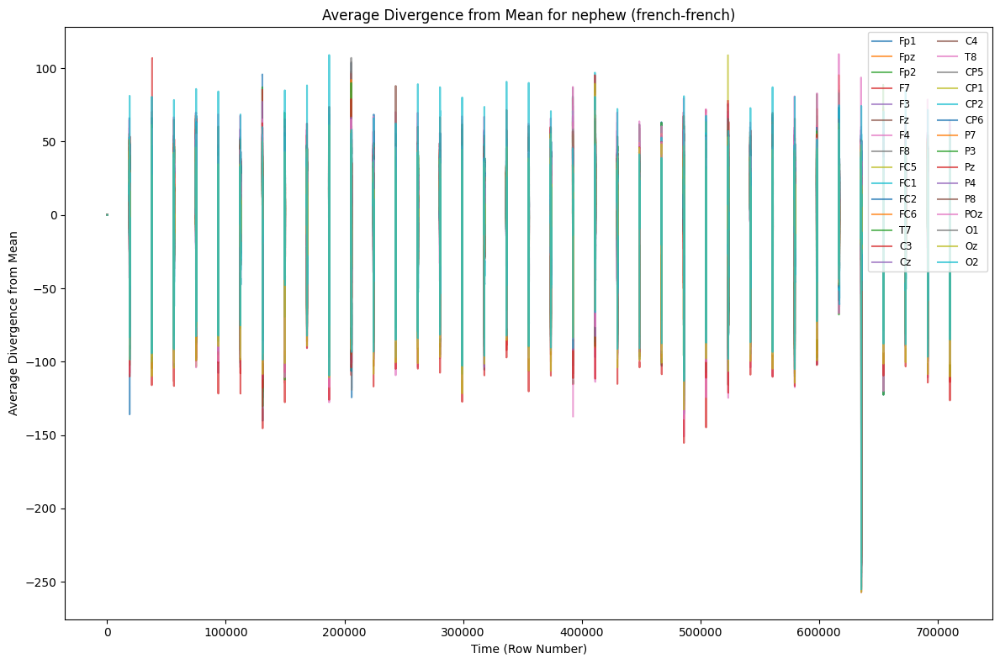

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


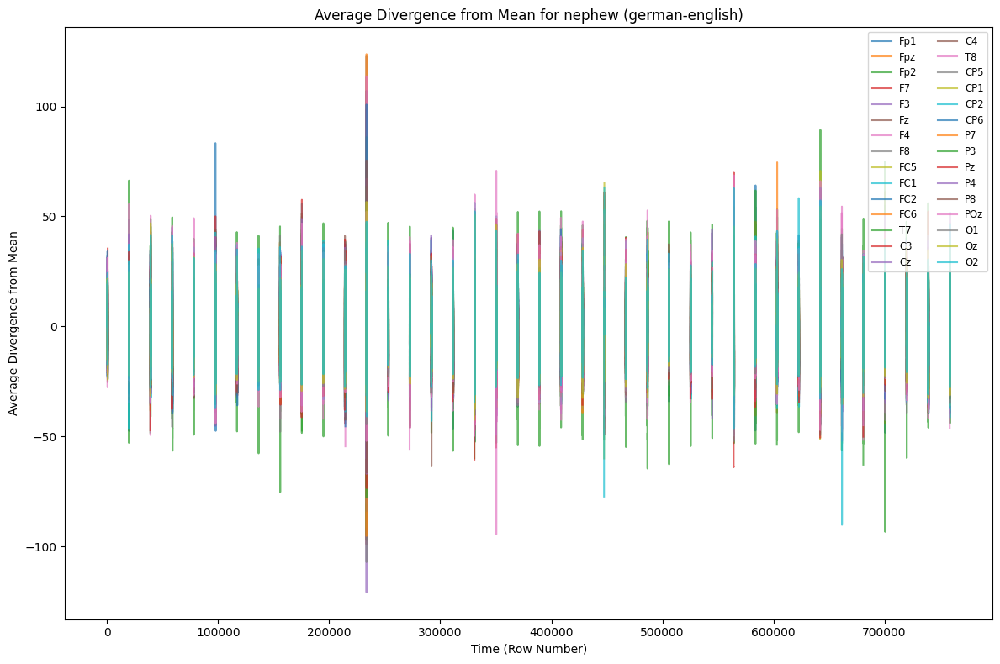

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


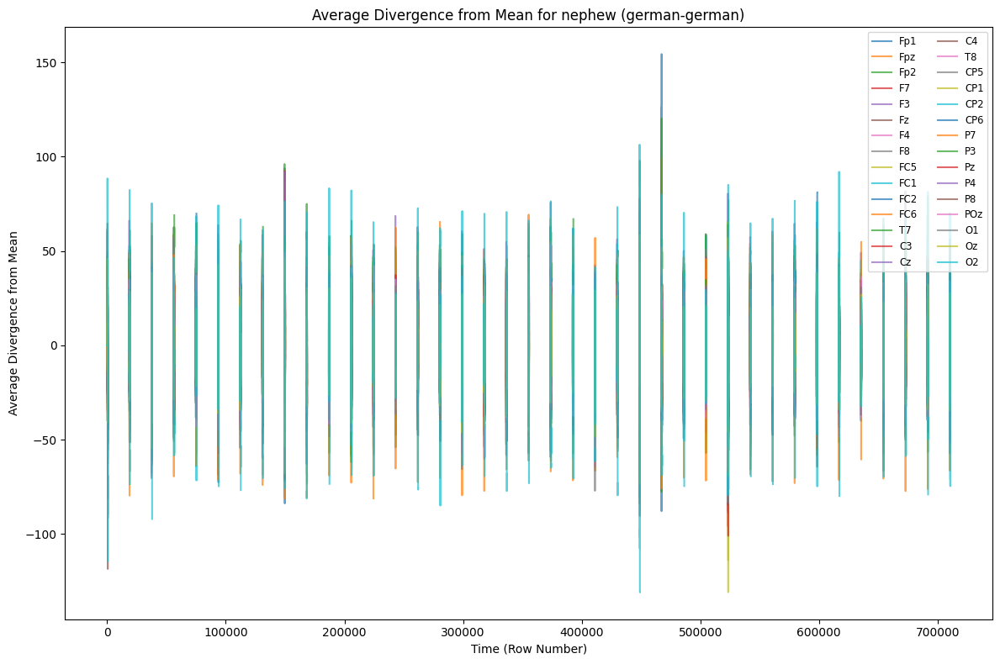

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


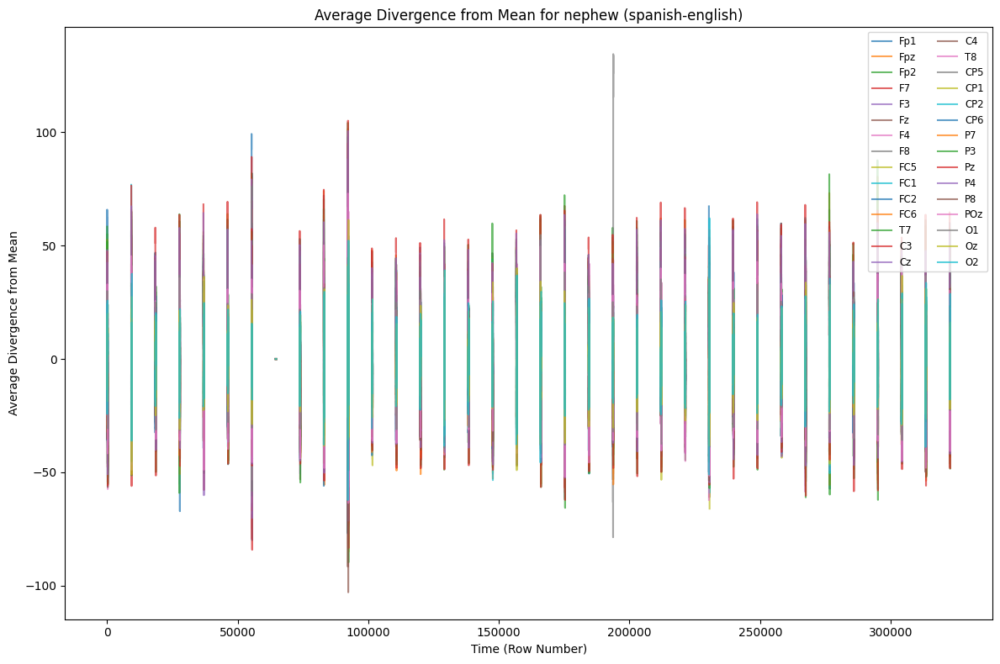

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


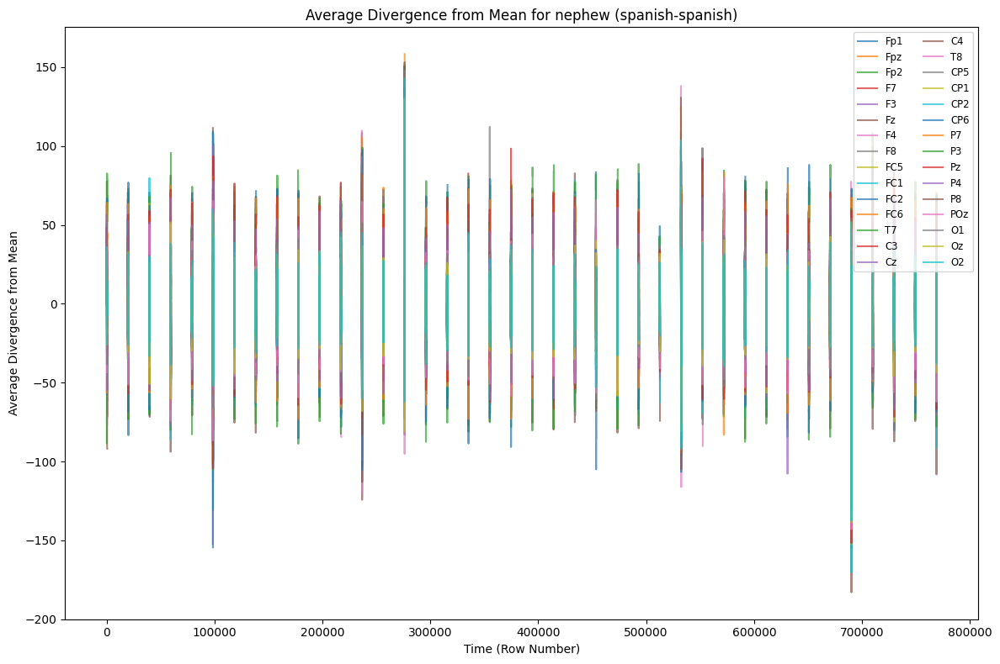

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


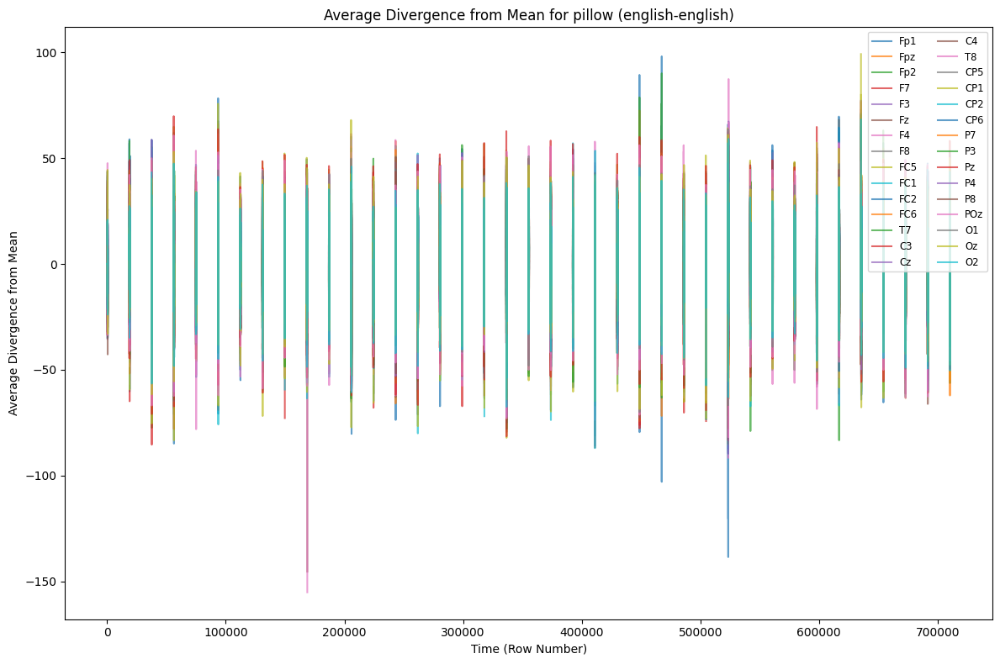

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


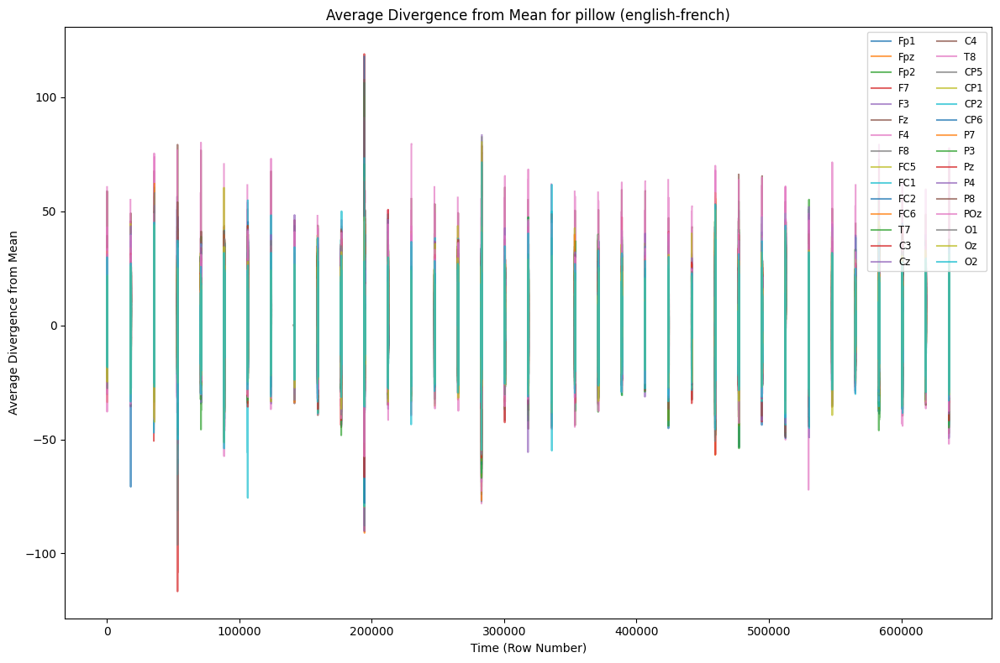

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


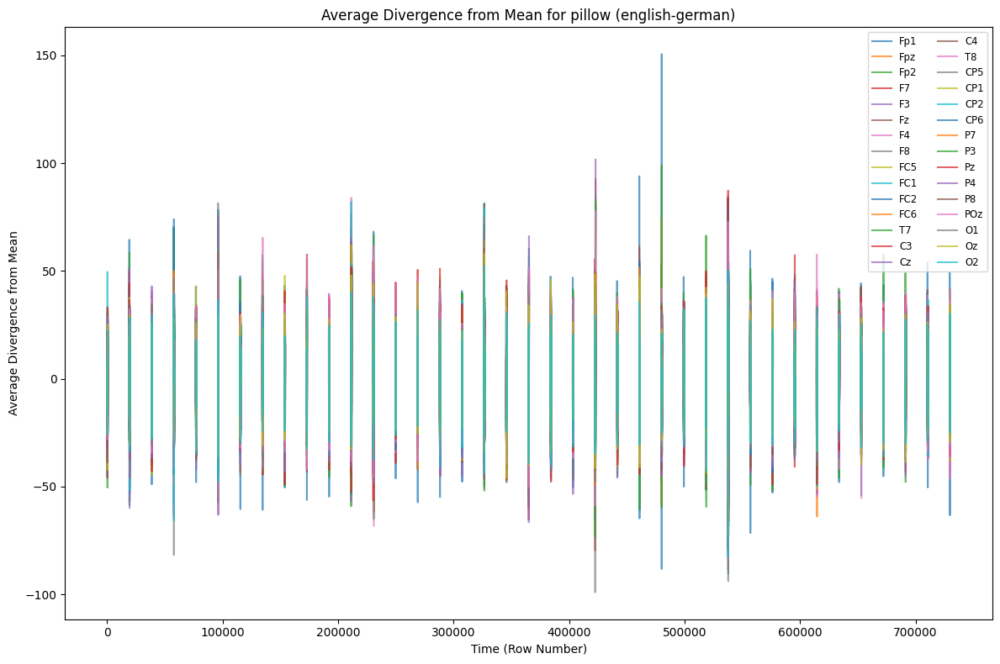

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


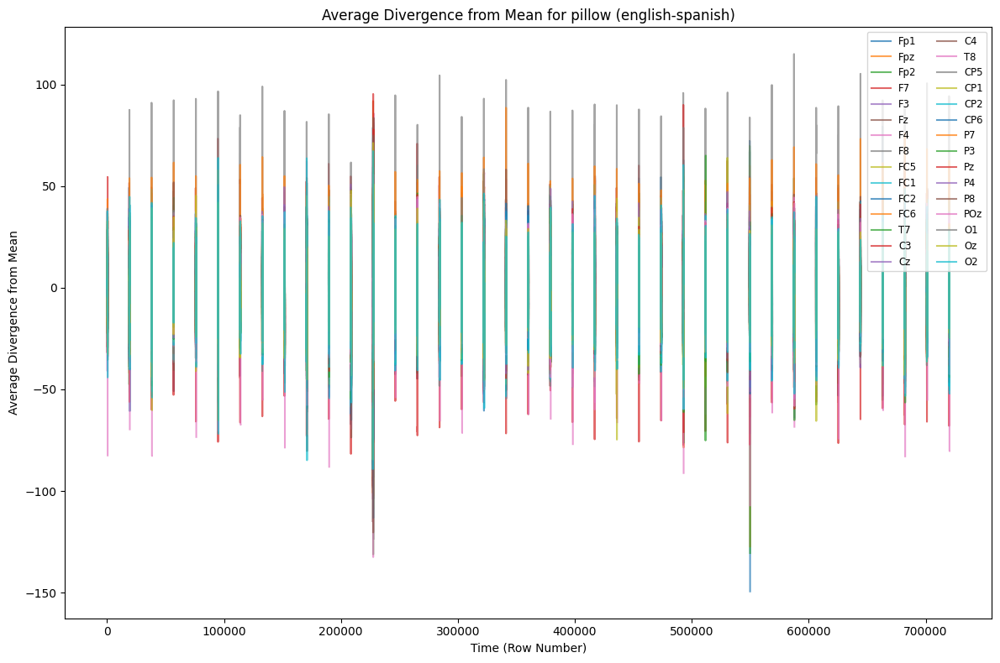

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


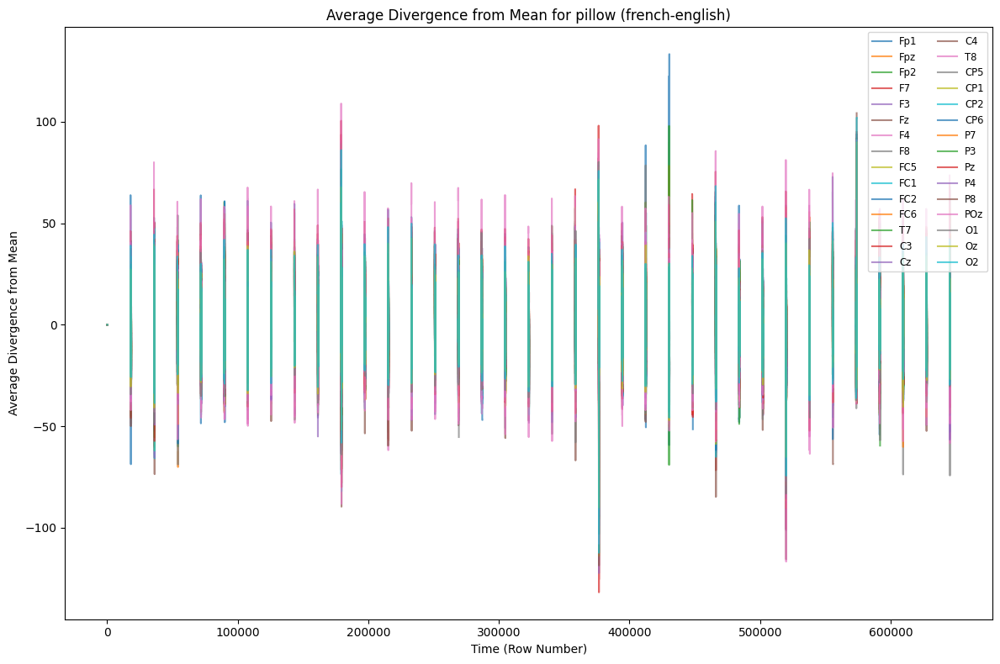

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


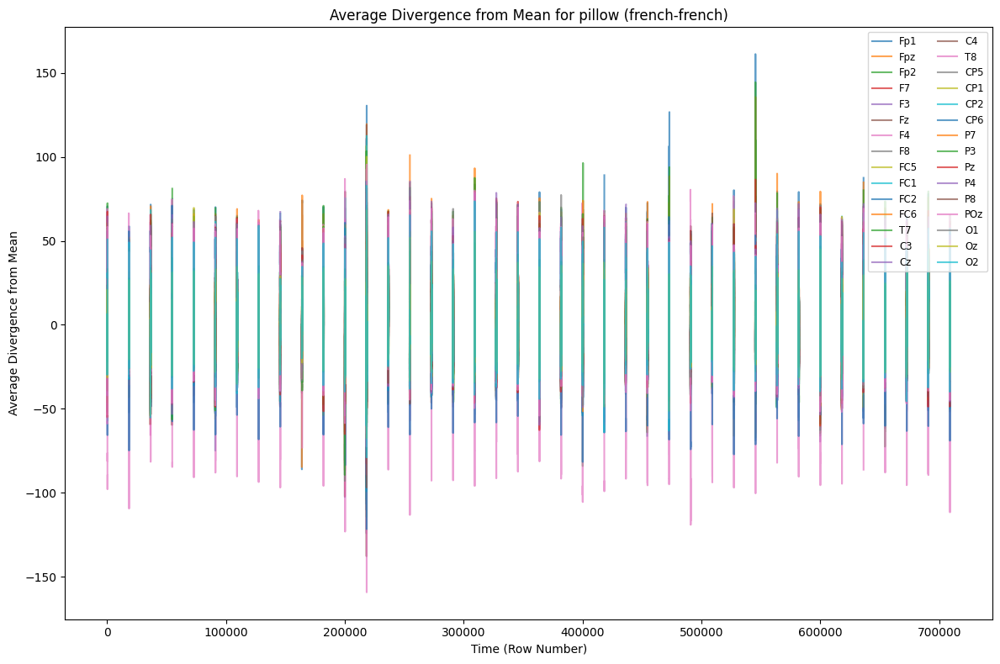

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


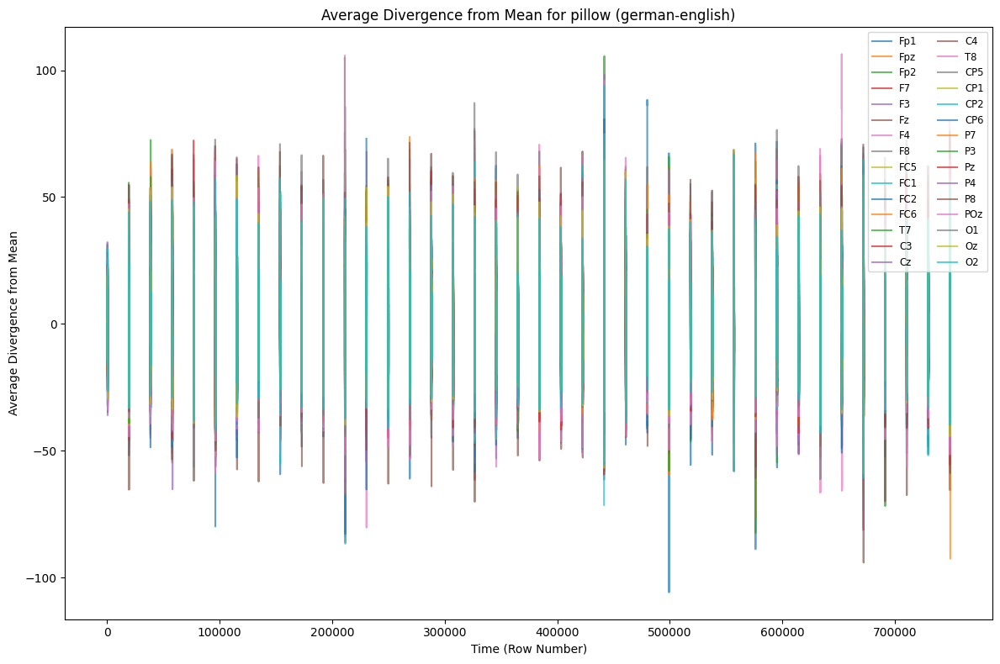

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


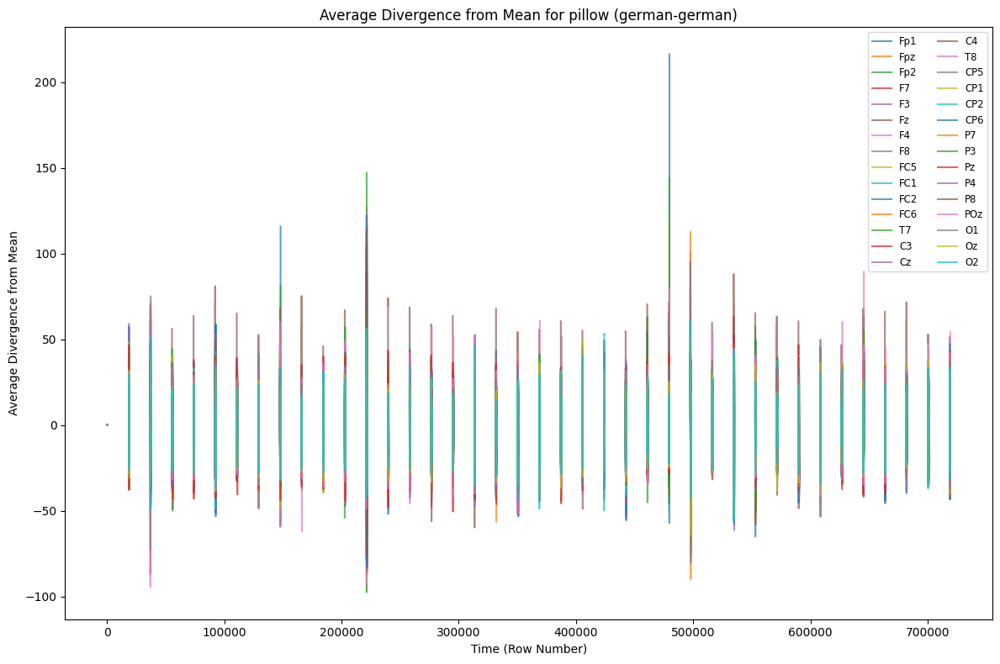

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


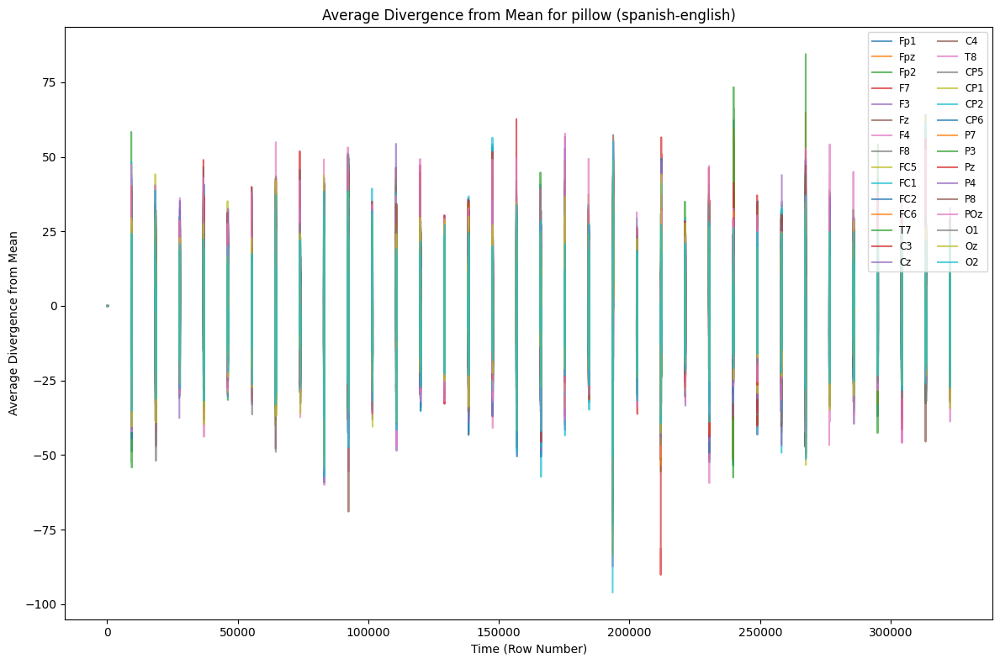

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


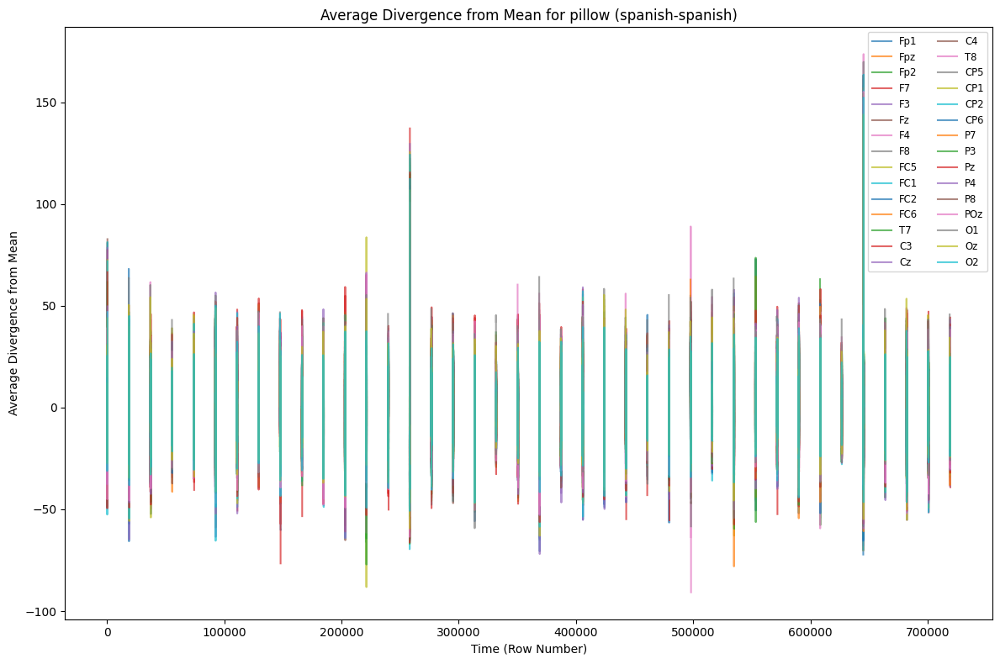

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


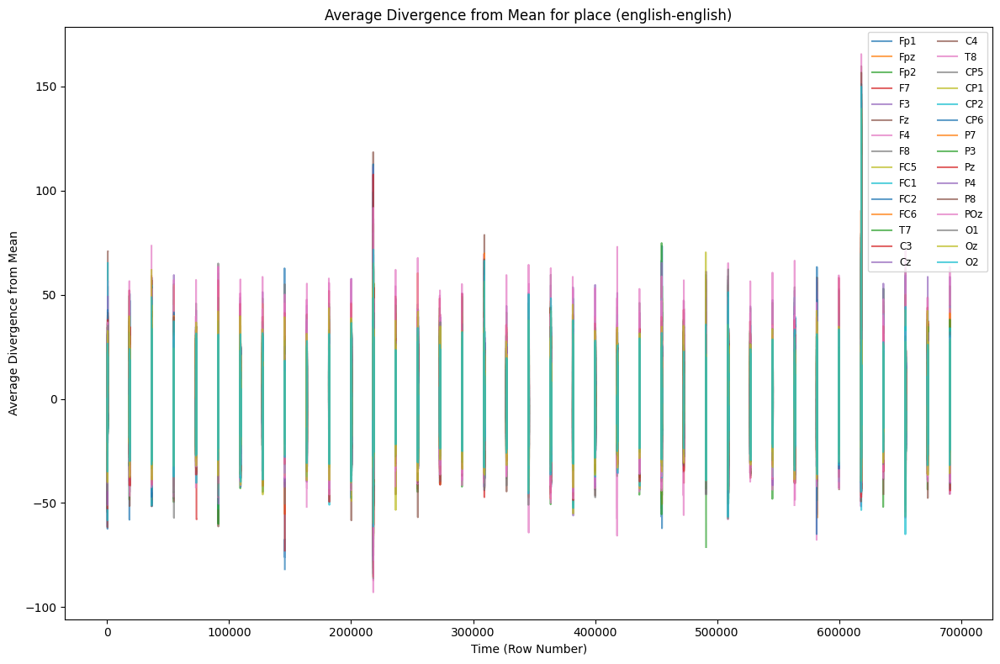

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


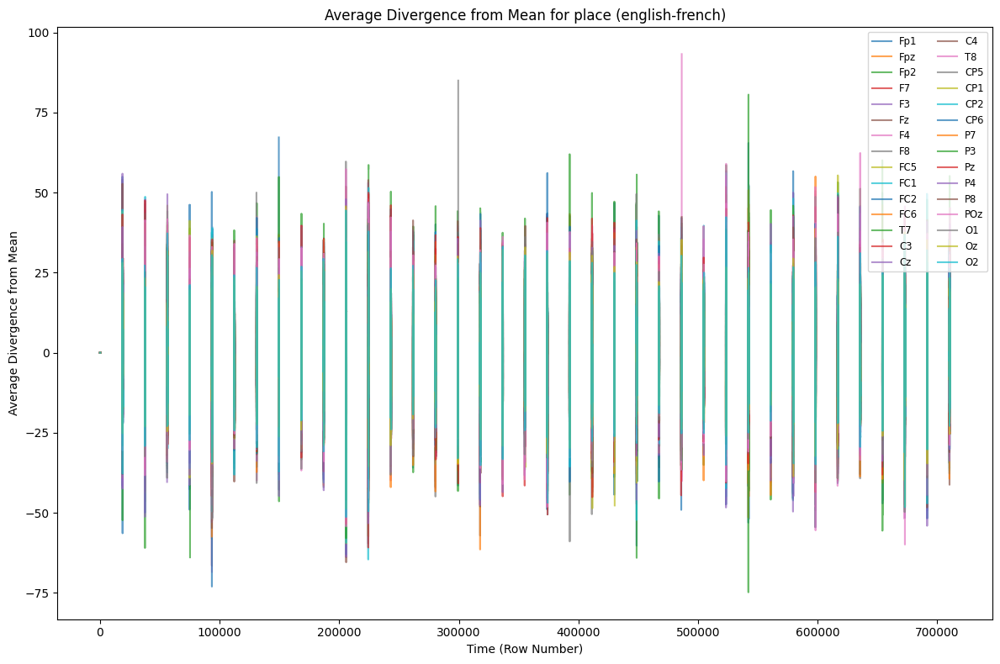

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


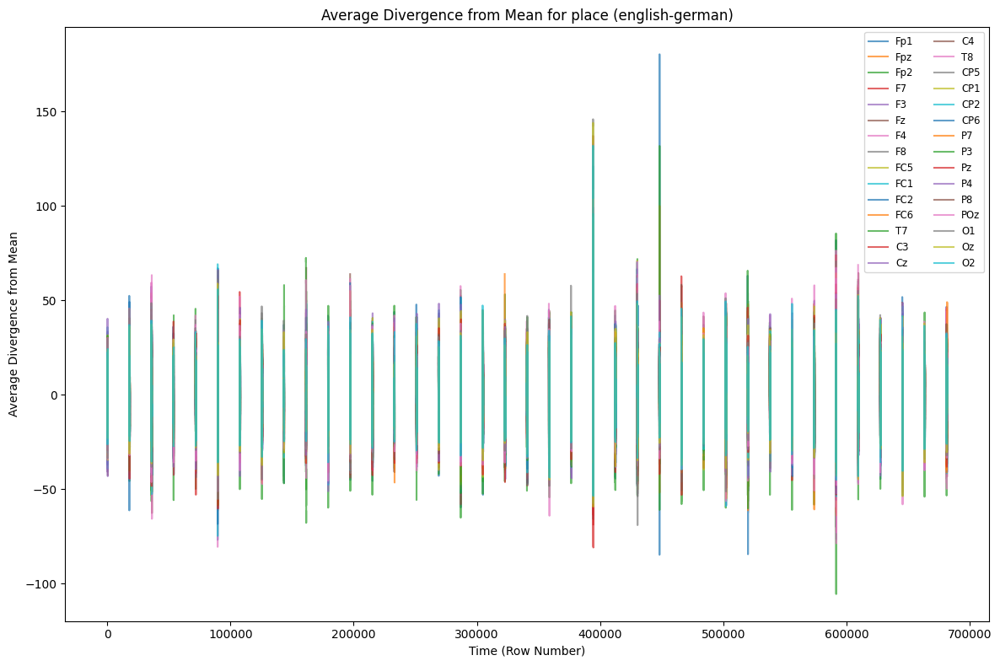

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


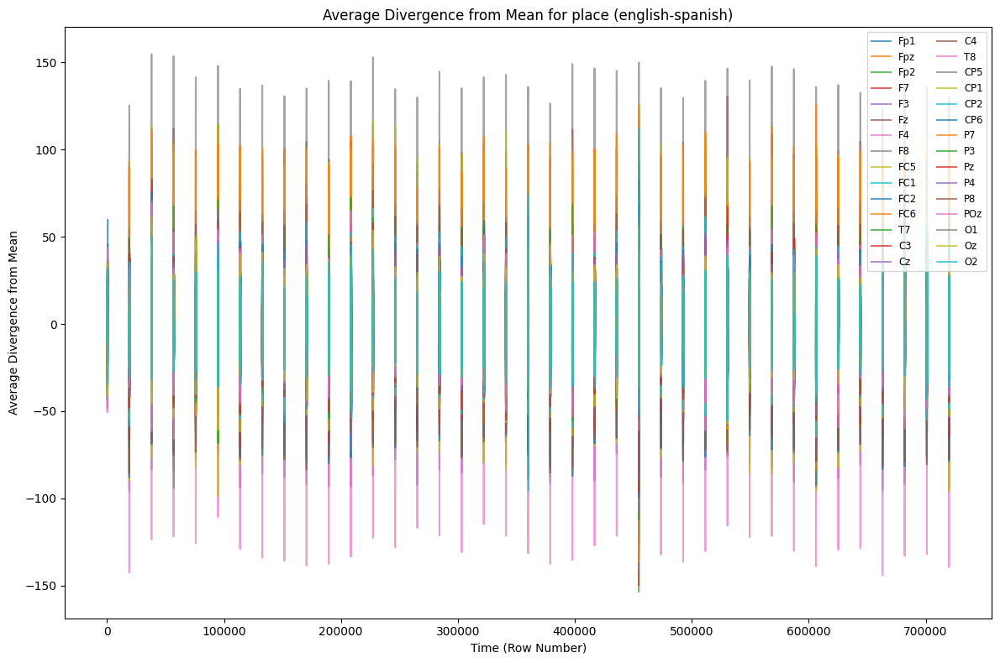

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


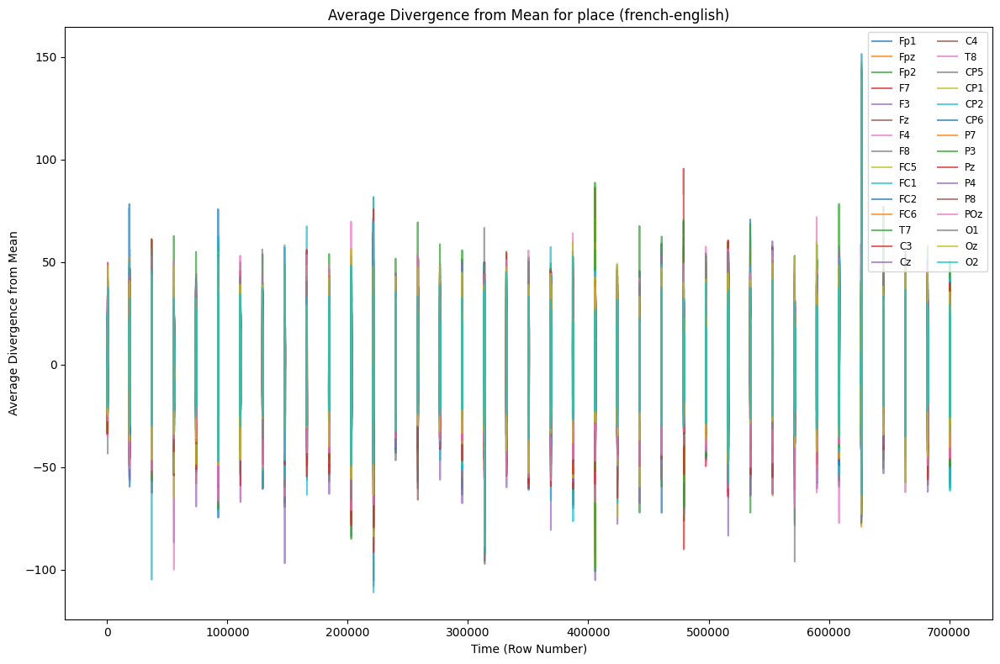

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


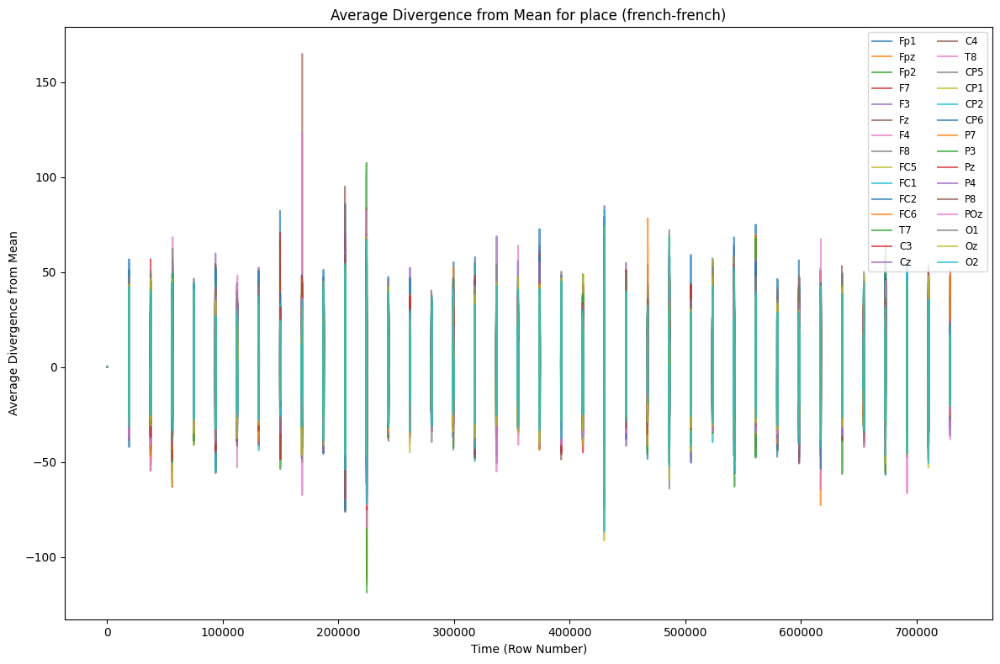

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


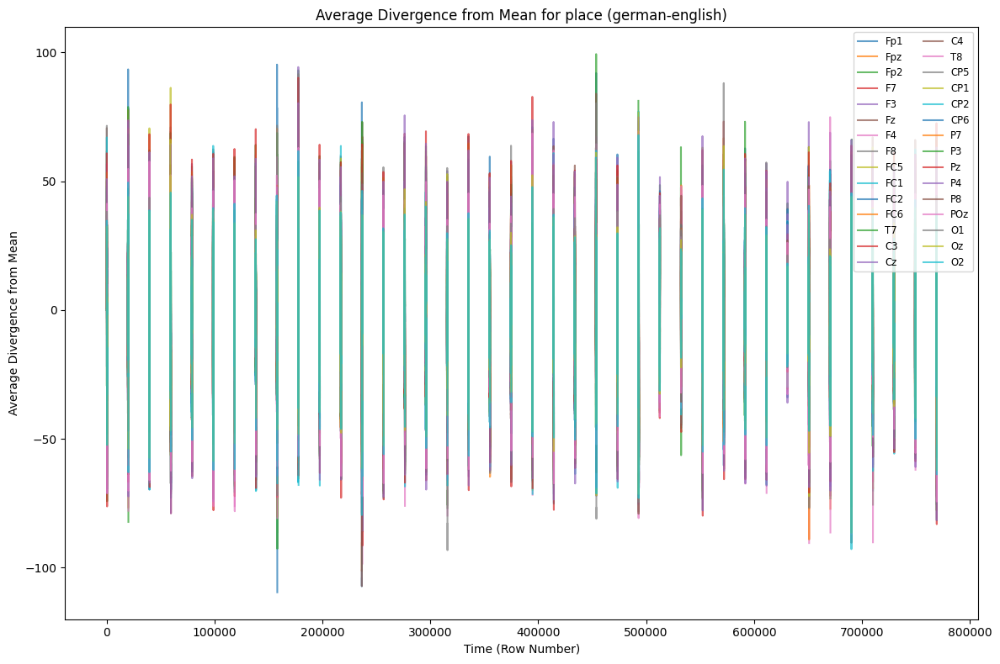

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


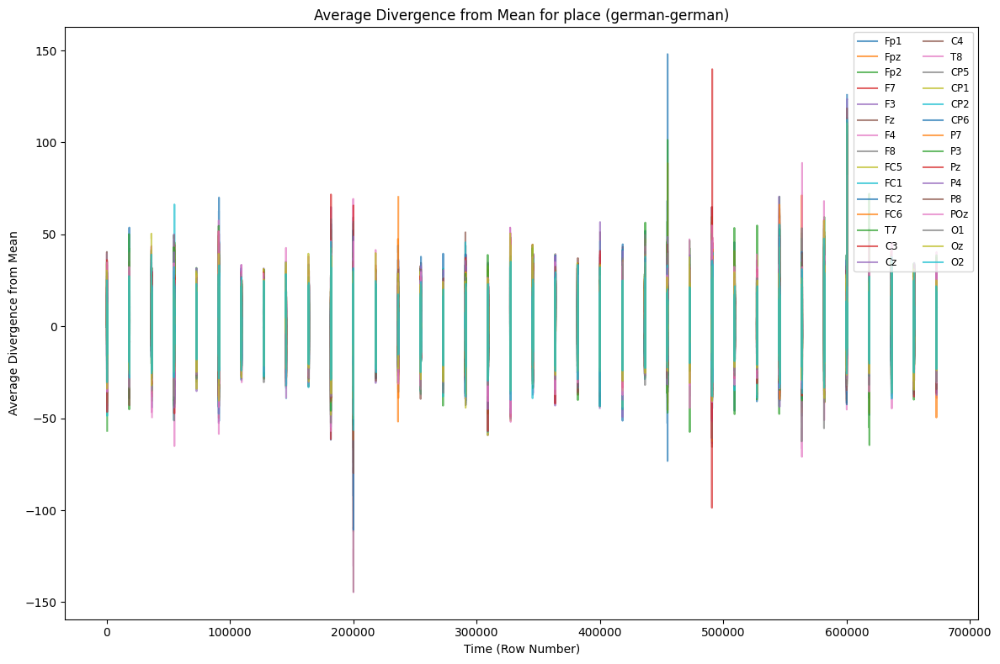

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


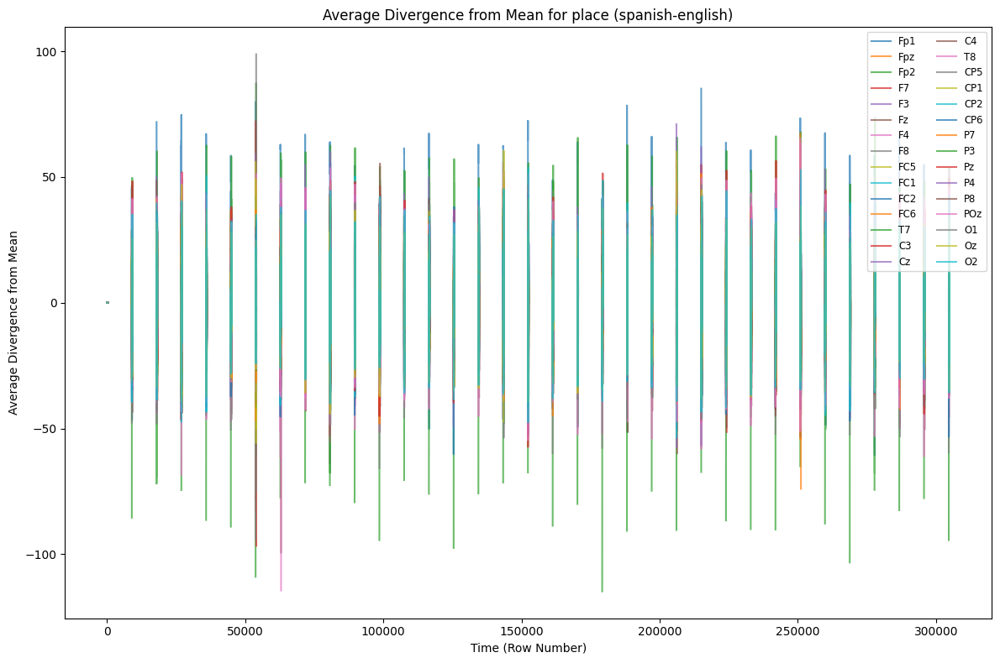

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


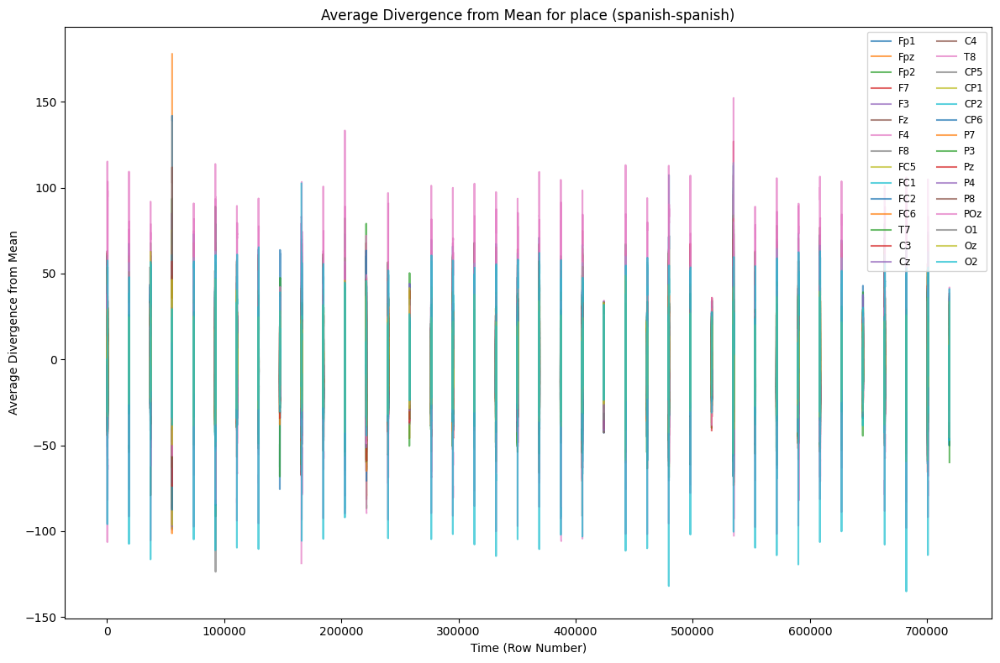

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


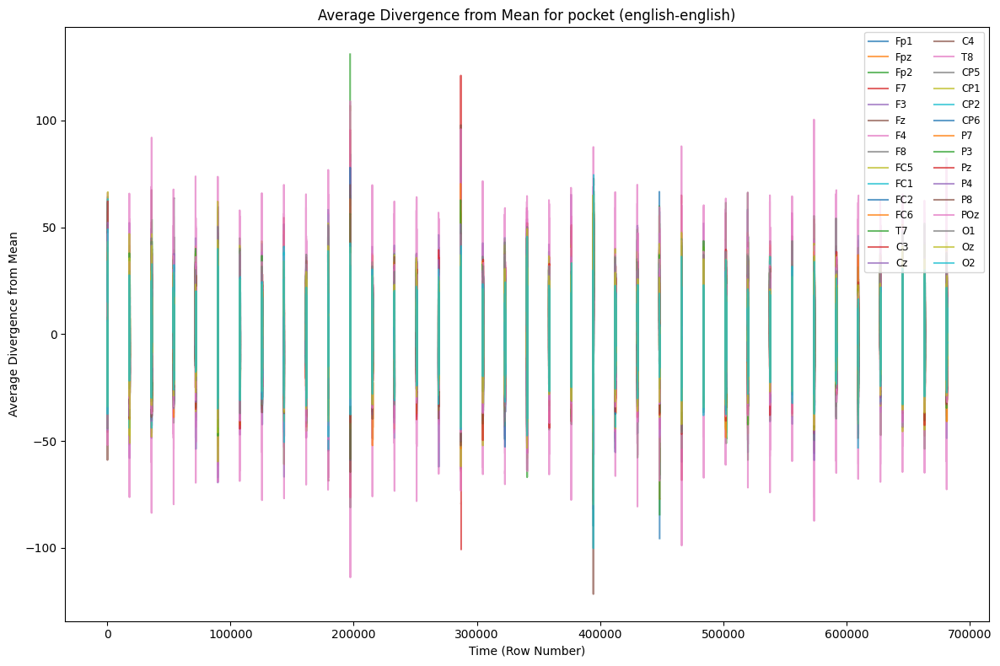

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


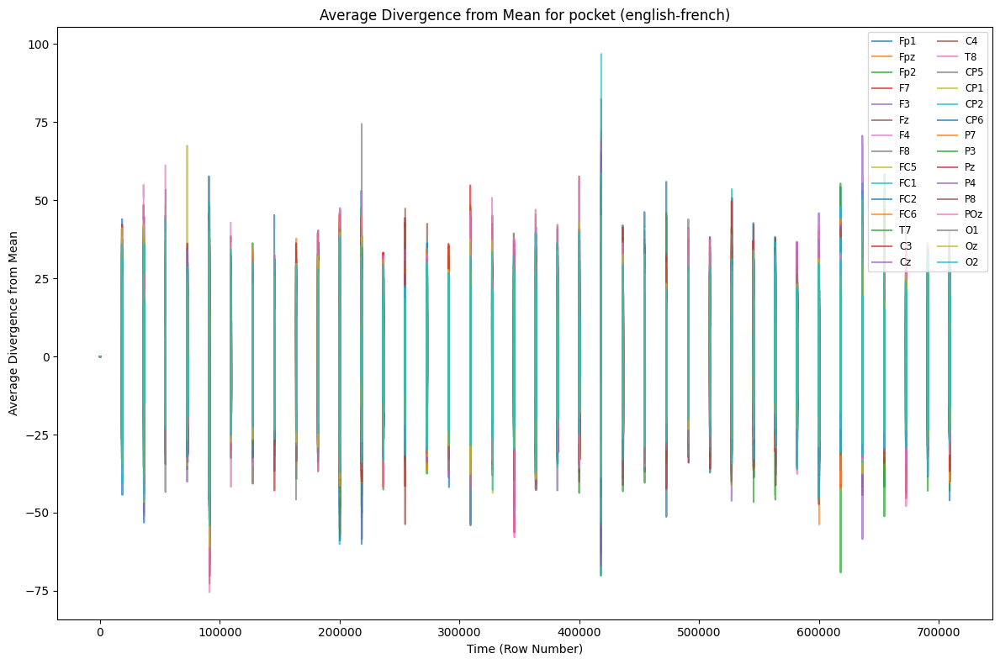

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


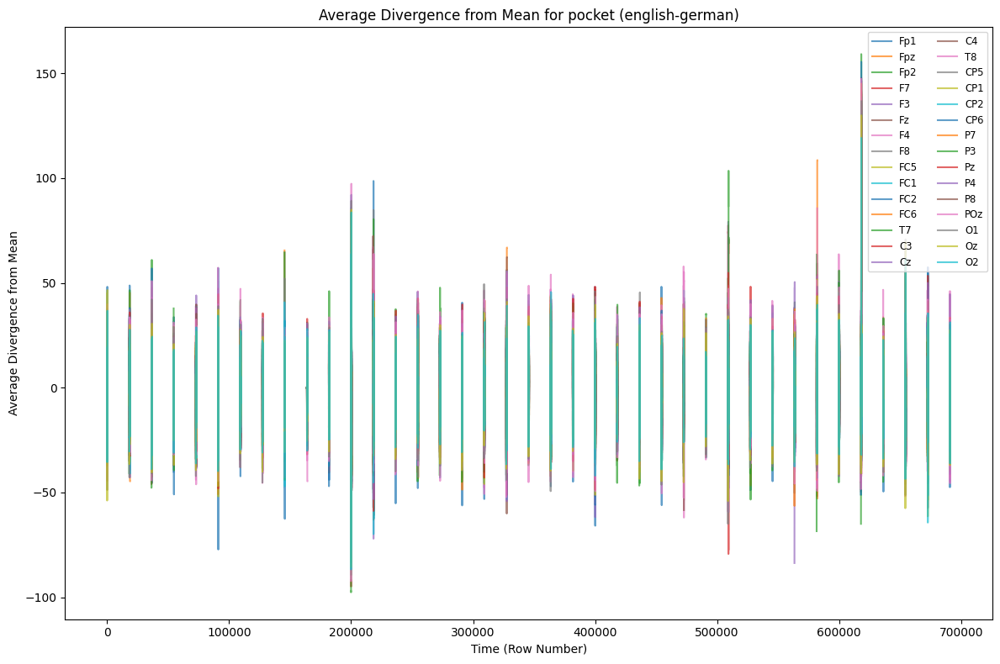

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


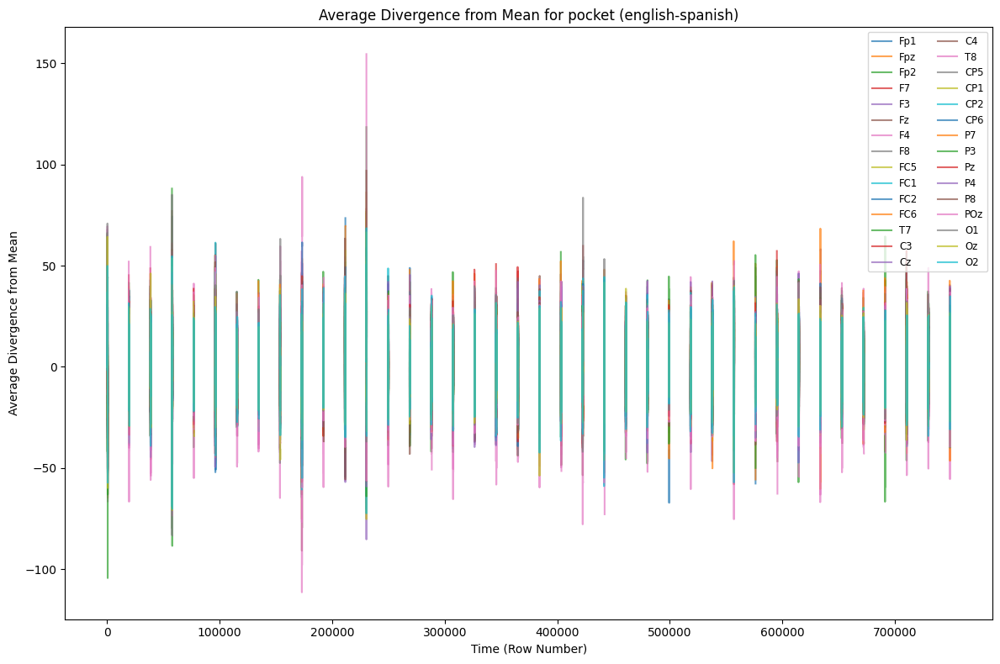

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


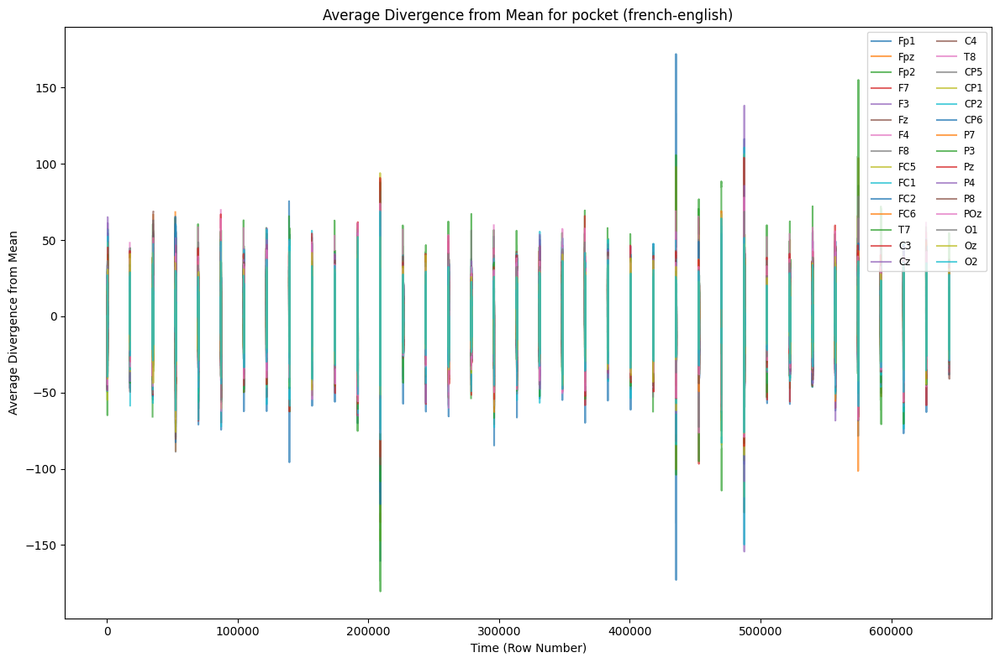

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


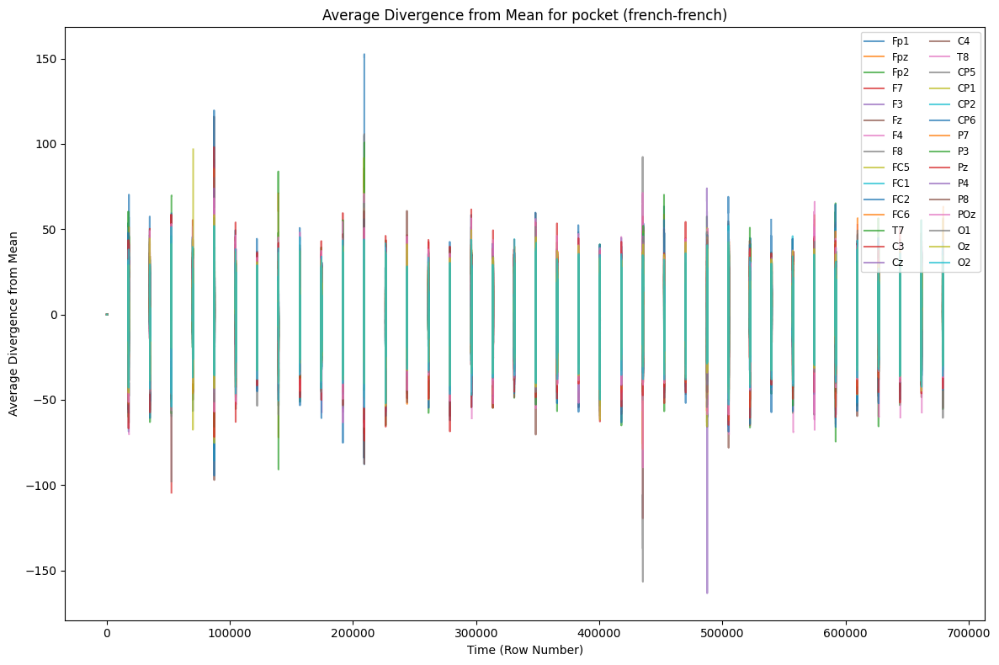

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


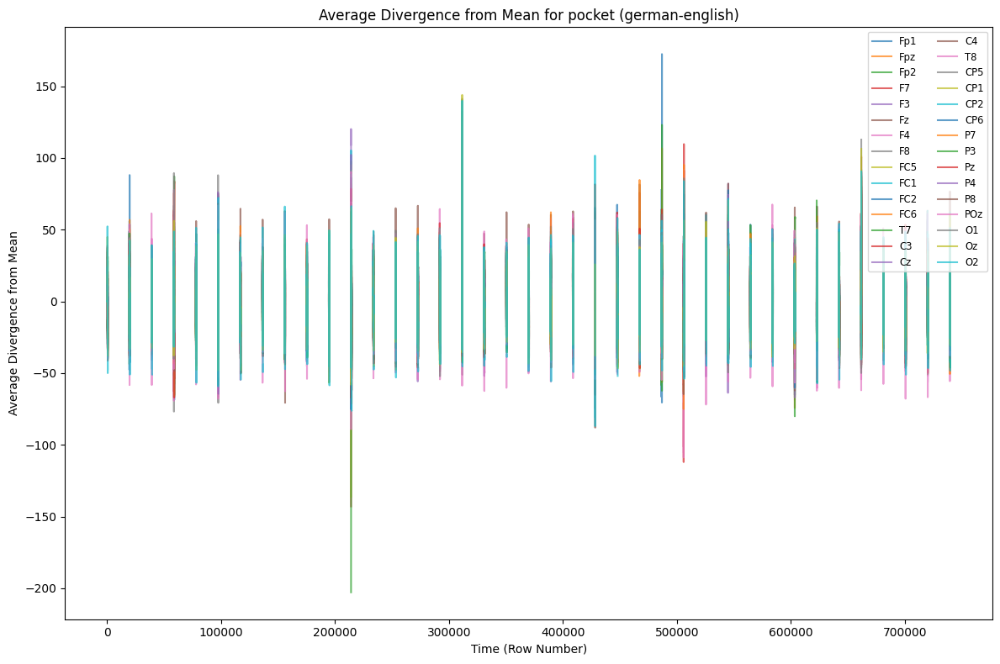

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


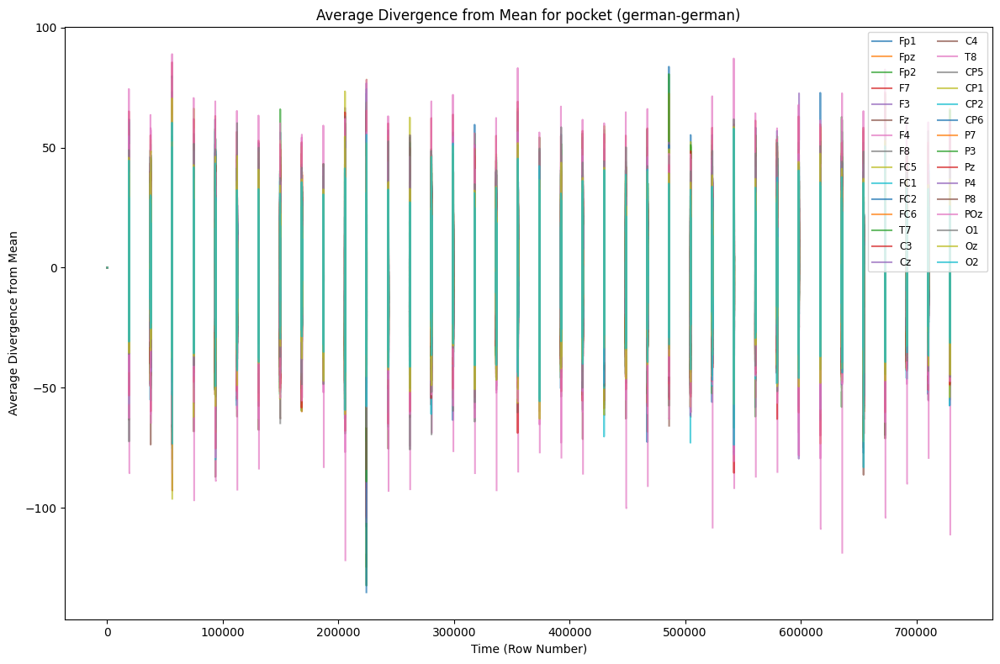

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


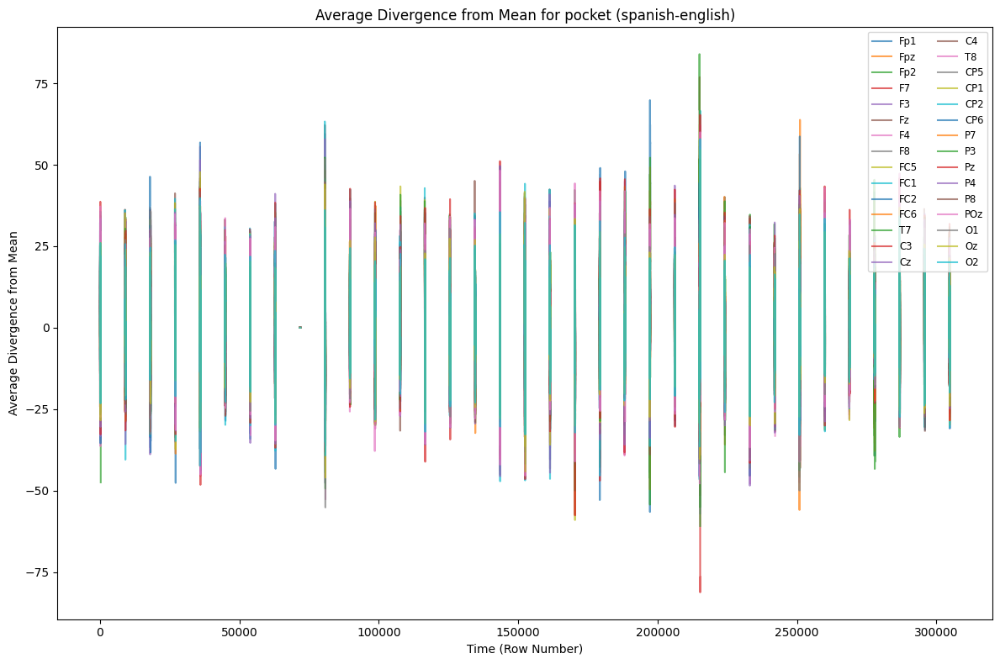

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


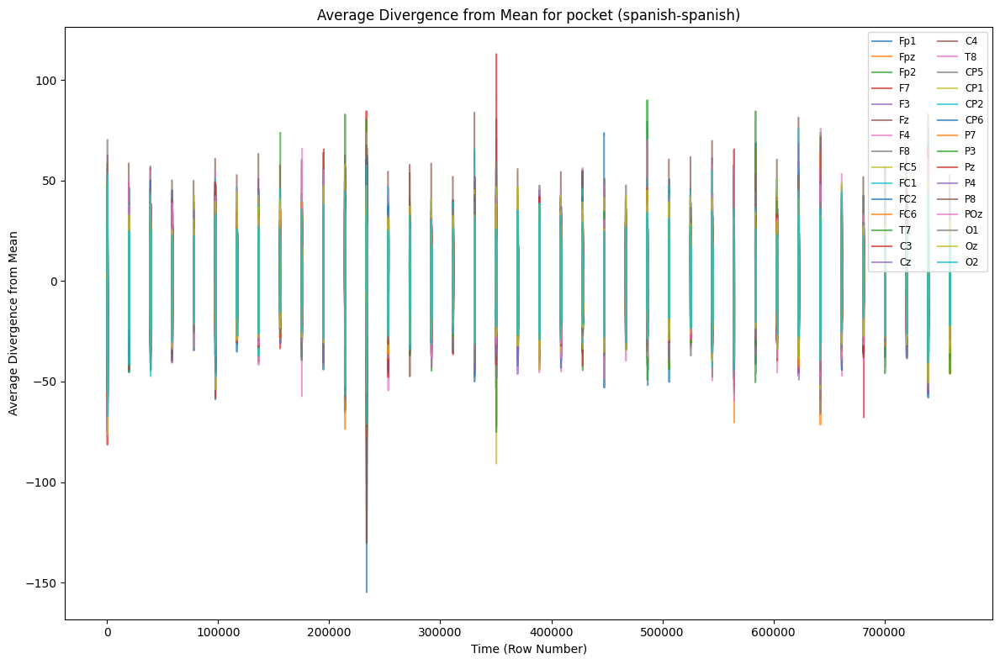

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


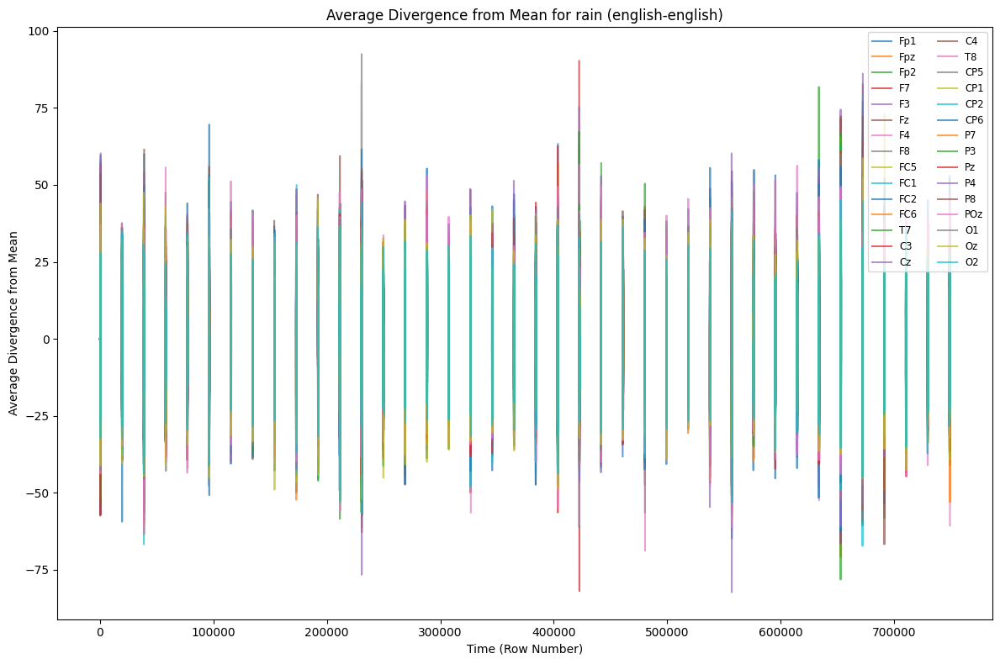

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


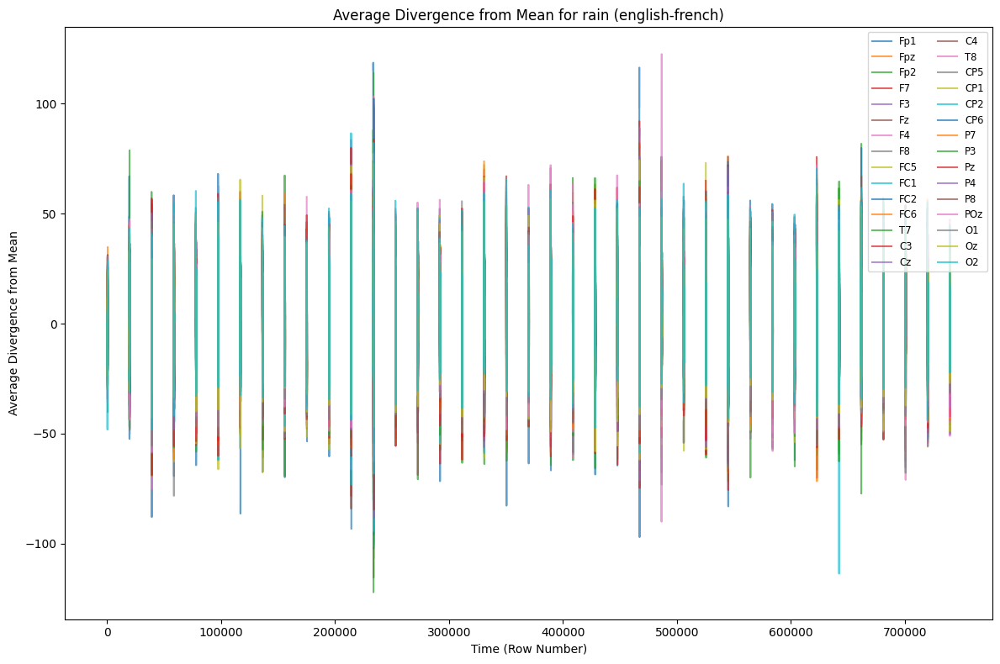

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


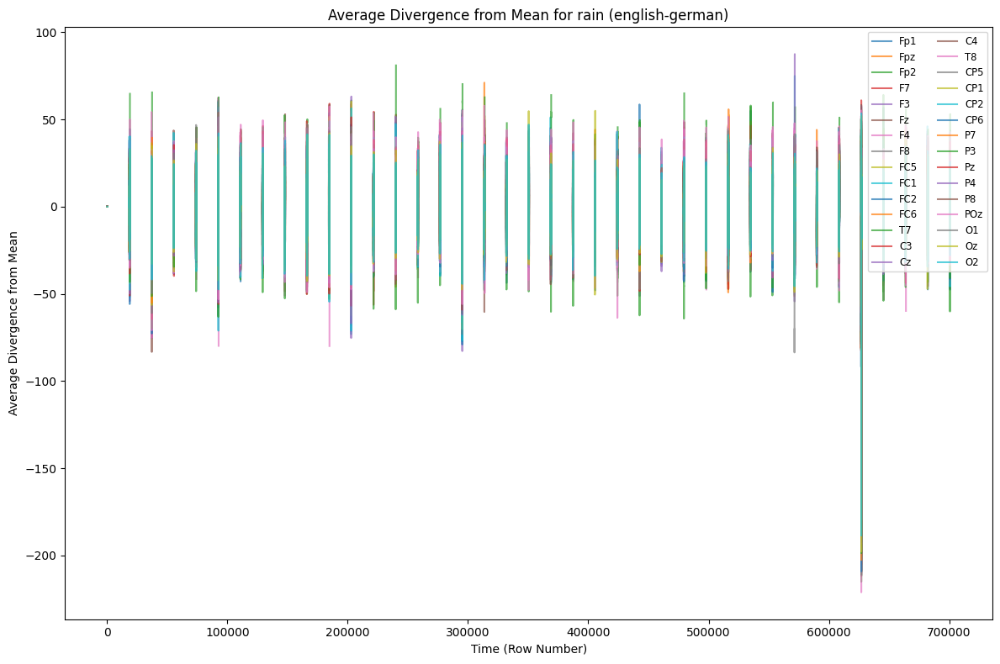

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


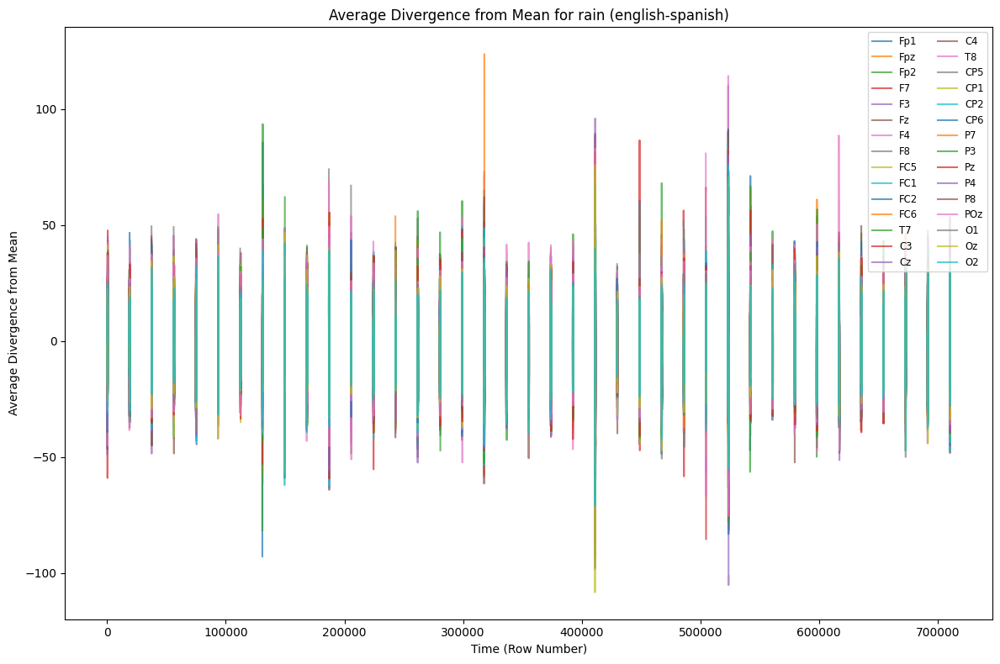

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


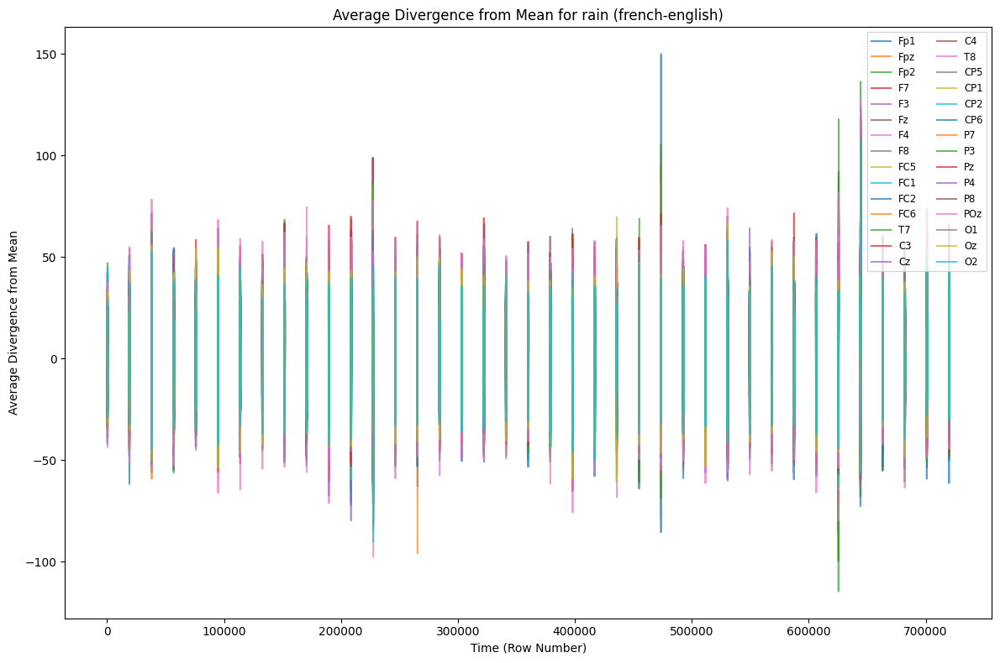

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


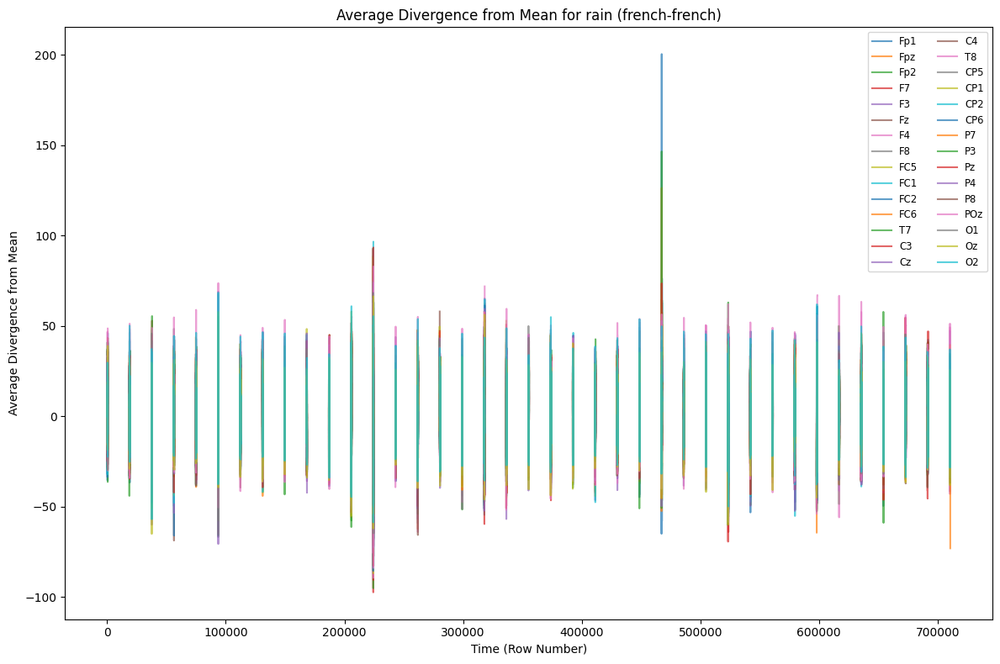

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


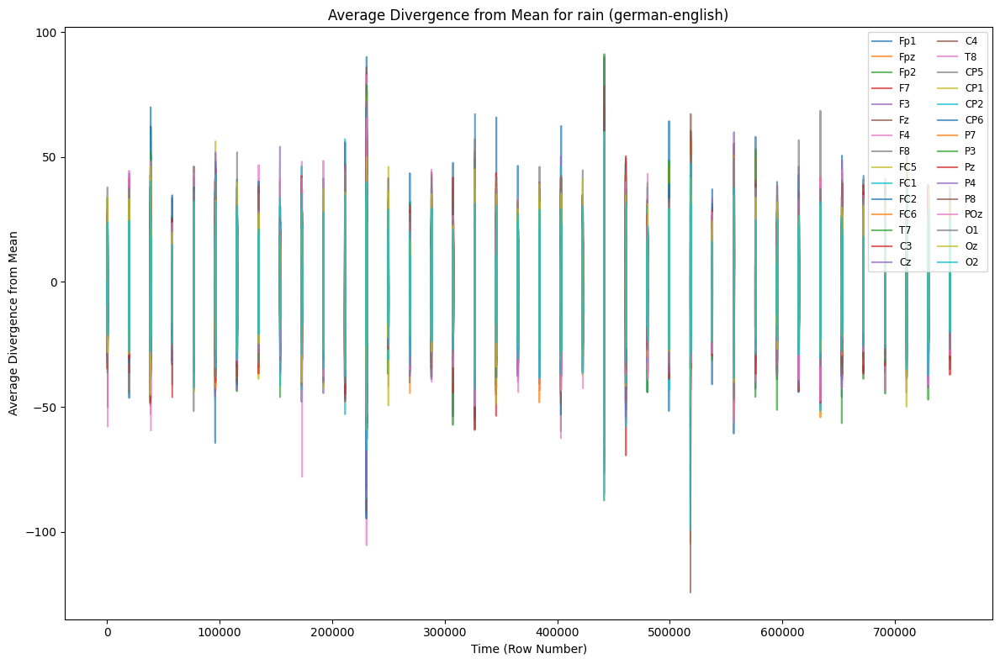

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


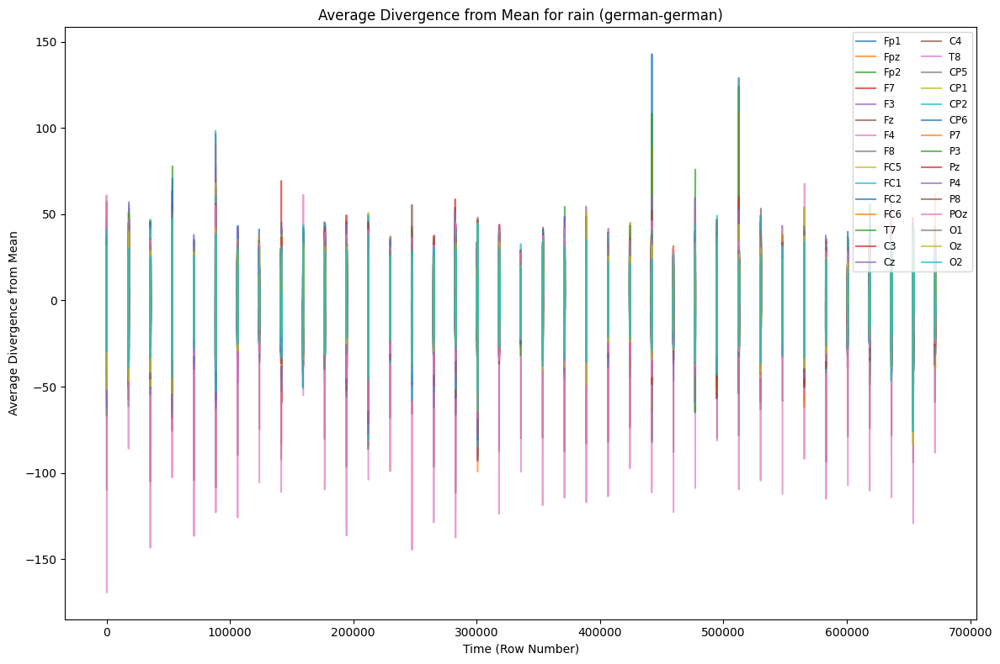

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


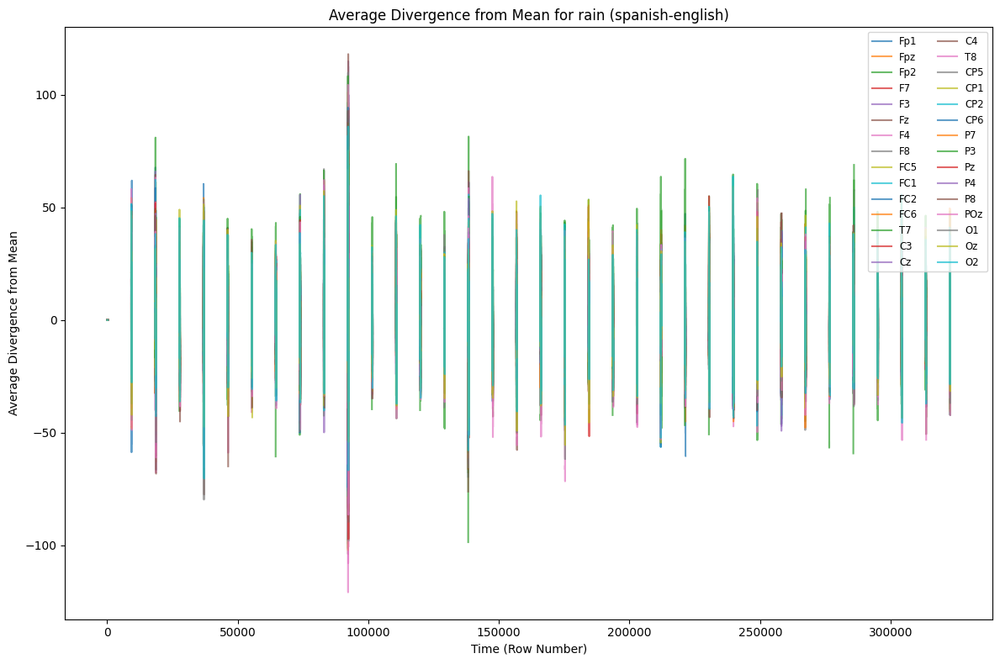

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


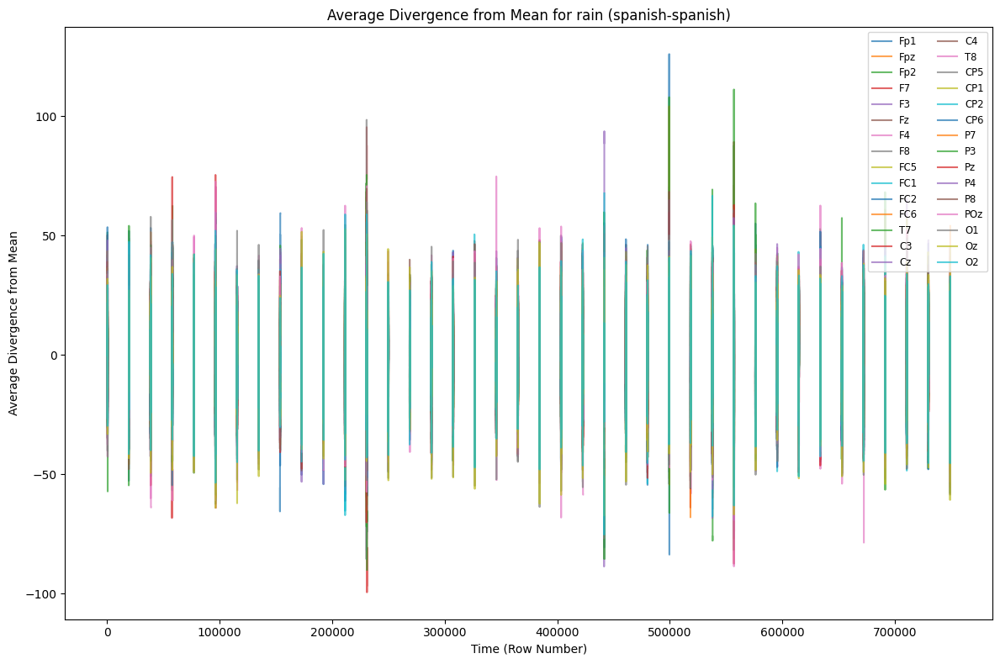

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


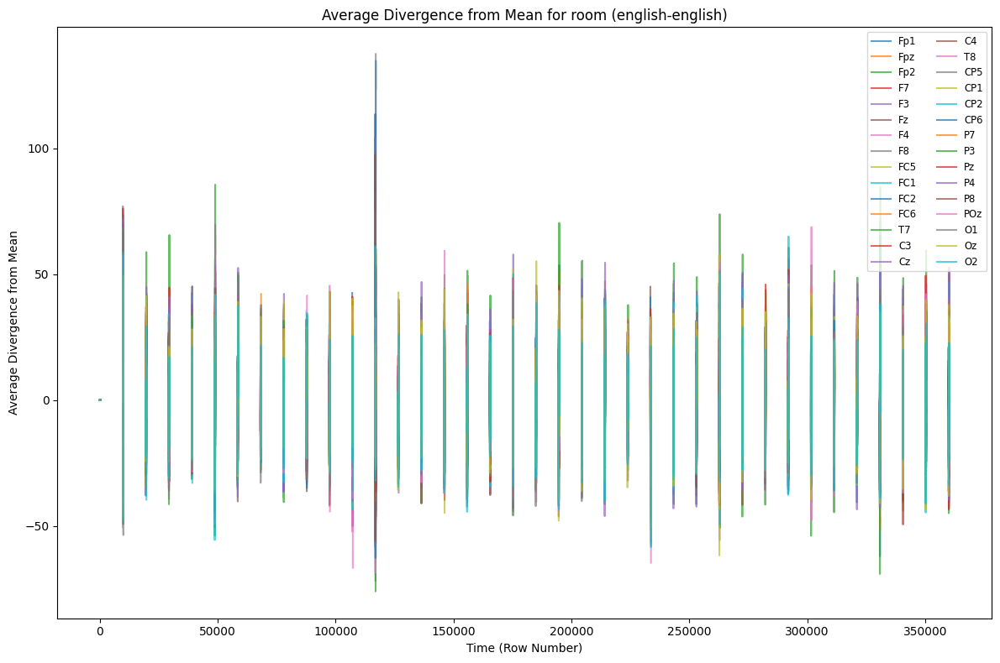

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


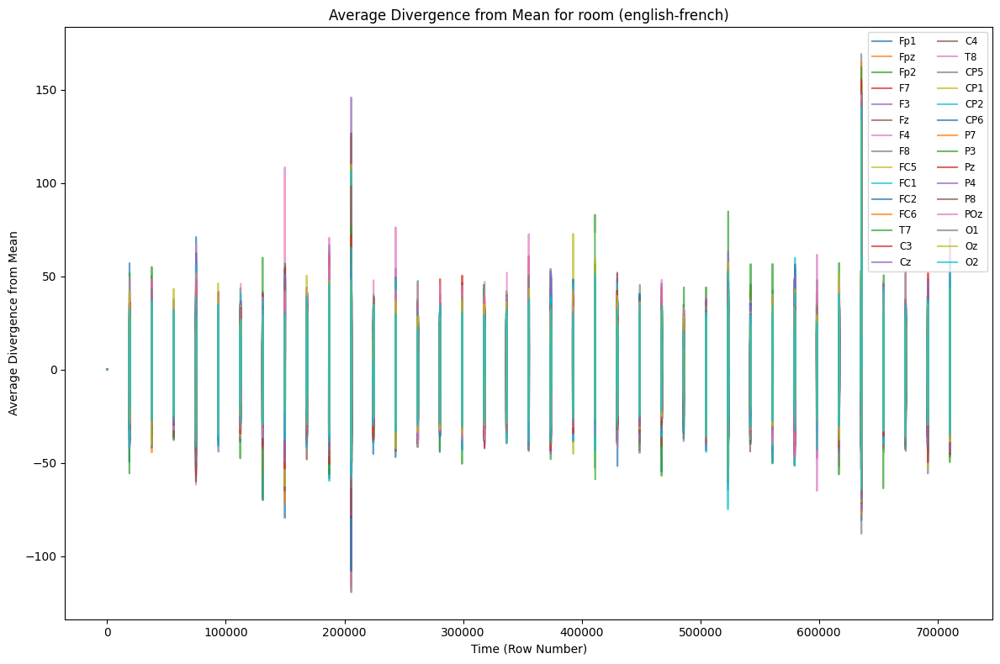

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


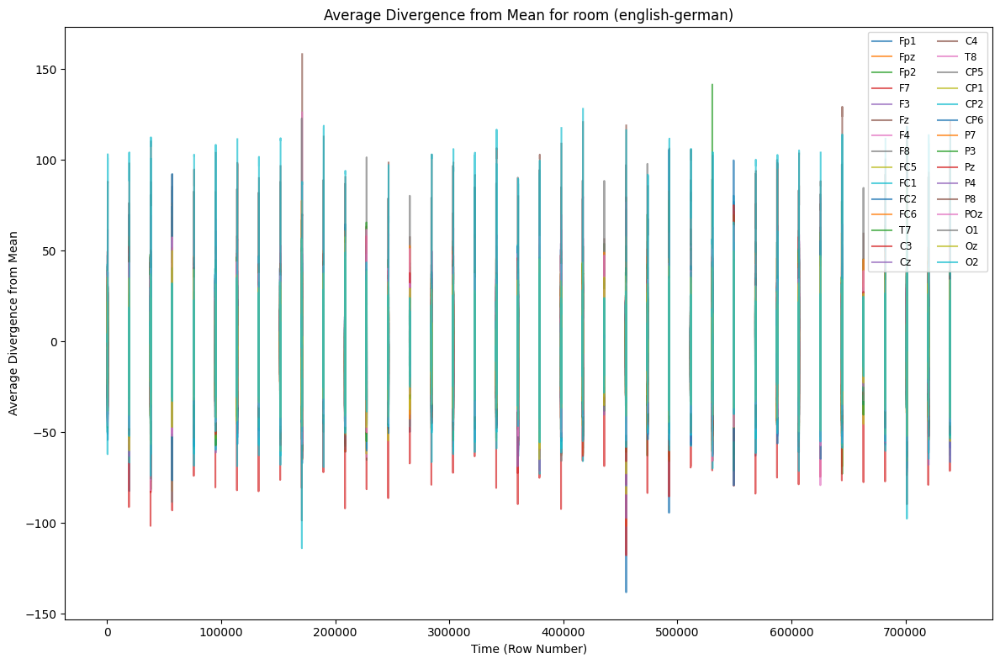

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


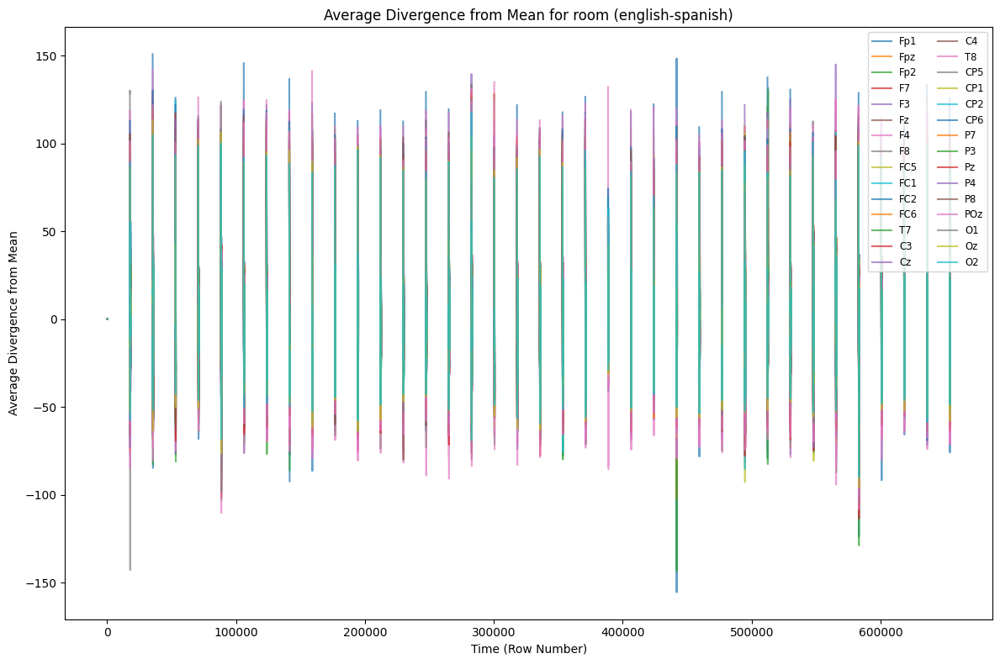

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


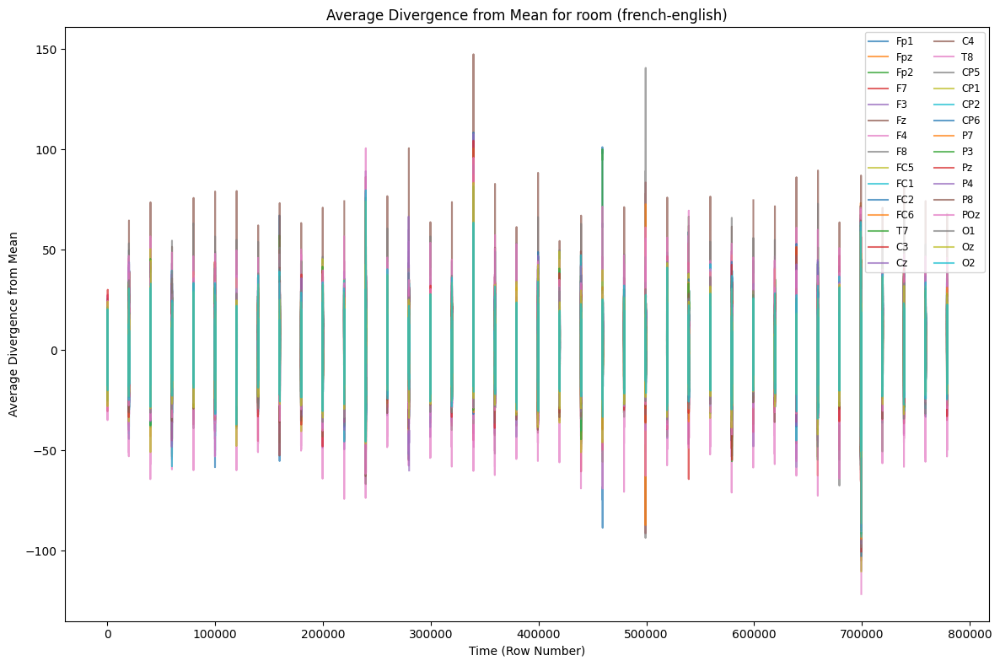

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


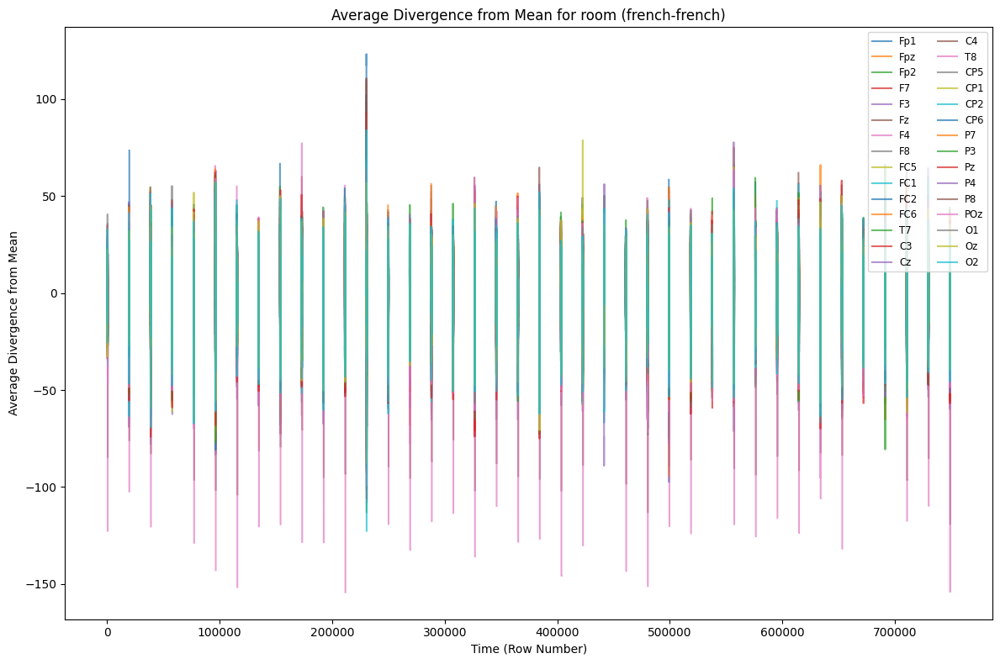

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


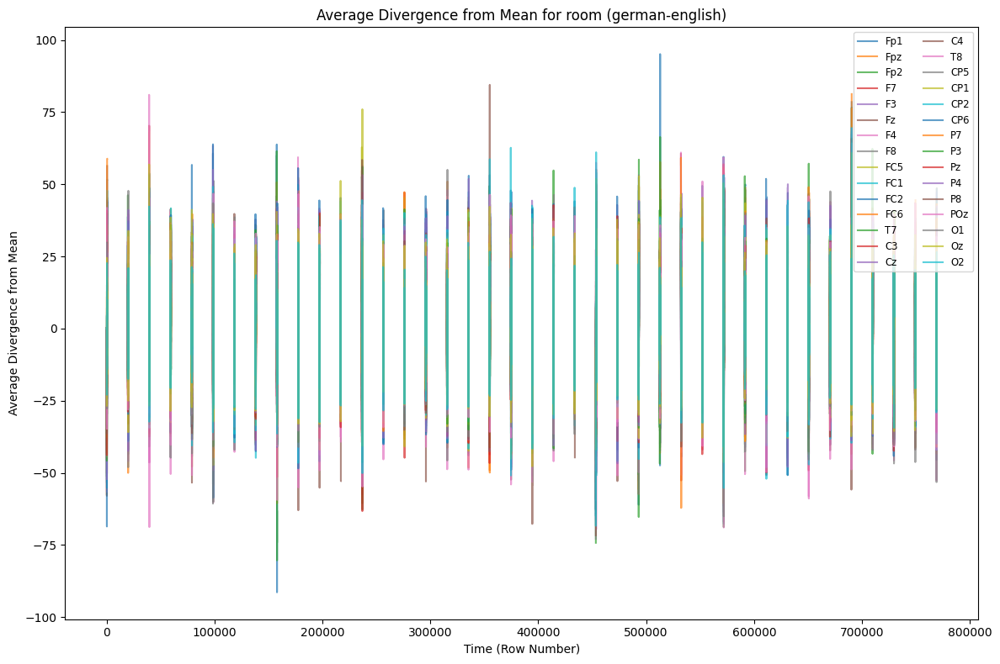

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


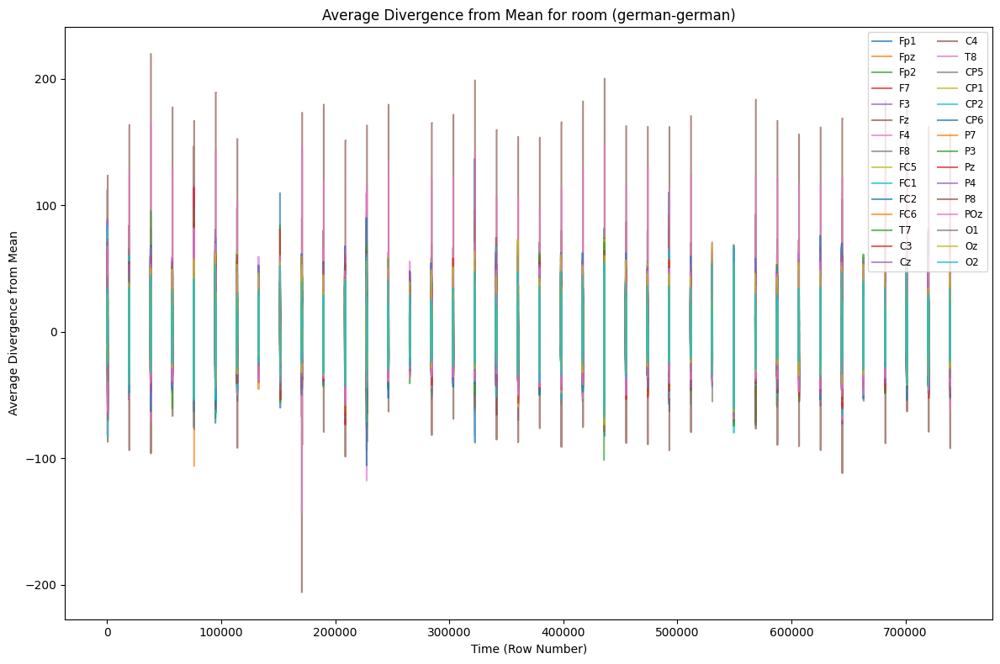

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


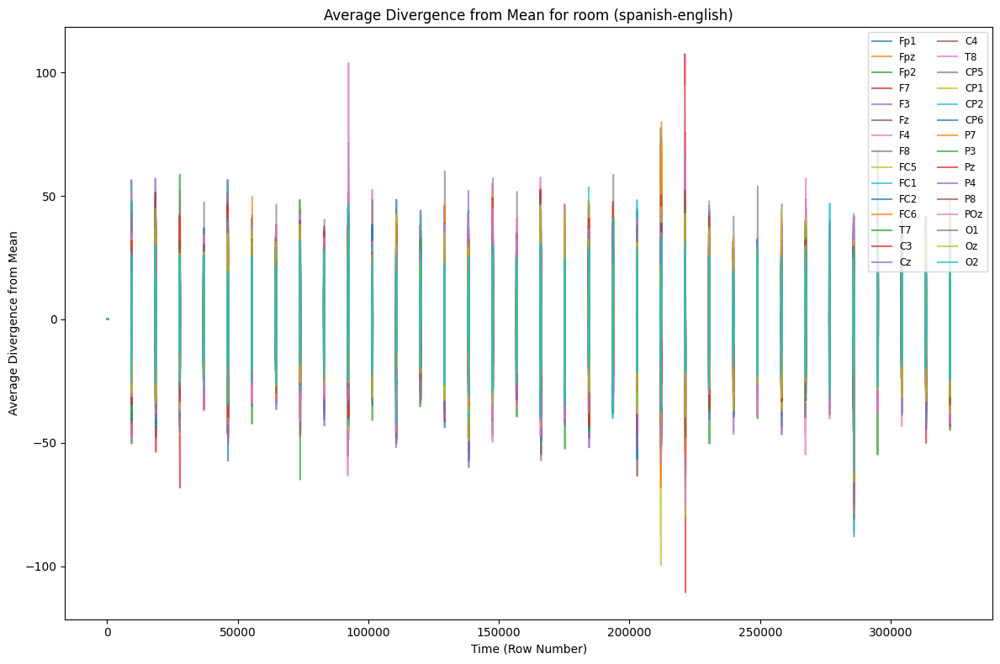

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


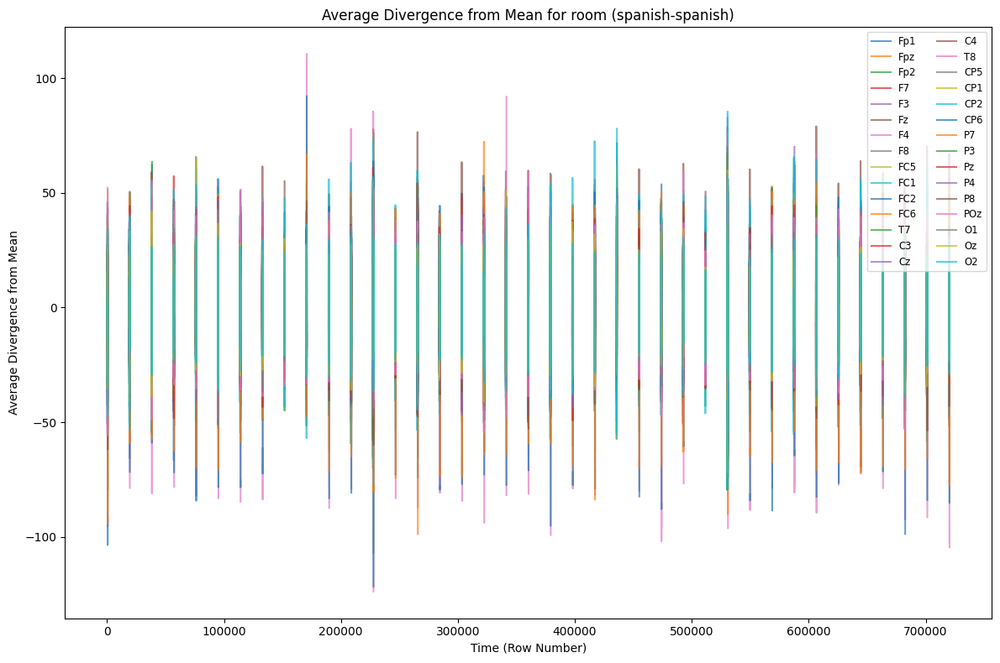

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


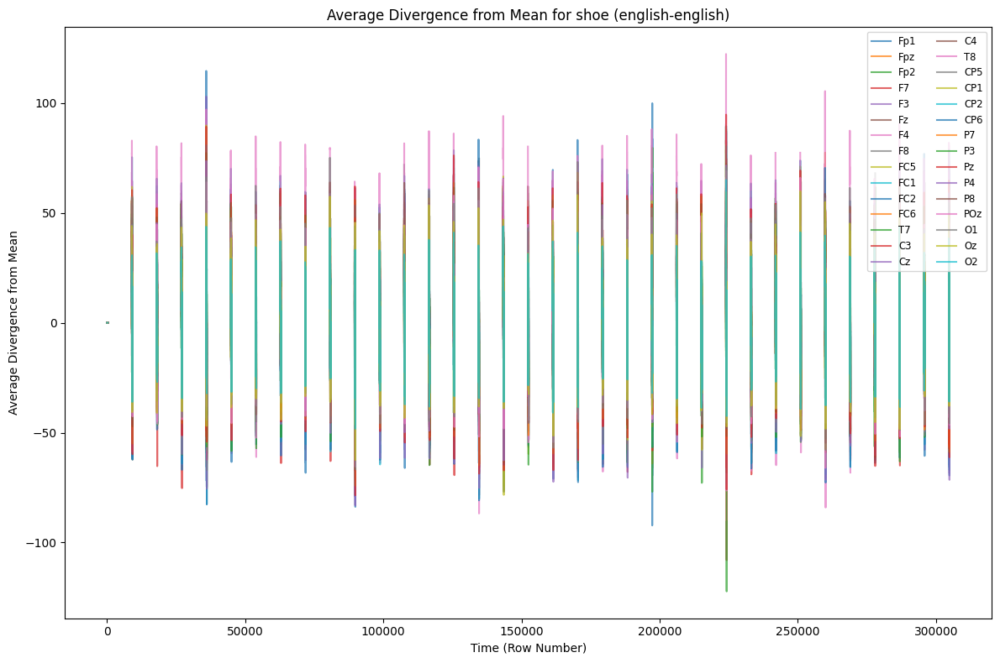

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


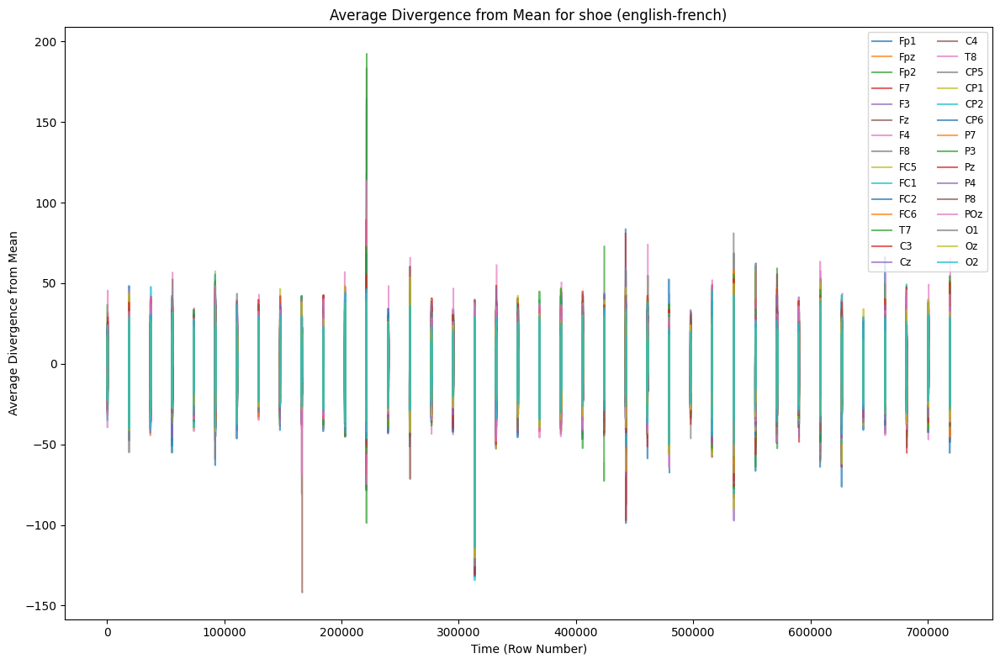

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


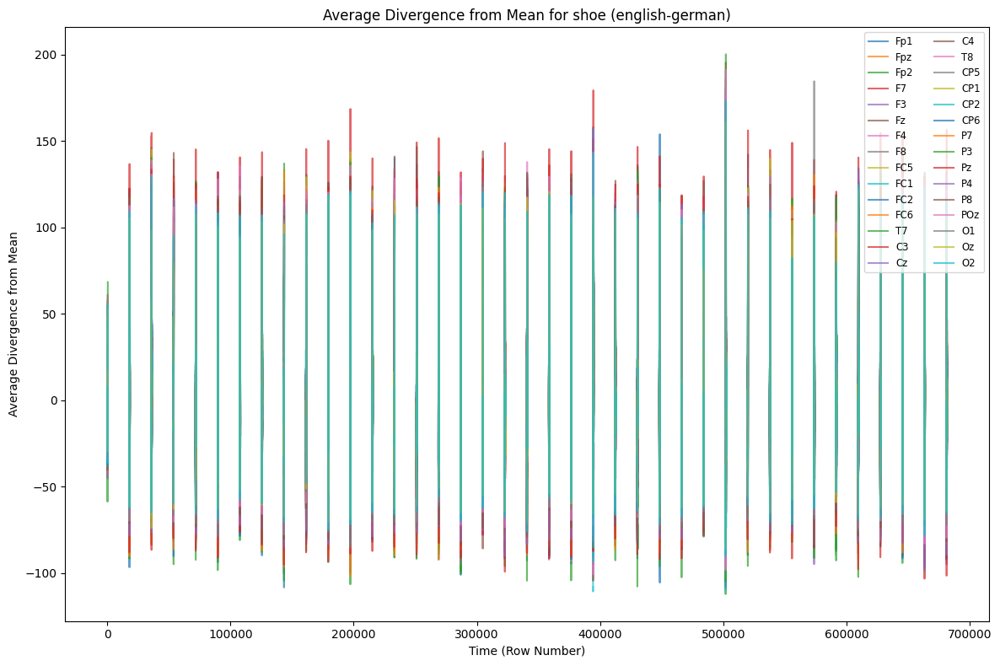

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


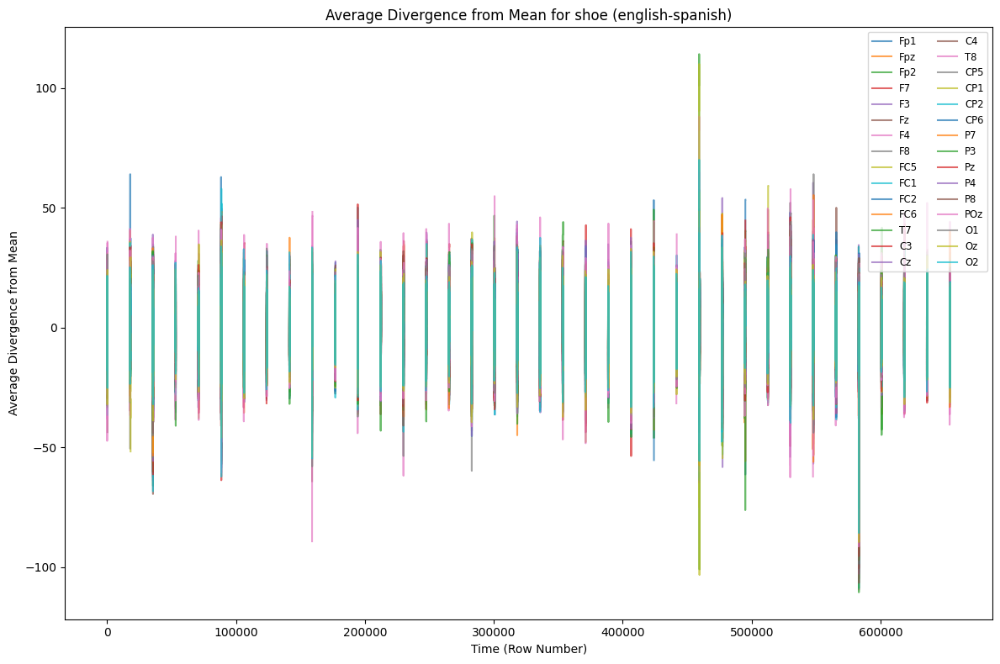

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


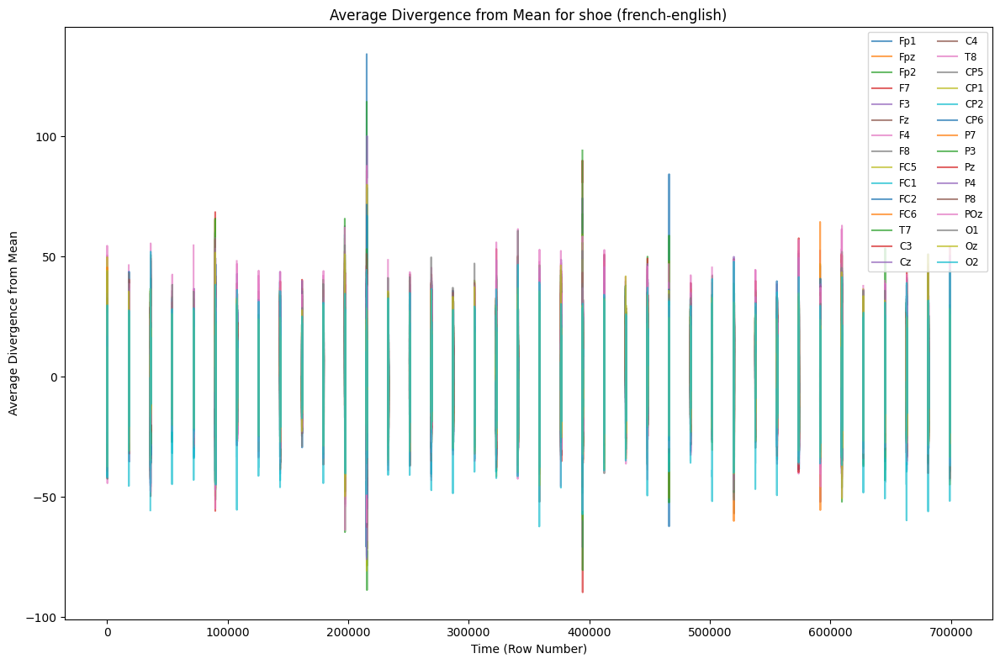

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


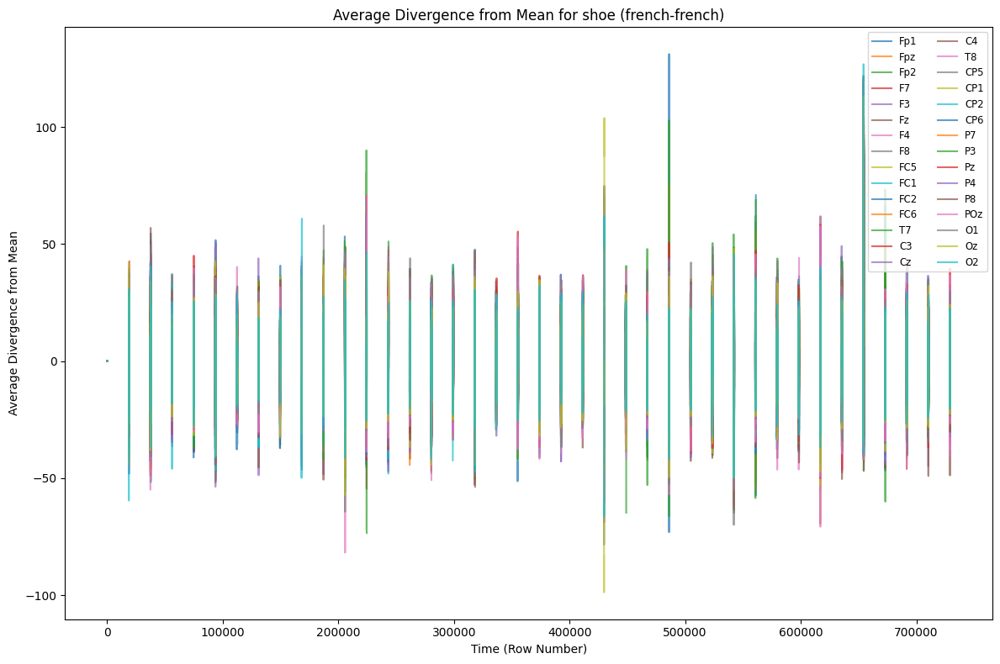

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


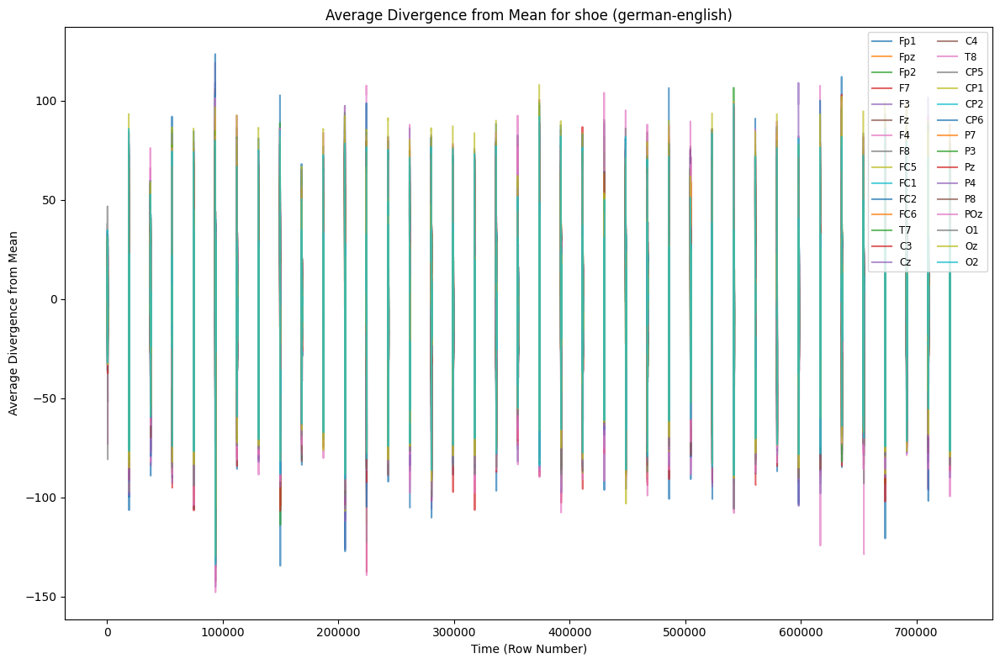

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


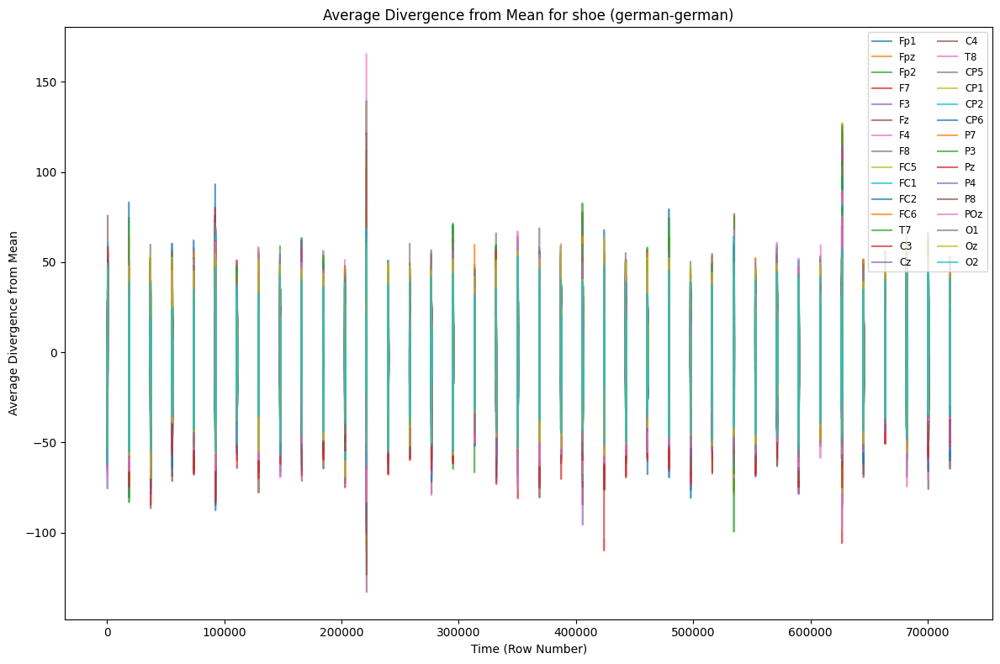

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


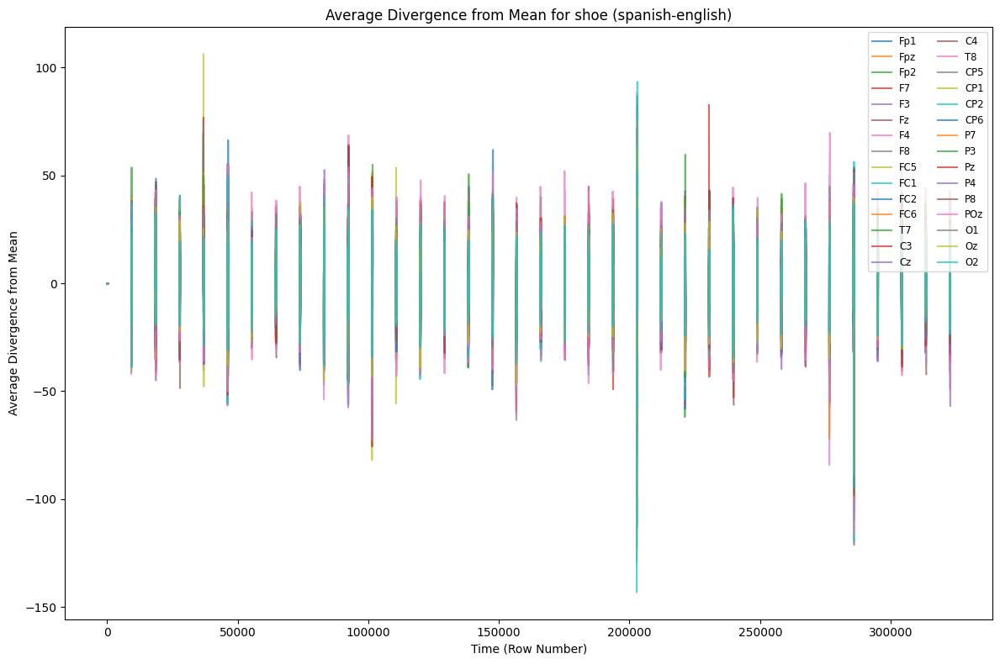

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


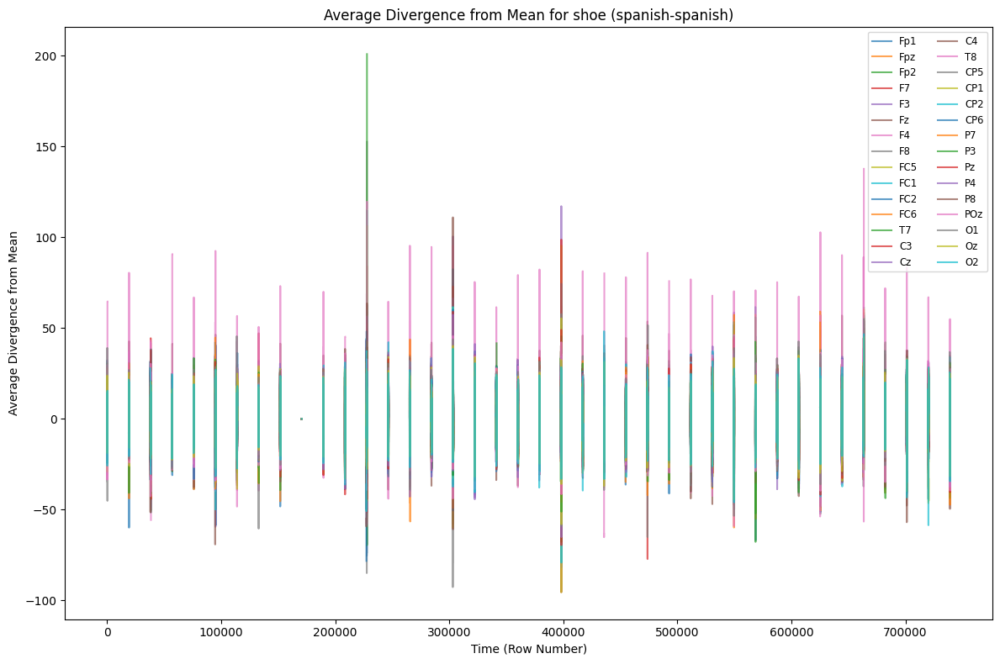

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


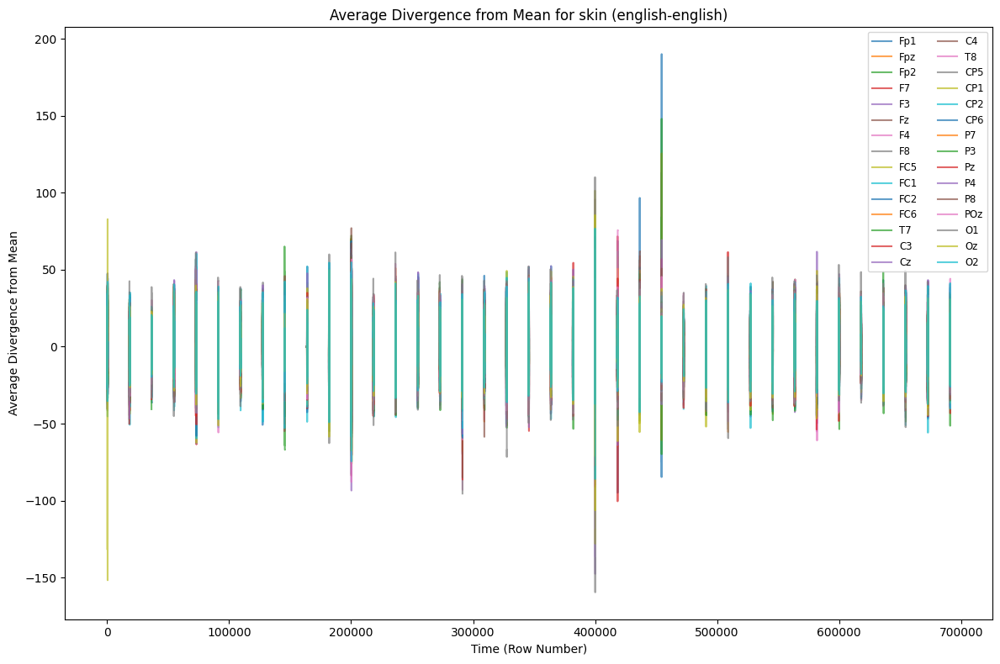

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


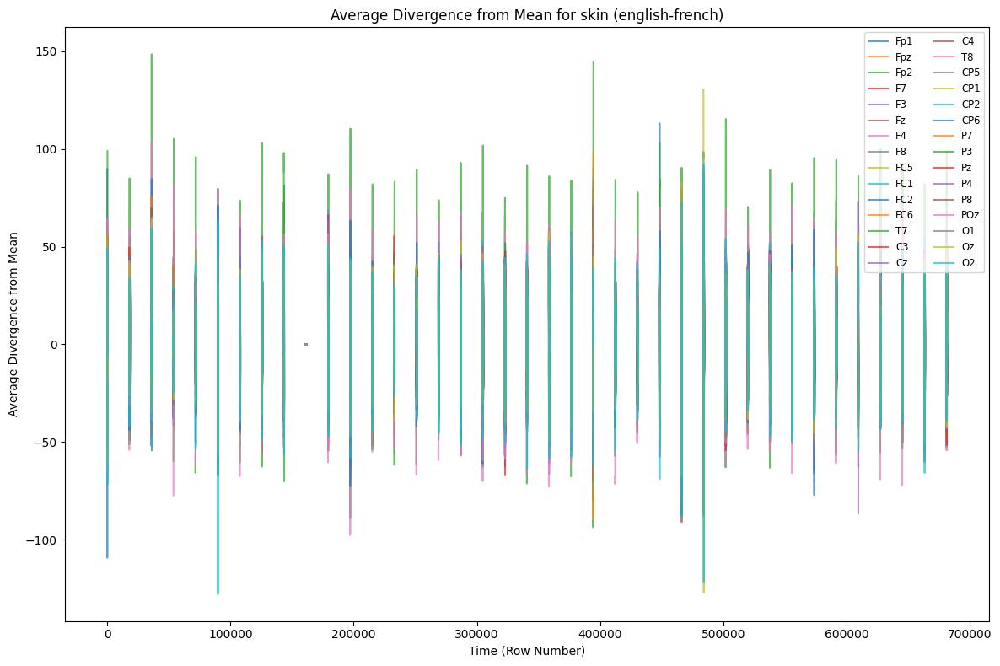

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


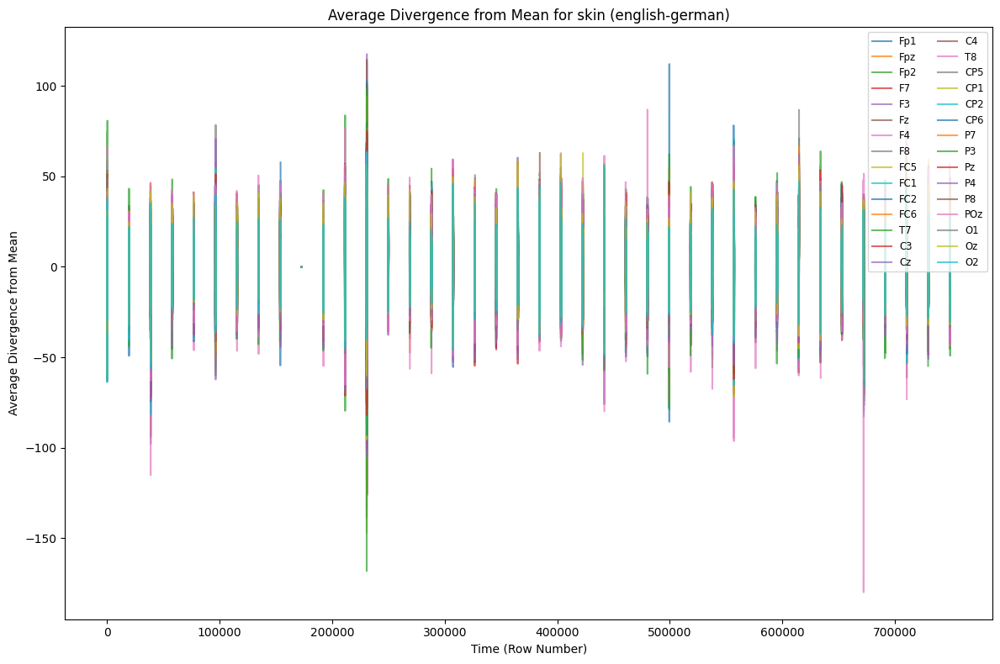

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


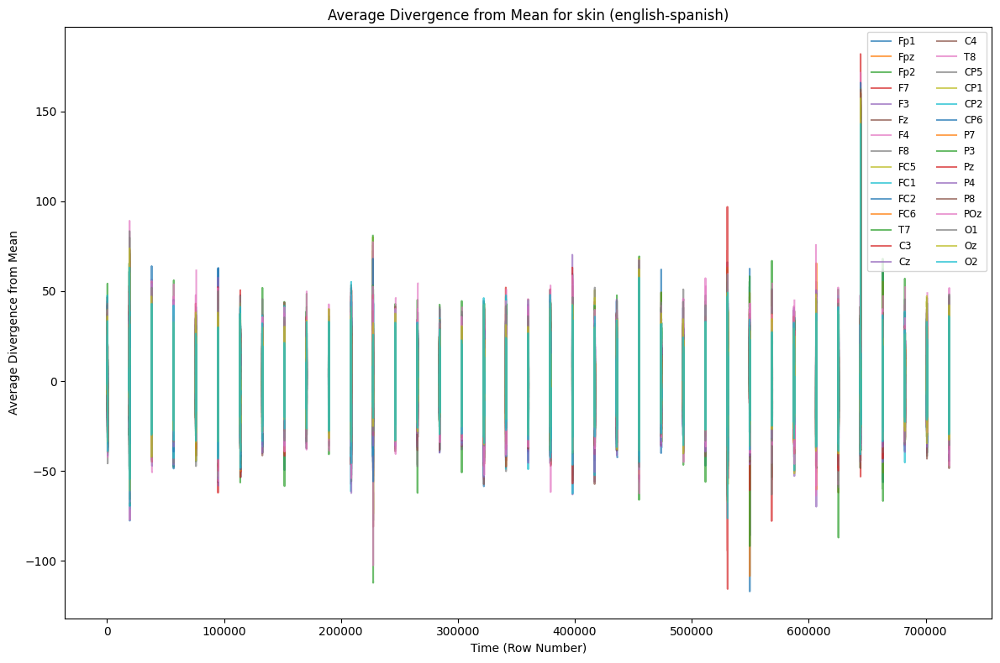

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


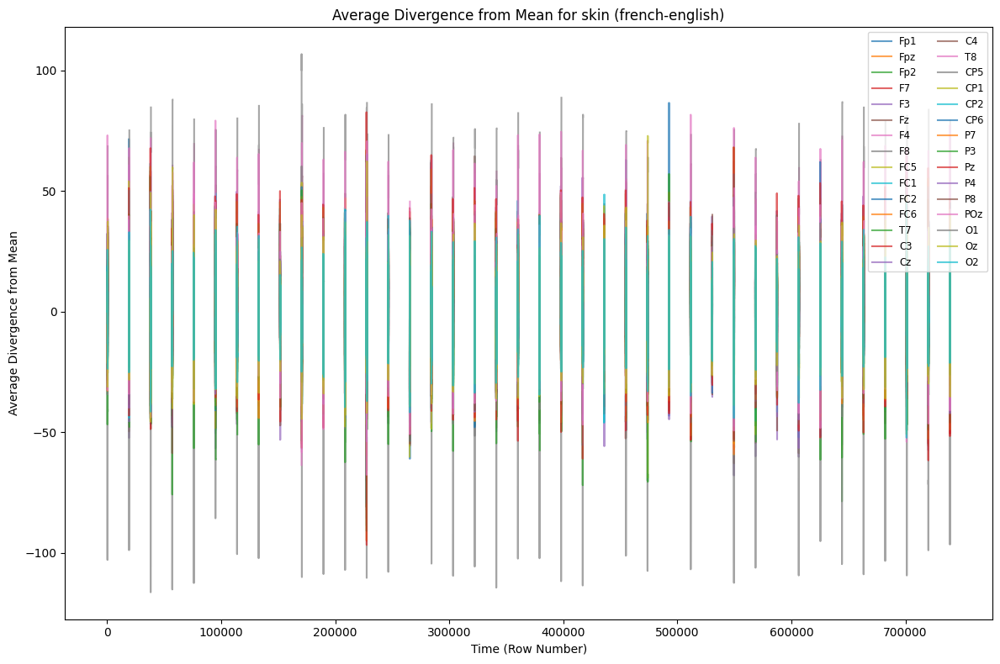

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


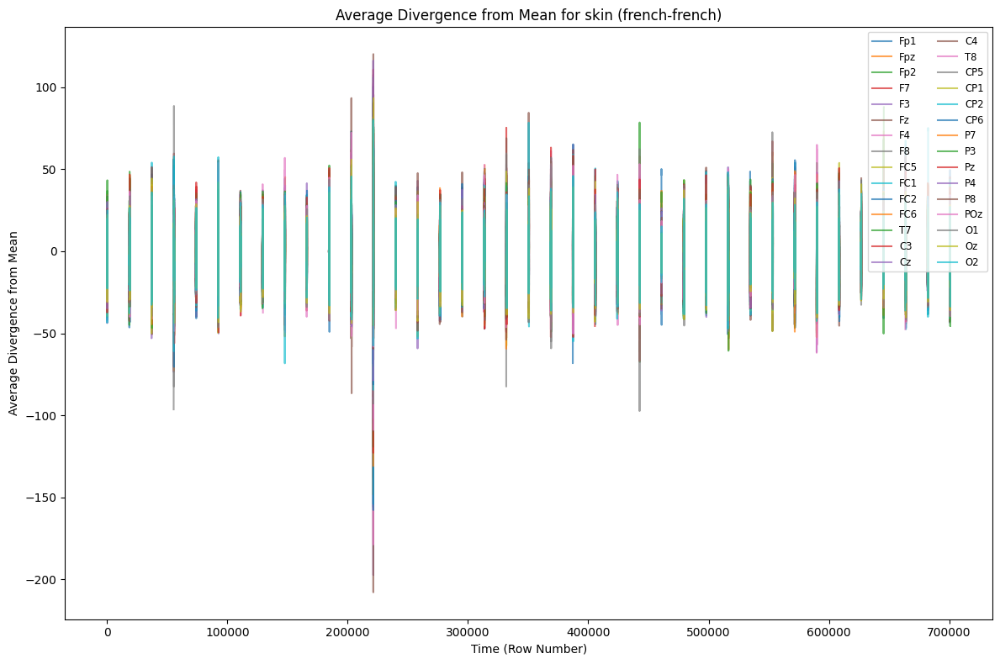

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


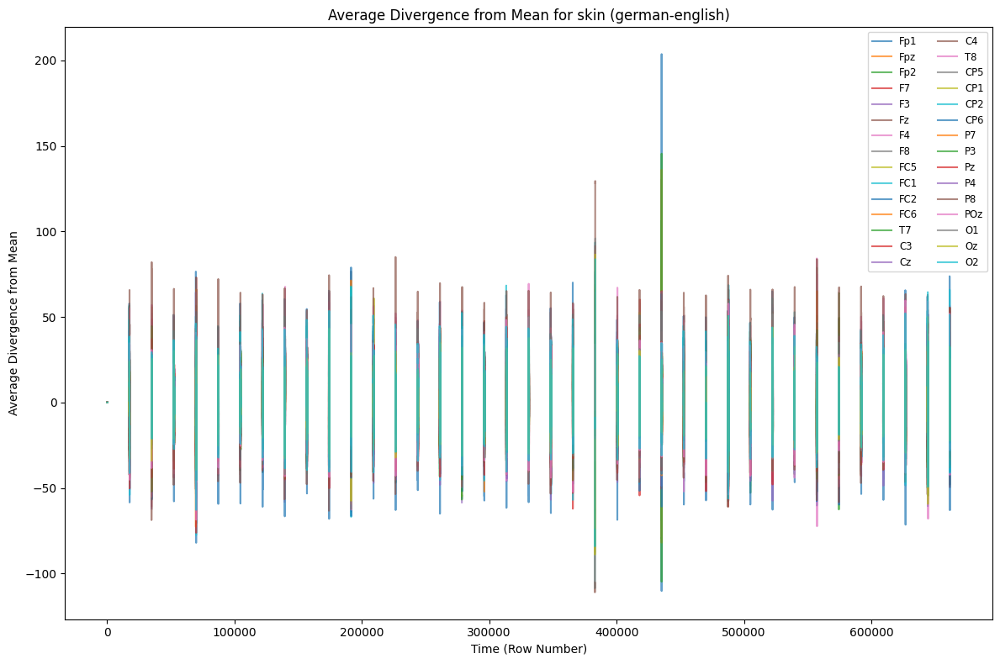

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


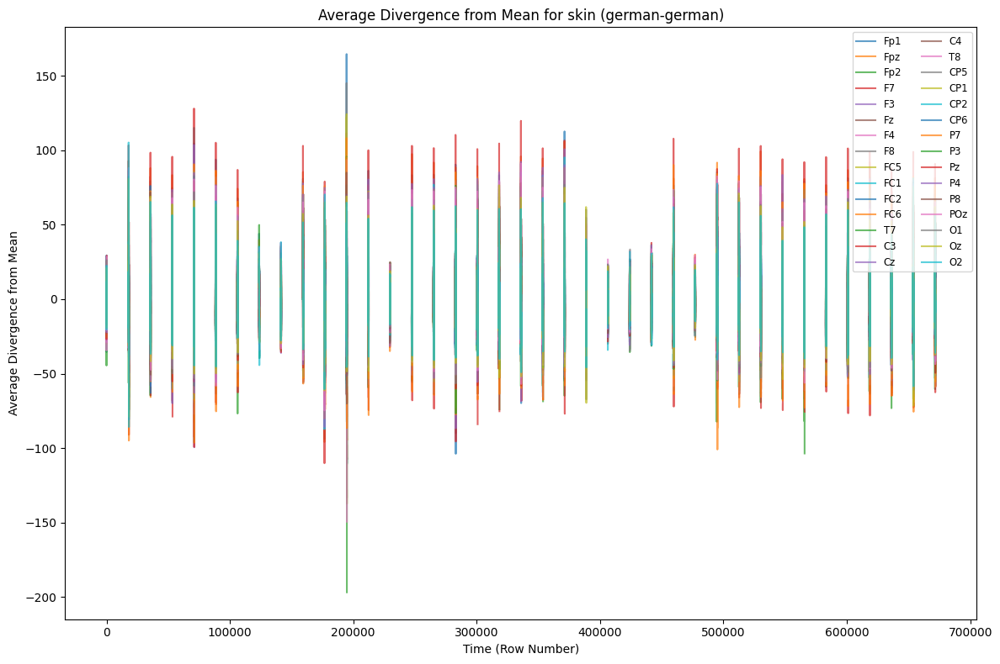

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


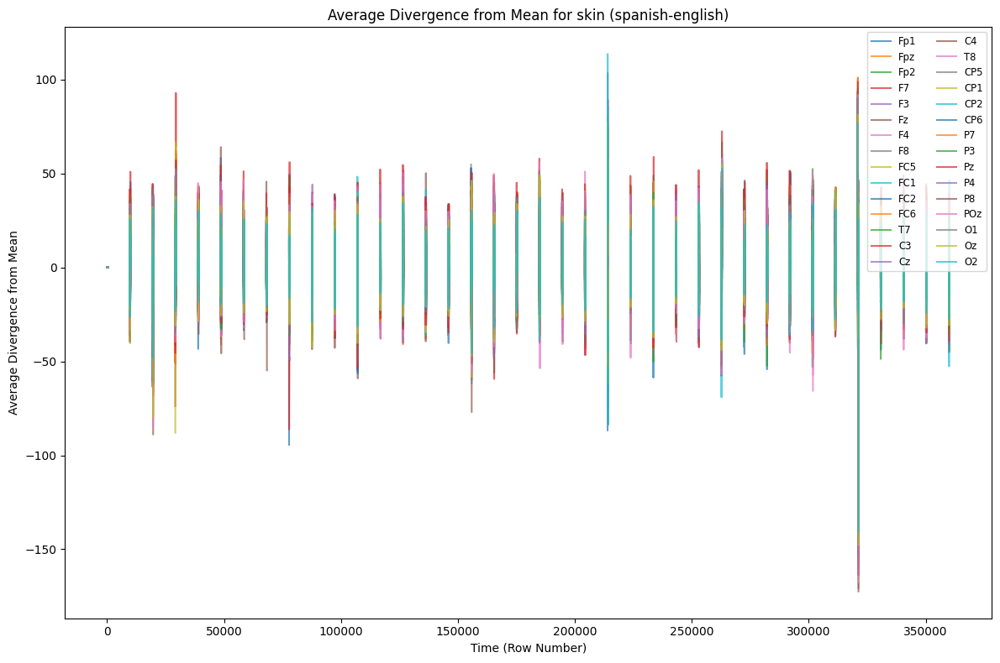

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


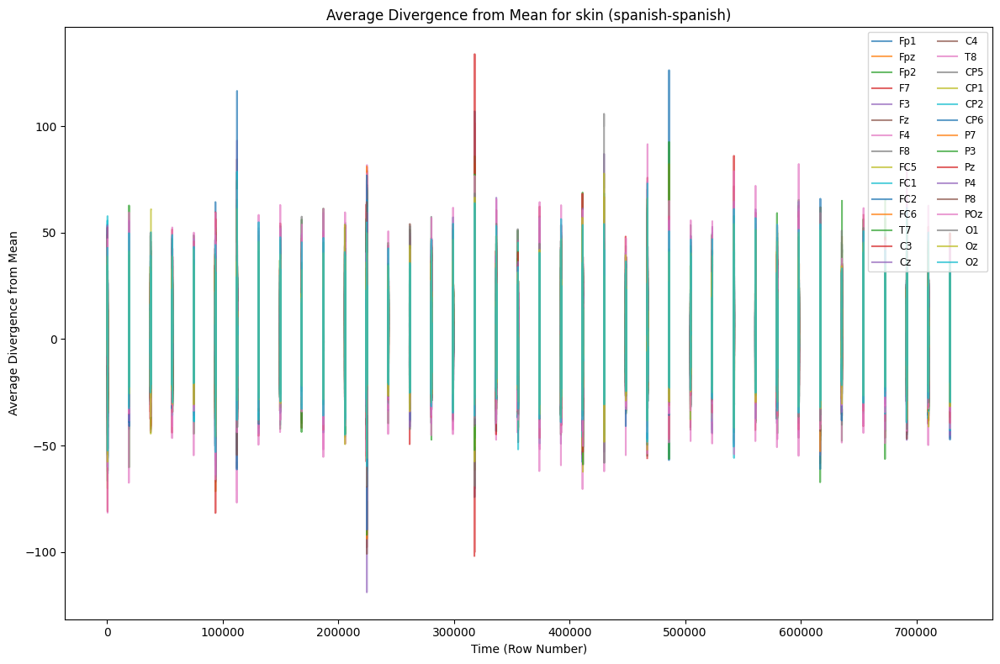

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


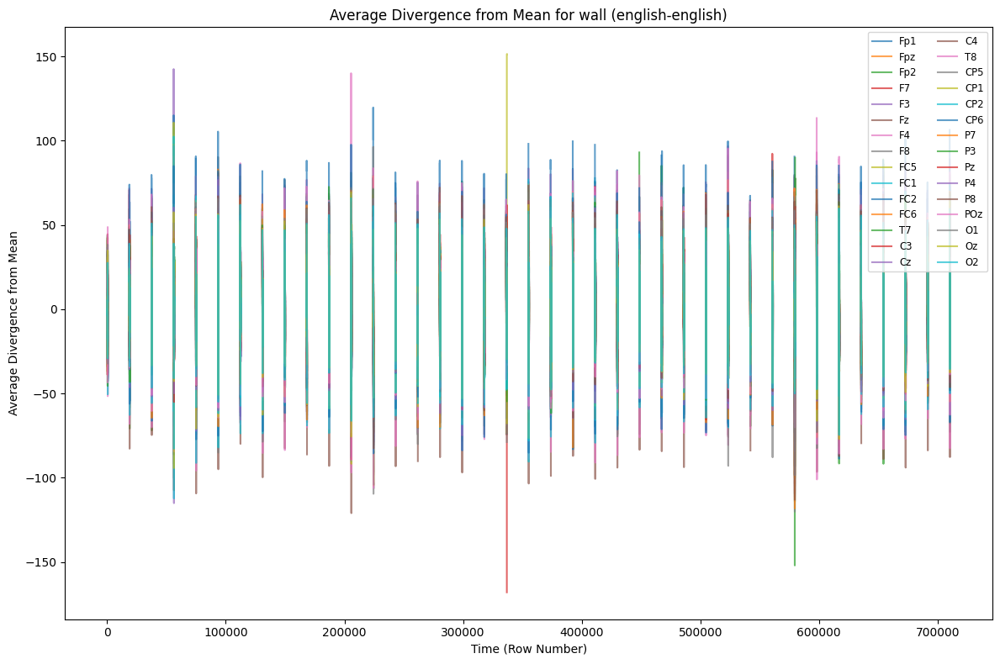

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


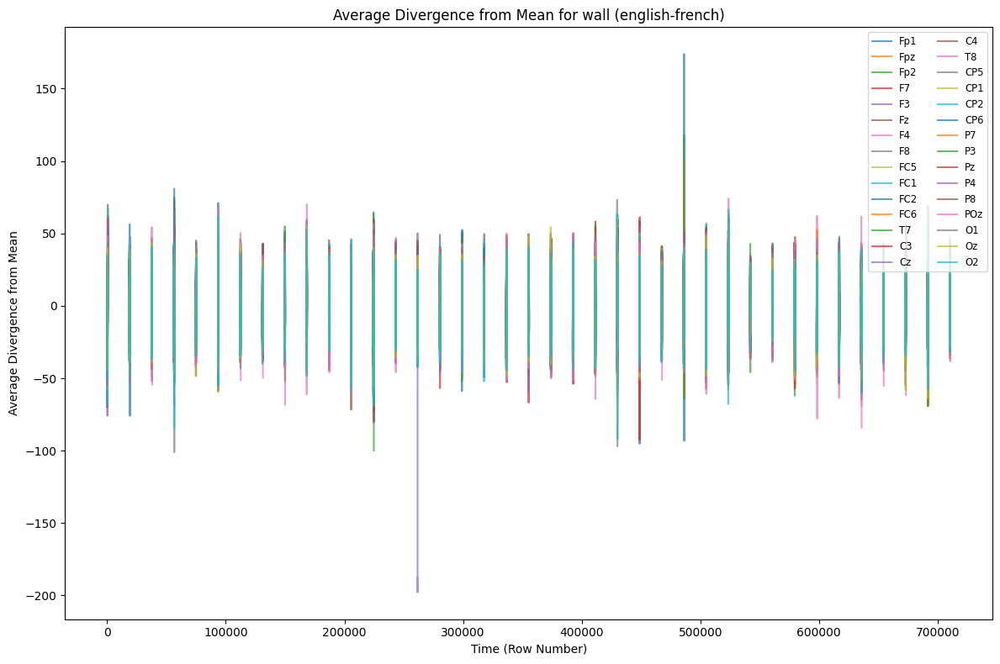

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


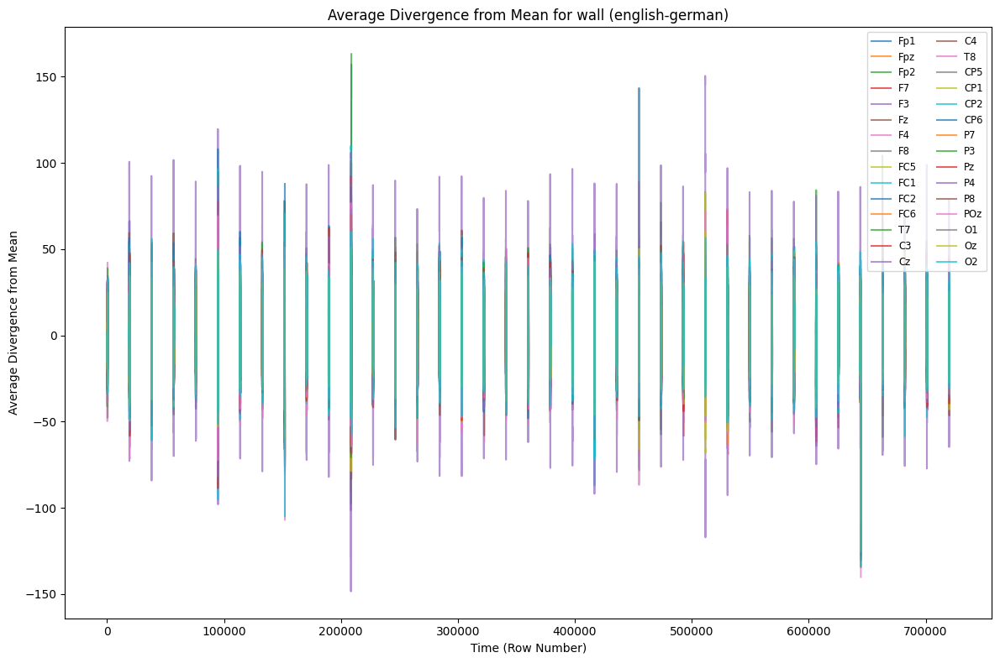

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


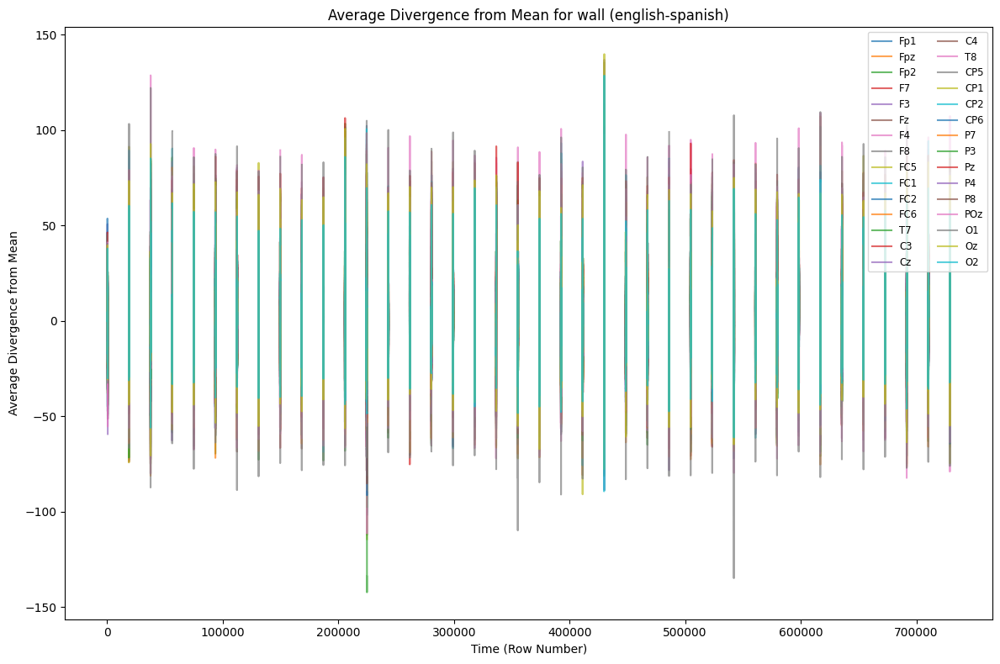

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


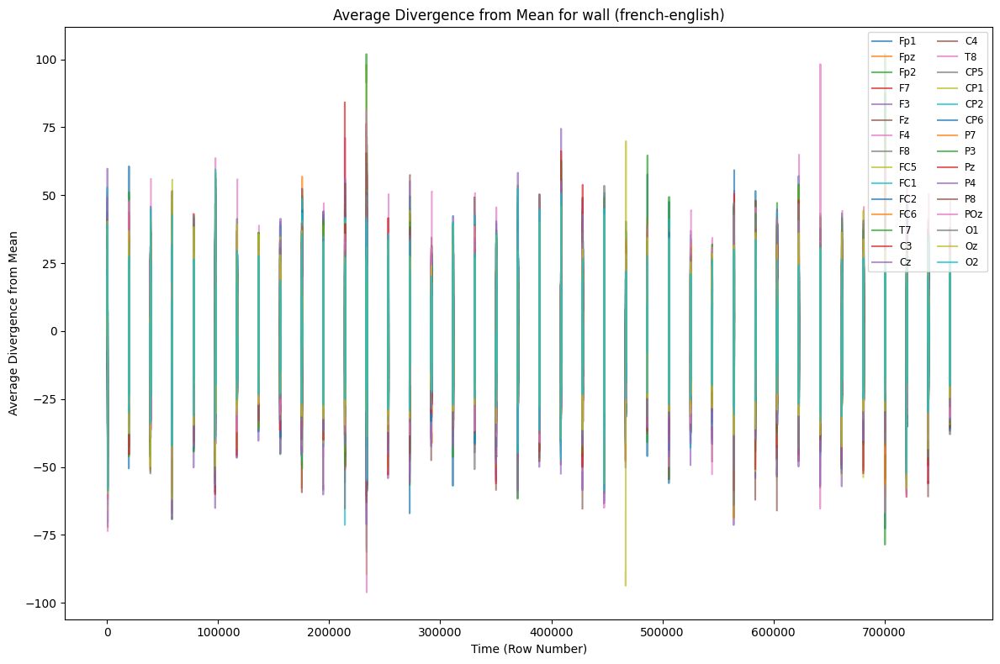

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


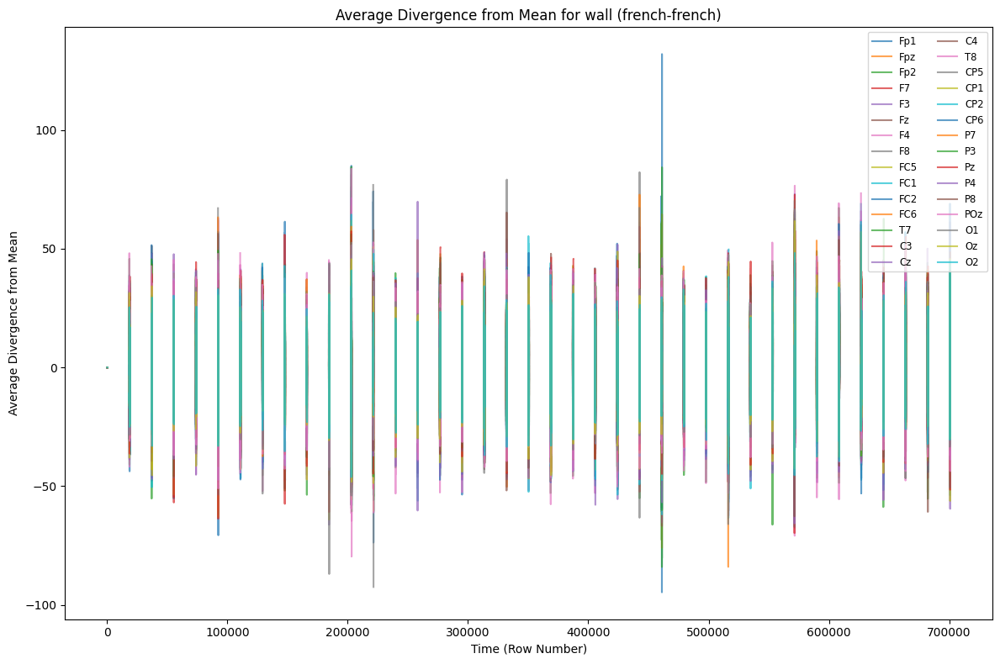

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


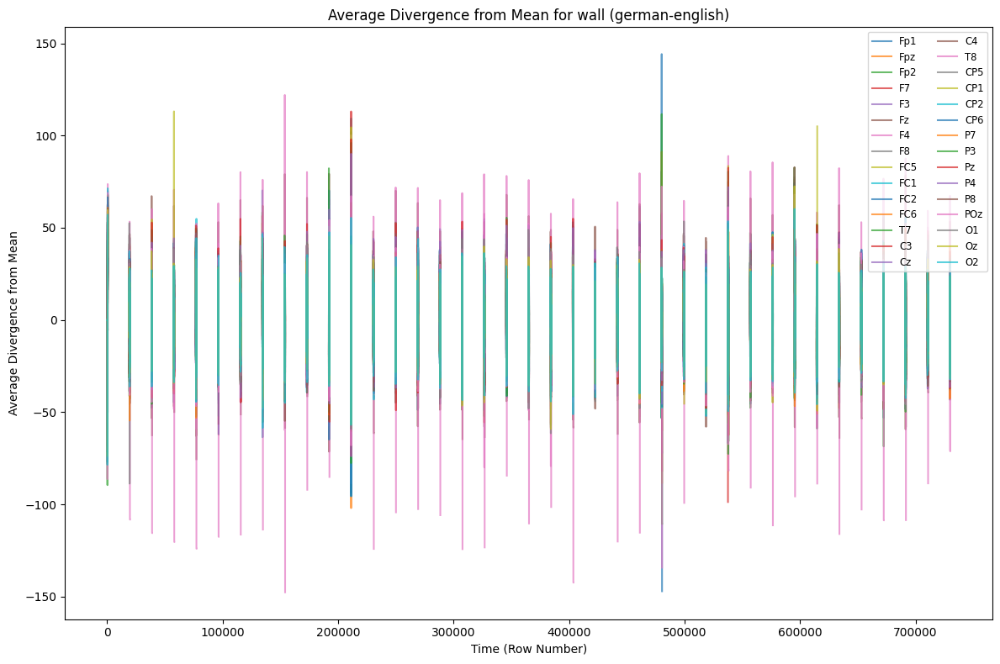

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


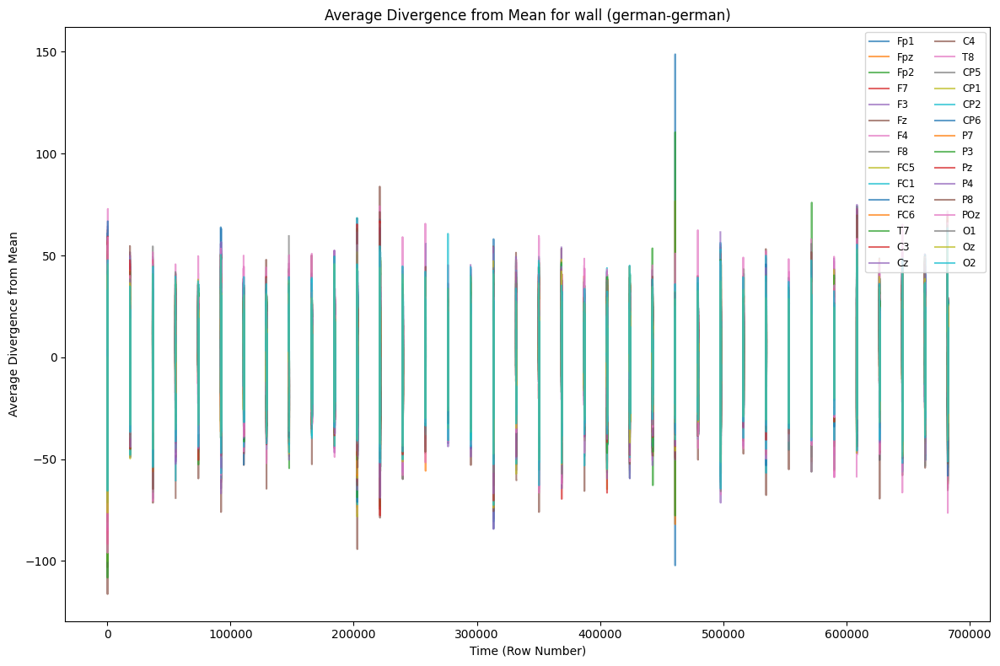

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


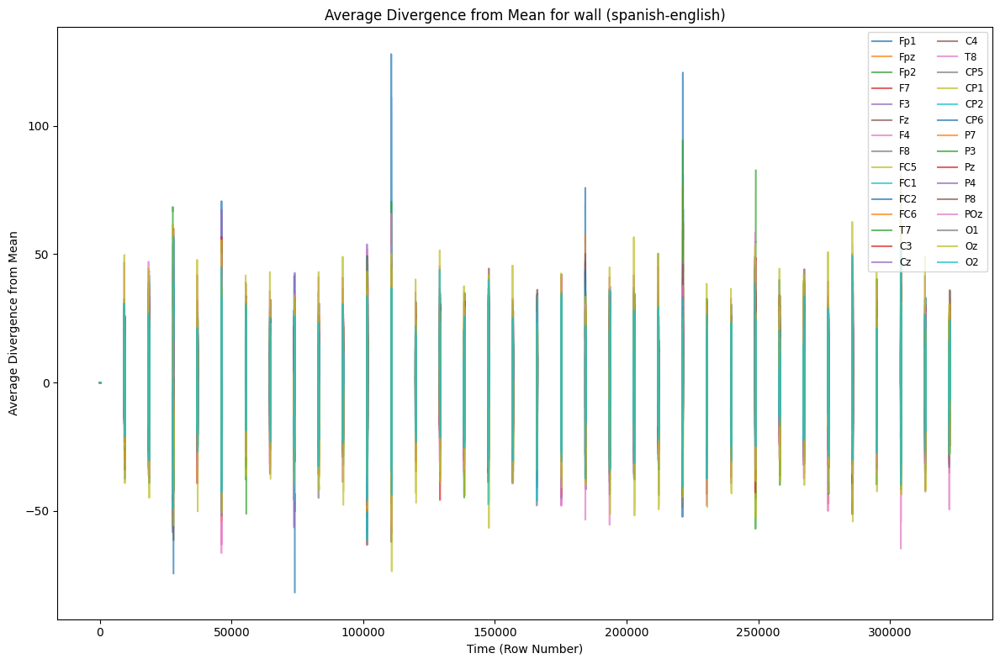

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


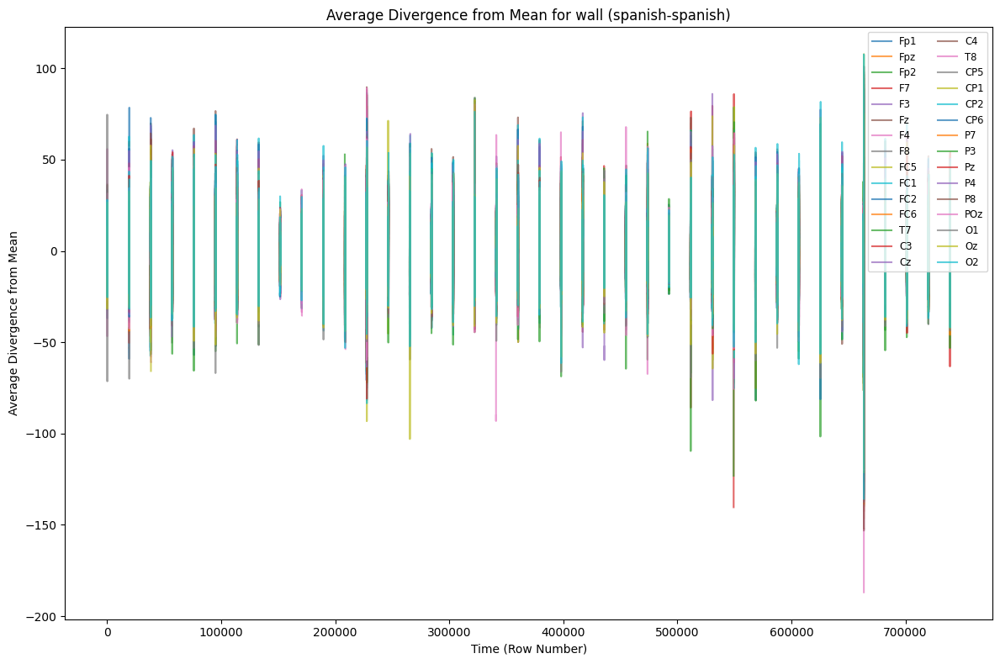

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


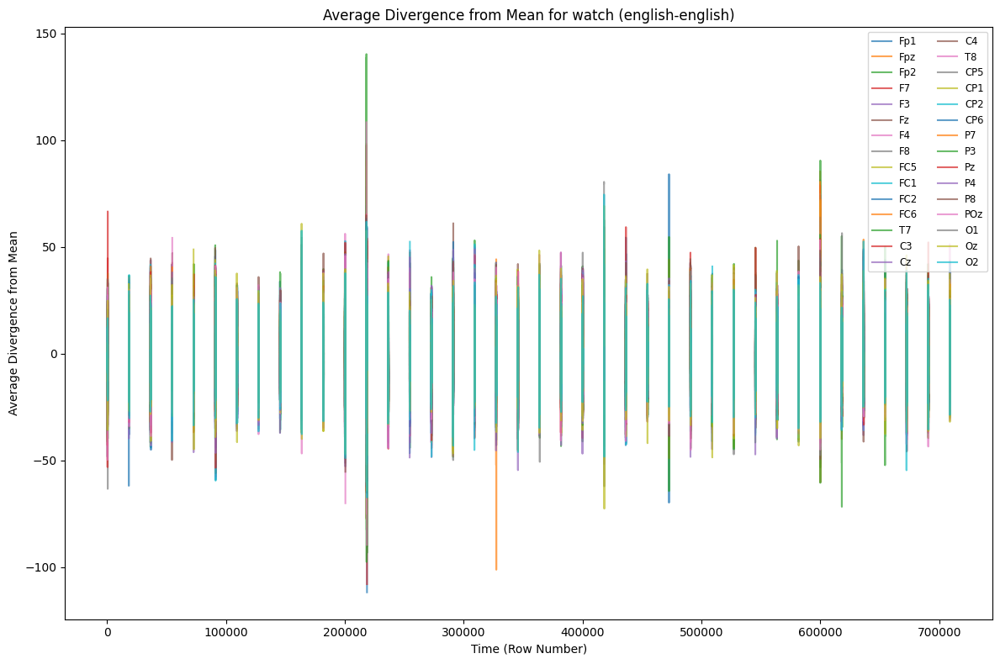

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


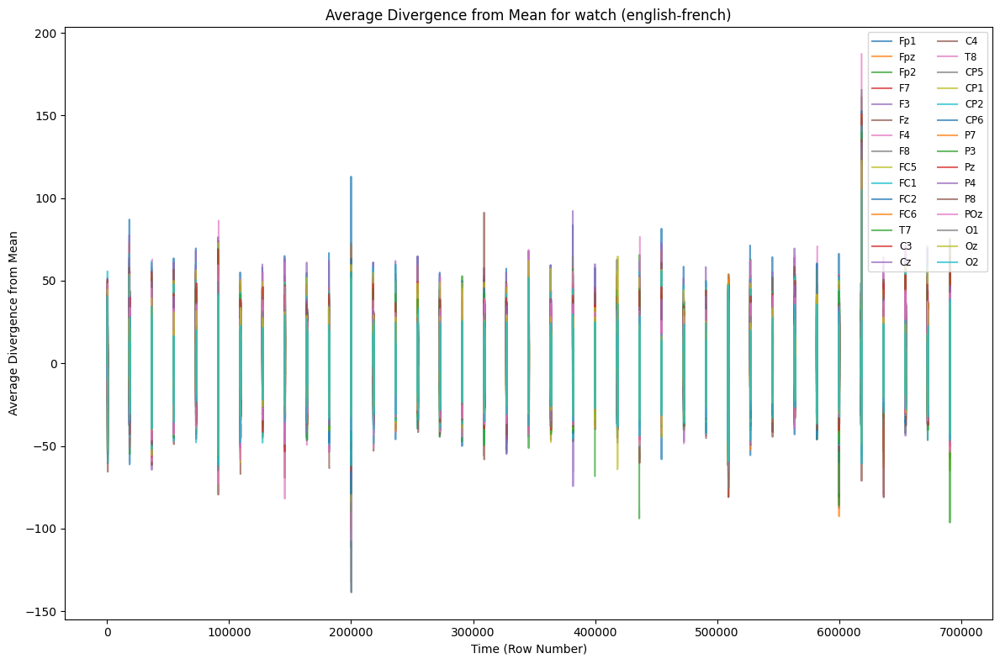

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


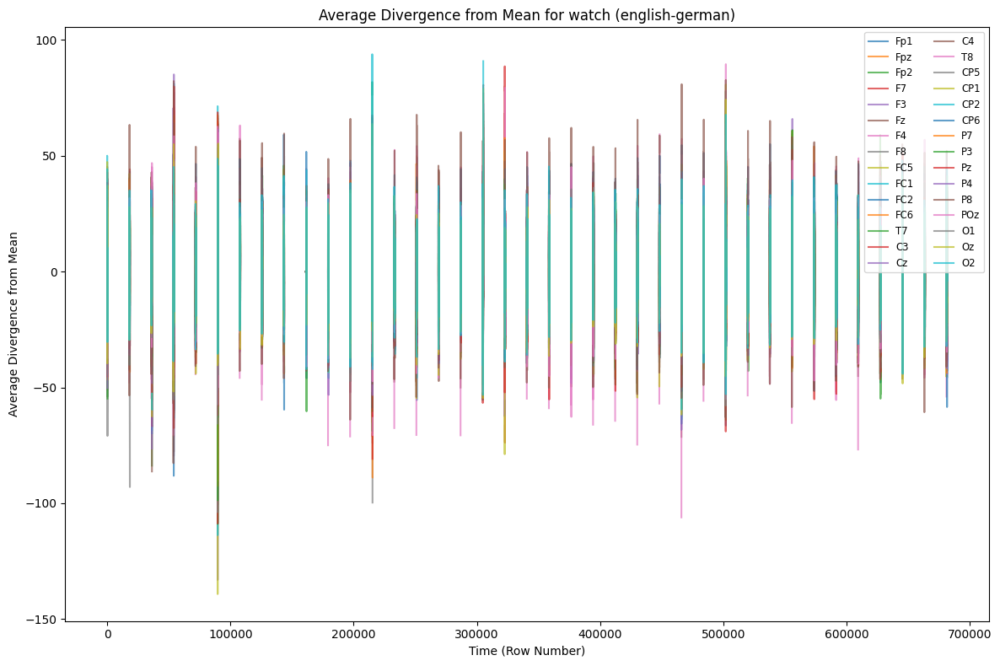

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


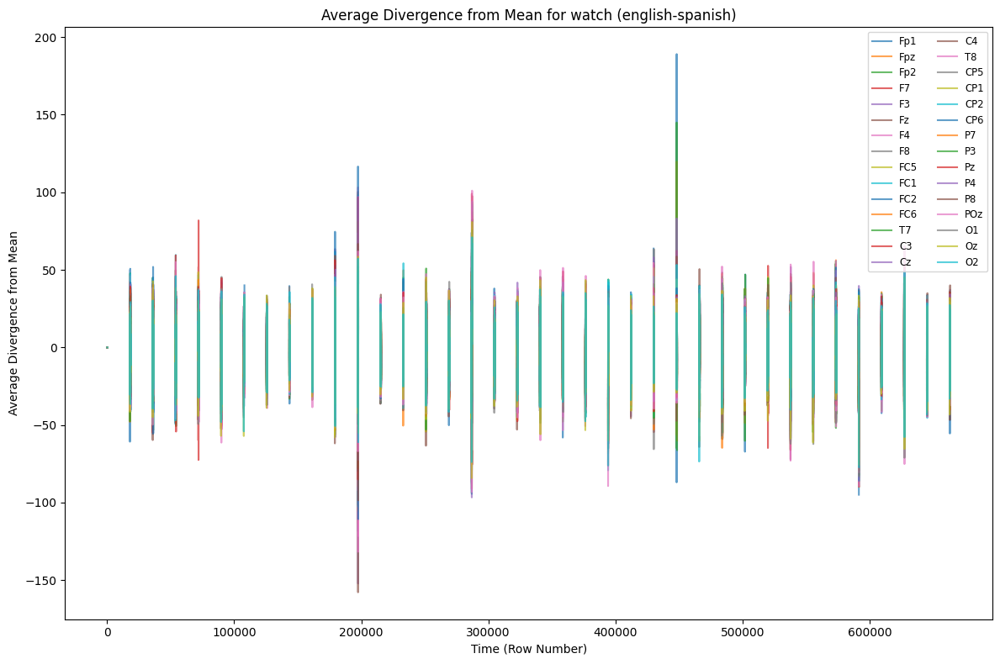

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


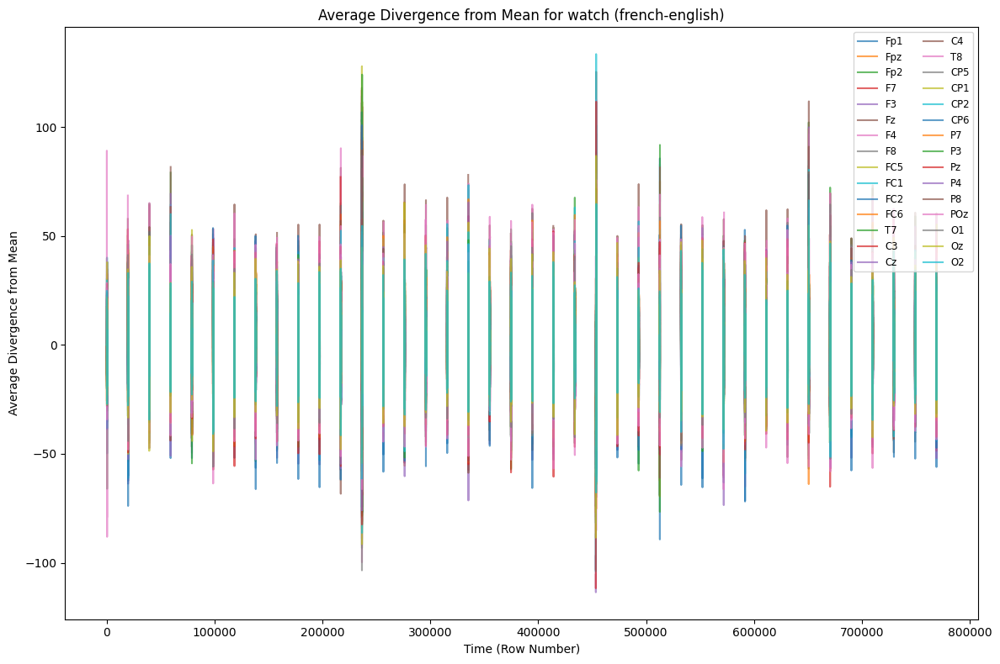

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


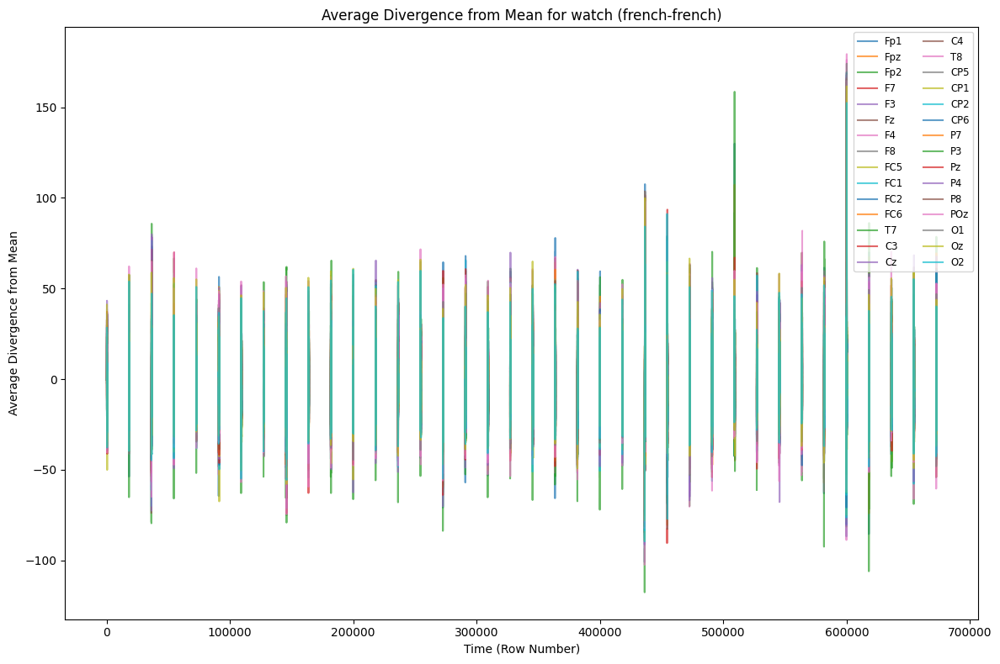

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


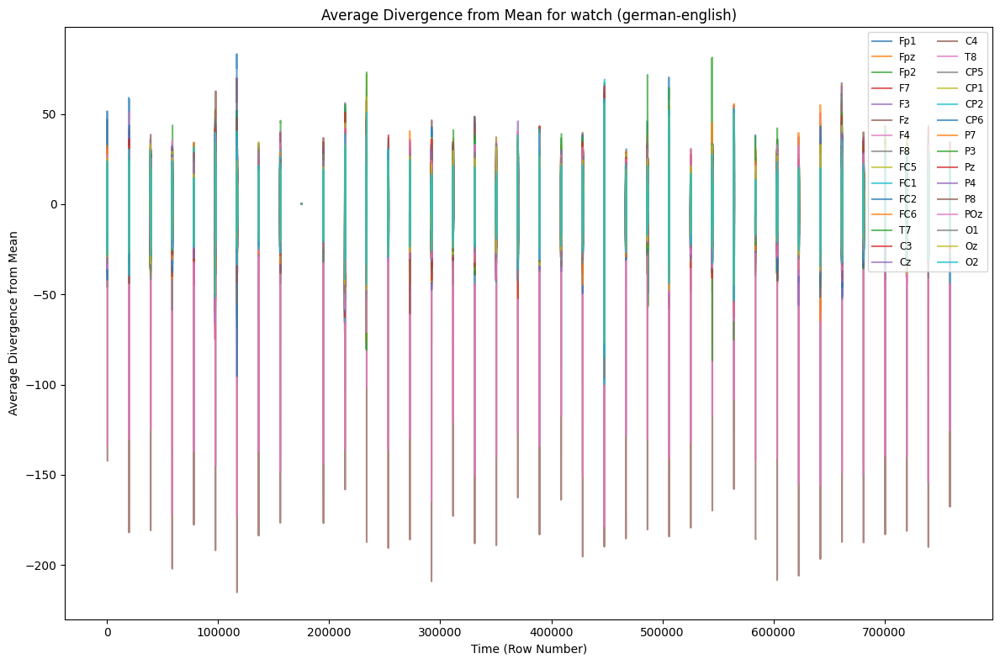

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


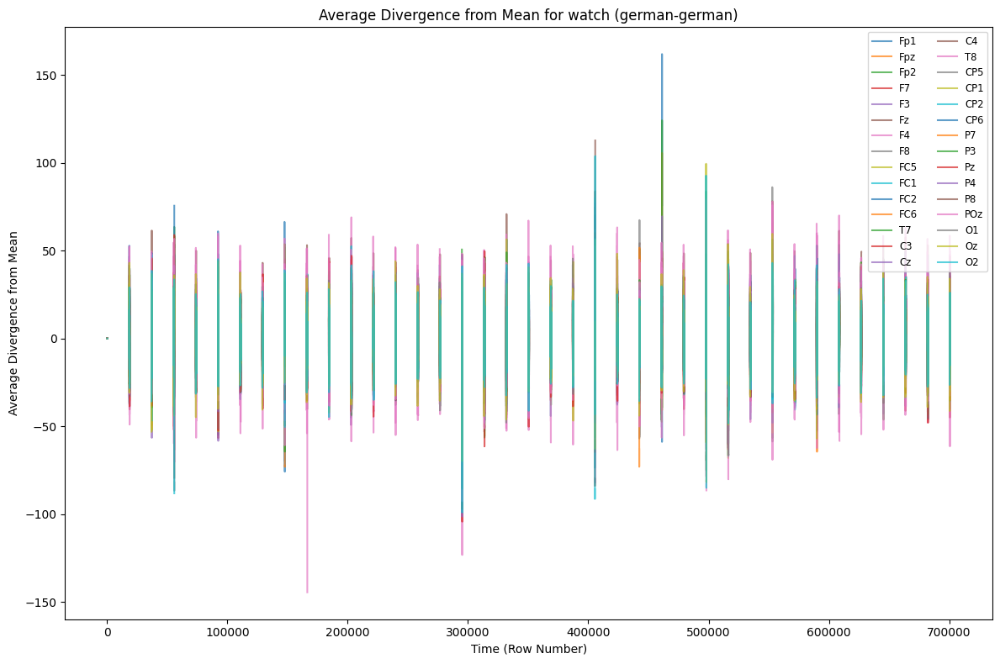

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


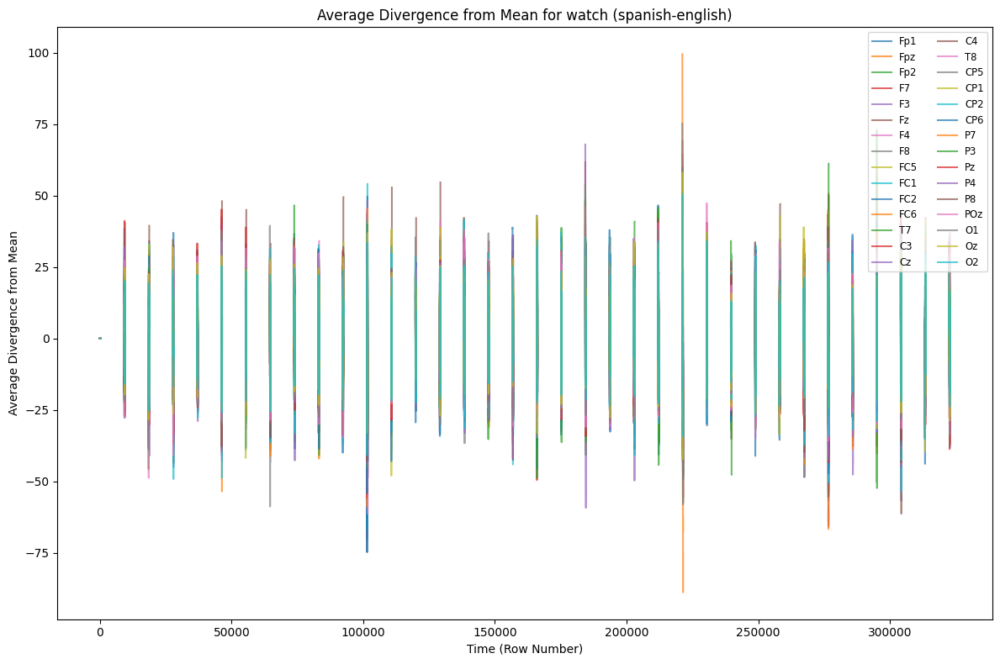

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


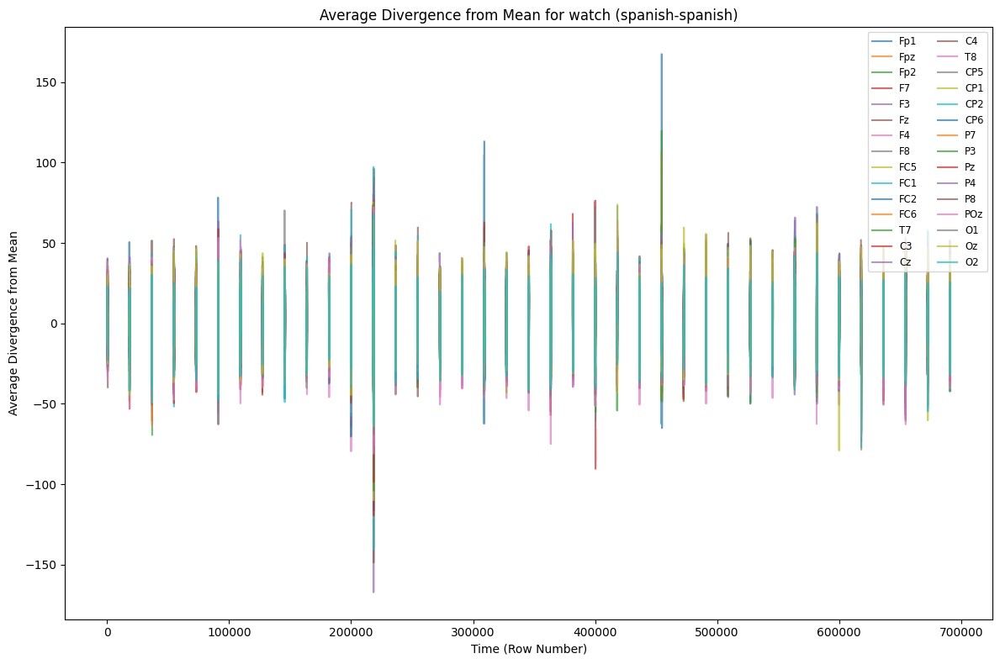

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


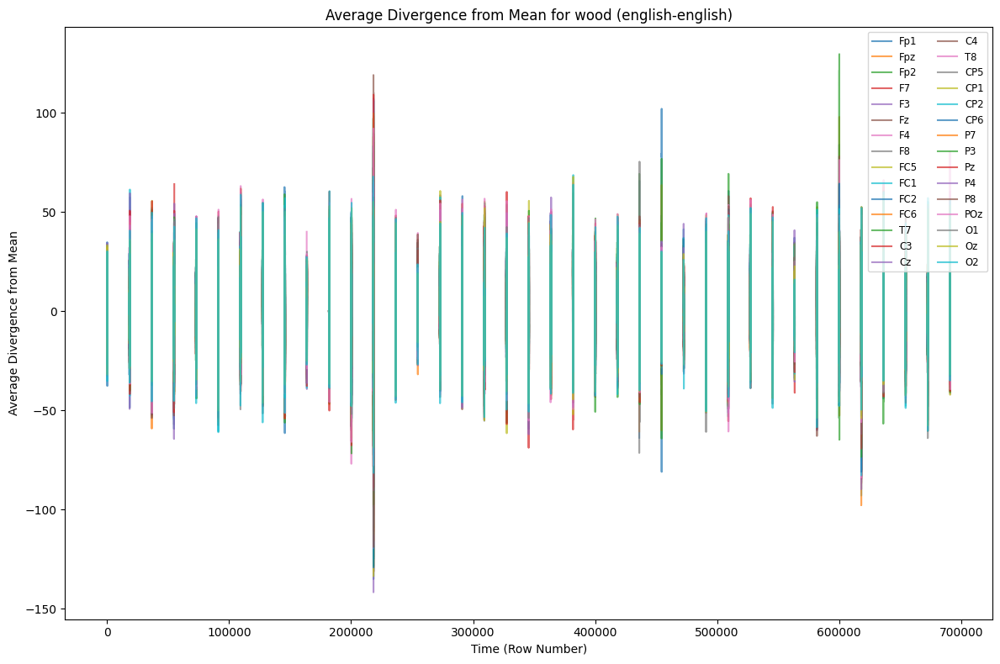

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


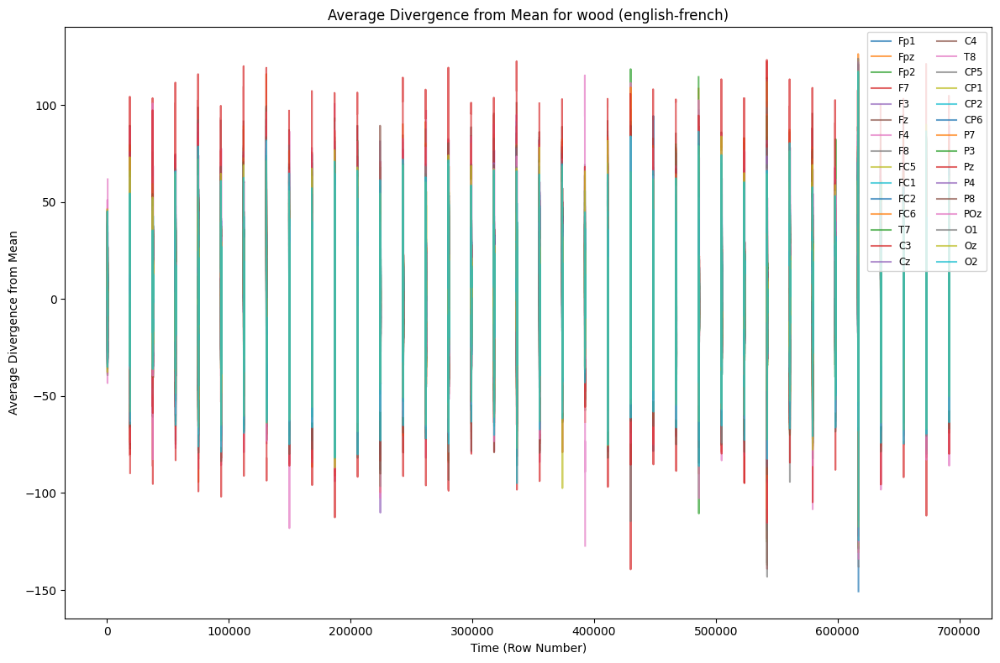

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


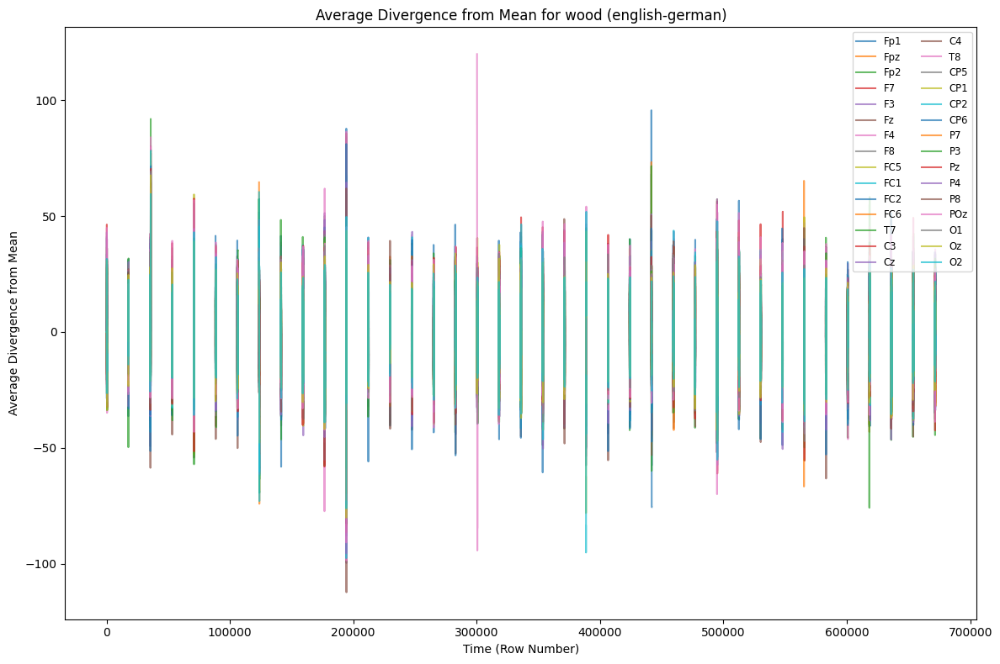

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


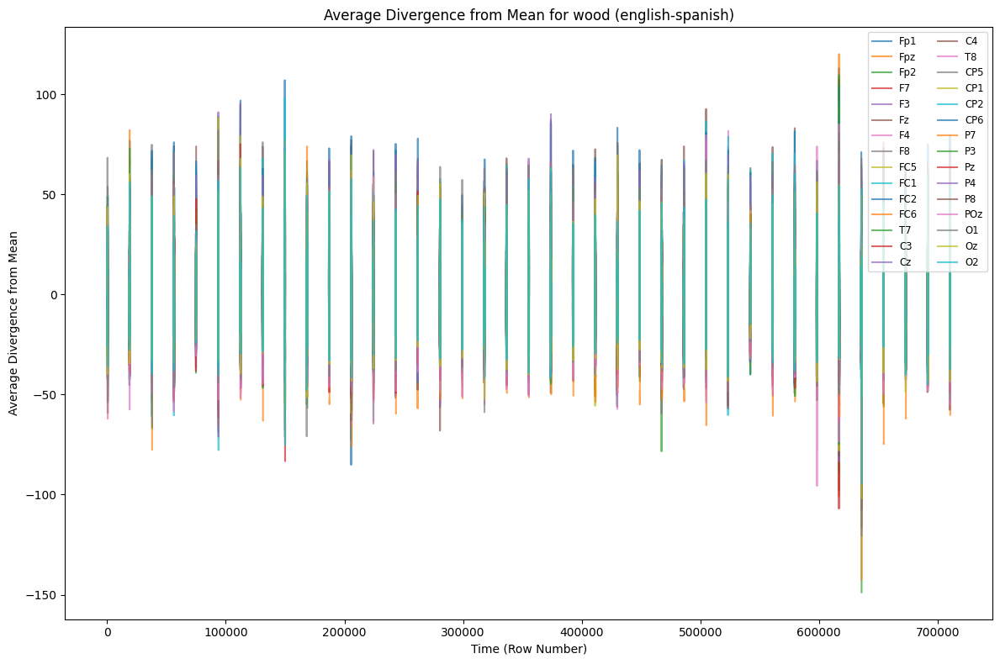

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


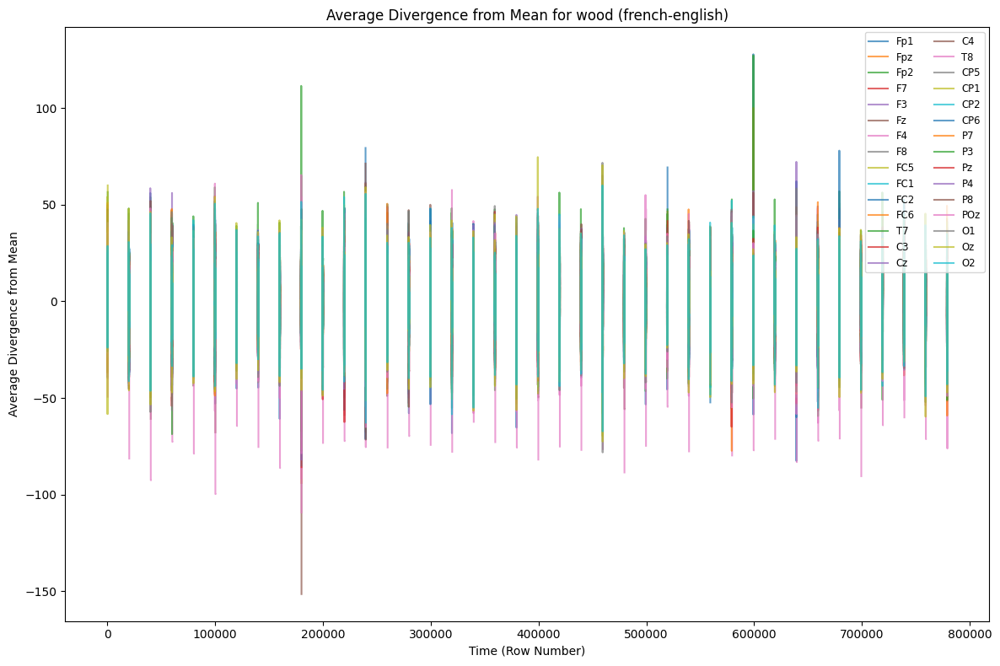

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


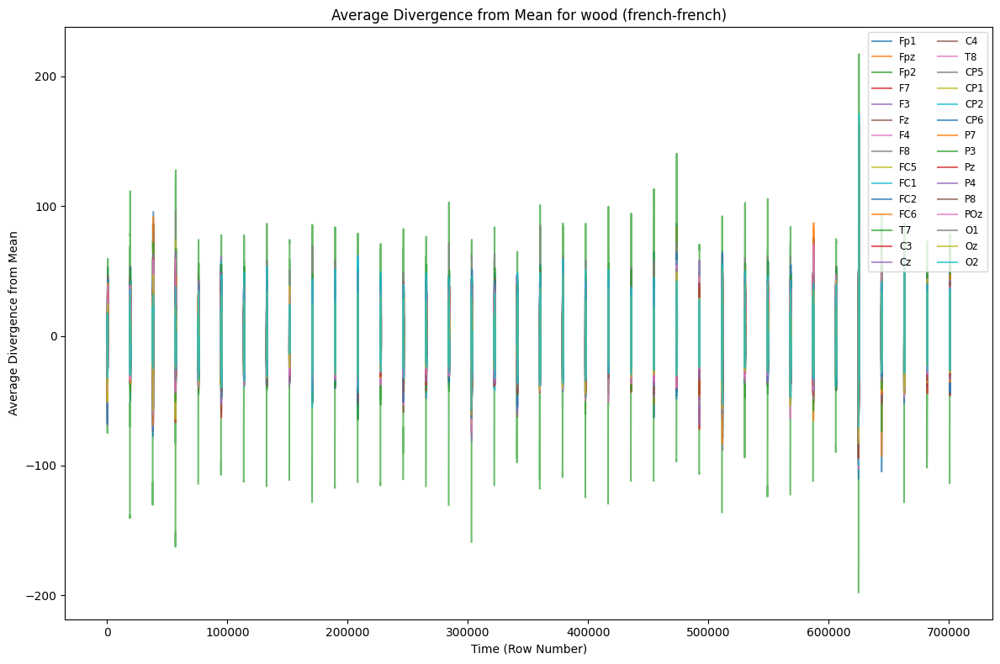

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


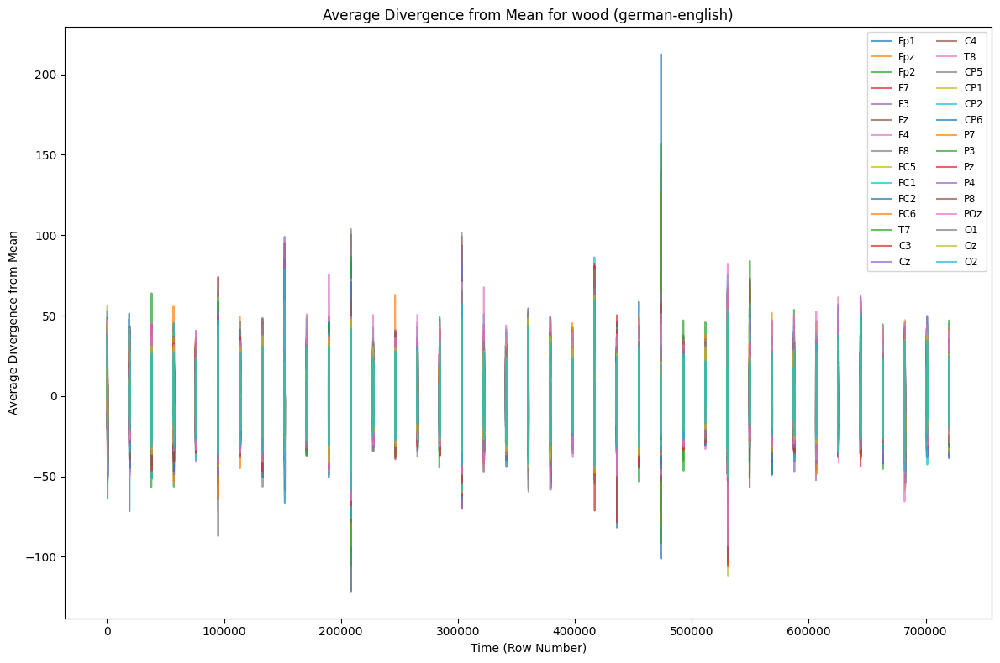

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


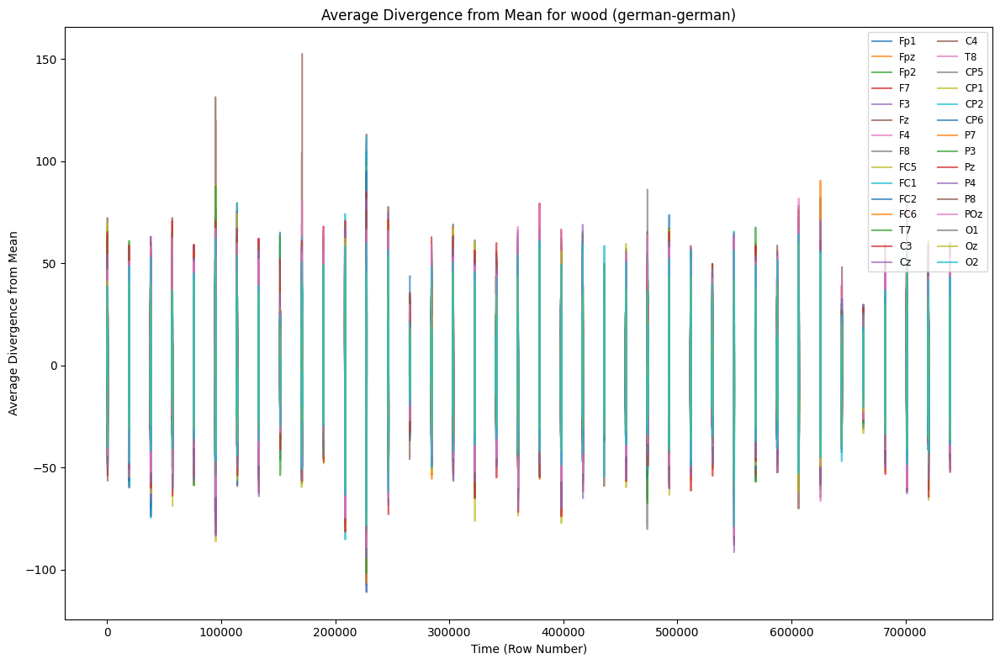

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


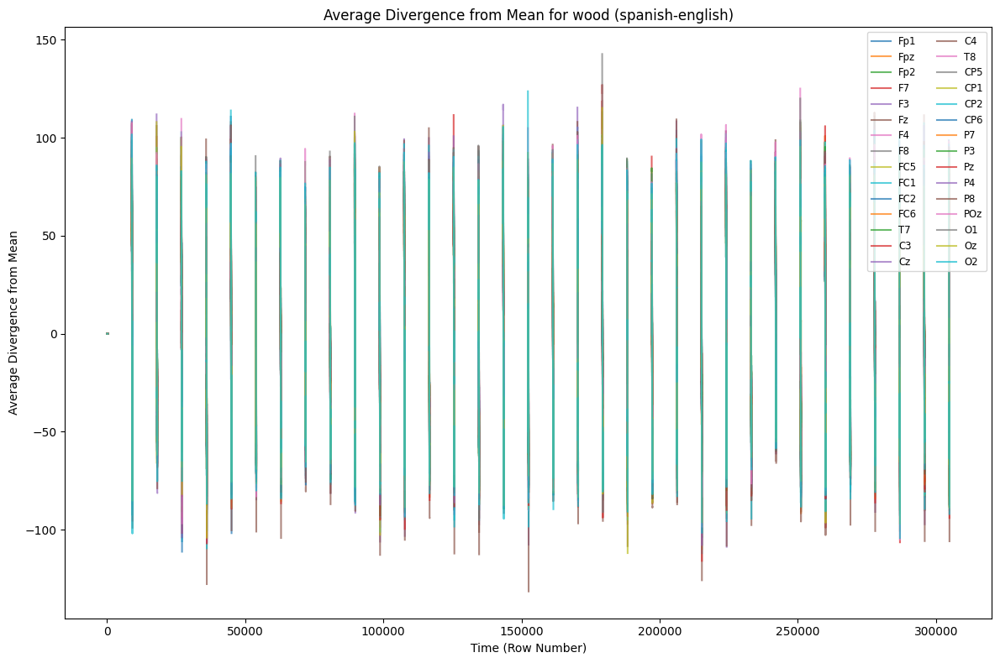

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


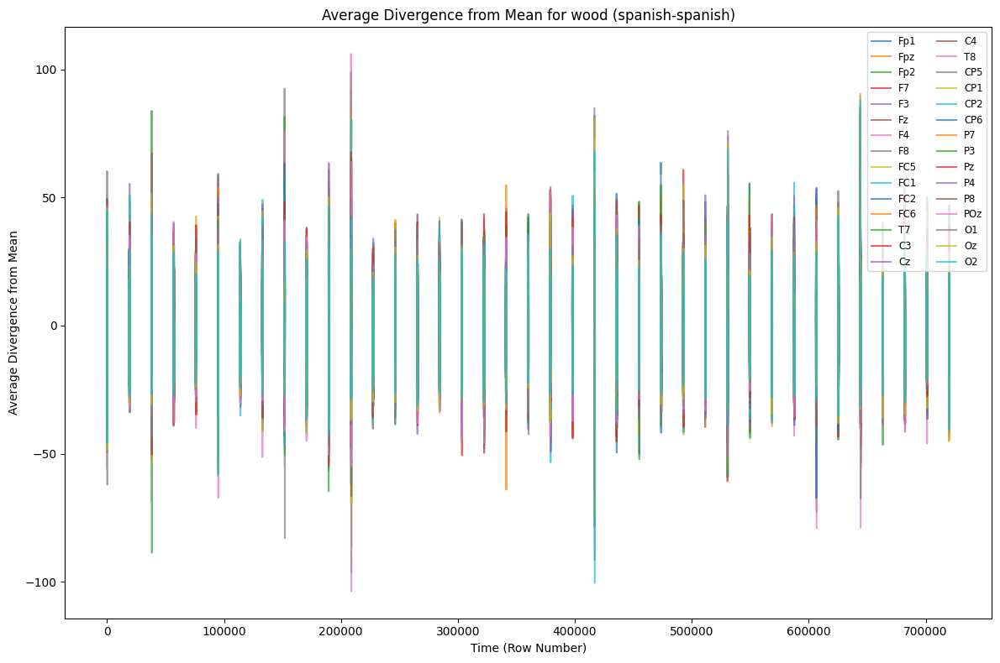

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


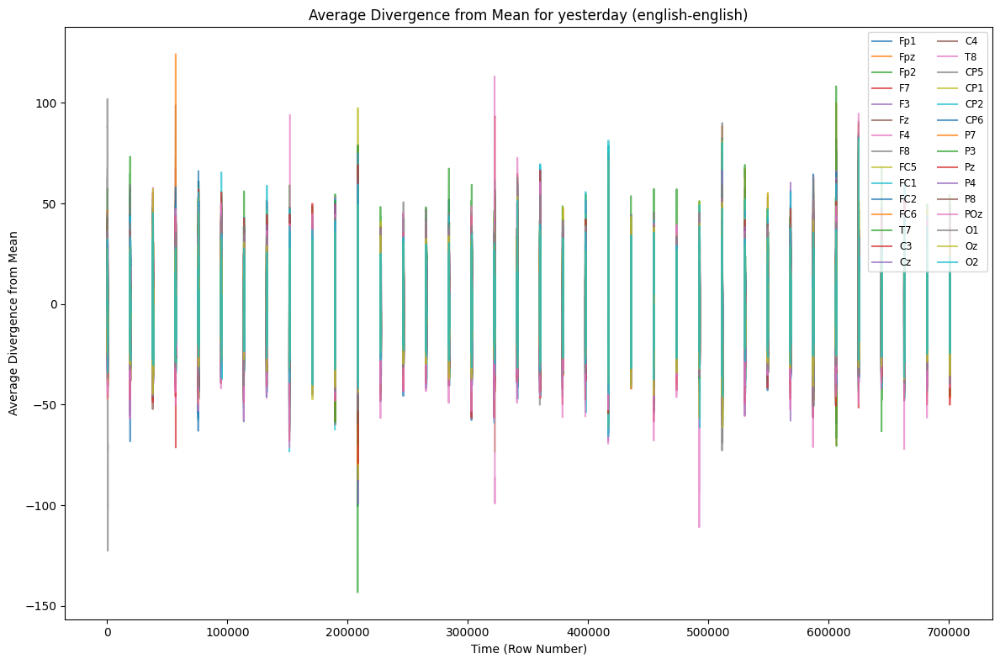

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


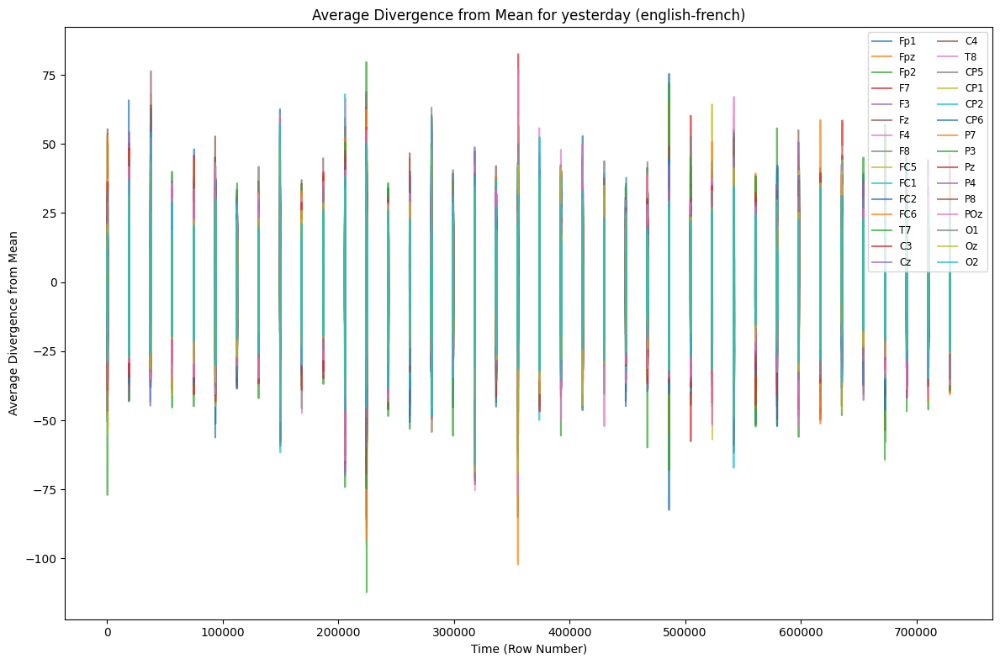

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


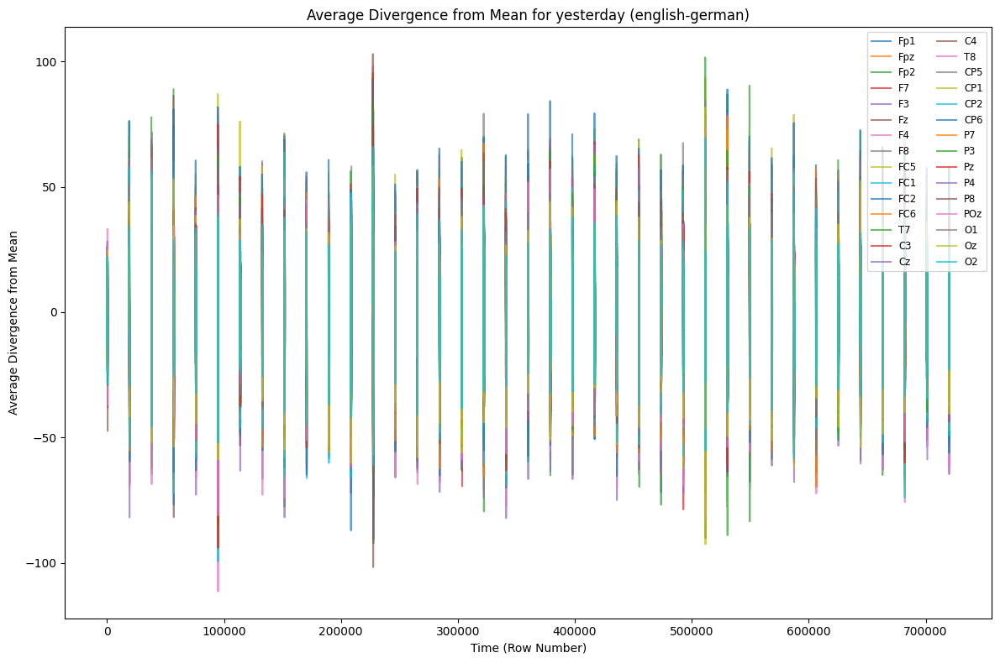

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


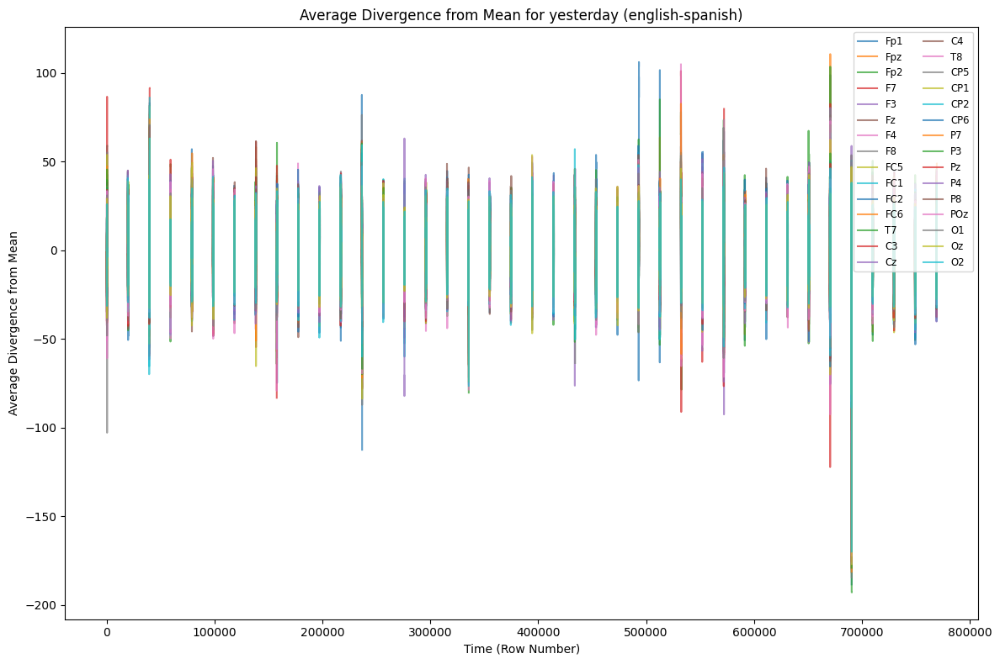

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


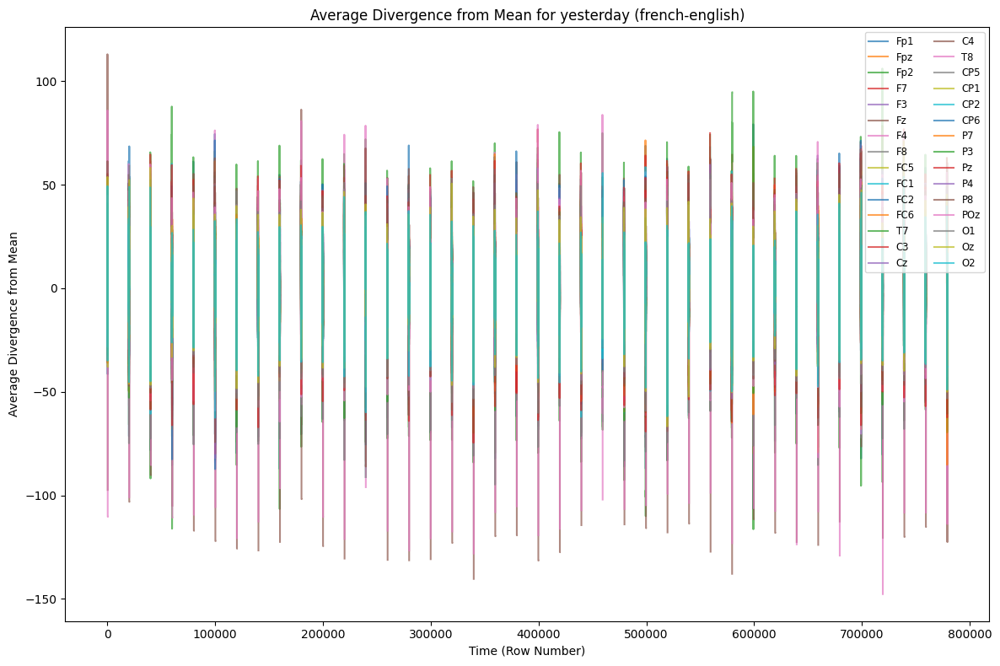

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


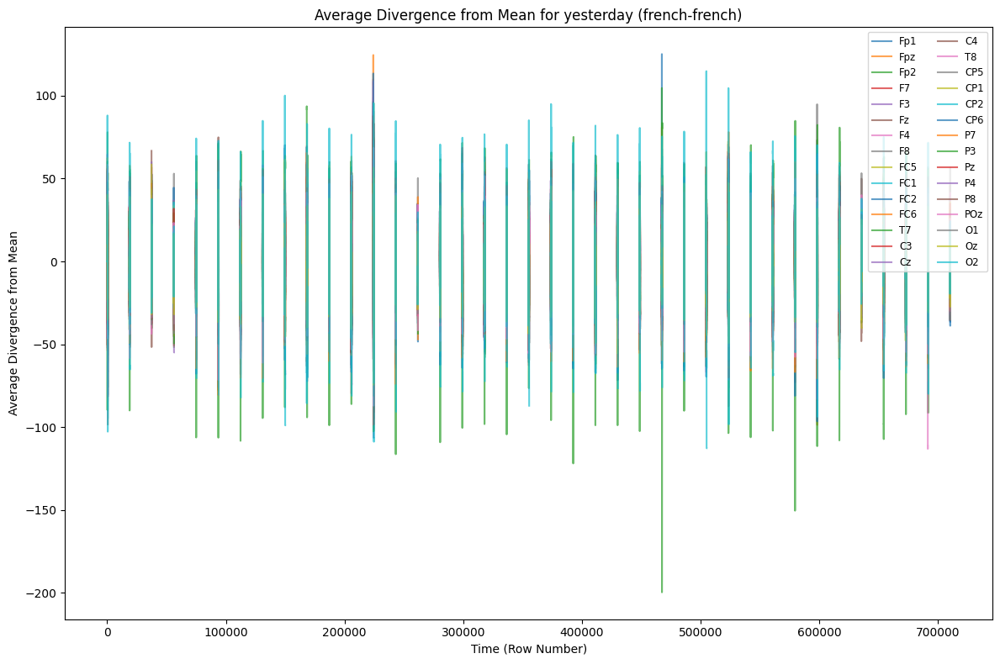

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


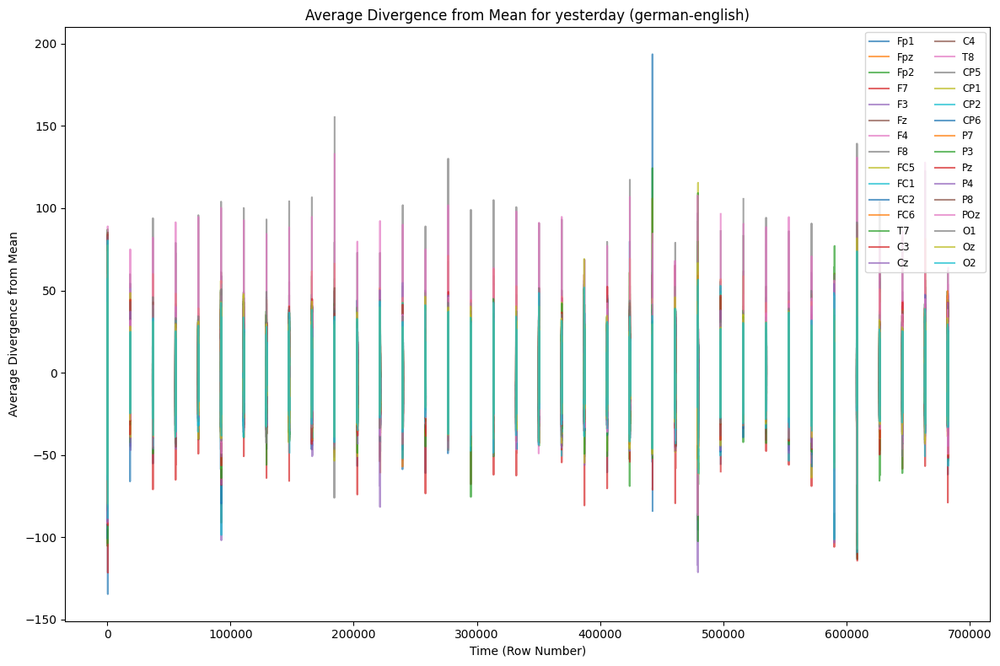

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


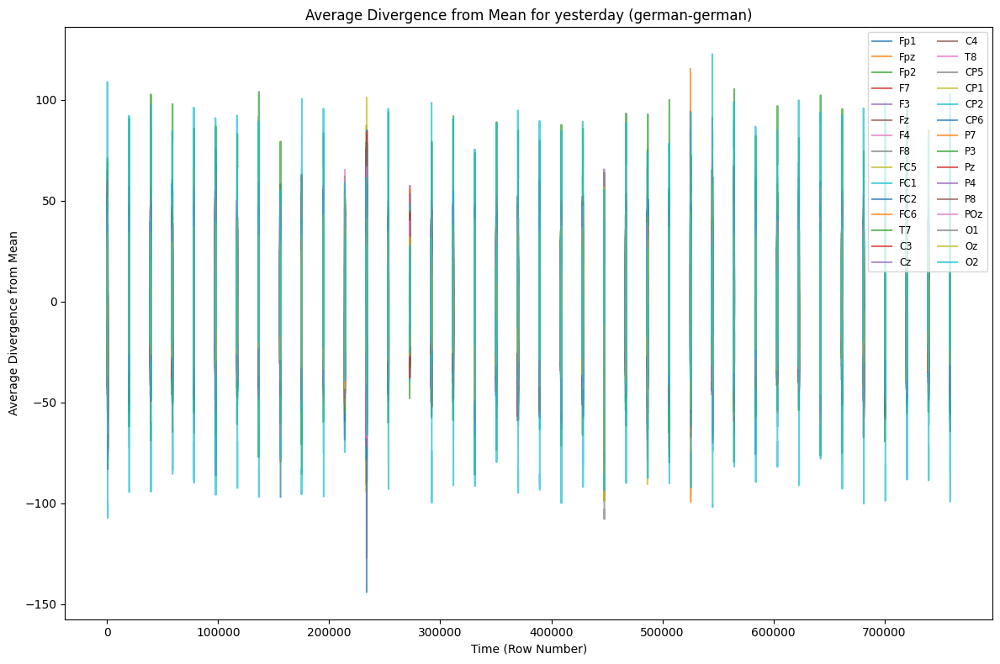

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


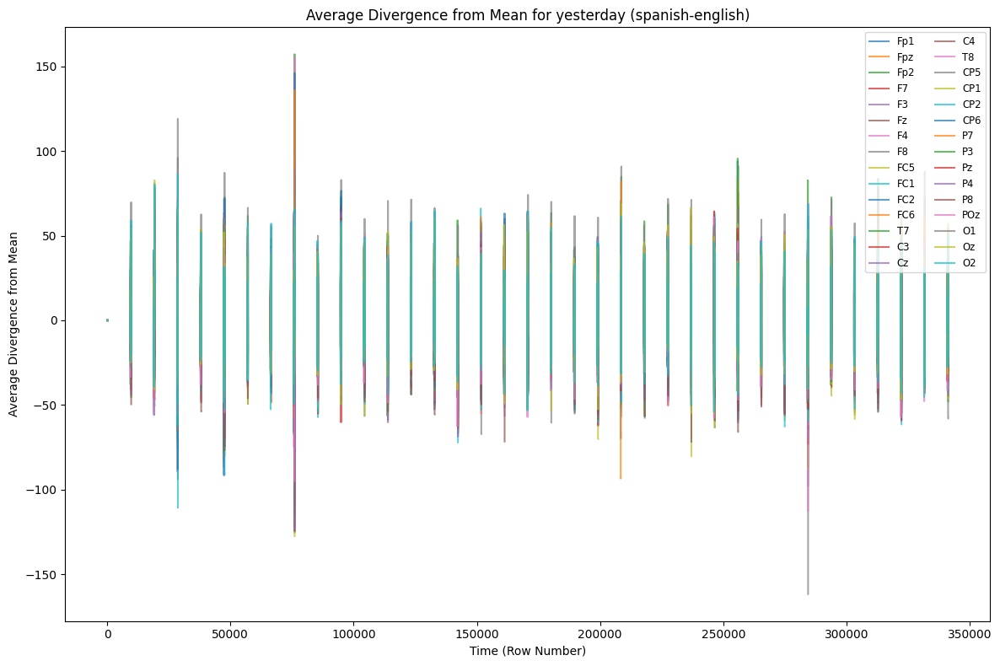

C:\Users\tommy\AppData\Local\Temp\ipykernel_37288\540275819.py:61: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)


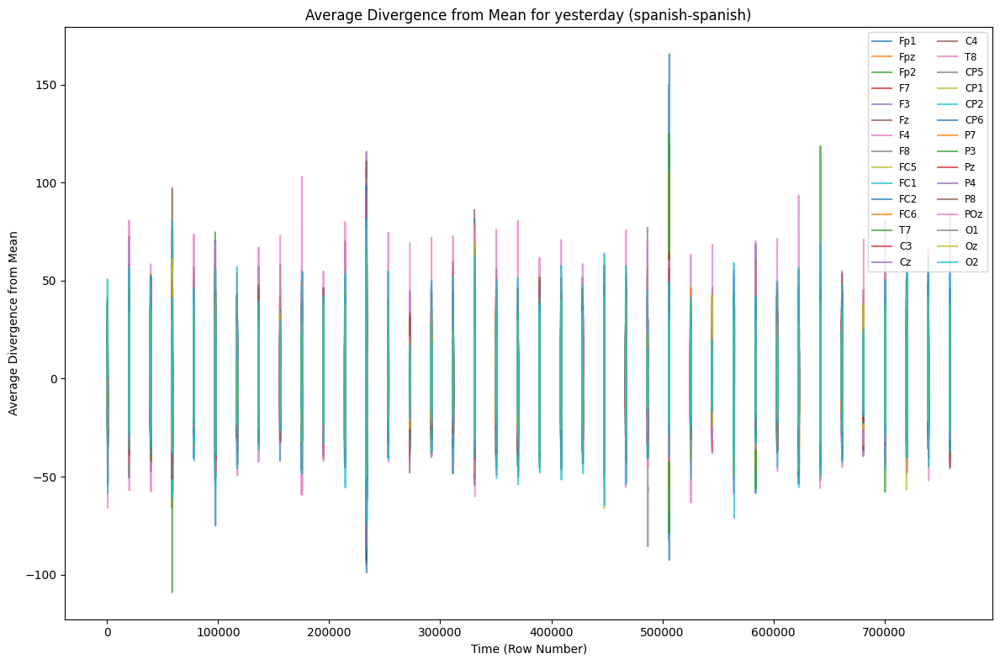

In [1]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

directory_path = 'EEG_Measurements'


def load_and_preprocess_files(directory_path):
    all_data = []
    
    
    file_paths = glob.glob(os.path.join(directory_path, '*_*-*_*.csv'))
    
    
    for file_path in tqdm(file_paths, desc="Loading and processing files"):
        filename = os.path.basename(file_path)
        
        try:
            
            word, lang_pair, relation, sample = filename.split('_')
            language1, language2 = lang_pair.split('-')
            
            
            erp_data = pd.read_csv(file_path)
            
            
            erp_data['word'] = word
            erp_data['language1'] = language1
            erp_data['language2'] = language2
            erp_data['sample'] = int(sample.split('.')[0])  
            
            
            all_data.append(erp_data)
        
        except ValueError:
            print(f"Skipping file due to unexpected format: {filename}")
            continue
    
    
    combined_data = pd.concat(all_data, ignore_index=True)
    return combined_data


def calculate_and_plot_average_divergence(data, electrodes):
    
    for (word, language1, language2), group_data in data.groupby(['word', 'language1', 'language2']):
        
        
        mean_values = group_data.groupby(group_data.index)[electrodes].mean()
        
        
        divergence_data = pd.DataFrame(columns=electrodes)
        
        
        for sample_num, sample_data in group_data.groupby('sample'):
            
            sample_divergence = sample_data[electrodes].reset_index(drop=True) - mean_values.reset_index(drop=True)
            divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)
        
        
        avg_divergence = divergence_data.groupby(divergence_data.index).mean()

        
        plt.figure(figsize=(12, 8))
        for electrode in electrodes:
            plt.plot(avg_divergence.index, avg_divergence[electrode], label=electrode, alpha=0.7)
        
        
        plt.title(f"Average Divergence from Mean for {word} ({language1}-{language2})")
        plt.xlabel("Time (Row Number)")
        plt.ylabel("Average Divergence from Mean")
        plt.legend(loc="upper right", ncol=2, fontsize='small')
        plt.tight_layout()
        plt.show()



combined_data = load_and_preprocess_files(directory_path)


electrodes = combined_data.columns[:30].tolist()


calculate_and_plot_average_divergence(combined_data, electrodes)


# Saving above as csv for each iteration

In [ ]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

directory_path = 'EEG_Measurements'
output_directory = 'Average_Divergence_Results'  


os.makedirs(output_directory, exist_ok=True)


def load_and_preprocess_files(directory_path):
    all_data = []
    
    
    file_paths = glob.glob(os.path.join(directory_path, '*_*-*_*.csv'))
    
    
    for file_path in tqdm(file_paths, desc="Loading and processing files"):
        filename = os.path.basename(file_path)
        
        try:
            
            word, lang_pair, relation, sample = filename.split('_')
            language1, language2 = lang_pair.split('-')
            
            
            erp_data = pd.read_csv(file_path)
            
            
            # print(f"Processing file: {filename} | word: {word} | language1: {language1} | language2: {language2} | sample: {sample}")
            
            
            erp_data['word'] = word
            erp_data['language1'] = language1
            erp_data['language2'] = language2
            erp_data['relation'] = relation
            erp_data['sample'] = int(sample.split('.')[0])  
            
            
            all_data.append(erp_data)
        
        except ValueError:
            print(f"Skipping file due to unexpected format: {filename}")
            continue
    
    
    combined_data = pd.concat(all_data, ignore_index=True)
    return combined_data


def calculate_and_save_average_divergence(data, electrodes, output_directory):
    
    unique_combinations = data.groupby(['word', 'language1', 'language2'])
    for (word, language1, language2), group_data in tqdm(unique_combinations, desc="Processing language pairs"):
        
        
        group_data = group_data.reset_index(drop=True)
        
        
        mean_values = group_data.groupby(group_data.index % 256)[electrodes].mean()
        
        
        print(f"Mean values for {word} ({language1}-{language2}) calculated:\n{mean_values.head()}")
        
        
        divergence_data = pd.DataFrame(columns=electrodes)
        
        
        for sample_num, sample_data in group_data.groupby('sample'):
            
            sample_data = sample_data.reset_index(drop=True)
            
            
            sample_divergence = sample_data[electrodes] - mean_values
            divergence_data = pd.concat([divergence_data, sample_divergence], ignore_index=True)
            
            
            print(f"Divergence calculated for sample {sample_num} of {word} ({language1}-{language2}):\n{sample_divergence.head()}")
        
        
        avg_divergence = divergence_data.groupby(divergence_data.index % 256).mean()

        
        output_filename = f"{word}_{language1}-{language2}_average_divergence.csv"
        avg_divergence.to_csv(os.path.join(output_directory, output_filename), index_label="Time")
        
        
        print(f"Saved average divergence for {word} ({language1}-{language2}) to {output_filename}")

        
        plt.figure(figsize=(12, 8))
        for electrode in electrodes:
            plt.plot(avg_divergence.index, avg_divergence[electrode], label=electrode, alpha=0.7)
        
        
        plt.title(f"Average Divergence from Mean for {word} ({language1}-{language2})")
        plt.xlabel("Time (Row Number)")
        plt.ylabel("Average Divergence from Mean")
        plt.legend(loc="upper right", ncol=2, fontsize='small')
        plt.tight_layout()
        plt.show()



combined_data = load_and_preprocess_files(directory_path)


electrodes = combined_data.columns[:30].tolist()


calculate_and_save_average_divergence(combined_data, electrodes, output_directory)

In [ ]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

directory_path = 'EEG_Measurements'
average_values_directory = 'Average_Values'  
os.makedirs(average_values_directory, exist_ok=True)

def calculate_and_save_average_divergence(data, electrodes, output_directory, average_values_directory):
    
    unique_combinations = data.groupby(['word', 'language1', 'language2'])
    for (word, language1, language2), group_data in tqdm(unique_combinations, desc="Processing language pairs"):
        
        
        group_data = group_data.reset_index(drop=True)
        
        
        mean_values = group_data.groupby(group_data.index % 256)[electrodes].mean()
        
        
        avg_values_filename = f"{word}_{language1}-{language2}_average_values.csv"
        mean_values.to_csv(os.path.join(average_values_directory, avg_values_filename), index_label="Time")
        print(f"Saved average values for {word} ({language1}-{language2}) to {avg_values_filename}")


calculate_and_save_average_divergence(combined_data, electrodes, output_directory, average_values_directory)


# Example comparing average to single csv

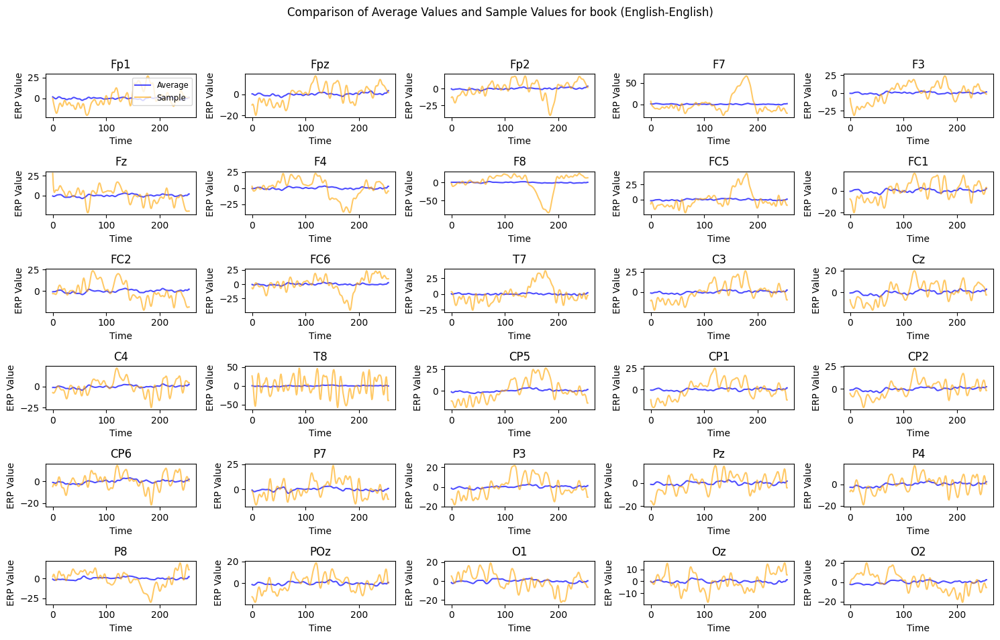

In [4]:
import pandas as pd
import matplotlib.pyplot as plt


average_values_file = os.path.join('Average_Values', 'book_english-english_average_values.csv')
sample_file = os.path.join('EEG_Measurements', 'book_english-english_translation_1.csv')


average_values = pd.read_csv(average_values_file, index_col="Time")
sample_values = pd.read_csv(sample_file, index_col=False)


electrodes = sample_values.columns[:30].tolist()


plt.figure(figsize=(15, 10))
for idx, electrode in enumerate(electrodes, 1):
    plt.subplot(6, 5, idx)
    
    
    plt.plot(average_values.index, average_values[electrode], label="Average", color="blue", alpha=0.7)
    
    
    plt.plot(sample_values.index, sample_values[electrode], label="Sample", color="orange", alpha=0.6)
    
    plt.title(electrode)
    plt.xlabel("Time")
    plt.ylabel("ERP Value")
    
    
    if idx == 1:
        plt.legend(loc="upper right", fontsize='small')

plt.suptitle("Comparison of Average Values and Sample Values for book (English-English)")
plt.tight_layout(rect=[0, 0.03, 1, 0.95])  
plt.show()


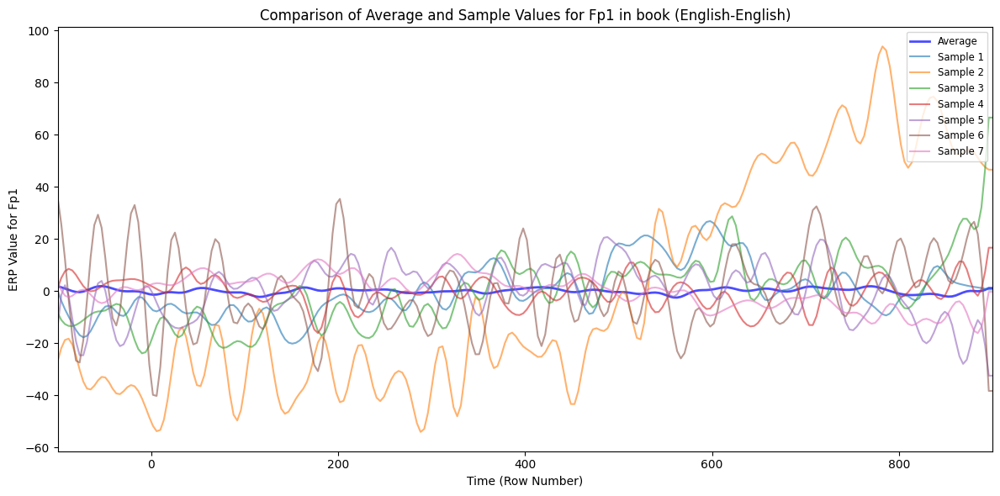

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import os


average_values_file = os.path.join('Average_Values', 'book_english-english_average_values.csv')
sample_files = [
    os.path.join('EEG_Measurements', f'book_english-english_translation_{i}.csv')
    for i in range(1, 8)
]


average_values = pd.read_csv(average_values_file, index_col="Time")


electrode = "Fp1"
plt.figure(figsize=(12, 6))

original_indices = average_values.index
scaled_x_values = ((original_indices / 255) * (900 + 100)) - 100

plt.plot(scaled_x_values, average_values[electrode], label="Average", color="blue", linewidth=2, alpha=0.7)


for i, sample_file in enumerate(sample_files, 1):
    sample_data = pd.read_csv(sample_file, index_col=False)
    
    
    sample_indices = sample_data.index
    scaled_sample_x_values = ((sample_indices / 255) * (900 + 100)) - 100  
    
    
    plt.plot(scaled_sample_x_values, sample_data[electrode], label=f"Sample {i}", alpha=0.6)


plt.xlim(-100, 900)


plt.title(f"Comparison of Average and Sample Values for Fp1 in book (English-English)")
plt.xlabel("Time (Row Number)")
plt.ylabel("ERP Value for Fp1")
plt.legend(loc="upper right", fontsize='small')
plt.tight_layout()
plt.show()


File not found for participant 15. Skipping.
File not found for participant 4. Skipping.
File not found for participant 24. Skipping.
File not found for participant 15. Skipping.


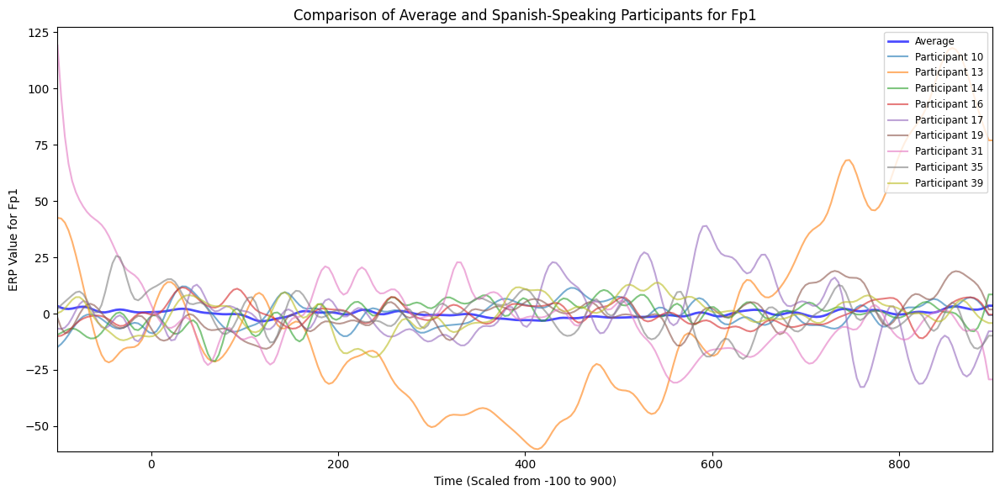

File not found for participant 4. Skipping.
File not found for participant 24. Skipping.


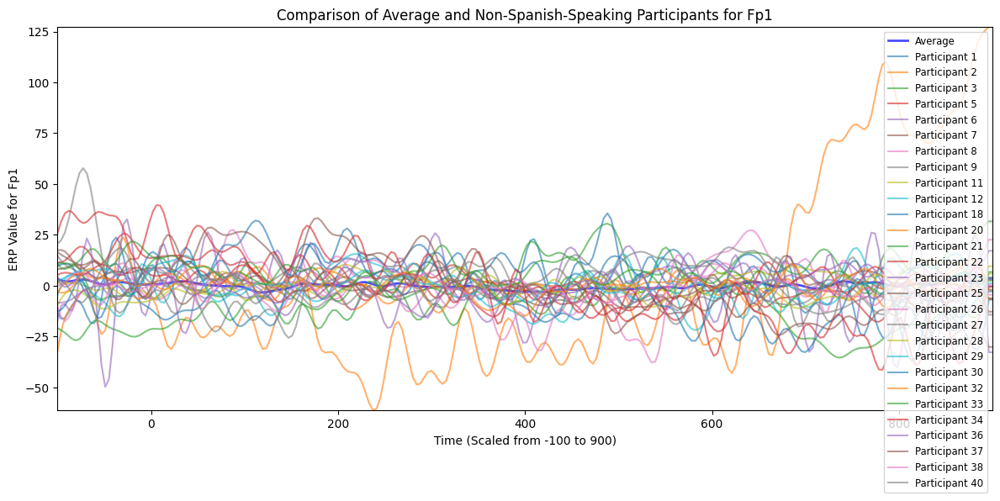

File not found for participant 4. Skipping.
File not found for participant 15. Skipping.
File not found for participant 24. Skipping.
File not found for participant 4. Skipping.


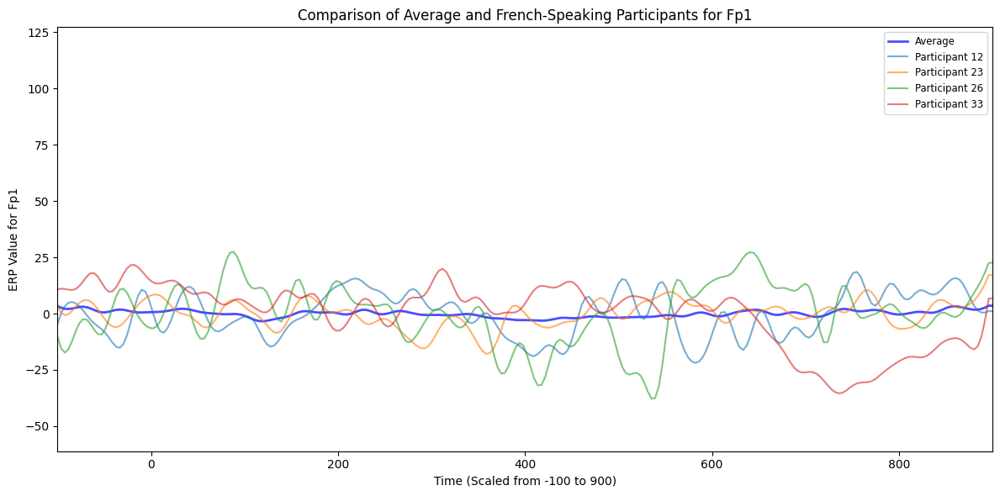

File not found for participant 15. Skipping.
File not found for participant 24. Skipping.


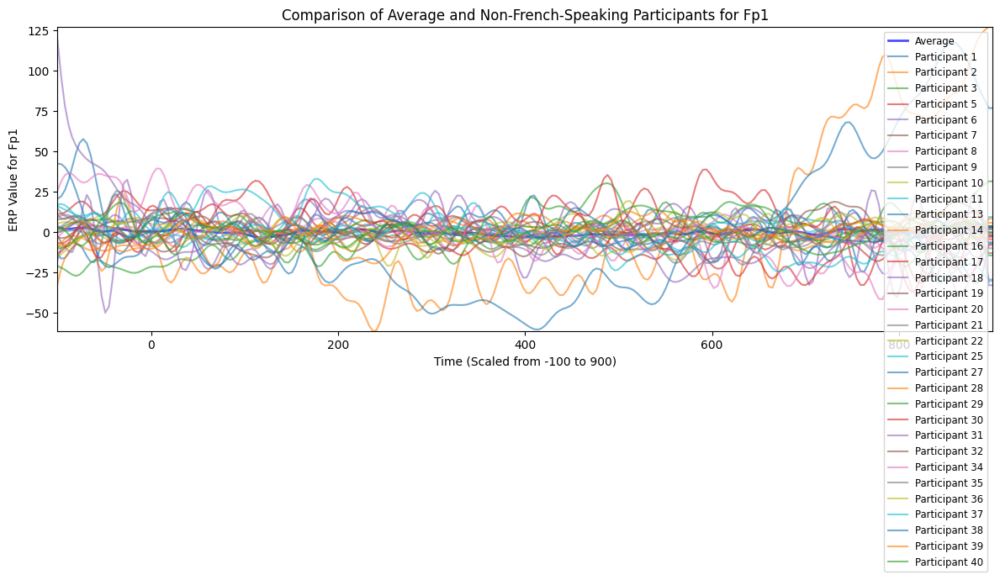

File not found for participant 4. Skipping.
File not found for participant 15. Skipping.
File not found for participant 24. Skipping.


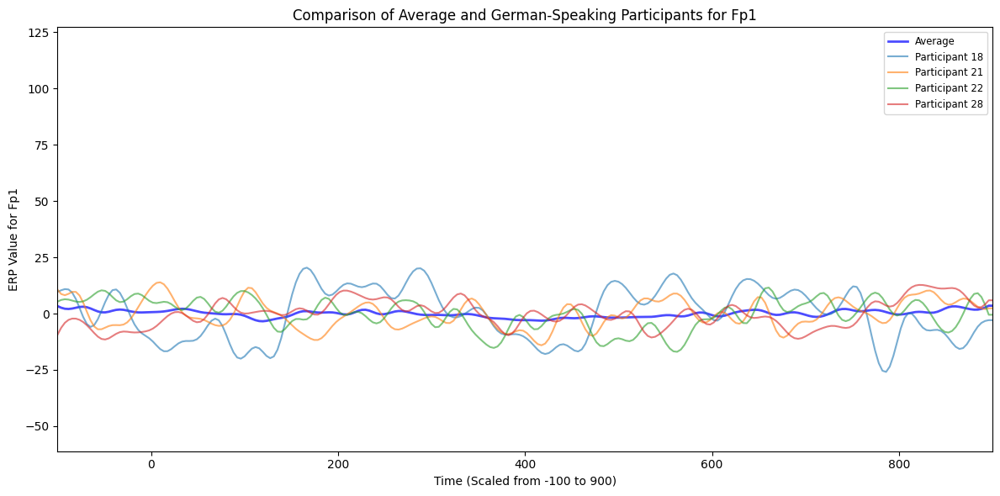

File not found for participant 4. Skipping.
File not found for participant 15. Skipping.
File not found for participant 24. Skipping.


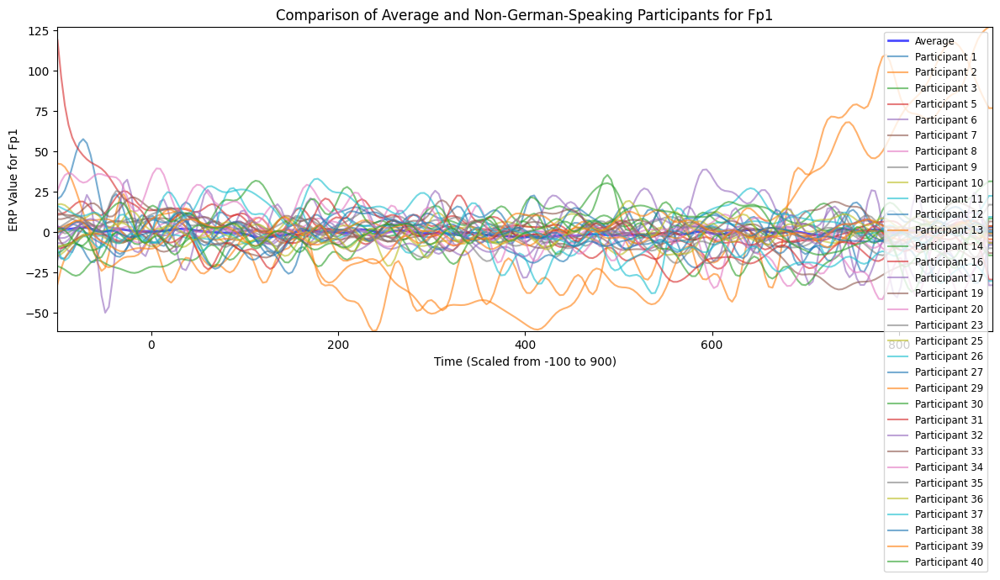

File not found for participant 4. Skipping.
File not found for participant 15. Skipping.
File not found for participant 24. Skipping.
File not found for participant 4. Skipping.
File not found for participant 15. Skipping.


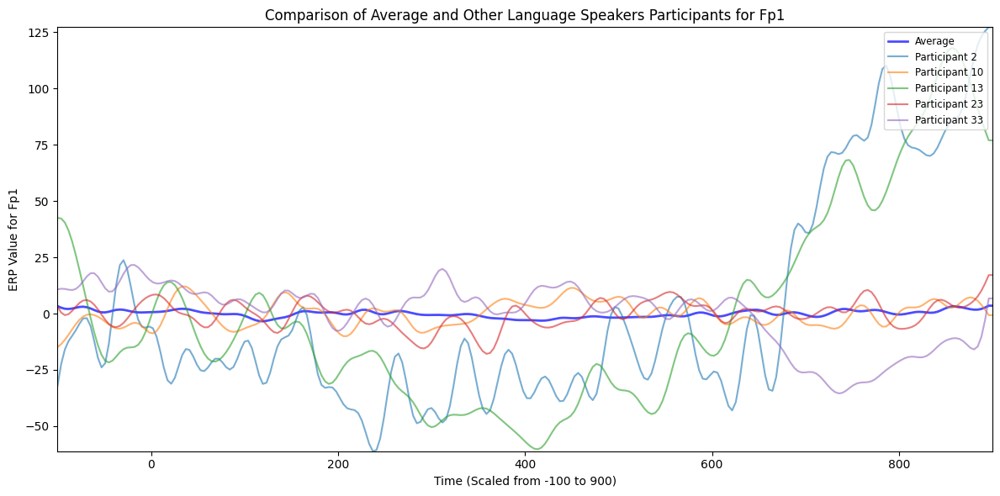

File not found for participant 24. Skipping.


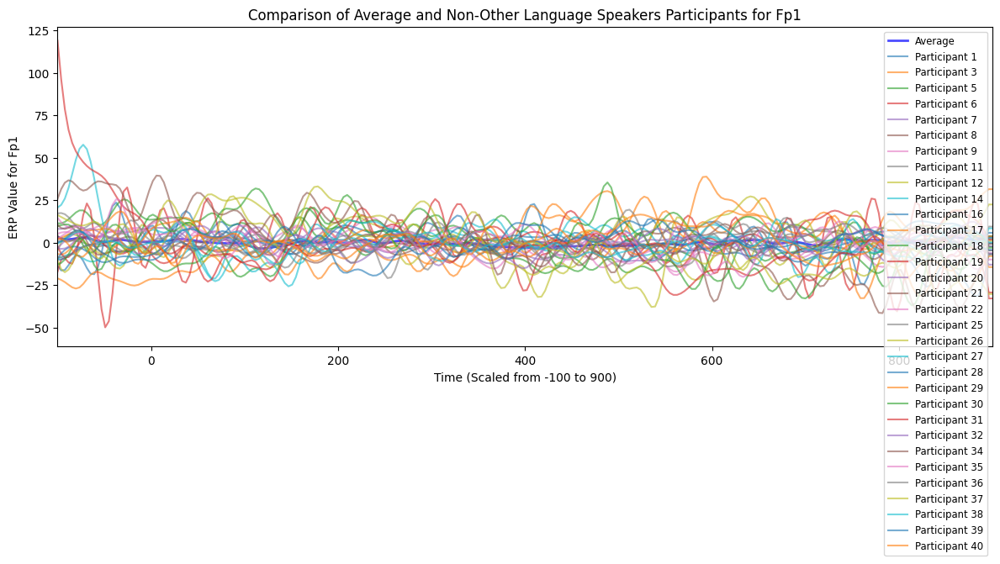

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
import os


metadata_file = 'metadata.csv'
metadata = pd.read_csv(metadata_file)


average_values_file = os.path.join('Average_Values', 'book_english-spanish_average_values.csv')
average_values = pd.read_csv(average_values_file, index_col="Time")


electrode = "Fp1"


def scale_x_values(original_indices):
    return ((original_indices / 255) * (900 + 100)) - 100  


def get_global_y_limits(participant_group):
    y_min, y_max = float('inf'), float('-inf')
    
    for participant in participant_group:
        sample_file = os.path.join('EEG_Measurements', f'book_english-spanish_translation_{participant}.csv')  
        try:
            sample_data = pd.read_csv(sample_file, index_col=False)
            y_min = min(y_min, sample_data[electrode].min())
            y_max = max(y_max, sample_data[electrode].max())
        except FileNotFoundError:
            print(f"File not found for participant {participant}. Skipping.")
    
    return y_min, y_max


def plot_participant_group(participant_group, group_name, y_limits):
    plt.figure(figsize=(12, 6))

    
    plt.plot(scale_x_values(average_values.index), average_values[electrode], label="Average", color="blue", linewidth=2, alpha=0.7)

    
    for participant in participant_group:
        sample_file = os.path.join('EEG_Measurements', f'book_english-spanish_translation_{participant}.csv')  
        try:
            sample_data = pd.read_csv(sample_file, index_col=False)
            plt.plot(scale_x_values(sample_data.index), sample_data[electrode], label=f"Participant {participant}", alpha=0.6)
        except FileNotFoundError:
            print(f"File not found for participant {participant}. Skipping.")

    plt.xlim(-100, 900)
    plt.ylim(y_limits)  

    plt.title(f"Comparison of Average and {group_name} Participants for Fp1")
    plt.xlabel("Time (Scaled from -100 to 900)")
    plt.ylabel("ERP Value for Fp1")
    plt.legend(loc="upper right", fontsize='small')
    plt.tight_layout()
    plt.show()


spanish_participants = metadata[metadata['spanish'] == 1]['participant'].values
non_spanish_participants = metadata[metadata['spanish'] == 0]['participant'].values


spanish_y_limits = get_global_y_limits(spanish_participants)
non_spanish_y_limits = get_global_y_limits(non_spanish_participants)


y_limits = (min(spanish_y_limits[0], non_spanish_y_limits[0]), max(spanish_y_limits[1], non_spanish_y_limits[1]))


plot_participant_group(spanish_participants, "Spanish-Speaking", y_limits)


plot_participant_group(non_spanish_participants, "Non-Spanish-Speaking", y_limits)



french_participants = metadata[metadata['french'] == 1]['participant'].values
non_french_participants = metadata[metadata['french'] == 0]['participant'].values


french_y_limits = get_global_y_limits(french_participants)
non_french_y_limits = get_global_y_limits(non_french_participants)


y_limits = (min(french_y_limits[0], non_french_y_limits[0]), max(french_y_limits[1], non_french_y_limits[1]))


plot_participant_group(french_participants, "French-Speaking", y_limits)


plot_participant_group(non_french_participants, "Non-French-Speaking", y_limits)


german_participants = metadata[metadata['german'] == 1]['participant'].values
non_german_participants = metadata[metadata['german'] == 0]['participant'].values


german_y_limits = get_global_y_limits(german_participants)
non_german_y_limits = get_global_y_limits(non_german_participants)


y_limits = (min(german_y_limits[0], non_german_y_limits[0]), max(german_y_limits[1], non_german_y_limits[1]))


plot_participant_group(german_participants, "German-Speaking", y_limits)


plot_participant_group(non_german_participants, "Non-German-Speaking", y_limits)


other_participants = metadata[metadata['other'] == 1]['participant'].values
non_other_participants = metadata[metadata['other'] == 0]['participant'].values


other_y_limits = get_global_y_limits(other_participants)
non_other_y_limits = get_global_y_limits(non_other_participants)


y_limits = (min(other_y_limits[0], non_other_y_limits[0]), max(other_y_limits[1], non_other_y_limits[1]))


plot_participant_group(other_participants, "Other Language Speakers", y_limits)


plot_participant_group(non_other_participants, "Non-Other Language Speakers", y_limits)


['shoe', 'skin', 'face', 'yesterday', 'neighbor', 'pocket', 'leaf', 'watch', 'rain', 'room', 'lawyer', 'daughter', 'laughter', 'city', 'nephew', 'pillow', 'wall', 'flour', 'cloud', 'garlic', 'wood', 'ground', 'chair', 'happiness', 'neck', 'book', 'food', 'mouth', 'knife', 'place']
File not found for participant 10. Skipping.
File not found for participant 13. Skipping.
File not found for participant 14. Skipping.
File not found for participant 15. Skipping.
File not found for participant 16. Skipping.
File not found for participant 17. Skipping.
File not found for participant 19. Skipping.
File not found for participant 31. Skipping.
File not found for participant 35. Skipping.
File not found for participant 39. Skipping.
File not found for participant 10. Skipping.
File not found for participant 13. Skipping.
File not found for participant 14. Skipping.
File not found for participant 15. Skipping.
File not found for participant 16. Skipping.
File not found for participant 17. Skipping

KeyboardInterrupt: 

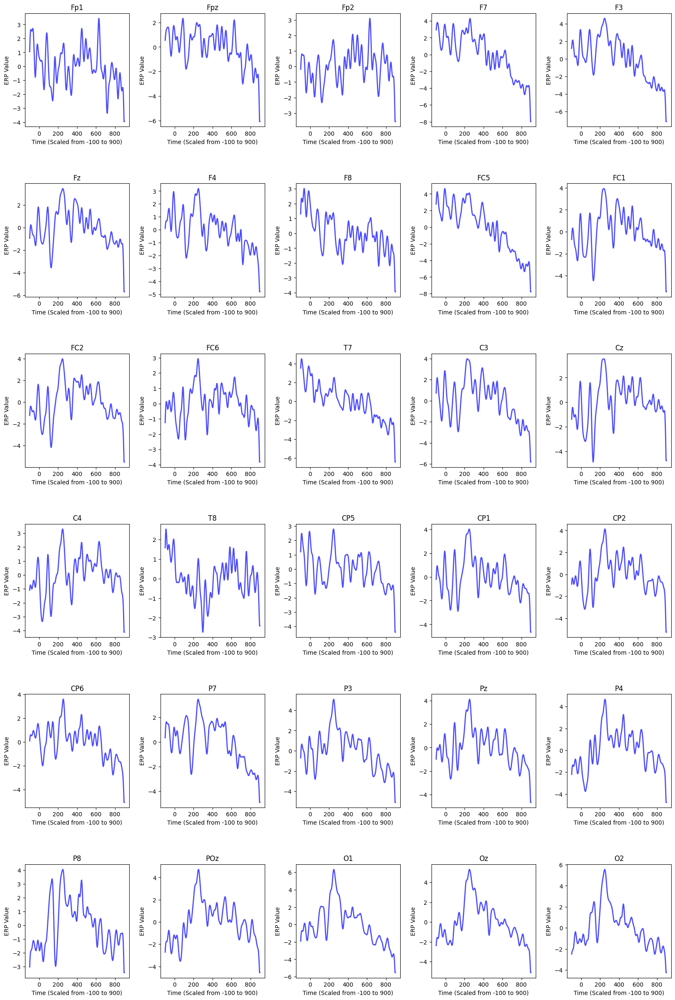

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
import os
import glob


metadata_file = 'metadata.csv'
metadata = pd.read_csv(metadata_file)


def get_words_from_filenames(directory):
    word_set = set()  
    file_pattern = os.path.join(directory, '*_*-*_translation_*.csv')
    for file_path in glob.glob(file_pattern):
        filename = os.path.basename(file_path)
        word, lang_pair, relation = filename.split('_')[:3]  
        word_set.add(word)  
    return list(word_set)


directory_path = 'EEG_Measurements'
words = get_words_from_filenames(directory_path)
print(words)

with open('extracted_words.txt', 'w') as f:
    for word in words:
        f.write(f"{word}\n")

electrodes = average_values.columns[:30].tolist()


def scale_x_values(original_indices):
    return ((original_indices / 255) * (900 + 100)) - 100  


def get_global_y_limits(participant_group, electrode):
    y_min, y_max = float('inf'), float('-inf')
    
    for participant in participant_group:
        sample_file = os.path.join('EEG_Measurements', f'{word}_{language_pair}_translated_{participant}.csv')  
        try:
            sample_data = pd.read_csv(sample_file, index_col=False)
            y_min = min(y_min, sample_data[electrode].min())
            y_max = max(y_max, sample_data[electrode].max())
        except FileNotFoundError:
            print(f"File not found for participant {participant}. Skipping.")
    
    return y_min, y_max


def plot_participant_group(participant_group, group_name, output_directory, word, language_pair):
    plt.figure(figsize=(20, 30))  
    plt.subplots_adjust(hspace=0.5, wspace=0.3)  

    for i, electrode in enumerate(electrodes):
        plt.subplot(6, 5, i + 1)  
        
        
        plt.plot(scale_x_values(average_values.index), average_values[electrode], label="Average", color="blue", linewidth=2, alpha=0.7)

        
        for participant in participant_group:
            sample_file = os.path.join('EEG_Measurements', f'{word}_{language_pair}_translated_{participant}.csv')  
            try:
                sample_data = pd.read_csv(sample_file, index_col=False)
                plt.plot(scale_x_values(sample_data.index), sample_data[electrode], label=f"Participant {participant}", alpha=0.6)
            except FileNotFoundError:
                print(f"File not found for participant {participant}. Skipping.")

        
        plt.title(f"{electrode}")
        plt.xlabel("Time (Scaled from -100 to 900)")
        plt.ylabel("ERP Value")
    
    
    output_filename = os.path.join(output_directory, f"{word}_{language_pair}_all_electrodes.png")
    plt.savefig(output_filename, bbox_inches='tight')
    plt.close()  
    print(f"Saved figure for {group_name} ({word}-{language_pair}) to {output_filename}")


output_directory = 'All_Electrode_Figures'
os.makedirs(output_directory, exist_ok=True)


for word in words:
    for language_pair in ['english-english']:  
        average_values_file = os.path.join('Average_Values', f'book_english-english_average_values.csv')
        average_values = pd.read_csv(average_values_file, index_col="Time")

        spanish_participants = metadata[metadata['spanish'] == 1]['participant'].values
        non_spanish_participants = metadata[metadata['spanish'] == 0]['participant'].values
        
        
        plot_participant_group(spanish_participants, "Spanish-Speaking", output_directory, word, language_pair)
        
        
        plot_participant_group(non_spanish_participants, "Non-Spanish-Speaking", output_directory, word, language_pair)

        
        french_participants = metadata[metadata['french'] == 1]['participant'].values
        non_french_participants = metadata[metadata['french'] == 0]['participant'].values
        
        plot_participant_group(french_participants, "French-Speaking", output_directory, word, language_pair)
        plot_participant_group(non_french_participants, "Non-French-Speaking", output_directory, word, language_pair)

        german_participants = metadata[metadata['german'] == 1]['participant'].values
        non_german_participants = metadata[metadata['german'] == 0]['participant'].values
        
        plot_participant_group(german_participants, "German-Speaking", output_directory, word, language_pair)
        plot_participant_group(non_german_participants, "Non-German-Speaking", output_directory, word, language_pair)

        other_participants = metadata[metadata['other'] == 1]['participant'].values
        non_other_participants = metadata[metadata['other'] == 0]['participant'].values
        
        plot_participant_group(other_participants, "Other Language Speakers", output_directory, word, language_pair)
        plot_participant_group(non_other_participants, "Non-Other Language Speakers", output_directory, word, language_pair)
